### Classify using whole ingredients

This file runs the entire ingredients through the classifiers - we use the top 50 ingredients in each cuisine only - this ends up with 234 top distinguishing features. The results are not as good as the existing work with vectorizing single words. Need to now try the inclusion of more features.

In [1]:
import csv, os, pandas as pd, pathlib, pprint, json, numpy as np
import bagOfWords as bow
from sklearn.feature_extraction.text import CountVectorizer

In [2]:
# Make sure json training json file exists

data_directory = os.path.join(os.getcwd(), "Dataset")
train_data_file_path = os.path.join(data_directory, "train.json")
test_data_file_path = os.path.join(data_directory, "test.json")
    
if(not pathlib.Path(train_data_file_path).is_file()):
    raise Exception("Missing train.json file in " + data_directory)

    
if(not pathlib.Path(test_data_file_path).is_file()):
    raise Exception("Missing test.json file in " + data_directory)

In [3]:
# Read JSON training data

with open(train_data_file_path, 'r') as f:
     trainData = pd.read_json(f)
f.closed

with open(test_data_file_path, 'r') as f:
     testData = pd.read_json(f)
f.closed

trainData.head()

,cuisine,id,ingredients
0,greek,10259,"[romaine lettuce, black olives, grape tomatoes..."
1,southern_us,25693,"[plain flour, ground pepper, salt, tomatoes, g..."
2,filipino,20130,"[eggs, pepper, salt, mayonaise, cooking oil, g..."
3,indian,22213,"[water, vegetable oil, wheat, salt]"
4,indian,13162,"[black pepper, shallots, cornflour, cayenne pe..."


Section 2: Analysis & Visualisation

In [4]:
%matplotlib inline

In [5]:
import matplotlib.pyplot as plt


Count the ingredients in the cuisines

In [6]:
from collections import Counter

counters = {}
for cuisine in trainData['cuisine'].unique():
    counters[cuisine] = Counter()
    indices = (trainData['cuisine'] == cuisine)
    for ingredients in trainData[indices]['ingredients']:
        counters[cuisine].update(ingredients)

In [7]:
for cuisine in trainData['cuisine'].unique():
    print(cuisine)

greek
southern_us
filipino
indian
jamaican
spanish
italian
mexican
chinese
british
thai
vietnamese
cajun_creole
brazilian
french
japanese
irish
korean
moroccan
russian


In [8]:
for cuisine in trainData['cuisine'].unique():
    print ("here is the ingredients for %s" % cuisine)
    print ("here is the items broken out")
    for key,value in counters[cuisine].items():
        print(key, value)
    

here is the ingredients for greek
here is the items broken out
romaine lettuce 39
black olives 31
grape tomatoes 26
garlic 216
pepper 203
purple onion 186
seasoning 3
garbanzo beans 23
feta cheese crumbles 252
ground pork 4
finely chopped fresh parsley 8
onions 185
salt 572
vinegar 3
caul fat 1
minced garlic 68
dried oregano 267
red wine vinegar 99
olive oil 504
boneless chop pork 1
lemon juice 183
orange 12
anise 5
cinnamon sticks 31
unflavored gelatin 2
zinfandel 2
orange blossom honey 3
sugar 77
lemon 129
calimyrna figs 1
clove 14
honey 67
whipping cream 2
plain whole-milk yogurt 5
fresh dill 108
yoghurt 10
myzithra 2
large eggs 72
cheese 15
feta cheese 191
phyllo 12
kefalotyri 9
ground black pepper 221
extra-virgin olive oil 229
hamburger buns 6
paprika 20
chopped fresh mint 68
ground cinnamon 73
balsamic vinegar 24
baby spinach leaves 9
ground lamb 68
dried mint flakes 15
tomatoes 156
dried dillweed 10
red wine 10
lamb 12
plain yogurt 56
pita bread rounds 16
cucumber 187
liquid 2


zesty italian dressing 1
chili powder 3
coriander 2
cilantro sprigs 1
vanilla bean paste 1
stevia extract 1
tilapia fillets 1
mushroom caps 1
watermelon seeds 1
flavored oil 1
pickled beets 1
salad 4
natural pistachios 1
syrup 2
dried apricot 2
double-acting baking powder 1
boneless chicken cutlet 1
egg noodles 1
chicken drumsticks 1
Country CrockÂ® Spread 1
currant 1
canned chicken broth 2
Mezzetta Sliced Greek Kalamata Olives 1
poblano chiles 1
hard-boiled egg 2
bibb lettuce 1
pastry 1
white onion 3
pickling spices 1
olive oil cooking spray 3
cooking oil 2
lean ground meat 1
sliced mushrooms 2
tart shells 1
Tabasco Pepper Sauce 2
dried red chile peppers 1
alfalfa sprouts 1
sliced turkey 1
whole wheat pita pockets 1
nonfat ricotta cheese 1
garlic puree 1
condensed cream of chicken soup 1
asian eggplants 1
bourbon whiskey 1
maple syrup 1
bacon 1
dates 1
green cabbage 1
lean minced lamb 2
dried mixed herbs 1
yellow peppers 1
roasted garlic 1
dried sage 1
red swiss chard 1
wheat 3
hallou

chopped fresh sage 11
egg yolks 87
extra sharp white cheddar cheese 3
dry vermouth 2
fresh thyme 29
shredded sharp cheddar cheese 67
garlic chives 1
sherry 3
green garlic 1
whey 1
ear of corn 9
corn grits 14
cocoa 11
cocoa powder 11
soy sauce 21
chicken wings 7
fresh ginger root 1
meat 11
buttermilk biscuits 12
maple sugar 2
pimentos 48
liqueur 9
golden raisins 15
ranch dressing 19
coke 1
boneless chuck roast 2
asiago 5
reduced sodium chicken broth 15
white cheddar cheese 16
condensed tomato soup 2
pie crust 41
jack cheese 4
macaroni 13
ground mustard 10
sweet potatoes & yams 5
orange juice 47
shredded coconut 1
caramel sauce 6
pudding 1
chicken drumsticks 13
fresh marjoram 6
unsweetened shredded dried coconut 2
chicken cutlets 4
unsweetened coconut milk 4
panko 8
dried parsley 15
cornbread 17
soft-wheat flour 9
grated lemon peel 7
brussels sprouts 2
white flour 4
tapioca flour 2
coconut sugar 4
almond flour 7
coconut flour 6
coconut oil 14
coconut milk 13
orange pekoe tea 1
mozzarella

cream of mushroom soup 5
italian style stewed tomatoes 1
hominy 3
beef sausage 3
meat tenderizer 2
Mexican cheese blend 3
roasted garlic 3
tomato ketchup 3
freeze-dried strawberries 1
buttercream frosting 4
pineapple 6
batter 4
pot roast 1
pepperoncini 4
au jus mix 1
sorghum molasses 1
butter flavor vegetable shortening 1
spinach 3
reduced fat sharp cheddar cheese 15
cream cheese frosting 6
sambal chile paste 1
spices 11
turkey breakfast sausage 1
light cream cheese 4
no salt added chicken broth 1
vegetable gumbo mixture 1
yellow mustard seeds 6
smoked pork neck bones 3
ginger ale 3
chicken breast tenders 1
mixed greens 8
sandwich buns 2
honey mustard 2
steak seasoning 3
sparkling wine 1
earl grey tea bags 2
kalamata 2
napa cabbage 3
hungarian paprika 3
crumbled cornbread 4
stuffing mix 3
American cheese 3
toasted walnuts 2
crumbled gorgonzola 1
sheepshead 1
wheat cereal 1
light soy sauce 2
tangerine juice 2
tangerine 2
cream sweeten whip 20
soft sandwich rolls 2
lean bacon 3
lipton re

crushed cornflakes 1
edible flowers 2
oatmeal 2
pitted prunes 1
splenda 2
poppy seed dressing 2
lardons 1
instant white rice 1
tomato soup 1
nutritional yeast 2
ears 1
Hellmann'sÂ® Real Mayonnaise 2
morel 1
sweetbreads 2
salted mixed nuts 1
frozen hash browns 2
sloe gin 1
Galliano 1
toasted wheat germ 1
Louisiana Hot Sauce 3
stout 1
rye bread 1
hazelnuts 1
gingersnap crumbs 2
Grand Marnier 1
Wholesome Sweeteners Organic Sugar 1
gluten free cornmeal 2
gluten-free pie crust 1
fine grind white cornmeal 1
short-grain rice 1
butter cake 1
Eggland's BestÂ® eggs 1
apricot halves 1
dark beer 1
Better Than Bouillon Chicken Base 1
sweet pickle juice 1
powdered milk 1
instant yeast 1
less sodium chicken broth 1
ground peppercorn 1
persimmon 1
sliced pears 1
red kidnei beans, rins and drain 1
sub buns 1
alum 1
stewing hen 1
drummettes 1
brie cheese 1
twists 2
Angostura bitters 4
anise liqueur 1
pitted date 1
poblano chiles 2
kahlÃºa 1
Braeburn Apple 1
fresh bay leaves 2
low sodium jarred chicken s

peanut oil 6
long-grain rice 4
greens 1
quinoa 1
bone-in chicken 2
ghee 1
melted butter 8
flour for dusting 2
squash 2
leaves 16
green papaya 8
safflower 1
grape tomatoes 1
fennel seeds 1
ground cinnamon 4
bacon drippings 1
coriander seeds 1
medium shrimp 4
sugar pea 5
flat leaf parsley 2
seasoned bread crumbs 1
boneless skinless chicken breast halves 4
spaghetti squash 1
hamburger 3
marinade 2
bacon 3
minced onion 6
garlic chili sauce 5
chicken tenderloin 1
pasta 2
peanuts 5
dried shiitake mushrooms 4
Accent Seasoning 6
pork blood 2
chicken meat 4
chayotes 8
green bell pepper 17
salt and ground black pepper 10
pork liver 5
chicken parts 1
celery 19
chicken legs 13
barbecue sauce 1
boneless chicken thigh fillets 1
red pepper flakes 4
mango nectar 1
patis 7
bean threads 2
achiote powder 3
spring roll wrappers 16
distilled malt vinegar 1
mushrooms 3
rice vermicelli 2
whole peppercorn 14
caster sugar 3
Edam 4
plain flour 2
yukon gold potatoes 2
banana leaves 7
ground turmeric 5
sticky ric

granny smith apples 11
paprika 189
chicken broth 43
chicken breasts 75
chopped onion 97
chopped celery 11
lime zest 7
purple onion 170
boiling water 16
spinach leaves 8
ginger 526
low-fat natural yogurt 2
lime 80
Flora Cuisine 2
curry paste 53
moong dal 20
cilantro leaves 353
capsicum 31
green mango 3
prawns 14
rose petals 2
almonds 35
rice 114
whole milk 45
pistachios 25
saffron 75
strong white bread flour 6
salted butter 8
sunflower oil 33
warm water 57
yoghurt 211
kalonji 4
instant yeast 9
fresh coriander 125
garbanzo beans 36
medjool date 3
diced bell pepper 1
cream 72
lemon 134
smoked paprika 27
frozen peas 127
garlic puree 4
green cardamom pods 68
white onion 39
tomato purÃ©e 73
red chile powder 11
boneless chicken breast 8
cashew nuts 126
mace 43
honey 58
kashmiri chile 2
kasuri methi 44
mustard oil 28
ginger paste 91
clove 306
cinnamon 156
tomato ketchup 16
jeera 21
cardamom 83
ground pepper 12
fenugreek seeds 65
cauliflower flowerets 1
boiling potatoes 23
fennel seeds 128
chic

dry red wine 2
pappadams 5
wafer 3
cuminseed 1
half & half 16
creamy peanut butter 2
long pepper 1
large egg whites 2
dipping sauces 1
panko 3
club soda 1
tofu 6
carbonated water 1
cane sugar 4
toasted unsweetened coconut 1
seasoned bread crumbs 1
pork tenderloin 2
Thai red curry paste 2
haricots verts 3
red cabbage 5
gram dal 2
liquid aminos 1
mung beans 5
yellow squash 2
turnips 6
cornish game hens 1
corn husks 1
basil 1
pistachio nuts 8
evaporated milk 7
nonfat ricotta cheese 1
cassia cinnamon 7
turkey 3
grated parmesan cheese 1
dark brown sugar 9
brown rice flour 2
orange flower water 1
raw pistachios 1
dried barberries 1
raw almond 2
kaffir lime leaves 6
sweet potatoes & yams 1
almond milk 4
virgin olive oil 1
daikon 4
fish sauce 6
garlic chili sauce 3
chicken wings 4
pineapple 6
bulb 1
pepitas 1
white flour 2
channa dal 8
baguette 1
reduced sodium chicken broth 3
asafetida (powder) 2
whole wheat tortillas 3
flour tortillas 2
frying oil 1
italian pork sausage 1
lamb loin chops 4
s

fresh curry 2
minced beef 2
dumpling wrappers 2
ground pork 1
cayenne pepper sauce 1
fresno pepper 1
baby goat 1
pink peppercorns 1
pepper flakes 2
alphabet pasta 1
hot chili 2
rice bran 2
ancho powder 1
rotisserie chicken 1
low sodium vegetable stock 1
red apples 1
asparagus tips 1
vanilla lowfat yogurt 1
crushed pineapples in juice 1
pearl couscous 1
lamb leg steaks 1
diced tomatoes in juice 3
Nakano Seasoned Rice Vinegar 1
seitan 1
ground peanut 1
hot chili sauce 1
cremini mushrooms 1
boneless rib eye steaks 1
beef boneless meat stew 1
cooked turkey 1
boneless pork shoulder 3
egg roll wrappers 1
citrus juice 1
monterey jack 1
sourdough rolls 1
canned chopped tomatoes 2
mashed banana 1
cummin 1
spicy brown mustard 1
mini marshmallows 1
Crispy Rice Cereal 1
berries 1
light corn syrup 1
tawny port 1
baby back ribs 1
nonfat dry milk powder 1
coffee granules 1
baby kale 1
ponzu 1
creamed coconut 1
chuck steaks 2
shoulder lamb chops 1
true cinnamon 1
cider 1
top sirloin steak 1
green toma

finely chopped onion 9
dumpling wrappers 1
dry mustard 1
habanero 7
red kidnei beans, rins and drain 2
juice concentrate 1
instant chicken bouillon 1
dri leav thyme 5
peeled fresh ginger 7
pickled jalapeno peppers 2
chiles 5
fish fillets 1
corn oil 1
red chili peppers 4
mixed peel 1
yeast 7
anise 2
fresh lemon juice 1
flat leaf parsley 3
small red potato 1
bartlett pears 1
nuts 1
goat 3
melted butter 3
active dry yeast 2
vegetable broth 3
baby spinach 2
diced tomatoes 8
salmon steaks 1
large garlic cloves 6
cold milk 1
any 2
russet potatoes 1
skirt steak 1
butternut squash 4
yellow split peas 2
waxy potatoes 1
sweet corn 2
cod fish 2
coconut sugar 2
butter beans 2
rubbed sage 2
tarragon vinegar 1
bread 3
green pepper 5
light beer 1
diced red onions 1
vegetable bouillon cube 1
egg noodles 1
heavy whipping cream 1
jerk paste 2
chopped cilantro fresh 7
dry white wine 2
curry sauce 1
blue crabs 1
taro leaf 1
pig 2
cubed pumpkin 1
unsweetened shredded dried coconut 1
red apples 1
seasoning 

rolls 2
tomato paste 37
meat loaf mix 1
beef broth 6
iceberg lettuce 1
ground oregano 1
garlic mayonnaise 1
long grain brown rice 1
prosciutto 6
red pepper 14
skinless chicken pieces 1
unflavored gelatin 4
chopped green bell pepper 18
beef stock cubes 2
lemon juice 28
mayonaise 15
lettuce leaves 3
sliced green onions 6
poblano chiles 8
chicken 22
vodka 1
rosÃ© wine 2
peaches 12
club soda 13
frozen lemonade concentrate 4
peach nectar 3
chili 7
buttermilk 2
honey 22
plantains 2
sirloin steak 1
dried thyme 22
cilantro sprigs 7
sauce 3
canned low sodium chicken broth 4
garden peas 3
seafood 2
curry powder 4
mussels 43
converted rice 4
fava beans 2
blood sausage 1
smoked ham hocks 3
basil 9
english cucumber 8
lime juice 5
vegetable juice 6
stock 4
chicken meat 2
green pepper 21
mushrooms 13
garbanzo beans 9
vegetable broth 9
couscous 3
chopped garlic 6
croutons 7
fresh herbs 5
serrano 4
roast red peppers, drain 9
fine sea salt 6
baby spinach 5
vegetables 3
red wine 19
brandy 22
ice 4
ground

rib roast 1
table salt 1
whitefish 1
chicken gizzards 1
corn oil 1
gravenstein apple 1
won ton wrappers 1
green leaf lettuce 1
dried plum 1
savoy cabbage 2
kidney beans 1
corn 2
habanero pepper 1
cuban peppers 2
fideos pasta 1
Turkish bay leaves 1
ginger 1
soy sauce 3
cola 1
salad greens 3
celery salt 2
soy chorizo 1
edamame 2
pasta sauce 1
fontina cheese 1
roasting chickens 1
sweet mini bells 1
mixed greens 1
extra large eggs 1
vinaigrette 2
Italian bread 3
dill pickles 1
prepared mustard 1
fresh peas 2
chiffonade 1
dough 1
blanco chees queso 1
yellow corn meal 2
conch 1
eye of round roast 1
kirby cucumbers 1
pickling spices 1
ginger ale 1
honeydew 1
fat free yogurt 2
dry yeast 3
tomatillos 2
part-skim ricotta cheese 1
crust 2
soft goat's cheese 1
italian plum tomatoes 1
french baguette 1
Marcona almonds 1
head cauliflower 1
oyster mushrooms 1
medium shrimp uncook 2
flavored vinegar 1
low sodium tomato juice 2
Manzanilla olives 1
lobster tails 1
calamari 1
wine vinegar 1
extra lean gr

dried fig 11
chopped parsley 99
ground white pepper 33
soft goat's cheese 10
truffle oil 17
hazelnuts 53
veal scallopini 2
elbow macaroni 19
bread flour 77
bread yeast 1
red potato 26
vegan parmesan cheese 4
ahi 1
golden brown sugar 14
anjou pears 3
granny smith apples 6
crystallized ginger 10
ice water 7
vegetable shortening 5
chinese five-spice powder 1
whole wheat flour 21
large egg yolks 142
lean ground beef 135
sausage links 32
pork chops 8
rosemary 57
nectarines 5
sweet cherries 12
orange zest 28
lavender buds 1
apricot halves 4
diced tomatoes in juice 7
scallions 61
italian salad dressing 41
short pasta 7
lemon wedge 58
porterhouse steaks 4
1% low-fat milk 68
golden raisins 46
cinnamon sticks 18
broccolini 3
salted butter 11
chicken stock 142
coffee granules 12
lemon rind 34
baby portobello mushrooms 10
broccoli florets 64
orecchiette 41
melted butter 24
pizza shells 3
frozen mixed thawed vegetables, 2
ragu old world style pasta sauc 11
loosely packed fresh basil leaves 21
whole

fresh yeast 2
fish 6
italian plum tomatoes 26
coffee beans 5
uncooked ziti 5
nonfat evaporated milk 6
chuck roast 6
prepared lasagne 11
beef deli roast slice thinli 2
sub buns 4
won ton wrappers 10
carbonated water 4
lambrusco 1
spaghetti sauce seasoning mix 3
chicken-apple sausage 1
chicken breast tenderloins 1
wheat flour 4
Tabasco Pepper Sauce 3
baby kale 1
spaghetti squash 16
curly endive 1
red beans 5
whole milk yoghurt 2
shredded reduced fat reduced sodium swiss cheese 1
yellow peppers 7
tuna packed in water 4
roasted hazelnuts 10
candied lemon peel 5
candied citron peel 1
curry powder 8
spaghetti, cook and drain 7
italian seasoned dry bread crumbs 10
shredded Italian cheese 7
non stick spray 2
crusty loaf 1
green pepper 39
Johnsonville Mild Italian Sausage Links 4
diced tomatoes with garlic and onion 2
fresh angel hair 4
rib 18
small white beans 4
baked ham 3
tuna packed in olive oil 16
Ciabatta rolls 1
Dutch-processed cocoa powder 5
tuna 6
halibut fillets 9
dried red chile pepp

low-fat goat cheese 2
skinless flounder fillets 1
hamburger 5
white cheddar cheese 4
black truffle oil 3
tubetti 7
veal loin chops 2
triscuits 1
chicken-flavored soup powder 2
country loaf 2
zest 2
Gold Medal Flour 2
pane di casa 1
lemonade concentrate 1
zinfandel 1
shredded romano cheese 2
soba 1
fresh ginger 4
NeufchÃ¢tel 3
multi-grain penne pasta 1
rye flour 1
turkey meatballs 1
hazelnut meal 1
cabernet sauvignon 2
cumin 3
dumplings 2
ground chicken 9
dried lentils 6
port wine 4
brown gravy 1
pita chips 2
grate lime peel 2
smoked ham hocks 2
flat leaf spinach 4
Ragu Golden Veggie Fettuccine Pasta 1
Ragu Classic Alfredo Sauce 1
color food green 2
red food coloring 6
tarragon 4
green chard 1
wheat germ 2
tea bags 3
grapes 4
butter oil 3
roasted pistachios 3
ragu old world style sweet tomato basil pasta sauc 2
dri thyme leaves, crush 2
large curd cottage cheese 2
soya bean 3
beet greens 2
light pancake syrup 1
red currant jelly 1
bread rolls 1
red raspberries 1
dried tagliatelle 1
roas

meat filling 1
brown rice penne 1
reduced fat ranch dressing 1
vanilla pudding 1
instant rice 1
sesame oil 1
marshmallows 1
cooked steak 1
whole wheat bread slices 1
frozen brussels sprouts 1
gnocchetti sardi 1
Progresso Balsamic Vinegar 1
unsalted pumpkinseed kernels 1
chestnut spread 1
medium eggs 2
Bertolli Tomato & Basil Sauce 1
tangerine juice 1
small shells 1
speck 1
french onion soup 1
deli rolls 1
seafood seasoning 1
plain whole-milk yogurt 1
pancetta slices 2
goat s milk cheese 1
red beets 1
Wish-BoneÂ® Robusto Italian Dressing 1
old-fashioned oats 1
unsalted shelled pistachio 1
prosciutto fat 1
vanilla bean seeds 1
oats 1
mushroom soup 1
tomato soup 1
organic unsalted butter 1
fresh corn 1
chicken thigh fillets 1
german mustard 1
KnorrÂ® Pasta Sidesâ„¢ - Butter & Herb 1
cut up cooked chicken 1
pie crust 2
borlotti 1
five-spice powder 1
pink grapefruit 1
proscuitto 1
pearl couscous 1
homemade meatballs 1
ground espresso 1
shark 1
shortbread cookies 1
candy bar 1
whole grain ro

peaches 13
vanilla extract 81
fresh herbs 2
fresh parsley 55
juice 50
lemon juice 91
hot pepper sauce 68
mayonaise 166
liquid 15
french rolls 3
whole wheat pasta 2
Mexican seasoning mix 14
light cream cheese 10
mini chocolate chips 1
mini marshmallows 1
peanut butter 5
pepper sauce 4
greek style plain yogurt 23
dried minced onion 11
asadero 18
ground turkey 71
chicken meat 19
chipotle peppers 61
extra firm tofu 6
pinto beans 149
fresh tomato salsa 11
fish fillets 8
frozen corn kernels 85
spring mix 1
burgers 1
chopped tomatoes 113
marinade 10
sirloin tip 3
mustard 6
whole wheat tortillas 82
tumeric 5
nutritional yeast 9
mushrooms 29
spinach 26
potatoes 69
low-fat soy milk 1
olives 37
sweet paprika 12
chicken bouillon granules 13
Tabasco Pepper Sauce 18
jack 23
plain yogurt 20
Hatch Green Chiles 6
cotija 138
smoked paprika 125
coriander 54
fresh thyme 8
fresh oregano 53
diced green chilies 102
chili beans 23
tenderloin 1
rotisserie chicken 41
lime zest 45
light sour cream 39
white chedd

prepared pasta sauce 1
mint 4
baby carrots 3
meatballs 1
celery 53
english cucumber 7
condensed tomato soup 7
shoulder meat 1
stock 9
white pepper 9
yellow hominy 8
bread dough 1
avocado oil 5
tomatoes with juice 26
corn-on-the-cob 7
large flour tortillas 19
yellow rice 3
lemon rind 2
nonfat evaporated milk 4
pie shell 2
grated cotija 4
california chile 3
ice cubes 30
diced celery 6
flaked coconut 1
solid pack pumpkin 4
fat 22
almond butter 1
Haas avocados 4
kale 12
white beans 12
agave nectar 28
cointreau 5
KRAFT Zesty Italian Dressing 2
shredded low-fat sharp cheddar 1
egg beaters 1
raw milk 1
dried rosemary 4
rotelle 22
green pumpkin seeds 7
low sodium diced tomatoes 1
nonfat yogurt 5
whole wheat flour 4
egg substitute 12
light butter 2
liquid smoke 13
light brown sugar 22
boneless beef chuck roast 9
chopped pecans 11
new potatoes 2
mixed seafood 1
low sodium chicken stock 6
tostadas 15
nopales 21
posole 6
wonton wrappers 17
cheese soup 10
turkey burger 1
reduced fat monterey jack c

fresh green bean 2
america 1
Johnsonville Hot & Spicy Breakfast Links 1
pozole 4
grated lemon zest 10
Best Food's Mayonnaise with Lime Juice 2
slaw mix 15
swiss cheese 4
smoked salmon 3
flat leaf parsley 21
refrigerated buttermilk biscuits 1
medium whole wheat tortillas 1
slivered almonds 13
unsalted pumpkinseed kernels 2
reposado 1
shell-on shrimp 1
broccoli 9
button mushrooms 9
potato flakes 3
pork sirloin roast 2
top round steak 4
ancho 9
rendered bacon fat 1
nectarines 1
instant white rice 5
Herdez Salsa Verde 6
Herdez Salsa Casera 5
white tequila 2
grapefruit juice 4
club soda 4
french fries 2
nutmeg 4
lemon pepper 4
boneless chicken breast halves 13
pita rounds 1
pork ribs 3
whole wheat bread flour 1
shredded coconut 2
empanada wrappers 1
chees fresh mozzarella 2
leeks 3
prepared guacamole 6
onion tops 6
bone in skin on chicken thigh 4
curly kale 3
knorr chicken flavor bouillon cube 5
low-fat yogurt 2
shredded coleslaw mix 2
dark sesame oil 2
candy 2
canned jalapeno peppers 2
rib

tofu 2
canola oil cooking spray 2
white fleshed fish 2
leftover meat 1
sliced turkey 2
stewing beef 1
plain flour 3
chipotle paste 7
sweet peas 1
sandwich rolls 2
round steaks 3
dried beans 1
instant yeast 2
single malt Scotch 1
dry vermouth 1
dry roasted peanuts 1
coconut flour 2
cummin 1
cognac 1
small pasta 1
soya cheese 1
frosting 1
Louisiana Hot Sauce 1
frozen mixed vegetables 3
pure olive oil 1
clam juice 6
jam 1
whiskey 1
hot red pepper flakes 4
turkey breast 7
(   oz.) tomato paste 3
bean dip 5
elbow pasta 1
rump roast 2
KRAFT Shredded Cheddar Cheese 3
Breakstoneâ€™s Sour Cream 2
oat bran 1
chicken breast tenders 7
burger buns 1
hibiscus flowers 1
parmigiano reggiano cheese 3
macadamia nuts 1
boneless, skinless chicken breast 4
baked ham 1
spicy brown mustard 1
provolone cheese 2
chicken in water 1
uncooked vermicelli 1
mora chiles 1
ricotta salata 2
flaked 2
tamarind 2
tex-mex shredded cheese 2
avocado dressing 1
spring rolls 1
40% less sodium taco seasoning mix 5
brown gravy 

frozen hash browns 1
sour milk 1
jamaican jerk season 1
okra 1
canned chopped tomatoes 1
dumplings 1
hots 1
La Victoria Red Chile Sauce 1
steak seasoning 1
lean chuck roast 1
nonfat plain greek yogurt 3
ranch dip mix 2
frozen carrots 1
salt free southwest chipotle seasoning 2
extra sharp white cheddar cheese 2
chili pepper flakes 2
chicken flavored rice 1
fried eggs 1
muscovado sugar 1
green grape 1
whole wheat breadcrumbs 2
chicken cutlets 1
broccoli florets 1
milk chocolate chips 1
topping 1
Kraft Mayonnaise 1
coconut 4
ground thyme 1
small curd cottage cheese 1
gluten-free pasta 1
Pure Wesson Vegetable Oil 1
Gebhardt Chili Powder 1
challa 1
pomegranate 1
meat loaf mixture 1
mixed bell peppers 1
pan drippings 1
frozen blueberries 1
brisket 1
canned chicken 1
fingerling potatoes 1
dijon 1
tzatziki 1
pomegranate molasses 1
squirt 1
beef steak 2
thyme sprigs 1
honeydew melon 1
Old El Paso Green Chiles 1
pork stock 2
blue crabs 1
popped popcorn 1
spiced rum 1
white bread crumbs 1
2 1/2 t

noodles 69
pickled vegetables 5
boneless skinless chicken breast halves 53
granulated sugar 38
unsalted dry roast peanuts 13
dry sherry 129
dried red chile peppers 20
cooked brown rice 5
reduced sodium soy sauce 71
bok choy 64
white wine 12
zucchini 30
salted roast peanuts 4
salt and ground black pepper 6
chili paste 27
onion tops 1
worcestershire sauce 37
hot sauce 15
plum sauce 12
baking soda 46
skinless chicken breasts 10
all-purpose flour 129
napa cabbage 84
celery 71
chopped onion 11
slaw mix 14
pasta 4
chunky peanut butter 3
round steaks 4
black bean sauce 23
firm tofu 60
olive oil 135
back bacon rashers 1
green pepper 30
lemon 21
dry bread crumbs 2
uncook medium shrimp, peel and devein 1
chopped cilantro fresh 54
chinese noodles 19
ground white pepper 124
shrimp 119
sliced green onions 76
fat skimmed chicken broth 5
savoy cabbage 13
reduced sodium chicken broth 26
coarse salt 37
sambal ulek 13
lemon juice 45
tomato sauce 7
coriander 32
ground pepper 18
safflower oil 2
large eggs

sea cucumber 2
bone in chicken thighs 3
boiling potatoes 1
canned chicken broth 4
chile paste with garlic 8
tea bags 3
satsumas 2
comice pears 1
tapioca pearls 1
cooked shrimp 10
five spice 13
garlic shoots 1
yeast 4
barbecued pork 7
tea cake 1
black sesame seeds 7
beef rib short 7
brandy 5
chicken-flavored soup powder 7
lean minced beef 2
sweet soy 1
beef stock 9
extra lean ground beef 3
char siu sauce 3
vermicelli noodles 3
shell-on shrimp 4
chinese roast pork 4
white button mushrooms 9
baby corn 17
shortening 7
semi-sweet chocolate morsels 1
squash 1
cracked black pepper 12
mushroom caps 5
beef broth 15
liqueur 1
cranberries 1
cayenne 9
hot red pepper flakes 17
flour tortillas (not low fat) 1
yellow bean sauce 3
morel 1
konbu 3
gluten-free tamari 3
spring roll wrappers 20
raw sugar 3
cabbage leaves 3
chinese baby corn 1
Chinese rice vinegar 8
dried shrimp 30
pig's trotters 1
shrimp shells 2
yellow chives 6
miso 2
cilantro stems 12
mustard greens 5
chinese wheat noodles 11
chenpi 7
s

dried oysters 1
Asian chili sauce 2
dried dates 2
ghee 1
sausages 2
knorr homestyl stock   beef 1
boneless sirloin steak 3
less sodium soy sauce 3
dijon mustard 7
fresh tomatoes 1
fillet of beef 1
cauliflower florets 2
boar 1
fresh chile 1
buns 2
sliced cucumber 1
pasta water 1
seedless cucumber 4
converted rice 1
fresno chiles 2
chinese plum sauce 3
coconut 3
coriander powder 1
fully cooked ham 1
fresh green peas 1
long beans 2
coleslaw 2
egg roll skins 1
prepared horseradish 2
baguette 1
parsley leaves 3
baking potatoes 1
rotisserie chicken 3
Tamari Tamari 1
frozen stir fry vegetable blend 2
virgin coconut oil 2
beef steak 3
red beans 2
soup 2
pork shoulder roast 2
hamburger buns 1
pickles 2
pepper sauce 4
honey mustard 1
berries 1
flowering chives 3
king oyster mushroom 1
fresh asparagus 1
hard-boiled egg 3
wheat starch 2
tapioca 1
jicama 5
fettuccine pasta 1
Mae Ploy Sweet Chili Sauce 1
ginger juice 3
beef gravy 2
glaze 2
lap cheong 1
country crock calcium plus vitamin d 1
vegetabl

black cardamom pods 1
dried soba 1
honey dijon mustard 1
rub 1
asian barbecue sauce 1
nut oil 1
chopped almonds 2
compressed yeast 1
key lime 1
grain alcohol 1
distilled vinegar 1
savory 1
garam masala 1
grated coconut 1
greek yogurt 1
coca-cola 1
black garlic 1
assorted fresh vegetables 1
mian 1
unsalted chicken stock 1
razor clams 1
pomegranate seeds 1
pomegranate juice 1
green garlic 1
Italian parsley leaves 1
wheat flour 1
bbq sauce 1
won ton skins 1
chinese winter melon 1
licorice root 1
extra large shrimp 2
wonton noodles 2
yellow food coloring 2
fat free milk 1
pork roast 2
turbinado 1
chinese pepper 1
scrod fillets 1
Eggland's BestÂ® eggs 1
regular sour cream 1
plain yogurt 1
evaporated cane juice 1
tilapia fillets 2
pimentos 1
cream of mushroom soup 1
quail eggs 1
gluten-free oyster sauce 1
gluten-free tamari sauce 1
frozen seafood 1
center cut pork roast 1
pork lard 1
fresh salmon 1
powdered vanilla pudding mix 1
fettucine 1
spam 1
rooster 1
roasted hazelnuts 1
catfish 1
fres

semisweet vegan chocolate chips 1
green tea 1
apple cider vinegar 1
strip loin 1
tea bags 1
dough 2
liver 2
sweet corn 1
fish stock 1
fresh pork fat 2
red apples 1
dry hard cider 1
pork loin chops 1
Cox's Orange Pippin 1
french fries 3
corn flour 2
light lager 2
club soda 2
and fat free half half 1
smoked salmon 2
reduced sodium chicken broth 1
California bay leaves 1
roasted hazelnuts 2
back bacon 1
vegetable bouillon 1
pig 1
peanut oil 1
mixed fruit 1
stem ginger in syrup 1
blanched almonds 1
low-fat vanilla yogurt 1
vanilla wafers 1
blue cheese 3
candied ginger 1
pastry flour 1
chopped bell pepper 1
white cheddar cheese 1
spicy pork sausage 1
panko 1
skinless cod fillets 1
salted butter 2
French mustard 1
fruitcake 1
mixed nuts 1
brewed coffee 1
milk chocolate pieces 1
digestive biscuit 2
sausage meat 1
drambuie 1
green pepper 1
salt and ground black pepper 1
Pam Cooking Spray 1
unsweetened chocolate 1
chocolate shavings 1
English toffee bits 3
custard powder 1
turnips 5
green cabba

stock 4
sea salt 32
tomatoes 52
mussels 19
whitefish fillets 3
prawns 16
vegetable stock 21
stir fry vegetable blend 5
reduced fat coconut milk 9
sunflower oil 10
watercress 9
chinese five-spice powder 5
hanger steak 2
dressing 7
raw honey 4
pandanus leaf 5
grated coconut 3
tapioca flour 7
tapioca pearls 1
soaking liquid 1
chile pepper 15
scallions 135
leeks 6
tamarind concentrate 15
honey roasted peanuts 2
fresh veget 1
canola 3
boneless chicken breast 17
ground white pepper 19
rice vermicelli 20
vegetable broth 27
peanut oil 91
fresh ginger root 41
fresh coriander 51
dark brown sugar 26
flaked coconut 5
chunky peanut butter 22
oil 99
long beans 9
ground ginger 25
canned low sodium chicken broth 9
spaghetti 6
green bell pepper 22
cardamom pods 8
curry powder 81
seafood stock 2
hot sauce 13
beef brisket 1
baby carrots 3
herbs 3
mint 18
frozen vegetables 1
apple juice 2
coconut aminos 5
ground chicken breast 4
chinese cabbage 10
dry white wine 10
yellow bell pepper 13
liquid 4
rocket le

vermicelli noodles 2
grapefruit 3
green mango 3
marinara sauce 1
Asian chili sauce 1
uncook medium shrimp, peel and devein 2
firmly packed light brown sugar 4
kaffir lime 5
chia seeds 1
peas 4
whitefish 8
caster sugar 7
tofu puffs 1
Vietnamese coriander 2
hot pepper 6
raw cashews 2
bone-in pork chops 1
romaine lettuce leaves 4
bean thread vermicelli 1
yellow peppers 3
fresh pineapple 7
liquid aminos 1
regular soy sauce 2
low sodium gluten free soy sauce 1
long green beans 1
trout fillet 2
lime slices 2
unsweetened shredded dried coconut 2
ice cream 1
cookies 2
lower sodium chicken broth 3
lapsang 1
head on shrimp 1
wheat 2
banana flower 1
asparagus spears 3
butter lettuce 9
wheat beer 2
Massaman curry paste 3
red chile powder 3
red capsicum 2
kabocha squash 4
steamed white rice 3
seasoning 4
onion tops 4
tamarind purÃ©e 1
frozen peas 10
cooked brown rice 3
steak 3
asian chili red sauc 1
balsamic vinegar 4
low-fat plain yogurt 1
onion slices 1
mango chutney 3
wonton wrappers 2
rib 2
bee

soda water 1
sliced tomatoes 1
dried coconut flakes 1
pomelo 2
nonfat yogurt 2
fresh chives 2
cod fillets 1
chicken livers 1
Italian cheese 1
baked pizza crust 1
long grain brown rice 1
safflower oil 1
baby eggplants 2
dried apricot 1
fettucine 2
chicken noodle soup 1
condensed milk 4
cold milk 1
hot chili paste 3
jasmine 1
poultry seasoning 2
dried sage 1
espresso 1
chicken carcass 1
cake 1
white fleshed fish 1
sturgeon 1
duck 2
new potatoes 1
ice cubes 3
cardamom seeds 2
baby gem lettuce 1
chinese leaf 2
soybean oil 1
kha 1
dried lentils 1
soybean sprouts 1
asian dressing 1
naan 1
pomegranate 1
fresh parsley leaves 1
fresno chiles 1
canned tomatoes 1
brioche buns 1
brisket 1
sliced leeks 1
pizza crust 1
Kim Crawford Sauvignon Blanc 1
ground turkey breast 4
hearts of palm 1
roast breast of chicken 1
cornish hens 1
chopped leaves 1
rolled oats 1
buckwheat soba noodles 1
hot green chile 1
sugar pumpkin 1
turbinado 1
olive oil cooking spray 1
chinese ginger 1
organic sugar 1
bread crumb 

cardamom pods 9
long-grain rice 1
fat free less sodium chicken broth 1
loin pork roast 2
dark sesame oil 10
chicken pieces 1
caramel sauce 5
jasmine rice 8
chile pepper 10
sliced mushrooms 3
mushroom caps 1
nuoc mam 5
lemon grass 23
min 1
beef shank 5
beef brisket 4
red pepper flakes 17
annatto seeds 4
red cabbage 7
lemon wedge 3
shrimp paste 6
ground turkey breast 1
green bell pepper 4
large egg whites 3
shiitake mushroom caps 2
won ton wrappers 1
egg whites 14
green cabbage 14
ground chicken 6
coconut oil 7
unsweetened coconut milk 4
macadamia nuts 1
ground turmeric 18
sugar syrup 1
fresh lime 2
extra-virgin olive oil 5
fresh coriander 9
tamari soy sauce 7
napa cabbage 15
bibb lettuce 3
baby greens 2
cooked chicken 9
cooked shrimp 5
large garlic cloves 19
thin rice stick noodles 2
new york strip steaks 1
sliced cucumber 6
vinaigrette 1
vietnamese fish sauce 29
skirt steak 3
roast beef 3
Thai chili paste 1
low-fat mayonnaise 1
Equal Sweetener 2
salad oil 5
catfish fillets 6
cayenne 5


kiwi fruits 1
small yellow onion 2
tapioca pearls 2
groundnut 1
king prawns 1
strained yogurt 1
cream of tartar 1
almond flour 1
confectioners sugar 1
bone marrow 1
beef stock cubes 1
linguine 3
pickling cucumbers 2
gluten 1
low sodium vegetable broth 1
ground chuck 1
coarse sea salt 2
chicken drumsticks 2
large egg yolks 1
frozen spring roll wrappers 1
shell-on shrimp 2
table salt 1
ham 2
pork bones 1
duck breast halves 1
mung bean noodles 2
small eggs 1
diced chicken 1
hot red pepper flakes 3
asian 1
mushrooms 7
unsalted vegetable stock 1
seitan 1
bean curd skins 2
medium firm tofu 1
balm leaves 1
fat free beef broth 2
sake 3
chives 2
golden caster sugar 2
Gochujang base 1
boneless chicken thighs 2
tomato ketchup 1
bologna 1
fresh spinach 1
hubbard squash 1
galanga 1
low-fat sweetened condensed milk 1
european cucumber 1
veggies 1
swiss chard 1
broccoli romanesco 1
spinach 1
soba 1
five-spice powder 2
chilegarlic sauce 1
turkey carcass 1
canned low sodium chicken broth 2
salad greens

large egg yolks 10
baking powder 33
hot water 12
capers 30
whole grain mustard 7
ground chicken 2
granulated sugar 34
fine sea salt 6
active dry yeast 36
cod fillets 4
fat free less sodium chicken broth 23
diced celery 30
diced tomatoes in juice 5
boneless chicken breast halves 3
light red kidney beans 3
evaporated milk 26
canola 2
self rising flour 4
powdered sugar 44
black beans 7
frozen spinach 1
ditalini pasta 1
basil 9
butter beans 2
soup 3
finely chopped onion 27
duck drippings 1
fat 2
duck 5
toast 3
dry sherry 4
sweet paprika 19
low salt chicken broth 21
egg whites 11
brown sugar 28
chopped pecans 15
maple syrup 4
buttermilk 27
bread flour 17
baking soda 23
beef 5
small red beans 9
onion powder 88
half & half 14
minced onion 17
saltine crumbs 1
cooked shrimp 13
polish sausage 5
breasts halves 1
white pepper 30
green pepper 100
chicken pieces 1
scallion greens 13
Louisiana Hot Sauce 10
jalapeno chilies 49
peas 3
salt pork 2
red pepper 34
oregano 48
whitefish 1
fresh thyme 39
top 

cajun spice mix 7
fresh corn 5
steamed rice 7
chocolate syrup 1
banana bread 1
bananas 3
chocolate ice cream 1
vanilla ice cream 3
sweetened coconut flakes 2
chocolate chip cookie dough ice cream 1
light mayonnaise 10
yellow bell pepper 18
lettuce leaves 7
basil leaves 3
soft shelled crabs 1
white bread 2
turkey breast 2
fat free yogurt 2
basmati rice 7
napa cabbage 1
pheasant 1
herbes de provence 3
fresh flounder fillets 1
dry red wine 6
Praline Liqueur 1
hollandaise sauce 1
cherry pie filling 1
roux 9
rosemary 4
deli rolls 1
fusilli 2
frozen pastry puff sheets 3
white rum 1
blue curaÃ§ao 1
peaches 1
thin spaghetti 1
pitted olives 1
sliced salami 1
ciabatta 1
Johnsonville Andouille Fully Cooked Sausage 1
Klondike Rose red skin potato 1
canned tomatoes 5
kale leaves 2
cinnamon sticks 3
simple syrup 2
fresh rosemary 8
turkey kielbasa 4
fish stock 8
plain flour 5
sweet potatoes 9
cilantro sprigs 3
dill tips 1
fresh cilantro 4
mixed greens 4
fresh dill 2
panko 7
grated lemon peel 4
cubed 

chile de arbol 1
andouille turkey sausages 2
beef liver 1
peeled diced tomatoes 1
burger buns 1
black olives 2
part-skim mozzarella cheese 1
vegetable juice 1
cherry peppers 1
Pillsbury Pie Crusts 1
shredded coleslaw mix 1
eye steaks 1
Texas toast bread 1
shoepeg corn 1
parboiled rice 1
broiler-fryers 1
veal rib chops 1
rice vinegar 1
SargentoÂ® Artisan BlendsÂ® Shredded Parmesan Cheese 1
broccoli florets 1
non fat chicken stock 1
diced pimentos 1
chopped cooked ham 1
Kitchen Bouquet 1
beef roast 1
French bread loaves 1
piecrust 1
cheese spread 1
spinach tortilla 1
canned black beans 1
dip mix 1
filet 1
shiitake 1
skinless salmon fillets 1
cooking wine 1
duck fat 1
duck drumsticks 1
cod 1
granny smith apples 1
smoked turkey breast 1
mesquite seasoning 1
prepared pie crusts 1
apple cider 1
whole turkey 1
italian salad dressing mix 1
grapefruit juice 1
citrus fruit 1
grapefruit 1
sherry wine vinegar 1
roast breast of chicken 1
roast beef deli meat 1
kalamata 1
Angostura bitters 1
mace 1


crushed garlic 2
orange bell pepper 2
dried oregano 9
plain yogurt 3
spices 3
ground white pepper 1
beef 2
capers 1
chopped tomatoes 4
ground cloves 2
white wine vinegar 4
corn flour 2
worcestershire sauce 2
sirloin steak 2
beef stock cubes 2
halibut fillets 1
stewed tomatoes 1
agave nectar 4
fruit puree 1
papaya 2
fat free less sodium chicken broth 3
chopped green bell pepper 6
clam juice 5
ground red pepper 6
sea bass fillets 4
shortening 4
sherry 1
tomato paste 15
plum tomatoes 6
tumeric 3
starch 4
potatoes 9
frozen corn kernels 3
frozen peas 3
red wine vinegar 8
cheddar cheese 3
yellow bell pepper 7
clams 2
yellow corn meal 2
orange rind 1
evaporated skim milk 1
mussels 3
grated coconut 1
seeds 4
sliced almonds 1
whole cloves 1
sweetened coconut flakes 2
skim milk 2
green peas 1
kumquats 2
cuttlefish 1
chili 2
white beans 2
bee pollen 2
runny honey 1
nuts 3
aÃ§ai powder 5
unsweetened almond milk 3
orange juice 12
muesli 1
salsa 7
bows 1
cod fillets 1
dry bread crumbs 2
cassava root

plain dry bread crumb 3
cream of tartar 59
vegetable oil spray 13
fresh chevre 5
oil 22
baton 2
croissant dough 2
cod 4
tomato paste 75
peeled shrimp 1
clam juice 16
creole mustard 8
hungarian paprika 1
ground red pepper 17
sourdough bread 12
ground cayenne pepper 1
swiss cheese 32
parsley 44
white fleshed fish 2
cold water 54
fresh oregano leaves 4
pure vanilla extract 19
shelled pistachios 4
ground ginger 20
ground cardamom 5
minced onion 11
pastry 8
single crust pie 3
shredded swiss cheese 24
light cream 10
pork tenderloin 12
calvados 19
apple cider 5
fish bones 1
fish stock 14
black peppercorns 77
parsnips 13
sweet potatoes 6
yukon gold potatoes 41
duck stock 1
parsley sprigs 48
orange 38
ground coriander 7
fresh orange juice 32
duck 15
celery ribs 60
freshly grated parmesan 8
dried rosemary 19
rosemary sprigs 20
sage leaves 10
fresh basil 66
whipped cream 17
vanilla beans 80
coffee granules 6
firmly packed light brown sugar 11
cauliflower 6
hot red pepper flakes 2
minced garlic 49

chopped pecans 8
fresh lavender 1
toasted baguette 5
lavender honey 1
walnut oil 7
rockfish 1
tomatoes with juice 1
veal demi-glace 5
low-fat sour cream 3
tilapia fillets 2
pastry shell 6
camembert 4
field lettuce 3
gala apples 6
diced tomatoes in juice 1
shredded mozzarella cheese 3
beef shoulder 1
Burgundy wine 13
blanched almonds 8
anise 4
bell pepper 5
powdered milk 1
raspberry liqueur 5
molasses 2
low-fat mayonnaise 5
center cut pork chops 1
green apples 3
lower sodium beef broth 5
yellow crookneck squash 2
harissa paste 1
millet 2
bacon drippings 2
caster sugar 6
vanilla pods 2
marzipan 5
cornflour 1
dark chocolate 8
free range egg 2
fontina cheese 6
caraway seeds 9
cross rib roast 1
shiitake 7
russet 1
wine vinegar 5
linguine 3
dried sage 2
asiago 5
mushroom caps 5
pastry dough 8
cherries 8
sauterne 5
corn oil 2
chicken leg quarters 1
pinot noir 3
macarons 1
red beets 1
whiskey 2
watermelon 1
cantaloupe 1
chestnuts 6
baby spinach 7
baby zucchini 1
bibb lettuce 3
white italian tu

low-fat turkey kielbasa 1
italian style stewed tomatoes 1
pineapple 2
dark muscovado sugar 1
lime slices 1
graham cracker crumbs 1
candied orange peel 2
melon 1
poussins 1
lavender 1
lavender flowers 1
blood orange juice 1
sorrel 1
young leeks 1
parmigiana-reggiano 2
olive tapenade 2
haddock 2
pomegranate juice 1
bone in skin on chicken thigh 1
lamb shoulder chops 2
agar 1
cooking sherry 2
syrup 3
light molasses 1
mutton 1
cajun seasoning 1
white tuna in water 2
whole wheat pita rounds 1
brown ale 1
rustic bread 1
chicken wings 1
Italian cheese 1
cacao nibs 1
silver 1
bows 1
ganache 2
sherbet 1
striped bass 1
capon 1
candied chestnuts 1
Bisquick Original All-Purpose Baking Mix 1
japanese breadcrumbs 1
refrigerated crescent rolls 1
chicken parts 3
salted anchovies 1
Pepperidge Farm Puff Pastry Sheets 1
chicken sausage 1
chiles 1
pineapple preserves 1
vodka 2
whole cranberry sauce 3
apple brandy 2
short-grain rice 1
lettuce 2
caster 2
hard shelled clams 1
king crab legs 1
fresh green pea

beans 4
extra-virgin olive oil 22
japanese cucumber 10
sweetened condensed milk 6
nori sheets 18
bread crumbs 2
fish fillets 3
dry mustard 3
vinegar 7
sour cream 3
cod fillets 4
shiitake mushroom caps 10
Kewpie Mayonnaise 5
fried eggs 1
lettuce 4
flank steak 13
spinach leaves 5
crab 3
salmon roe 2
radish sprouts 5
asparagus 14
ahi 3
pork stock 2
bean paste 1
minced pork 5
bay scallops 2
baby bok choy 6
store bought low sodium chicken stock 2
ginger juice 4
black vinegar 2
salad dressing 1
hard-boiled egg 3
shells 2
pork shoulder 5
ginger root 16
chicken 24
imitation crab meat 7
vodka 2
soda water 2
food colouring 1
coconut milk 13
glutinous rice flour 1
grate lime peel 1
lime wedges 6
red cabbage 4
fresh lime juice 25
sugar pea 8
peas 11
corn 7
arugula 5
persian cucumber 7
sprouts 1
broccoli florets 5
crushed red pepper flakes 5
nonfat yogurt plain 1
parsley leaves 2
cress 1
baby radishes 2
kelp 5
baby potatoes 1
methi leaves 1
beansprouts 22
ear of corn 1
frozen edamame beans 9
light 

dry coconut 2
mixed spice 2
chicken demi-glace 2
bone in chicken thighs 1
Japanese rice vinegar 3
Madras curry powder 1
salted butter 1
grated lemon peel 2
lemon peel 2
soy 2
wax beans 1
sliced almonds 1
rolls 1
cilantro sprigs 3
lemon slices 2
gomashio 1
genmai miso 1
condiments 2
Japanese mountain yam 2
baby portobello mushrooms 1
beef bouillon granules 1
lox 1
malt syrup 1
white rice flour 1
gluten free soy sauce 1
orange marmalade 1
almond flour 1
vermicelli noodles 1
perilla 1
chinese five-spice powder 2
long-grain rice 2
blood orange 1
chicken drumsticks 1
light coconut milk 1
table salt 1
dumplings 1
seltzer 1
fish balls 1
deep-fried tofu 1
chile powder 1
maui onion 1
soft shelled crabs 1
navel oranges 1
chicken bones 1
wonton wrappers 2
kabuli channa 1
black tea leaves 1
center cut loin pork chop 2
smoked paprika 1
plums 2
angel hair 1
greek style plain yogurt 1
organic sugar 1
organic chicken broth 1
red sockeye 1
butter lettuce 1
beet greens 1
dried chile 1
slab bacon 1
dried

organic vegetable broth 1
chicken carcass 1
fresh herbs 1
peppercorns 3
oregano 1
rosemary 3
organic chicken broth 1
Jameson Irish Whiskey 2
cream sweeten whip 1
coffee 5
chuck 7
maldon sea salt 1
lamb 3
half & half 5
reduced sodium beef broth 1
new potatoes 3
tumeric 1
ground cumin 2
soft goat's cheese 1
baby spinach 2
candy bar 2
frozen whip topping, thaw 2
instant pudding mix 2
fudge brownie mix 3
coffee liqueur 2
non stick spray 1
idaho potatoes 1
onion powder 4
color food green 8
almond extract 7
pudding powder 1
butterscotch chips 1
dried chile 1
gluten-free flour 1
top sirloin steak 1
dried tarragon leaves 1
frozen peas and carrots 2
ground turkey 3
chicken gravy mix 2
cheese 5
club soda 1
ice cubes 2
light cream 2
fat free milk 9
white cheddar cheese 2
beef jerky 1
dried porcini mushrooms 2
bisquick 1
diced yellow onion 1
beef tenderloin 1
frozen chopped spinach, thawed and squeezed dry 1
napa cabbage 4
curly kale 2
bacon slices 2
grated parmesan cheese 4
beef rib roast 1
demi-

sweet potatoes 6
cooking wine 9
chicken 14
chicken stock 12
bacon 7
yellow onion 33
chives 11
pickling cucumbers 6
silken tofu 10
liquid 6
wheels 1
tofu 16
lime juice 4
curry powder 2
boneless beef short ribs 2
gold potatoes 2
steamed white rice 2
leeks 9
kelp 8
enokitake 12
doenzang 6
cooked brown rice 2
green cabbage 6
agave nectar 6
grapeseed oil 7
olive oil cooking spray 1
pork tenderloin 7
Sriracha 18
Boston lettuce 1
evaporated cane juice 1
squid 8
sweet onion 3
kimchi juice 6
ginger ale 2
corn kernels 1
fresh herbs 1
shredded cheese 3
chinese chives 6
bibb lettuce 1
ginger root 4
Fuji Apple 5
short-grain rice 12
beef brisket 8
potato starch 9
sticky rice 4
pork shoulder 6
dough 1
shallots 6
ground white pepper 6
sherry vinegar 4
white sugar 33
beans 4
pork butt 3
mini cucumbers 1
extra large eggs 1
avocado 1
red wine 1
glass noodles 9
bok choy 7
long grain white rice 4
crushed red pepper flakes 25
stir fry sauce 1
stir fry beef meat 1
chili garlic paste 1
oysters 5
chicken parts

plum tomatoes 19
food colouring 2
ground almonds 6
walnut halves 1
orange flower water 18
green lentil 7
lamb 20
vermicelli 6
chopped celery 7
ground cayenne pepper 16
margarine 3
coriander seeds 38
quinoa 7
apricot preserves 1
chicken breast tenders 1
fat free less sodium chicken broth 25
curry powder 18
zucchini 40
yellow squash 5
lemon juice 74
lemon zest 14
fresh mint 43
potatoes 17
green olives 45
saffron threads 69
parsley sprigs 9
ginger 52
boneless skinless chicken breast halves 11
chicken bouillon granules 3
frozen pastry puff sheets 1
hot water 11
butter 59
white sugar 4
fresh tomatoes 4
cumin 62
green bell pepper 12
garlic powder 8
kosher salt 92
chicken thighs 24
chicken drumsticks 8
blanched almonds 12
hungarian sweet paprika 13
fresh marjoram 1
slivered almonds 28
low salt chicken broth 24
spices 28
mint 12
sun-dried tomatoes 3
extra-virgin olive oil 128
yams 4
turnips 24
crushed red pepper 14
flat leaf parsley 66
caraway seeds 14
red 1
cumin seed 42
brine cured green oli

pareve margarine 1
filet 1
fish 2
arbol chile 1
celery stick 1
frozen broad beans 1
peanut oil 1
spring onions 1
halloumi cheese 1
white beans 1
tomato juice 2
chicken stock cubes 3
yellow lentils 1
lima beans 2
white mushrooms 1
steamed rice 1
green tea bags 2
dried chile 2
trout fillet 1
organic chicken 1
frozen mixed vegetables 1
deveined shrimp 1
naan 2
spearmint 1
tomatoes with juice 1
baby lima beans 1
yellow crookneck squash 1
marsala wine 1
gruyere cheese 1
ricotta cheese 1
dried beans 1
gravy 1
loaves 1
roasted pistachios 1
crackers 1
chÃ¨vre 1
orange blossom honey 1
egg noodles 3
dark leafy greens 1
green tea leaves 1
arak 1
lavash 1
cannellini beans 1
natural yogurt 1
mahimahi 2
hot curry powder 1
liqueur 1
pineapple juice 1
ice 1
preserves 1
pitted olives 1
avocado 2
seeds 1
sugar pea 1
unsalted pistachios 1
wheat 1
flax egg 1
fresh oregano leaves 1
pumpkin seeds 1
dry roasted peanuts 1
lamb chops 1
angel hair 2
sea bass 1
unsweetened coconut milk 1
fresh chervil 1
tilapia 

whole wheat pastry flour 1
beef stock cubes 1
starch 1
ground poppy seed 1
Belgian endive 1
walnut oil 1
chocolate glaze 1
dark chocolate 1
whole grain mustard 1
crimini mushrooms 1
beef steak 1
min 1
glaze 1
ricotta cheese 3
toasted walnuts 3
lard 2
coriander seeds 4
feta cheese 2
ramps 1
pure olive oil 1
fresh mint 2
light mayonnaise 2
white chocolate chips 1
cool whip 3
chocolate truffle 1
dried rosemary 1
preserves 1
dry yeast 2
double-acting baking powder 1
ground coriander 1
rapeseed oil 1
gingerroot 3
sliced almonds 4
candy sprinkles 1
bread flour 3
sponge 1
european cucumber 1
sour salt 1
malt 1
hops 1
barley 2
flaked oats 1
cranberries 1
potato flour 1
tomato juice 2
fresh orange 1
rosÃ© wine 1
plain whole-milk yogurt 2
red pepper flakes 1
pork sausages 1
venison 1
panettone 1
sprite 1
semi-sweet chocolate morsels 1
unflavored gelatin 3
coarse kosher salt 1
panko breadcrumbs 1
syrup 1
rye bread 3
old-fashioned oatmeal 1
italian seasoning 1
herb seasoning 1
condensed golden mus

In [9]:
#put the top 50 ingredients for each cuisine into a dictionary

In [11]:
cuisine_top250_ingredients = dict()

for cuisine in trainData['cuisine'].unique():
    print(cuisine)
    listoftop250 = []
    for item in counters[cuisine].most_common(250):
        print(item)
        #ingredient_item, amount = item
        #print(ingredient_item, amount)
        listoftop250.append(item)
    cuisine_top250_ingredients[cuisine] = listoftop250
    
print(cuisine_top250_ingredients)

greek
('salt', 572)
('olive oil', 504)
('dried oregano', 267)
('garlic cloves', 254)
('feta cheese crumbles', 252)
('extra-virgin olive oil', 229)
('fresh lemon juice', 222)
('ground black pepper', 221)
('garlic', 216)
('pepper', 203)
('feta cheese', 191)
('cucumber', 187)
('purple onion', 186)
('onions', 185)
('lemon juice', 183)
('tomatoes', 156)
('water', 143)
('lemon', 129)
('fresh parsley', 113)
('fresh dill', 108)
('all-purpose flour', 100)
('red wine vinegar', 99)
('butter', 90)
('black pepper', 89)
('kosher salt', 85)
('greek yogurt', 84)
('fresh oregano', 83)
('eggs', 80)
('kalamata', 78)
('sugar', 77)
('ground cinnamon', 73)
('large eggs', 72)
('pitted kalamata olives', 70)
('minced garlic', 68)
('chopped fresh mint', 68)
('ground lamb', 68)
('honey', 67)
('cooking spray', 67)
('flat leaf parsley', 65)
('eggplant', 61)
('unsalted butter', 59)
('diced tomatoes', 57)
('plain yogurt', 56)
('green onions', 55)
('cherry tomatoes', 51)
('red bell pepper', 48)
('greek style plain yo

('crushed red pepper flakes', 9)
('diced onions', 9)
('fresh parsley leaves', 9)
('bottled clam juice', 9)
('cayenne', 9)
('white onion', 9)
('hazelnuts', 9)
('crusty bread', 9)
('celery', 9)
('navel oranges', 9)
('chopped fresh chives', 9)
('lemon zest', 9)
('chopped tomatoes', 8)
('thyme', 8)
('fresh mint', 8)
('vidalia onion', 8)
('minced onion', 8)
('ice cubes', 8)
('warm water', 8)
('hungarian sweet paprika', 8)
('cider vinegar', 8)
('parsley sprigs', 8)
('poblano chiles', 8)
('english cucumber', 8)
('cumin', 8)
('ancho chile pepper', 8)
('tumeric', 8)
('spinach', 8)
('oregano', 8)
('chiles', 8)
('large egg whites', 8)
('hot water', 8)
('cracked black pepper', 8)
('white rice', 7)
('hard-boiled egg', 7)
('artichoke hearts', 7)
('seedless green grape', 7)
('canola oil', 7)
italian
('salt', 3454)
('olive oil', 3111)
('garlic cloves', 1619)
('grated parmesan cheese', 1580)
('garlic', 1471)
('ground black pepper', 1444)
('extra-virgin olive oil', 1362)
('onions', 1240)
('water', 1052)

('fish sauce', 392)
('sugar', 344)
('salt', 264)
('garlic', 239)
('water', 227)
('carrots', 196)
('soy sauce', 155)
('shallots', 151)
('garlic cloves', 148)
('vegetable oil', 145)
('rice vinegar', 135)
('beansprouts', 127)
('green onions', 119)
('fresh lime juice', 110)
('lime juice', 106)
('onions', 105)
('ground black pepper', 104)
('cilantro leaves', 101)
('cucumber', 100)
('scallions', 99)
('lemongrass', 98)
('lime', 97)
('kosher salt', 89)
('fresh ginger', 86)
('sesame oil', 85)
('canola oil', 82)
('rice noodles', 78)
('cilantro', 77)
('pepper', 71)
('oil', 69)
('ginger', 66)
('fresh mint', 64)
('minced garlic', 64)
('red chili peppers', 63)
('brown sugar', 62)
('hoisin sauce', 62)
('chopped cilantro fresh', 61)
('jalapeno chilies', 60)
('thai chile', 59)
('star anise', 59)
('thai basil', 58)
('rice vermicelli', 57)
('shrimp', 54)
('black pepper', 51)
('mint leaves', 51)
('asian fish sauce', 51)
('yellow onion', 50)
('corn starch', 49)
('peanuts', 48)
('daikon', 48)
('Sriracha', 4

('asparagus', 14)
('purple onion', 14)
('crushed red pepper', 14)
('tonkatsu sauce', 14)
('plain flour', 13)
('bamboo shoots', 13)
('celery', 13)
('toasted nori', 13)
('ponzu', 13)
('mustard seeds', 13)
('bay leaf', 13)
('pork', 13)
('flank steak', 13)
('coconut milk', 13)
('watercress', 13)
('heavy cream', 13)
('prawns', 12)
('seeds', 12)
('ground white pepper', 12)
('sweet potatoes', 12)
('togarashi', 12)
('pork belly', 12)
('lime juice', 12)
('lime', 12)
('chopped cilantro fresh', 12)
('fresh spinach', 12)
('boiling water', 11)
('tahini', 11)
('gyoza wrappers', 11)
('cooking oil', 11)
('light brown sugar', 11)
('white vinegar', 11)
('medium shrimp', 11)
('dark brown sugar', 11)
('warm water', 11)
('peas', 11)
('ground beef', 11)
('cream', 11)
('dijon mustard', 11)
('matcha green tea powder', 10)
('boneless chicken thighs', 10)
('grapeseed oil', 10)
('kale', 10)
('green cabbage', 10)
('cumin', 10)
('japanese cucumber', 10)
('shiitake mushroom caps', 10)
('shredded carrots', 10)
('aga

('ground cardamom', 4)
('cornichons', 4)
('waxy potatoes', 4)
('sliced mushrooms', 4)
('dill tips', 4)
('ground allspice', 4)
('balsamic vinegar', 4)
('sorrel', 4)
('hazelnuts', 4)
('raspberries', 4)
('strawberries', 4)
('rum', 4)
('caster sugar', 4)
('chili powder', 4)
('sauce', 4)
('cracked black pepper', 4)
('sweet peas', 4)
('half & half', 4)
('hungarian sweet paprika', 4)
('vegetable stock', 4)
('fresh mushrooms', 4)
('tomato purÃ©e', 4)
('bittersweet chocolate', 4)
('finely chopped fresh parsley', 4)
('boneless skinless chicken breasts', 4)
('semisweet chocolate', 4)
('whole wheat flour', 4)
('chuck', 4)
('fine sea salt', 4)
('large egg whites', 4)
('cream cheese, soften', 4)
('green pepper', 4)
('grated lemon peel', 4)
('candied fruit', 4)
('Tabasco Pepper Sauce', 4)
('ground cumin', 4)
('coriander seeds', 4)
('sliced almonds', 4)
('gherkins', 4)
('mozzarella cheese', 3)
('white sandwich bread', 3)
('white pepper', 3)
('bread', 3)
('beer', 3)
('ginger', 3)
('applesauce', 3)
('ol

In [ ]:
#histogram per cuisine

In [12]:
df_greek_ingredients = pd.DataFrame(cuisine_top250_ingredients['greek'])
df_greek_ingredients

,0,1
0,salt,572
1,olive oil,504
2,dried oregano,267
3,garlic cloves,254
4,feta cheese crumbles,252
5,extra-virgin olive oil,229
6,fresh lemon juice,222
7,ground black pepper,221
8,garlic,216
9,pepper,203


In [13]:
%pylab inline
pylab.rcParams['figure.figsize'] = (20, 15)

Populating the interactive namespace from numpy and matplotlib


C:\ProgramData\Anaconda3\lib\site-packages\IPython\core\magics\pylab.py:160: UserWarning: pylab import has clobbered these variables: ['f', 'indices']
`%matplotlib` prevents importing * from pylab and numpy
  "\n`%matplotlib` prevents importing * from pylab and numpy"


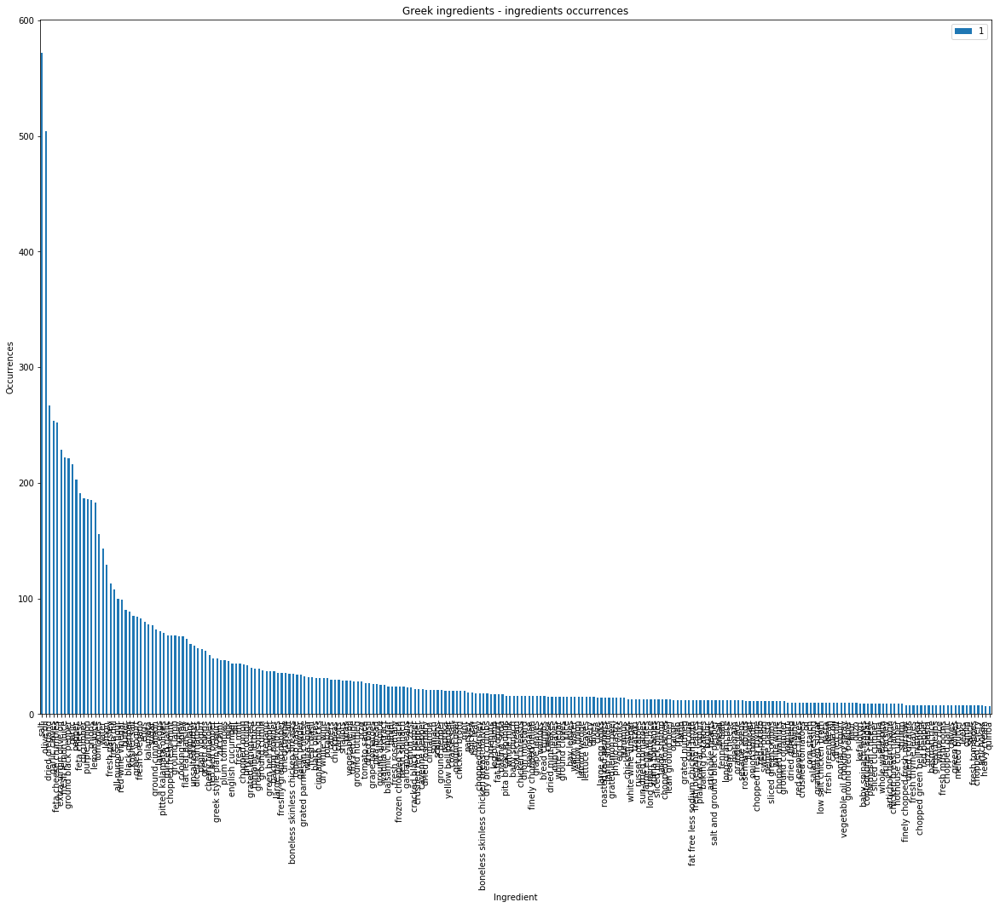

In [14]:
freq_series = df_greek_ingredients
x_labels = df_greek_ingredients[0]

# Plot the figure.
plt.figure(figsize=(50, 100))
ax = freq_series.plot(kind='bar')
ax.set_title('Greek ingredients - ingredients occurrences')
ax.set_xlabel('Ingredient')
ax.set_ylabel('Occurrences')
ax.set_xticklabels(x_labels)

rects = ax.patches
# For each bar: Place a label
for rect in rects:
    # Get X and Y placement of label from rect.
    y_value = rect.get_height()
    x_value = rect.get_x() + rect.get_width() / 2
    # Number of points between bar and label. Change to your liking.
    space = 5
    # Use Y value as label and format number with one decimal place
    label = "{:.1f}".format(y_value)
plt.show()

In [15]:
df_filipino_ingredients = pd.DataFrame(cuisine_top250_ingredients['filipino'])
df_filipino_ingredients

,0,1
0,salt,421
1,garlic,325
2,water,310
3,onions,310
4,soy sauce,251
5,pepper,199
6,oil,166
7,sugar,136
8,carrots,128
9,ground black pepper,124


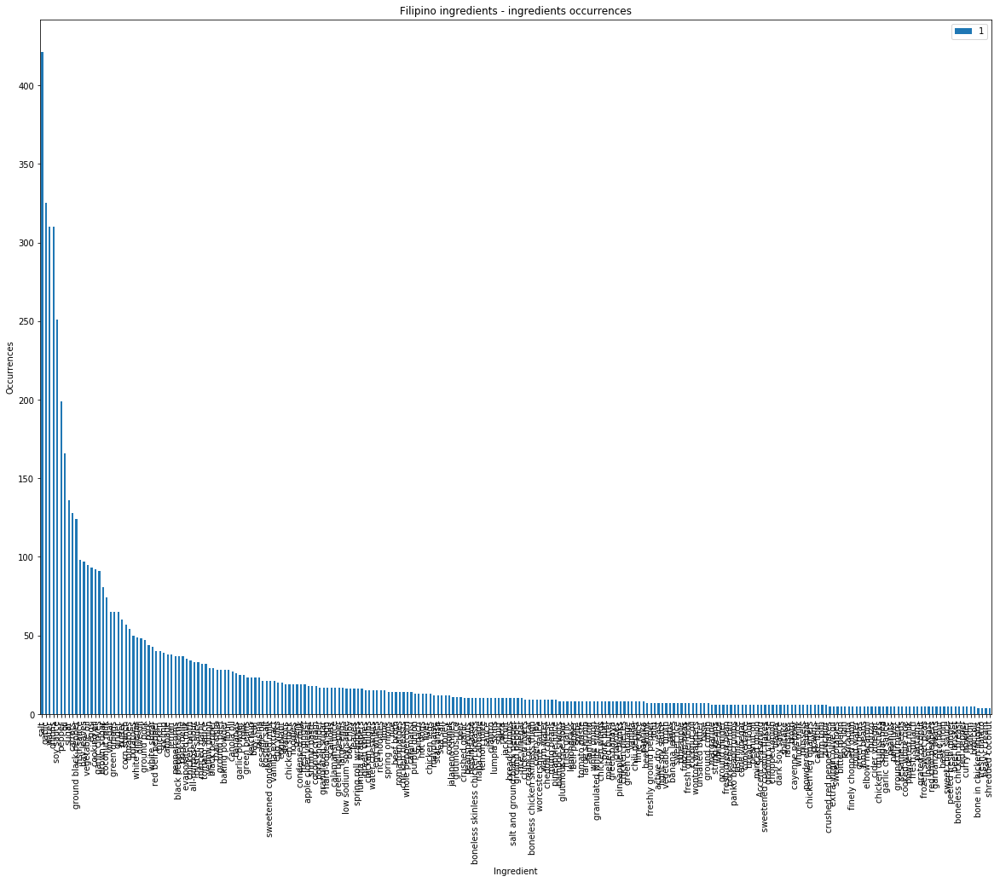

In [16]:
freq_series = df_filipino_ingredients
x_labels = df_filipino_ingredients[0]

# Plot the figure.
plt.figure(figsize=(50, 100))
ax = freq_series.plot(kind='bar')
ax.set_title('Filipino ingredients - ingredients occurrences')
ax.set_xlabel('Ingredient')
ax.set_ylabel('Occurrences')
ax.set_xticklabels(x_labels)

rects = ax.patches
# For each bar: Place a label
for rect in rects:
    # Get X and Y placement of label from rect.
    y_value = rect.get_height()
    x_value = rect.get_x() + rect.get_width() / 2
    # Number of points between bar and label. Change to your liking.
    space = 5
    # Use Y value as label and format number with one decimal place
    label = "{:.1f}".format(y_value)
plt.show()

In [17]:
df_jamaican_ingredients = pd.DataFrame(cuisine_top250_ingredients['jamaican'])

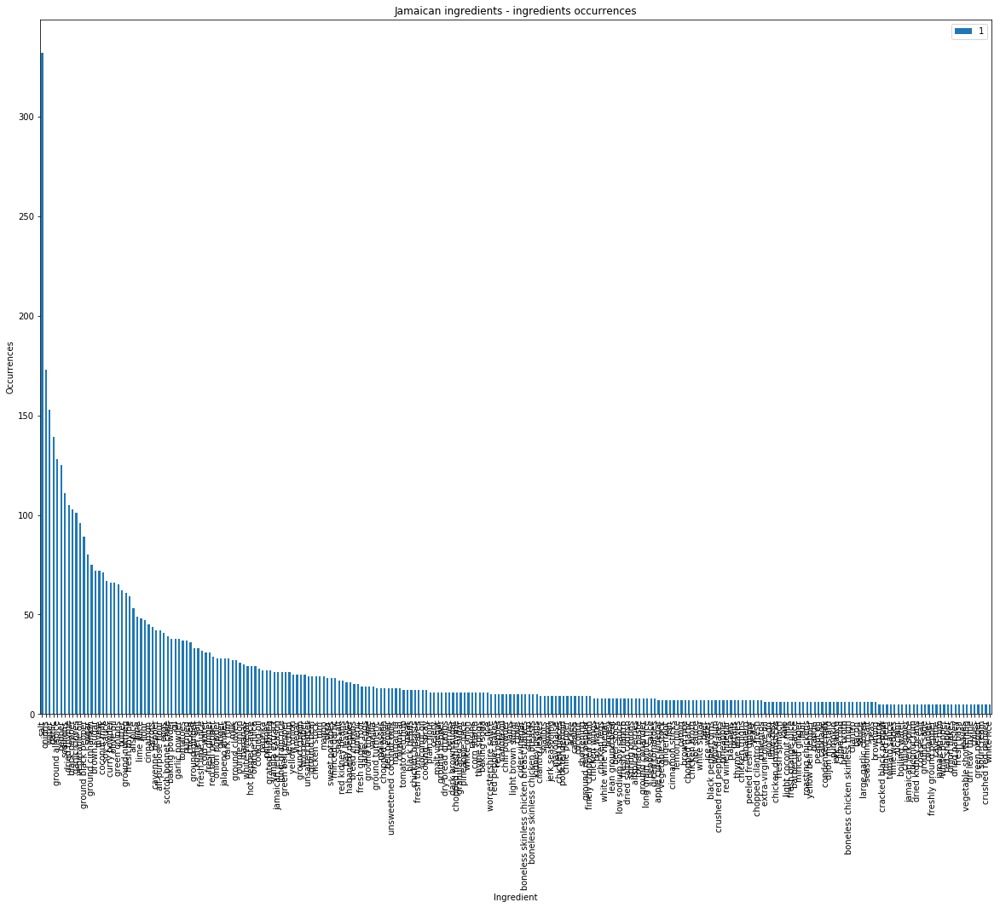

In [18]:
freq_series = df_jamaican_ingredients
x_labels = df_jamaican_ingredients[0]

# Plot the figure.
plt.figure(figsize=(50, 100))
ax = freq_series.plot(kind='bar')
ax.set_title('Jamaican ingredients - ingredients occurrences')
ax.set_xlabel('Ingredient')
ax.set_ylabel('Occurrences')
ax.set_xticklabels(x_labels)

rects = ax.patches
# For each bar: Place a label
for rect in rects:
    # Get X and Y placement of label from rect.
    y_value = rect.get_height()
    x_value = rect.get_x() + rect.get_width() / 2
    # Number of points between bar and label. Change to your liking.
    space = 5
    # Use Y value as label and format number with one decimal place
    label = "{:.1f}".format(y_value)
plt.show()

In [19]:
#now I am putting all of the top ingredients for all 20 cuisines into one list 20 * 250 = 5000

In [20]:
allthetopingredients=[]
for cuisine in trainData['cuisine'].unique():
    for item in cuisine_top250_ingredients[cuisine]:
        ingredient, amount = item
        print (ingredient)
        allthetopingredients.append(ingredient)

print(len(allthetopingredients))


salt
olive oil
dried oregano
garlic cloves
feta cheese crumbles
extra-virgin olive oil
fresh lemon juice
ground black pepper
garlic
pepper
feta cheese
cucumber
purple onion
onions
lemon juice
tomatoes
water
lemon
fresh parsley
fresh dill
all-purpose flour
red wine vinegar
butter
black pepper
kosher salt
greek yogurt
fresh oregano
eggs
kalamata
sugar
ground cinnamon
large eggs
pitted kalamata olives
minced garlic
chopped fresh mint
ground lamb
honey
cooking spray
flat leaf parsley
eggplant
unsalted butter
diced tomatoes
plain yogurt
green onions
cherry tomatoes
red bell pepper
greek style plain yogurt
zucchini
plum tomatoes
milk
english cucumber
dill
fresh mint
chopped onion
phyllo dough
grated lemon zest
romaine lettuce
greek seasoning
ground cumin
oregano
green bell pepper
baking powder
large garlic cloves
freshly ground pepper
dried thyme
sea salt
boneless skinless chicken breasts
tomato paste
garlic powder
grated parmesan cheese
white sugar
fresh basil
black olives
cinnamon sticks
d

sage leaves
Italian bread
romano cheese
half & half
grated lemon peel
freshly grated parmesan
fresh spinach
bow-tie pasta
ground cinnamon
hot water
yellow bell pepper
unsweetened cocoa powder
chicken
fontina cheese
corn starch
granulated sugar
egg yolks
dried porcini mushrooms
vegetable broth
sausage casings
low sodium chicken broth
fine sea salt
large shrimp
ground pepper
bread flour
hot red pepper flakes
paprika
Italian parsley leaves
bread crumb fresh
white wine vinegar
vegetable oil cooking spray
heavy whipping cream
asiago
juice
ground pork
sweet italian sausage
chees fresh mozzarella
cornmeal
seasoned bread crumbs
dry yeast
sour cream
pizza sauce
green beans
medium shrimp
sweet onion
powdered sugar
chopped garlic
chopped fresh chives
baking soda
all purpose unbleached flour
feta cheese crumbles
1% low-fat milk
black olives
frozen peas
cremini mushrooms
brown sugar
salt and ground black pepper
yellow corn meal
grated nutmeg
broccoli
broccoli florets
mayonaise
boiling water
swiss c

ground white pepper
fat free less sodium chicken broth
water chestnuts
mint
freshly ground pepper
hoisin sauce
lemon
boneless chicken breast
toasted sesame seeds
cilantro stems
salted roast peanuts
asparagus
all-purpose flour
basmati rice
mung bean sprouts
fresh mushrooms
chile paste
pineapple
prawns
hot water
sliced mushrooms
pork
salted peanuts
baby bok choy
paprika
chillies
cashew nuts
tamari soy sauce
noodles
black peppercorns
linguine
chile pepper
tamarind concentrate
coconut sugar
serrano chilies
broccoli florets
dried rice noodles
chicken wings
peanut sauce
fresh red chili
wide rice noodles
pork tenderloin
lettuce leaves
cooked chicken breasts
ginger root
tomato paste
sticky rice
tamarind
coconut
butternut squash
rice paper
cooked chicken
hot sauce
fish sauce
sugar
salt
garlic
water
carrots
soy sauce
shallots
garlic cloves
vegetable oil
rice vinegar
beansprouts
green onions
fresh lime juice
lime juice
onions
ground black pepper
cilantro leaves
cucumber
scallions
lemongrass
lime


dark soy sauce
worcestershire sauce
red chili peppers
salmon
extra-virgin olive oil
beansprouts
yellow onion
chives
soba
english cucumber
wasabi powder
frozen peas
chicken thighs
chili oil
peanut oil
potato starch
extra firm tofu
japanese eggplants
leeks
shoyu
cake flour
cornflour
snow peas
chicken breasts
edamame
unsalted butter
japanese rice
cilantro
nori sheets
yellow miso
hot water
cooking spray
zucchini
shiso
ginger paste
cream cheese
ground cumin
clove
amchur
dark sesame oil
curry powder
vanilla extract
eggplant
rice wine
vegetable broth
dashi kombu
freshly ground pepper
baking soda
shichimi togarashi
baby spinach
egg whites
red pepper flakes
brown rice
cashew nuts
white pepper
ginger root
dashi powder
radishes
wakame
garlic powder
coriander seeds
ground ginger
white onion
gingerroot
soft tofu
smoked salmon
chicken broth
noodles
silken tofu
fine sea salt
seasoned rice wine vinegar
cooked rice
coriander
chili paste
soft-boiled egg
large shrimp
lemon wedge
panko
spices
teriyaki sau

vegetables
purple onion
ketchup
hot water
dill weed
caviar
smoked salmon
corn starch
chopped walnuts
white wine vinegar
peas
pierogi
bacon
tomato sauce
vanilla beans
brown sugar
chopped parsley
cayenne pepper
dried apricot
dried dillweed
extra-virgin olive oil
boiling water
pork
boiling potatoes
red bell pepper
chicken stock
lean ground beef
garlic powder
worcestershire sauce
pure vanilla extract
dry white wine
turnips
yukon gold potatoes
all purpose unbleached flour
minced garlic
celery root
vodka
vegetable broth
plain flour
unsweetened cocoa powder
blanched almonds
kidney beans
red beets
orange juice
clove
mustard
almond extract
savoy cabbage
button mushrooms
shredded cabbage
beef stock
slivered almonds
egg noodles
potato starch
mashed potatoes
pickled beets
salmon
fresh cilantro
bread crumbs
long grain white rice
frozen peas
cremini mushrooms
sausages
horseradish
brandy
cinnamon sticks
thyme
chicken breasts
dark brown sugar
sweet onion
ground pepper
plain yogurt
finely chopped onion

In [104]:
#removing duplicates

In [23]:
unique_top_ingredient_list=[]
for i in allthetopingredients:
    if i not in unique_top_ingredient_list:
        unique_top_ingredient_list.append(i)
print(len(unique_top_ingredient_list))

1278


In [ ]:
#not bothering to discard for now

In [24]:
trainData.head()

,cuisine,id,ingredients
0,greek,10259,"[romaine lettuce, black olives, grape tomatoes..."
1,southern_us,25693,"[plain flour, ground pepper, salt, tomatoes, g..."
2,filipino,20130,"[eggs, pepper, salt, mayonaise, cooking oil, g..."
3,indian,22213,"[water, vegetable oil, wheat, salt]"
4,indian,13162,"[black pepper, shallots, cornflour, cayenne pe..."


In [25]:
testdf = trainData

In [26]:
testdf.head()

,cuisine,id,ingredients
0,greek,10259,"[romaine lettuce, black olives, grape tomatoes..."
1,southern_us,25693,"[plain flour, ground pepper, salt, tomatoes, g..."
2,filipino,20130,"[eggs, pepper, salt, mayonaise, cooking oil, g..."
3,indian,22213,"[water, vegetable oil, wheat, salt]"
4,indian,13162,"[black pepper, shallots, cornflour, cayenne pe..."


In [28]:
print((unique_top_ingredient_list))

['salt', 'olive oil', 'dried oregano', 'garlic cloves', 'feta cheese crumbles', 'extra-virgin olive oil', 'fresh lemon juice', 'ground black pepper', 'garlic', 'pepper', 'feta cheese', 'cucumber', 'purple onion', 'onions', 'lemon juice', 'tomatoes', 'water', 'lemon', 'fresh parsley', 'fresh dill', 'all-purpose flour', 'red wine vinegar', 'butter', 'black pepper', 'kosher salt', 'greek yogurt', 'fresh oregano', 'eggs', 'kalamata', 'sugar', 'ground cinnamon', 'large eggs', 'pitted kalamata olives', 'minced garlic', 'chopped fresh mint', 'ground lamb', 'honey', 'cooking spray', 'flat leaf parsley', 'eggplant', 'unsalted butter', 'diced tomatoes', 'plain yogurt', 'green onions', 'cherry tomatoes', 'red bell pepper', 'greek style plain yogurt', 'zucchini', 'plum tomatoes', 'milk', 'english cucumber', 'dill', 'fresh mint', 'chopped onion', 'phyllo dough', 'grated lemon zest', 'romaine lettuce', 'greek seasoning', 'ground cumin', 'oregano', 'green bell pepper', 'baking powder', 'large garlic 

In [107]:
#now create an empty matrix to count up the appearance of these 1278 ingredients in the recipes

In [29]:
myworkingmatrix = numpy.zeros((len(testdf),len(unique_top_ingredient_list))).astype(int)

In [30]:
final_ingredients_features = unique_top_ingredient_list

myworkingmatrix

array([[0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       ...,
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0]])

In [31]:
for i, row in testdf.iterrows():
    
    print(row)
    a,b,c = row 
    print ("this is a %s" % a)
    print ("this is b %s" % b)
    print ("this is c %s" % c)
    print("ingredients")
    print(c)
    for ingredientitem in c:
        if ingredientitem in final_ingredients_features:
            myworkingmatrix[i,final_ingredients_features.index(ingredientitem)] = 1


cuisine                                                    greek
id                                                         10259
ingredients    [romaine lettuce, black olives, grape tomatoes...
Name: 0, dtype: object
this is a greek
this is b 10259
this is c ['romaine lettuce', 'black olives', 'grape tomatoes', 'garlic', 'pepper', 'purple onion', 'seasoning', 'garbanzo beans', 'feta cheese crumbles']
ingredients
['romaine lettuce', 'black olives', 'grape tomatoes', 'garlic', 'pepper', 'purple onion', 'seasoning', 'garbanzo beans', 'feta cheese crumbles']
cuisine                                              southern_us
id                                                         25693
ingredients    [plain flour, ground pepper, salt, tomatoes, g...
Name: 1, dtype: object
this is a southern_us
this is b 25693
this is c ['plain flour', 'ground pepper', 'salt', 'tomatoes', 'ground black pepper', 'thyme', 'eggs', 'green tomatoes', 'yellow corn meal', 'milk', 'vegetable oil']
ingredients
['pl

this is a mexican
this is b 41078
this is c ['refried beans', 'grated jack cheese', 'hot sauce', 'sour cream']
ingredients
['refried beans', 'grated jack cheese', 'hot sauce', 'sour cream']
cuisine                                                  spanish
id                                                         20665
ingredients    [ground cinnamon, cornflour, milk, egg yolks, ...
Name: 133, dtype: object
this is a spanish
this is b 20665
this is c ['ground cinnamon', 'cornflour', 'milk', 'egg yolks', 'sugar', 'cinnamon sticks']
ingredients
['ground cinnamon', 'cornflour', 'milk', 'egg yolks', 'sugar', 'cinnamon sticks']
cuisine                                                   french
id                                                         39471
ingredients    [grated parmesan cheese, asparagus, bacon slic...
Name: 134, dtype: object
this is a french
this is b 39471
this is c ['grated parmesan cheese', 'asparagus', 'bacon slices', 'ground black pepper', 'green onions', 'large eggs'

Name: 238, dtype: object
this is a italian
this is b 23521
this is c ['potatoes', 'eggs', 'all-purpose flour', 'self rising flour']
ingredients
['potatoes', 'eggs', 'all-purpose flour', 'self rising flour']
cuisine                                                 jamaican
id                                                         28342
ingredients    [black pepper, apple cider vinegar, garlic, br...
Name: 239, dtype: object
this is a jamaican
this is b 28342
this is c ['black pepper', 'apple cider vinegar', 'garlic', 'brown sugar', 'jamaican jerk season', 'red pepper flakes', 'salt', 'olive oil', 'butter', 'purple onion', 'pineapple preserves', 'shallots', 'chicken drumsticks', 'red bell pepper']
ingredients
['black pepper', 'apple cider vinegar', 'garlic', 'brown sugar', 'jamaican jerk season', 'red pepper flakes', 'salt', 'olive oil', 'butter', 'purple onion', 'pineapple preserves', 'shallots', 'chicken drumsticks', 'red bell pepper']
cuisine                                           

Name: 334, dtype: object
this is a mexican
this is b 1667
this is c ['Old El Pasoâ„¢ mild red enchilada sauce', 'Pillsburyâ„¢ Refrigerated Crescent Dinner Rolls', 'Mexican cheese blend', 'cooked chicken', 'refrigerated crescent rolls', 'red enchilada sauce', 'cooked chicken', 'Mexican cheese blend']
ingredients
['Old El Pasoâ„¢ mild red enchilada sauce', 'Pillsburyâ„¢ Refrigerated Crescent Dinner Rolls', 'Mexican cheese blend', 'cooked chicken', 'refrigerated crescent rolls', 'red enchilada sauce', 'cooked chicken', 'Mexican cheese blend']
cuisine                                                  mexican
id                                                         48571
ingredients    [jumbo shrimp, sea scallops, grate lime peel, ...
Name: 335, dtype: object
this is a mexican
this is b 48571
this is c ['jumbo shrimp', 'sea scallops', 'grate lime peel', 'olive oil', 'chopped onion', 'chopped cilantro', 'bottled clam juice', 'white hominy', 'sun-dried tomatoes in oil', 'salsa verde', 'garli

Name: 421, dtype: object
this is a indian
this is b 46635
this is c ['fresh ginger', 'paprika', 'garlic cloves', 'fresh lemon', 'ground coriander', 'ground turmeric', 'jalapeno chilies', 'salt', 'chopped cilantro fresh', 'vegetable oil', 'catfish']
ingredients
['fresh ginger', 'paprika', 'garlic cloves', 'fresh lemon', 'ground coriander', 'ground turmeric', 'jalapeno chilies', 'salt', 'chopped cilantro fresh', 'vegetable oil', 'catfish']
cuisine                                                  italian
id                                                         20149
ingredients    [vegetables, basil, basil pesto sauce, aioli, ...
Name: 422, dtype: object
this is a italian
this is b 20149
this is c ['vegetables', 'basil', 'basil pesto sauce', 'aioli', 'cooked shrimp', 'prosciutto', 'mozzarella balls', 'sun-dried tomatoes', 'salami']
ingredients
['vegetables', 'basil', 'basil pesto sauce', 'aioli', 'cooked shrimp', 'prosciutto', 'mozzarella balls', 'sun-dried tomatoes', 'salami']
cuisine 

Name: 523, dtype: object
this is a italian
this is b 1066
this is c ['fresh basil', 'green onions', 'garlic salt', 'ground black pepper', 'salt', 'plum tomatoes', 'olive oil', 'garlic', 'boneless skinless chicken breast halves', 'grated parmesan cheese', 'lemon juice']
ingredients
['fresh basil', 'green onions', 'garlic salt', 'ground black pepper', 'salt', 'plum tomatoes', 'olive oil', 'garlic', 'boneless skinless chicken breast halves', 'grated parmesan cheese', 'lemon juice']
cuisine                                                 moroccan
id                                                          5687
ingredients    [dried apricot, ground coriander, chopped fres...
Name: 524, dtype: object
this is a moroccan
this is b 5687
this is c ['dried apricot', 'ground coriander', 'chopped fresh mint', 'ground black pepper', 'salt', 'couscous', 'olive oil', 'purple onion', 'leg of lamb', 'ground cumin', 'large garlic cloves', 'fresh lemon juice', 'grated lemon peel']
ingredients
['dried apri

['olive oil', 'all-purpose flour', 'salt', 'sugar']
cuisine                                                    greek
id                                                         28232
ingredients    [ground black pepper, phyllo, onions, myzithra...
Name: 632, dtype: object
this is a greek
this is b 28232
this is c ['ground black pepper', 'phyllo', 'onions', 'myzithra', 'Greek feta', 'salt', 'large eggs', 'extra-virgin olive oil', 'fresh dill', 'yoghurt', 'kefalotyri']
ingredients
['ground black pepper', 'phyllo', 'onions', 'myzithra', 'Greek feta', 'salt', 'large eggs', 'extra-virgin olive oil', 'fresh dill', 'yoghurt', 'kefalotyri']
cuisine                                              southern_us
id                                                          6185
ingredients    [water, all-purpose flour, unsalted butter, ch...
Name: 633, dtype: object
this is a southern_us
this is b 6185
this is c ['water', 'all-purpose flour', 'unsalted butter', 'chopped pecans', 'sugar', 'salt', 'nectari

Name: 738, dtype: object
this is a southern_us
this is b 12354
this is c ['milk', 'gravy', 'salt', 'seasoned flour', 'pepper', 'unsalted butter', 'buttermilk', 'peanut oil', 'kosher salt', 'ground pepper', 'onion powder', 'round steaks', 'eggs', 'garlic powder', 'chili powder', 'all-purpose flour']
ingredients
['milk', 'gravy', 'salt', 'seasoned flour', 'pepper', 'unsalted butter', 'buttermilk', 'peanut oil', 'kosher salt', 'ground pepper', 'onion powder', 'round steaks', 'eggs', 'garlic powder', 'chili powder', 'all-purpose flour']
cuisine                                                    greek
id                                                         28421
ingredients    [vinaigrette dressing, ground black pepper, ch...
Name: 739, dtype: object
this is a greek
this is b 28421
this is c ['vinaigrette dressing', 'ground black pepper', 'cherry tomatoes', 'lemon juice', 'kale', 'kalamata', 'feta cheese', 'oregano']
ingredients
['vinaigrette dressing', 'ground black pepper', 'cherry tom

Name: 838, dtype: object
this is a thai
this is b 8871
this is c ['sugar', 'green onions', 'garlic cloves', 'pork tenderloin', 'salt', 'dry roasted peanuts', 'pineapple', 'serrano chile', 'fish sauce', 'cooking spray', 'cilantro leaves']
ingredients
['sugar', 'green onions', 'garlic cloves', 'pork tenderloin', 'salt', 'dry roasted peanuts', 'pineapple', 'serrano chile', 'fish sauce', 'cooking spray', 'cilantro leaves']
cuisine                                                     thai
id                                                         35487
ingredients    [crusty bread, lemongrass, skinless chicken br...
Name: 839, dtype: object
this is a thai
this is b 35487
this is c ['crusty bread', 'lemongrass', 'skinless chicken breasts', 'coriander', 'chicken stock', 'red chili peppers', 'sweet potatoes', 'garlic cloves', 'sugar', 'olive oil', 'coconut cream', 'fish sauce', 'lime juice', 'ginger', 'curry paste']
ingredients
['crusty bread', 'lemongrass', 'skinless chicken breasts', 'coriand

Name: 938, dtype: object
this is a chinese
this is b 15860
this is c ['sugar', 'baking soda', 'ginger', 'onions', 'white pepper', 'rice wine', 'oyster sauce', 'soy sauce', 'boneless skinless chicken breasts', 'salt', 'cashew nuts', 'green bell pepper', 'water', 'sesame oil', 'corn starch']
ingredients
['sugar', 'baking soda', 'ginger', 'onions', 'white pepper', 'rice wine', 'oyster sauce', 'soy sauce', 'boneless skinless chicken breasts', 'salt', 'cashew nuts', 'green bell pepper', 'water', 'sesame oil', 'corn starch']
cuisine                                                   indian
id                                                         27077
ingredients    [clove, cinnamon, ground coriander, ground cum...
Name: 939, dtype: object
this is a indian
this is b 27077
this is c ['clove', 'cinnamon', 'ground coriander', 'ground cumin', 'fresh ginger root', 'salt', 'chopped cilantro fresh', 'garbanzo beans', 'garlic', 'onions', 'vegetable oil', 'cayenne pepper', 'ground turmeric']
ingredi

Name: 1046, dtype: object
this is a mexican
this is b 25566
this is c ['minced garlic', 'shredded mozzarella cheese', 'boneless skinless chicken breast halves', 'olive oil', 'corn tortillas', 'water', 'sour cream', 'chicken bouillon granules', 'poblano chilies', 'onions']
ingredients
['minced garlic', 'shredded mozzarella cheese', 'boneless skinless chicken breast halves', 'olive oil', 'corn tortillas', 'water', 'sour cream', 'chicken bouillon granules', 'poblano chilies', 'onions']
cuisine                                                     thai
id                                                          5862
ingredients    [boneless skinless chicken breasts, Thai fish ...
Name: 1047, dtype: object
this is a thai
this is b 5862
this is c ['boneless skinless chicken breasts', 'Thai fish sauce', 'Sriracha', 'peanut butter', 'fresh lime juice', 'garlic', 'fresh mint', 'lime zest', 'rice vinegar', 'coconut milk']
ingredients
['boneless skinless chicken breasts', 'Thai fish sauce', 'Srirac

this is b 7719
this is c ['large garlic cloves', 'plum tomatoes', 'romano cheese', 'fresh oregano']
ingredients
['large garlic cloves', 'plum tomatoes', 'romano cheese', 'fresh oregano']
cuisine                                                 japanese
id                                                         45785
ingredients    [pumpkin, dashi, white sugar, sake, shoyu, mirin]
Name: 1132, dtype: object
this is a japanese
this is b 45785
this is c ['pumpkin', 'dashi', 'white sugar', 'sake', 'shoyu', 'mirin']
ingredients
['pumpkin', 'dashi', 'white sugar', 'sake', 'shoyu', 'mirin']
cuisine                                                  italian
id                                                          3301
ingredients    [tomatoes, ground black pepper, flat leaf pars...
Name: 1133, dtype: object
this is a italian
this is b 3301
this is c ['tomatoes', 'ground black pepper', 'flat leaf parsley', 'olive oil', 'garlic', 'capers', 'kalamata', 'spaghetti', 'feta cheese', 'salt']
ingredien

Name: 1251, dtype: object
this is a cajun_creole
this is b 45394
this is c ['black beans', 'parsley', 'chopped celery', 'frozen spinach', 'ditalini pasta', 'basil', 'butter beans', 'andouille sausage', 'soup', 'garlic', 'finely chopped onion', 'diced tomatoes', 'beef broth']
ingredients
['black beans', 'parsley', 'chopped celery', 'frozen spinach', 'ditalini pasta', 'basil', 'butter beans', 'andouille sausage', 'soup', 'garlic', 'finely chopped onion', 'diced tomatoes', 'beef broth']
cuisine                                                 mexican
id                                                        29478
ingredients    [garlic, chiles, eggs, masa harina, kosher salt]
Name: 1252, dtype: object
this is a mexican
this is b 29478
this is c ['garlic', 'chiles', 'eggs', 'masa harina', 'kosher salt']
ingredients
['garlic', 'chiles', 'eggs', 'masa harina', 'kosher salt']
cuisine                                                  italian
id                                                    

Name: 1351, dtype: object
this is a french
this is b 47012
this is c ['tomatoes', 'clam juice', 'onions', 'salmon fillets', 'salt', 'pepper', 'margarine', 'green cabbage', 'chopped fresh chives', 'low salt chicken broth']
ingredients
['tomatoes', 'clam juice', 'onions', 'salmon fillets', 'salt', 'pepper', 'margarine', 'green cabbage', 'chopped fresh chives', 'low salt chicken broth']
cuisine                                                  mexican
id                                                         13678
ingredients    [brown sugar, salt, pork, onions, taco sauce, ...
Name: 1352, dtype: object
this is a mexican
this is b 13678
this is c ['brown sugar', 'salt', 'pork', 'onions', 'taco sauce', 'salsa', 'picante sauce', 'chopped garlic']
ingredients
['brown sugar', 'salt', 'pork', 'onions', 'taco sauce', 'salsa', 'picante sauce', 'chopped garlic']
cuisine                                                 filipino
id                                                         46392
ingred

Name: 1460, dtype: object
this is a indian
this is b 13833
this is c ['water', 'coconut milk', 'butter beans', 'pepper', 'salt', 'chopped cilantro fresh', 'frozen spinach', 'vegetable oil', 'onions', 'pumpkin', 'curry paste']
ingredients
['water', 'coconut milk', 'butter beans', 'pepper', 'salt', 'chopped cilantro fresh', 'frozen spinach', 'vegetable oil', 'onions', 'pumpkin', 'curry paste']
cuisine                                                  italian
id                                                         39178
ingredients    [vanilla extract, white sugar, egg whites, all...
Name: 1461, dtype: object
this is a italian
this is b 39178
this is c ['vanilla extract', 'white sugar', 'egg whites', 'all-purpose flour', 'sugar', 'salt', 'egg yolks', 'confectioners sugar']
ingredients
['vanilla extract', 'white sugar', 'egg whites', 'all-purpose flour', 'sugar', 'salt', 'egg yolks', 'confectioners sugar']
cuisine                                                  italian
id               

ingredients
['chicken broth', 'cannellini beans', 'celery', 'tomato sauce', 'garlic', 'dried parsley', 'tomatoes', 'crushed red pepper flakes', 'onions', 'pasta', 'olive oil', 'salt', 'italian seasoning']
cuisine                                                   korean
id                                                           196
ingredients    [ground black pepper, vegetable oil, salt, soy...
Name: 1548, dtype: object
this is a korean
this is b 196
this is c ['ground black pepper', 'vegetable oil', 'salt', 'soy sauce', 'spring onions', 'garlic', 'beef rib short', 'sugar', 'peeled fresh ginger', 'kirby cucumbers', 'dark sesame oil', 'fresh ginger', 'marinade', 'crushed red pepper']
ingredients
['ground black pepper', 'vegetable oil', 'salt', 'soy sauce', 'spring onions', 'garlic', 'beef rib short', 'sugar', 'peeled fresh ginger', 'kirby cucumbers', 'dark sesame oil', 'fresh ginger', 'marinade', 'crushed red pepper']
cuisine                                                  italian
id

cuisine                                                 italian
id                                                         3136
ingredients    [flat leaf parsley, pistachios, olive oil, salt]
Name: 1631, dtype: object
this is a italian
this is b 3136
this is c ['flat leaf parsley', 'pistachios', 'olive oil', 'salt']
ingredients
['flat leaf parsley', 'pistachios', 'olive oil', 'salt']
cuisine                                                   french
id                                                         11643
ingredients    [Madeira, fresh mushrooms, olive oil, corn sta...
Name: 1632, dtype: object
this is a french
this is b 11643
this is c ['Madeira', 'fresh mushrooms', 'olive oil', 'corn starch', 'water', 'chuck steaks', 'shallots']
ingredients
['Madeira', 'fresh mushrooms', 'olive oil', 'corn starch', 'water', 'chuck steaks', 'shallots']
cuisine                                                 japanese
id                                                          2708
ingredients    

Name: 1744, dtype: object
this is a mexican
this is b 37830
this is c ['pepper', 'tomatillos', 'yellow onion', 'water', 'cilantro', 'cumin', 'lime juice', 'garlic', 'jalapeno chilies', 'salt']
ingredients
['pepper', 'tomatillos', 'yellow onion', 'water', 'cilantro', 'cumin', 'lime juice', 'garlic', 'jalapeno chilies', 'salt']
cuisine                                              southern_us
id                                                         28771
ingredients    [kosher salt, heavy cream, unsalted butter, co...
Name: 1745, dtype: object
this is a southern_us
this is b 28771
this is c ['kosher salt', 'heavy cream', 'unsalted butter', 'corn grits', 'water', 'ground white pepper', 'whole milk']
ingredients
['kosher salt', 'heavy cream', 'unsalted butter', 'corn grits', 'water', 'ground white pepper', 'whole milk']
cuisine                                                 japanese
id                                                         35355
ingredients    [butter, sugar, carrots, c

Name: 1846, dtype: object
this is a indian
this is b 35139
this is c ['cold water', 'curry powder', 'fresh ginger root', 'purple onion', 'red curry paste', 'ground turmeric', 'shortening', 'olive oil', 'garlic', 'cilantro leaves', 'lamb', 'ground cinnamon', 'milk', 'butter', 'salt', 'cayenne pepper', 'ground cumin', 'white wine', 'eggplant', 'chopped celery', 'all-purpose flour', 'red bell pepper']
ingredients
['cold water', 'curry powder', 'fresh ginger root', 'purple onion', 'red curry paste', 'ground turmeric', 'shortening', 'olive oil', 'garlic', 'cilantro leaves', 'lamb', 'ground cinnamon', 'milk', 'butter', 'salt', 'cayenne pepper', 'ground cumin', 'white wine', 'eggplant', 'chopped celery', 'all-purpose flour', 'red bell pepper']
cuisine                                                  italian
id                                                         23201
ingredients    [fish fillets, unsalted butter, shallots, fres...
Name: 1847, dtype: object
this is a italian
this is b 2320

['water', 'garlic cloves', 'cabbage', 'seasoning', 'fresh green bean', 'red bell pepper', 'soy sauce', 'chicken stock cubes', 'onions', 'tofu', 'rice noodles', 'carrots', 'canola oil']
cuisine                                              southern_us
id                                                         40704
ingredients    [ketchup, green tomatoes, cornmeal, cayenne, b...
Name: 1926, dtype: object
this is a southern_us
this is b 40704
this is c ['ketchup', 'green tomatoes', 'cornmeal', 'cayenne', 'buttermilk', 'pepper', 'vegetable oil', 'mayonaise', 'self rising flour', 'salt']
ingredients
['ketchup', 'green tomatoes', 'cornmeal', 'cayenne', 'buttermilk', 'pepper', 'vegetable oil', 'mayonaise', 'self rising flour', 'salt']
cuisine                                             cajun_creole
id                                                         14371
ingredients    [crawfish, creole seasoning, chips, vegetable ...
Name: 1927, dtype: object
this is a cajun_creole
this is b 14371
th

Name: 1995, dtype: object
this is a chinese
this is b 30568
this is c ['water', 'black chicken', 'seeds', 'goji berries', 'mushrooms', 'yams', 'ginger']
ingredients
['water', 'black chicken', 'seeds', 'goji berries', 'mushrooms', 'yams', 'ginger']
cuisine                                                     thai
id                                                         10891
ingredients    [lime juice, chopped cilantro fresh, fish sauc...
Name: 1996, dtype: object
this is a thai
this is b 10891
this is c ['lime juice', 'chopped cilantro fresh', 'fish sauce', 'roasted peanuts', 'fresh ginger', 'sugar', 'garlic cloves']
ingredients
['lime juice', 'chopped cilantro fresh', 'fish sauce', 'roasted peanuts', 'fresh ginger', 'sugar', 'garlic cloves']
cuisine                                                   indian
id                                                         11260
ingredients    [plain yogurt, potatoes, ground coriander, cho...
Name: 1997, dtype: object
this is a indian
this is 

Name: 2113, dtype: object
this is a italian
this is b 14158
this is c ['large eggs', 'extra-virgin olive oil', 'Italian bread', 'spaghetti', 'olive oil', 'ground veal', 'garlic cloves', 'ground beef', 'tomatoes', 'whole milk', 'grated lemon zest', 'flat leaf parsley', 'oregano', 'parmigiano reggiano cheese', 'ground pork', 'juice', 'onions']
ingredients
['large eggs', 'extra-virgin olive oil', 'Italian bread', 'spaghetti', 'olive oil', 'ground veal', 'garlic cloves', 'ground beef', 'tomatoes', 'whole milk', 'grated lemon zest', 'flat leaf parsley', 'oregano', 'parmigiano reggiano cheese', 'ground pork', 'juice', 'onions']
cuisine                                              southern_us
id                                                         27865
ingredients    [kosher salt, onion powder, cayenne pepper, gr...
Name: 2114, dtype: object
this is a southern_us
this is b 27865
this is c ['kosher salt', 'onion powder', 'cayenne pepper', 'ground black pepper', 'paprika', 'corn starch', 'g

Name: 2213, dtype: object
this is a italian
this is b 42142
this is c ['celery ribs', 'olive oil', 'diced tomatoes', 'green beans', 'dried pasta', 'cannellini beans', 'dri leav thyme', 'onions', 'kosher salt', 'freshly grated parmesan', 'broccoli', 'low sodium beef broth', 'water', 'yukon gold potatoes', 'carrots', 'cabbage']
ingredients
['celery ribs', 'olive oil', 'diced tomatoes', 'green beans', 'dried pasta', 'cannellini beans', 'dri leav thyme', 'onions', 'kosher salt', 'freshly grated parmesan', 'broccoli', 'low sodium beef broth', 'water', 'yukon gold potatoes', 'carrots', 'cabbage']
cuisine                                                  mexican
id                                                         12932
ingredients    [tomatoes, green onions, avocado, chili, lime ...
Name: 2214, dtype: object
this is a mexican
this is b 12932
this is c ['tomatoes', 'green onions', 'avocado', 'chili', 'lime juice', 'chopped cilantro fresh', 'minced garlic', 'spaghetti']
ingredients
['toma

Name: 2297, dtype: object
this is a chinese
this is b 46756
this is c ['sugar', 'garlic', 'fresh ginger', 'chinese five-spice powder', 'soy sauce', 'rice vinegar', 'ground black pepper', 'beef ribs']
ingredients
['sugar', 'garlic', 'fresh ginger', 'chinese five-spice powder', 'soy sauce', 'rice vinegar', 'ground black pepper', 'beef ribs']
cuisine                                                  mexican
id                                                         20745
ingredients    [chicken broth, cumin, chicken breasts, garlic...
Name: 2298, dtype: object
this is a mexican
this is b 20745
this is c ['chicken broth', 'cumin', 'chicken breasts', 'garlic powder', 'salsa']
ingredients
['chicken broth', 'cumin', 'chicken breasts', 'garlic powder', 'salsa']
cuisine                                              southern_us
id                                                            88
ingredients    [sugar, ground red pepper, whole kernel corn, ...
Name: 2299, dtype: object
this is a southe

Name: 2403, dtype: object
this is a italian
this is b 15041
this is c ['kosher salt', 'bell pepper', 'yellow onion', 'parmesan cheese', 'red wine vinegar', 'red bell pepper', 'minced garlic', 'cooking spray', 'bucatini', 'fresh basil', 'zucchini', 'extra-virgin olive oil']
ingredients
['kosher salt', 'bell pepper', 'yellow onion', 'parmesan cheese', 'red wine vinegar', 'red bell pepper', 'minced garlic', 'cooking spray', 'bucatini', 'fresh basil', 'zucchini', 'extra-virgin olive oil']
cuisine                                                  italian
id                                                          7831
ingredients    [grated parmesan cheese, olive oil, penne past...
Name: 2404, dtype: object
this is a italian
this is b 7831
this is c ['grated parmesan cheese', 'olive oil', 'penne pasta', 'roasted red peppers', 'fresh basil leaves', 'pepper', 'salt']
ingredients
['grated parmesan cheese', 'olive oil', 'penne pasta', 'roasted red peppers', 'fresh basil leaves', 'pepper', 'salt'

this is c ['red chili peppers', 'orange', 'ginger', 'oil', 'white vinegar', 'soy sauce', 'flour', 'garlic', 'corn starch', 'eggs', 'white pepper', 'green onions', 'salt', 'sugar', 'water', 'rice wine', 'boneless skinless chicken']
ingredients
['red chili peppers', 'orange', 'ginger', 'oil', 'white vinegar', 'soy sauce', 'flour', 'garlic', 'corn starch', 'eggs', 'white pepper', 'green onions', 'salt', 'sugar', 'water', 'rice wine', 'boneless skinless chicken']
cuisine                                             japanese
id                                                      9303
ingredients    [soy sauce, sake, oil, mirin, salmon fillets]
Name: 2464, dtype: object
this is a japanese
this is b 9303
this is c ['soy sauce', 'sake', 'oil', 'mirin', 'salmon fillets']
ingredients
['soy sauce', 'sake', 'oil', 'mirin', 'salmon fillets']
cuisine                                                   korean
id                                                         44903
ingredients    [dry white win

['parsley sprigs', 'ground black pepper', 'garlic cloves', 'water', 'diced tomatoes', 'flat leaf parsley', 'pepper', 'cooking spray', 'long grain brown rice', 'saffron threads', 'manchego cheese', 'salt']
cuisine                                                  italian
id                                                         21367
ingredients    [chiles, parsley, purple onion, cherry peppers...
Name: 2547, dtype: object
this is a italian
this is b 21367
this is c ['chiles', 'parsley', 'purple onion', 'cherry peppers', 'pepper', 'extra-virgin olive oil', 'dandelion', 'beans', 'balsamic vinegar', 'salt', 'fresh basil leaves', 'green olives', 'roasted red peppers', 'garlic', 'escarole']
ingredients
['chiles', 'parsley', 'purple onion', 'cherry peppers', 'pepper', 'extra-virgin olive oil', 'dandelion', 'beans', 'balsamic vinegar', 'salt', 'fresh basil leaves', 'green olives', 'roasted red peppers', 'garlic', 'escarole']
cuisine                                              southern_us
id 

Name: 2630, dtype: object
this is a mexican
this is b 23847
this is c ['sugar', 'salt', 'jicama', 'chopped fresh mint', 'cilantro sprigs', 'jalapeno chilies', 'fresh lime juice']
ingredients
['sugar', 'salt', 'jicama', 'chopped fresh mint', 'cilantro sprigs', 'jalapeno chilies', 'fresh lime juice']
cuisine                                                   french
id                                                         38005
ingredients    [chili flakes, almonds, salt, water, cilantro,...
Name: 2631, dtype: object
this is a french
this is b 38005
this is c ['chili flakes', 'almonds', 'salt', 'water', 'cilantro', 'onions', 'sugar', 'butter', 'all-purpose flour', 'olive oil', 'garlic']
ingredients
['chili flakes', 'almonds', 'salt', 'water', 'cilantro', 'onions', 'sugar', 'butter', 'all-purpose flour', 'olive oil', 'garlic']
cuisine                                              southern_us
id                                                         36508
ingredients    [whole milk, bacon 

this is b 40385
this is c ['pepper flakes', 'rice cakes', 'garlic', 'carrots', 'leaves', 'chicken drumsticks', 'Gochujang base', 'cabbage', 'soy sauce', 'sweet potatoes', 'cooking wine', 'onions', 'ground black pepper', 'ginger', 'green chilies', 'chicken']
ingredients
['pepper flakes', 'rice cakes', 'garlic', 'carrots', 'leaves', 'chicken drumsticks', 'Gochujang base', 'cabbage', 'soy sauce', 'sweet potatoes', 'cooking wine', 'onions', 'ground black pepper', 'ginger', 'green chilies', 'chicken']
cuisine                                                   french
id                                                         30900
ingredients    [light brown sugar, large eggs, water, salt, c...
Name: 2714, dtype: object
this is a french
this is b 30900
this is c ['light brown sugar', 'large eggs', 'water', 'salt', 'cold water', 'apples', 'unsalted butter', 'all-purpose flour']
ingredients
['light brown sugar', 'large eggs', 'water', 'salt', 'cold water', 'apples', 'unsalted butter', 'all-purp

this is c ['shredded cabbage', 'oregano', 'mayonaise', 'salt', 'lettuce', 'butter', 'pepper', 'bread slices']
ingredients
['shredded cabbage', 'oregano', 'mayonaise', 'salt', 'lettuce', 'butter', 'pepper', 'bread slices']
cuisine                                                  mexican
id                                                         38163
ingredients    [stock, tortillas, hot sauce, onions, pork, ch...
Name: 2797, dtype: object
this is a mexican
this is b 38163
this is c ['stock', 'tortillas', 'hot sauce', 'onions', 'pork', 'chili powder', 'sour cream', 'orange', 'cilantro', 'lard', 'cotija', 'bay leaves', 'enchilada sauce', 'cumin']
ingredients
['stock', 'tortillas', 'hot sauce', 'onions', 'pork', 'chili powder', 'sour cream', 'orange', 'cilantro', 'lard', 'cotija', 'bay leaves', 'enchilada sauce', 'cumin']
cuisine                                                    irish
id                                                         24367
ingredients    [rutabaga, vegetable oil

['bananas', 'crushed ice', 'shredded coconut', 'honeydew melon', 'vanilla ice cream', 'cantaloupe', 'Jell-O Gelatin Dessert', 'papaya', 'tapioca']
cuisine                                                   indian
id                                                         13321
ingredients    [coriander seeds, cinnamon sticks, black peppe...
Name: 2880, dtype: object
this is a indian
this is b 13321
this is c ['coriander seeds', 'cinnamon sticks', 'black peppercorns', 'cumin seed', 'cardamom seeds', 'whole cloves', 'whole nutmegs']
ingredients
['coriander seeds', 'cinnamon sticks', 'black peppercorns', 'cumin seed', 'cardamom seeds', 'whole cloves', 'whole nutmegs']
cuisine                                              southern_us
id                                                         37567
ingredients    [peaches, raw sugar, ground cinnamon, large fr...
Name: 2881, dtype: object
this is a southern_us
this is b 37567
this is c ['peaches', 'raw sugar', 'ground cinnamon', 'large free ra

Name: 2963, dtype: object
this is a italian
this is b 11079
this is c ['kosher salt', 'rosemary leaves', 'yukon gold potatoes', 'pizza doughs', 'ground black pepper', 'yellow onion', 'extra-virgin olive oil']
ingredients
['kosher salt', 'rosemary leaves', 'yukon gold potatoes', 'pizza doughs', 'ground black pepper', 'yellow onion', 'extra-virgin olive oil']
cuisine                                                  mexican
id                                                         44362
ingredients    [flour tortillas, bacon, tomatoes, red pepper,...
Name: 2964, dtype: object
this is a mexican
this is b 44362
this is c ['flour tortillas', 'bacon', 'tomatoes', 'red pepper', 'sour cream', 'ranch salad dressing mix', 'crushed red pepper flakes', 'mayonaise', 'shredded lettuce']
ingredients
['flour tortillas', 'bacon', 'tomatoes', 'red pepper', 'sour cream', 'ranch salad dressing mix', 'crushed red pepper flakes', 'mayonaise', 'shredded lettuce']
cuisine                                      

this is b 37034
this is c ['pepper', 'dry white wine', 'cheese', 'scallions', 'noodles', 'fresh rosemary', 'ground nutmeg', 'red wine vinegar', 'salt', 'pork shoulder', 'salted butter', 'coarse salt', 'garlic', 'fresh lime juice', 'cheddar cheese', 'flour', 'heavy cream', 'hot sauce', 'fresh parsley']
ingredients
['pepper', 'dry white wine', 'cheese', 'scallions', 'noodles', 'fresh rosemary', 'ground nutmeg', 'red wine vinegar', 'salt', 'pork shoulder', 'salted butter', 'coarse salt', 'garlic', 'fresh lime juice', 'cheddar cheese', 'flour', 'heavy cream', 'hot sauce', 'fresh parsley']
cuisine                                                  italian
id                                                         43232
ingredients    [bacon, diced tomatoes in juice, artichoke hea...
Name: 3047, dtype: object
this is a italian
this is b 43232
this is c ['bacon', 'diced tomatoes in juice', 'artichoke hearts', 'salt', 'pitted black olives', 'linguine', 'dried rosemary', 'boneless chicken breast'

this is c ['tomatoes', 'extra-virgin olive oil', 'ground red pepper', 'lemon juice', 'large garlic cloves', 'pitted kalamata olives', 'anchovy fillets']
ingredients
['tomatoes', 'extra-virgin olive oil', 'ground red pepper', 'lemon juice', 'large garlic cloves', 'pitted kalamata olives', 'anchovy fillets']
cuisine                                                  italian
id                                                         40250
ingredients    [unflavored gelatin, almond extract, fresh blu...
Name: 3130, dtype: object
this is a italian
this is b 40250
this is c ['unflavored gelatin', 'almond extract', 'fresh blueberries', 'fresh raspberries', 'sugar', 'vanilla extract', 'ground cinnamon', 'whole milk', 'sweetened condensed milk']
ingredients
['unflavored gelatin', 'almond extract', 'fresh blueberries', 'fresh raspberries', 'sugar', 'vanilla extract', 'ground cinnamon', 'whole milk', 'sweetened condensed milk']
cuisine                                                   indian
id    

['milk', 'salt', 'bread crumbs', 'flour', 'onions', 'eggs', 'olive oil', 'serrano', 'pepper', 'paprika']
cuisine                                                  italian
id                                                         18717
ingredients    [cooking spray, asiago, pepper, butter, salt, ...
Name: 3213, dtype: object
this is a italian
this is b 18717
this is c ['cooking spray', 'asiago', 'pepper', 'butter', 'salt', 'bread crumb fresh', 'havarti cheese', '1% low-fat milk', 'processed cheese', 'shell pasta', 'all-purpose flour']
ingredients
['cooking spray', 'asiago', 'pepper', 'butter', 'salt', 'bread crumb fresh', 'havarti cheese', '1% low-fat milk', 'processed cheese', 'shell pasta', 'all-purpose flour']
cuisine                                                  italian
id                                                         40638
ingredients    [fresh basil, freshly ground pepper, plum toma...
Name: 3214, dtype: object
this is a italian
this is b 40638
this is c ['fresh basil

Name: 3296, dtype: object
this is a mexican
this is b 43571
this is c ['baby spinach leaves', 'tomatillos', 'salt', 'fresh cilantro', 'yellow bell pepper', 'cooked white rice', 'lime juice', 'deveined shrimp', 'hot sauce', 'bay scallops', 'purple onion']
ingredients
['baby spinach leaves', 'tomatillos', 'salt', 'fresh cilantro', 'yellow bell pepper', 'cooked white rice', 'lime juice', 'deveined shrimp', 'hot sauce', 'bay scallops', 'purple onion']
cuisine                                                   korean
id                                                         43794
ingredients    [cooked brown rice, garlic, dark sesame oil, t...
Name: 3297, dtype: object
this is a korean
this is b 43794
this is c ['cooked brown rice', 'garlic', 'dark sesame oil', 'toasted sesame seeds', 'green cabbage', 'agave nectar', 'yellow onion', 'carrots', 'shiitake', 'rice vinegar', 'english cucumber', 'soy sauce', 'grapeseed oil', 'Gochujang base', 'red bell pepper']
ingredients
['cooked brown rice', 

this is b 24092
this is c ['chicken broth', 'water', 'red pepper flakes', 'dried oregano', 'sugar', 'roma tomatoes', 'salt', 'tomato sauce', 'olive oil', 'garlic', 'pasta', 'black pepper', 'pecorino romano cheese', 'fresh basil leaves']
ingredients
['chicken broth', 'water', 'red pepper flakes', 'dried oregano', 'sugar', 'roma tomatoes', 'salt', 'tomato sauce', 'olive oil', 'garlic', 'pasta', 'black pepper', 'pecorino romano cheese', 'fresh basil leaves']
cuisine                                                 japanese
id                                                         32214
ingredients    [water, butter, heavy whipping cream, cold wat...
Name: 3380, dtype: object
this is a japanese
this is b 32214
this is c ['water', 'butter', 'heavy whipping cream', 'cold water', 'granulated sugar', 'cake flour', 'milk', 'vanilla extract', 'confectioners sugar', 'unflavored gelatin', 'large eggs', 'strawberries']
ingredients
['water', 'butter', 'heavy whipping cream', 'cold water', 'granulate

this is c ['unsalted butter', 'parsley', 'salt', 'white wine', 'flour', 'worcestershire sauce', 'yellow onion', 'beef bouillon', 'sirloin steak', 'egg noodles, cooked and drained', 'ground black pepper', 'mushrooms', 'bacon', 'sour cream']
ingredients
['unsalted butter', 'parsley', 'salt', 'white wine', 'flour', 'worcestershire sauce', 'yellow onion', 'beef bouillon', 'sirloin steak', 'egg noodles, cooked and drained', 'ground black pepper', 'mushrooms', 'bacon', 'sour cream']
cuisine                                                     thai
id                                                         22258
ingredients    [olive oil, large garlic cloves, fresh lime ju...
Name: 3463, dtype: object
this is a thai
this is b 22258
this is c ['olive oil', 'large garlic cloves', 'fresh lime juice', 'soy sauce', 'peeled fresh ginger', 'crushed red pepper', 'baby spinach leaves', 'green onions', 'red bell pepper', 'fresh basil', 'extra firm tofu', 'salted roast peanuts']
ingredients
['olive oil',

['cilantro', 'onions', 'peanuts', 'Thai fish sauce', 'soy sauce', 'garlic', 'chicken', 'rice noodles', 'red bell pepper']
cuisine                                                 filipino
id                                                         46941
ingredients    [leeks, carrots, chinese duck sauce, salt, ses...
Name: 3546, dtype: object
this is a filipino
this is b 46941
this is c ['leeks', 'carrots', 'chinese duck sauce', 'salt', 'sesame oil', 'shallots', 'lumpia skins']
ingredients
['leeks', 'carrots', 'chinese duck sauce', 'salt', 'sesame oil', 'shallots', 'lumpia skins']
cuisine                                              southern_us
id                                                         31313
ingredients    [milk, vanilla extract, eggs, baking powder, a...
Name: 3547, dtype: object
this is a southern_us
this is b 31313
this is c ['milk', 'vanilla extract', 'eggs', 'baking powder', 'all-purpose flour', 'light brown sugar', 'evaporated milk', 'salt', 'sugar', 'butter']
ingr

Name: 3629, dtype: object
this is a italian
this is b 10470
this is c ['water', 'ground black pepper', 'lasagna sheets', 'garlic', 'chili flakes', 'sun-dried tomatoes', 'grated parmesan cheese', 'chees fresh mozzarella', 'fresh mint', 'fresh basil', 'olive oil', 'zucchini', 'fresh thyme leaves', 'purple onion', 'kosher salt', 'eggplant', 'marinara sauce', 'yellow bell pepper', 'herbes de provence']
ingredients
['water', 'ground black pepper', 'lasagna sheets', 'garlic', 'chili flakes', 'sun-dried tomatoes', 'grated parmesan cheese', 'chees fresh mozzarella', 'fresh mint', 'fresh basil', 'olive oil', 'zucchini', 'fresh thyme leaves', 'purple onion', 'kosher salt', 'eggplant', 'marinara sauce', 'yellow bell pepper', 'herbes de provence']
cuisine                                                   korean
id                                                         30191
ingredients    [Fuji Apple, green onions, Gochujang base, soy...
Name: 3630, dtype: object
this is a korean
this is b 30191


this is b 46293
this is c ['white onion', 'cooking liquid', 'vegetable oil', 'kosher salt', 'black beans', 'garlic cloves']
ingredients
['white onion', 'cooking liquid', 'vegetable oil', 'kosher salt', 'black beans', 'garlic cloves']
cuisine                                              southern_us
id                                                         27595
ingredients    [red wine vinegar, all-purpose flour, large eg...
Name: 3713, dtype: object
this is a southern_us
this is b 27595
this is c ['red wine vinegar', 'all-purpose flour', 'large eggs', 'dijon style mustard', 'onions', 'dried thyme', 'dry red wine', 'garlic cloves', 'vegetable oil', 'salt', 'chicken thighs']
ingredients
['red wine vinegar', 'all-purpose flour', 'large eggs', 'dijon style mustard', 'onions', 'dried thyme', 'dry red wine', 'garlic cloves', 'vegetable oil', 'salt', 'chicken thighs']
cuisine                                                  russian
id                                                         2

this is c ['olive oil', 'all-purpose flour', 'bread crumb fresh', 'butter', 'garlic cloves', 'capers', 'large eggs', 'anchovy fillets', 'water', 'Italian parsley leaves', 'fresh lemon juice']
ingredients
['olive oil', 'all-purpose flour', 'bread crumb fresh', 'butter', 'garlic cloves', 'capers', 'large eggs', 'anchovy fillets', 'water', 'Italian parsley leaves', 'fresh lemon juice']
cuisine                                                  british
id                                                         15610
ingredients    [eggs, potatoes, shortcrust pastry, medium cur...
Name: 3796, dtype: object
this is a british
this is b 15610
this is c ['eggs', 'potatoes', 'shortcrust pastry', 'medium curry powder', 'butter', 'fresh parsley', 'cheddar cheese', 'leeks', 'oil', 'milk', 'garlic']
ingredients
['eggs', 'potatoes', 'shortcrust pastry', 'medium curry powder', 'butter', 'fresh parsley', 'cheddar cheese', 'leeks', 'oil', 'milk', 'garlic']
cuisine                                          

['chicken stock', 'spring onions', 'noodles', 'sugar', 'sesame oil', 'ground turmeric', 'soy sauce', 'chilli paste', 'cooked chicken breasts', 'lettuce', 'fresh ginger root', 'celery']
cuisine                                              southern_us
id                                                         16277
ingredients    [sugar, baking powder, lemon juice, milk, salt...
Name: 3879, dtype: object
this is a southern_us
this is b 16277
this is c ['sugar', 'baking powder', 'lemon juice', 'milk', 'salt', 'orange peel', 'water', 'butter', 'corn starch', 'brown sugar', 'peaches', 'all-purpose flour']
ingredients
['sugar', 'baking powder', 'lemon juice', 'milk', 'salt', 'orange peel', 'water', 'butter', 'corn starch', 'brown sugar', 'peaches', 'all-purpose flour']
cuisine                                              southern_us
id                                                         33521
ingredients    [bread crumb fresh, chopped fresh thyme, eggs,...
Name: 3880, dtype: object
this 

Name: 3962, dtype: object
this is a mexican
this is b 19871
this is c ['coarse salt', 'chipotles in adobo', 'ground pepper', 'garlic cloves', 'monterey jack', 'reduced sodium chicken broth', 'all-purpose flour', 'boneless skinless chicken breast halves', 'vegetable oil', 'corn tortillas', 'ground cumin']
ingredients
['coarse salt', 'chipotles in adobo', 'ground pepper', 'garlic cloves', 'monterey jack', 'reduced sodium chicken broth', 'all-purpose flour', 'boneless skinless chicken breast halves', 'vegetable oil', 'corn tortillas', 'ground cumin']
cuisine                                                  spanish
id                                                          3904
ingredients    [olive oil, flat leaf parsley, eggs, baking po...
Name: 3963, dtype: object
this is a spanish
this is b 3904
this is c ['olive oil', 'flat leaf parsley', 'eggs', 'baking potatoes', 'onions', 'roasted red peppers', 'serrano ham', 'pepper', 'salt']
ingredients
['olive oil', 'flat leaf parsley', 'eggs',

Name: 4084, dtype: object
this is a indian
this is b 13654
this is c ['eggs', 'mint leaves', 'salt', 'lemon juice', 'bread flour', 'plain yogurt', 'butter', 'greek style plain yogurt', 'wheat flour', 'warm water', 'sliced cucumber', 'cilantro leaves', 'red bell pepper', 'cumin', 'active dry yeast', 'purple onion', 'sauce', 'white sugar']
ingredients
['eggs', 'mint leaves', 'salt', 'lemon juice', 'bread flour', 'plain yogurt', 'butter', 'greek style plain yogurt', 'wheat flour', 'warm water', 'sliced cucumber', 'cilantro leaves', 'red bell pepper', 'cumin', 'active dry yeast', 'purple onion', 'sauce', 'white sugar']
cuisine                                              southern_us
id                                                         24862
ingredients    [vegetable oil, thyme leaves, chopped garlic, ...
Name: 4085, dtype: object
this is a southern_us
this is b 24862
this is c ['vegetable oil', 'thyme leaves', 'chopped garlic', 'black pepper', 'ham', 'bay leaf', 'red kidney beans', '

Name: 4179, dtype: object
this is a italian
this is b 43900
this is c ['tomato paste', 'grated parmesan cheese', 'garlic', 'onions', 'olive oil', 'whole wheat bread', 'ground turkey', 'tomatoes', 'whole milk', 'salt', 'dried oregano', 'large eggs', 'crushed red pepper flakes', 'fresh parsley']
ingredients
['tomato paste', 'grated parmesan cheese', 'garlic', 'onions', 'olive oil', 'whole wheat bread', 'ground turkey', 'tomatoes', 'whole milk', 'salt', 'dried oregano', 'large eggs', 'crushed red pepper flakes', 'fresh parsley']
cuisine                                                 japanese
id                                                          9469
ingredients    [wasabi, sushi rice, Kewpie Mayonnaise, rice v...
Name: 4180, dtype: object
this is a japanese
this is b 9469
this is c ['wasabi', 'sushi rice', 'Kewpie Mayonnaise', 'rice vinegar', 'white sugar', 'brown sugar', 'black sesame seeds', 'ginger', 'garlic cloves', 'cold water', 'mirin', 'fried eggs', 'cayenne pepper', 'lettuc

Name: 4280, dtype: object
this is a mexican
this is b 41810
this is c ['fresh cilantro', 'orange liqueur', 'kalamata', 'grated orange', 'serrano peppers', 'pimento stuffed green olives', 'lime juice', 'tequila']
ingredients
['fresh cilantro', 'orange liqueur', 'kalamata', 'grated orange', 'serrano peppers', 'pimento stuffed green olives', 'lime juice', 'tequila']
cuisine                                                  italian
id                                                         16633
ingredients    [finely chopped fresh parsley, shredded mozzar...
Name: 4281, dtype: object
this is a italian
this is b 16633
this is c ['finely chopped fresh parsley', 'shredded mozzarella cheese', 'vegetable oil', 'grated parmesan cheese', 'boneless skinless chicken breast halves', 'pasta sauce', 'frozen bread dough']
ingredients
['finely chopped fresh parsley', 'shredded mozzarella cheese', 'vegetable oil', 'grated parmesan cheese', 'boneless skinless chicken breast halves', 'pasta sauce', 'frozen

this is b 1890
this is c ['chicken wings', 'honey', 'sesame oil', 'pepper', 'asian pear', 'soy sauce', 'sesame seeds', 'McCormick Ground Ginger', 'minced garlic', 'green onions']
ingredients
['chicken wings', 'honey', 'sesame oil', 'pepper', 'asian pear', 'soy sauce', 'sesame seeds', 'McCormick Ground Ginger', 'minced garlic', 'green onions']
cuisine                                                  mexican
id                                                         42402
ingredients    [black peppercorns, collard leaves, garlic clo...
Name: 4379, dtype: object
this is a mexican
this is b 42402
this is c ['black peppercorns', 'collard leaves', 'garlic cloves', 'chicken legs', 'achiote', 'cumin seed', 'olive oil', 'salt', 'dried oregano', 'whole allspice', 'fresh orange juice', 'fresh lime juice']
ingredients
['black peppercorns', 'collard leaves', 'garlic cloves', 'chicken legs', 'achiote', 'cumin seed', 'olive oil', 'salt', 'dried oregano', 'whole allspice', 'fresh orange juice', 'fresh

Name: 4491, dtype: object
this is a jamaican
this is b 31235
this is c ['lime', 'red pepper flakes', 'onions', 'black pepper', 'canned chopped tomatoes', 'garlic cloves', 'white vinegar', 'dried thyme', 'loin', 'kosher salt', 'scotch bonnet chile', 'coconut milk']
ingredients
['lime', 'red pepper flakes', 'onions', 'black pepper', 'canned chopped tomatoes', 'garlic cloves', 'white vinegar', 'dried thyme', 'loin', 'kosher salt', 'scotch bonnet chile', 'coconut milk']
cuisine                                                  italian
id                                                         46062
ingredients    [finely chopped onion, salt, fresh parmesan ch...
Name: 4492, dtype: object
this is a italian
this is b 46062
this is c ['finely chopped onion', 'salt', 'fresh parmesan cheese', 'dry white wine', 'arborio rice', 'low sodium chicken broth', 'red bell pepper', 'olive oil', 'mild Italian sausage']
ingredients
['finely chopped onion', 'salt', 'fresh parmesan cheese', 'dry white wine', 

Name: 4593, dtype: object
this is a italian
this is b 48977
this is c ['unsalted butter', 'dry white wine', 'black pepper', 'chopped fresh chives', 'salt', 'arborio rice', 'lemon zest', 'peas', 'water', 'shell-on shrimp', 'onions']
ingredients
['unsalted butter', 'dry white wine', 'black pepper', 'chopped fresh chives', 'salt', 'arborio rice', 'lemon zest', 'peas', 'water', 'shell-on shrimp', 'onions']
cuisine                                                   french
id                                                         40184
ingredients    [fresh basil, ground black pepper, cooking spr...
Name: 4594, dtype: object
this is a french
this is b 40184
this is c ['fresh basil', 'ground black pepper', 'cooking spray', 'plum tomatoes', 'minced garlic', 'zucchini', 'salt', 'reduced fat firm tofu', 'eggplant', 'coulis', 'carrots', 'tomato sauce', 'finely chopped onion', 'chopped fresh thyme', 'ground cumin']
ingredients
['fresh basil', 'ground black pepper', 'cooking spray', 'plum tomatoes'

Name: 4702, dtype: object
this is a italian
this is b 27079
this is c ['white rice flour', 'large eggs', 'kosher salt', 'sweet rice flour', 'russet potatoes']
ingredients
['white rice flour', 'large eggs', 'kosher salt', 'sweet rice flour', 'russet potatoes']
cuisine                                                  mexican
id                                                         44495
ingredients    [broccoli slaw, flour tortillas, salt, ground ...
Name: 4703, dtype: object
this is a mexican
this is b 44495
this is c ['broccoli slaw', 'flour tortillas', 'salt', 'ground chipotle chile pepper', 'olive oil', 'paprika', 'mayonaise', 'lime juice', 'onion powder', 'chipotle chile powder', 'mahi mahi', 'garlic powder', 'cilantro']
ingredients
['broccoli slaw', 'flour tortillas', 'salt', 'ground chipotle chile pepper', 'olive oil', 'paprika', 'mayonaise', 'lime juice', 'onion powder', 'chipotle chile powder', 'mahi mahi', 'garlic powder', 'cilantro']
cuisine                                  

ingredients
['ladyfingers', 'vin santo', 'orange', 'coffee', 'sugar', 'mascarpone', 'vanilla beans', 'bittersweet chocolate']
cuisine                                                 filipino
id                                                         16910
ingredients    [soy sauce, bay leaves, greens, white vinegar,...
Name: 4795, dtype: object
this is a filipino
this is b 16910
this is c ['soy sauce', 'bay leaves', 'greens', 'white vinegar', 'quinoa', 'garlic cloves', 'water', 'yellow onion', 'black peppercorns', 'bone-in chicken', 'ghee']
ingredients
['soy sauce', 'bay leaves', 'greens', 'white vinegar', 'quinoa', 'garlic cloves', 'water', 'yellow onion', 'black peppercorns', 'bone-in chicken', 'ghee']
cuisine                                                  italian
id                                                          2945
ingredients    [fresh rosemary, mushrooms, pepper, chicken br...
Name: 4796, dtype: object
this is a italian
this is b 2945
this is c ['fresh rosemary', 'mu

Name: 4881, dtype: object
this is a mexican
this is b 6955
this is c ['salt', 'whole milk', 'unsweetened cocoa powder', 'sweet chocolate']
ingredients
['salt', 'whole milk', 'unsweetened cocoa powder', 'sweet chocolate']
cuisine                                            italian
id                                                   34286
ingredients    [white vinegar, sugar, chiles, kosher salt]
Name: 4882, dtype: object
this is a italian
this is b 34286
this is c ['white vinegar', 'sugar', 'chiles', 'kosher salt']
ingredients
['white vinegar', 'sugar', 'chiles', 'kosher salt']
cuisine                                                   indian
id                                                         33854
ingredients    [curry powder, vegetable oil, onions, ground g...
Name: 4883, dtype: object
this is a indian
this is b 33854
this is c ['curry powder', 'vegetable oil', 'onions', 'ground ginger', 'lamb stew meat', 'all-purpose flour', 'ground red pepper', 'diced tomatoes', 'minced garli

Name: 4978, dtype: object
this is a italian
this is b 30210
this is c ['olive oil', 'cannellini beans', 'salt', 'sausage casings', 'grated parmesan cheese', 'garlic', 'green beans', 'pepper', 'low sodium chicken broth', 'pasta shells', 'onions', 'celery ribs', 'swiss chard', 'tomatoes with juice', 'carrots']
ingredients
['olive oil', 'cannellini beans', 'salt', 'sausage casings', 'grated parmesan cheese', 'garlic', 'green beans', 'pepper', 'low sodium chicken broth', 'pasta shells', 'onions', 'celery ribs', 'swiss chard', 'tomatoes with juice', 'carrots']
cuisine                         japanese
id                                 43312
ingredients    [water, short-grain rice]
Name: 4979, dtype: object
this is a japanese
this is b 43312
this is c ['water', 'short-grain rice']
ingredients
['water', 'short-grain rice']
cuisine                                             cajun_creole
id                                                          1378
ingredients    [tomatoes, pepper, yellow o

Name: 5059, dtype: object
this is a french
this is b 36228
this is c ['saffron threads', 'pastis', 'fine sea salt', 'halibut fillets', 'extra-virgin olive oil', 'fennel seeds', 'fronds', 'fish fillets', 'fennel bulb']
ingredients
['saffron threads', 'pastis', 'fine sea salt', 'halibut fillets', 'extra-virgin olive oil', 'fennel seeds', 'fronds', 'fish fillets', 'fennel bulb']
cuisine                                             cajun_creole
id                                                         38778
ingredients    [chicken broth, corn kernels, chopped green be...
Name: 5060, dtype: object
this is a cajun_creole
this is b 38778
this is c ['chicken broth', 'corn kernels', 'chopped green bell pepper', 'mild green chiles', 'creole seasoning', 'bay leaf', 'green bell pepper', 'unsalted butter', 'baking powder', 'salt', 'red bell pepper', 'yellow corn meal', 'tomato sauce', 'granulated sugar', 'diced tomatoes', 'all-purpose flour', 'celery', 'eggs', 'cream style corn', 'flour', 'garlic',

Name: 5175, dtype: object
this is a thai
this is b 45694
this is c ['peanuts', 'green onions', 'rice vinegar', 'sugar', 'large eggs', 'vegetable oil', 'mung bean sprouts', 'fish sauce', 'radishes', 'lime wedges', 'firm tofu', 'rice sticks', 'medium shrimp uncook', 'paprika']
ingredients
['peanuts', 'green onions', 'rice vinegar', 'sugar', 'large eggs', 'vegetable oil', 'mung bean sprouts', 'fish sauce', 'radishes', 'lime wedges', 'firm tofu', 'rice sticks', 'medium shrimp uncook', 'paprika']
cuisine                                                   french
id                                                          3147
ingredients    [black peppercorns, lobster, heavy cream, carr...
Name: 5176, dtype: object
this is a french
this is b 3147
this is c ['black peppercorns', 'lobster', 'heavy cream', 'carrots', 'tomato paste', 'olive oil', 'fish stock', 'garlic', 'onions', 'brandy', 'fresh thyme leaves', 'dry sherry', 'corn starch', 'celery ribs', 'water', 'vine ripened tomatoes', 'fresh t

Name: 5273, dtype: object
this is a southern_us
this is b 3770
this is c ['andouille sausage', 'low sodium chicken broth', 'dry sherry', 'fresh parsley', 'green bell pepper', 'large eggs', 'buttermilk', 'chopped pecans', 'sugar', 'green onions', 'creole seasoning', 'white cornmeal', 'celery ribs', 'sweet onion', 'butter', 'fresh mushrooms']
ingredients
['andouille sausage', 'low sodium chicken broth', 'dry sherry', 'fresh parsley', 'green bell pepper', 'large eggs', 'buttermilk', 'chopped pecans', 'sugar', 'green onions', 'creole seasoning', 'white cornmeal', 'celery ribs', 'sweet onion', 'butter', 'fresh mushrooms']
cuisine                                                  italian
id                                                         17437
ingredients    [olive oil, whipping cream, large eggs, garlic...
Name: 5274, dtype: object
this is a italian
this is b 17437
this is c ['olive oil', 'whipping cream', 'large eggs', 'garlic cloves', 'pancetta', 'grated parmesan cheese', 'bucatini

Name: 5366, dtype: object
this is a greek
this is b 13646
this is c ['nonfat greek yogurt', 'salt', 'whole wheat pastry flour', 'cinnamon', 'baking powder', 'canned coconut milk', 'honey', 'vanilla extract']
ingredients
['nonfat greek yogurt', 'salt', 'whole wheat pastry flour', 'cinnamon', 'baking powder', 'canned coconut milk', 'honey', 'vanilla extract']
cuisine                                                  italian
id                                                         31311
ingredients    [warm water, grated parmesan cheese, cornmeal,...
Name: 5367, dtype: object
this is a italian
this is b 31311
this is c ['warm water', 'grated parmesan cheese', 'cornmeal', 'table salt', 'olive oil', 'coarse salt', 'active dry yeast', 'fresh thyme leaves', 'sugar', 'ground black pepper', 'all-purpose flour']
ingredients
['warm water', 'grated parmesan cheese', 'cornmeal', 'table salt', 'olive oil', 'coarse salt', 'active dry yeast', 'fresh thyme leaves', 'sugar', 'ground black pepper', 'all

['sugar', 'salt', 'large eggs', 'cream cheese', 'Baileys Irish Cream Liqueur', 'all-purpose flour', 'butter', 'unsweetened chocolate']
cuisine                                                     thai
id                                                         47726
ingredients    [canola, garlic, roasted peanuts, chile sauce,...
Name: 5461, dtype: object
this is a thai
this is b 47726
this is c ['canola', 'garlic', 'roasted peanuts', 'chile sauce', 'fish sauce', 'palm sugar', 'dried rice noodles', 'beansprouts', 'chicken', 'eggs', 'lime', 'cilantro leaves', 'tamarind concentrate', 'large shrimp', 'water', 'green onions', 'firm tofu', 'sliced shallots']
ingredients
['canola', 'garlic', 'roasted peanuts', 'chile sauce', 'fish sauce', 'palm sugar', 'dried rice noodles', 'beansprouts', 'chicken', 'eggs', 'lime', 'cilantro leaves', 'tamarind concentrate', 'large shrimp', 'water', 'green onions', 'firm tofu', 'sliced shallots']
cuisine                                                  mexican


Name: 5574, dtype: object
this is a indian
this is b 3123
this is c ['fennel', 'cardamom', 'coconut', 'condensed milk', 'milk', 'cranberries', 'sugar', 'unsalted butter', 'carrots']
ingredients
['fennel', 'cardamom', 'coconut', 'condensed milk', 'milk', 'cranberries', 'sugar', 'unsalted butter', 'carrots']
cuisine                                                     thai
id                                                         42180
ingredients    [almond butter, peeled fresh ginger, garlic cl...
Name: 5575, dtype: object
this is a thai
this is b 42180
this is c ['almond butter', 'peeled fresh ginger', 'garlic cloves', 'fresh lime juice', 'hothouse cucumber', 'soy sauce', 'tamarind', 'extra-virgin olive oil', 'red bell pepper', 'serrano chile', 'pure maple syrup', 'water', 'napa cabbage', 'fresh lemon juice', 'mung bean sprouts', 'fresh basil', 'coconut', 'cilantro sprigs', 'carrots', 'chopped cilantro fresh']
ingredients
['almond butter', 'peeled fresh ginger', 'garlic cloves', 'fres

Name: 5678, dtype: object
this is a russian
this is b 22583
this is c ['hard-boiled egg', 'cream', 'imitation crab meat', 'mayonaise', 'peas', 'corn', 'onions']
ingredients
['hard-boiled egg', 'cream', 'imitation crab meat', 'mayonaise', 'peas', 'corn', 'onions']
cuisine                                                 japanese
id                                                         11625
ingredients    [soy sauce, mirin, sesame seeds, rice vinegar,...
Name: 5679, dtype: object
this is a japanese
this is b 11625
this is c ['soy sauce', 'mirin', 'sesame seeds', 'rice vinegar', 'sugar', 'fresh ginger root', 'oil', 'boneless chicken skinless thigh', 'cornflour']
ingredients
['soy sauce', 'mirin', 'sesame seeds', 'rice vinegar', 'sugar', 'fresh ginger root', 'oil', 'boneless chicken skinless thigh', 'cornflour']
cuisine                                                    greek
id                                                          8392
ingredients    [basil, lemon juice, olive oil, f

Name: 5779, dtype: object
this is a greek
this is b 42692
this is c ['ground black pepper', 'lemon', 'lamb', 'fresh parsley', 'phyllo dough', 'potatoes', 'beef broth', 'fresh mint', 'eggs', 'lemon zest', 'garlic', 'feta cheese crumbles', 'olive oil', 'butter', 'fresh oregano', 'cooked white rice']
ingredients
['ground black pepper', 'lemon', 'lamb', 'fresh parsley', 'phyllo dough', 'potatoes', 'beef broth', 'fresh mint', 'eggs', 'lemon zest', 'garlic', 'feta cheese crumbles', 'olive oil', 'butter', 'fresh oregano', 'cooked white rice']
cuisine                                                   indian
id                                                         32044
ingredients    [diced tomatoes, yellow split peas, oil, water...
Name: 5780, dtype: object
this is a indian
this is b 32044
this is c ['diced tomatoes', 'yellow split peas', 'oil', 'water', 'salt', 'ground coriander', 'tumeric', 'garlic', 'cayenne pepper', 'onions', 'butter', 'cilantro leaves', 'cumin seed']
ingredients
['dice

Name: 5836, dtype: object
this is a greek
this is b 36091
this is c ['fresh spinach', 'nonfat yogurt', 'long-grain rice', 'olive oil', 'ground red pepper', 'feta cheese crumbles', 'water', 'lettuce leaves', 'lemon juice', 'tomatoes', 'garlic powder', 'fresh oregano', 'sliced green onions']
ingredients
['fresh spinach', 'nonfat yogurt', 'long-grain rice', 'olive oil', 'ground red pepper', 'feta cheese crumbles', 'water', 'lettuce leaves', 'lemon juice', 'tomatoes', 'garlic powder', 'fresh oregano', 'sliced green onions']
cuisine                                                   indian
id                                                         18645
ingredients    [tomato paste, finely chopped onion, garlic cl...
Name: 5837, dtype: object
this is a indian
this is b 18645
this is c ['tomato paste', 'finely chopped onion', 'garlic cloves', 'ground turmeric', 'fat free less sodium chicken broth', 'vegetable oil', 'mustard seeds', 'coriander seeds', 'salt', 'chopped cilantro fresh', 'black p

Name: 5891, dtype: object
this is a russian
this is b 5025
this is c ['chopped fresh chives', 'dry bread crumbs', 'pepper', 'butter', 'fresh parsley', 'eggs', 'vegetable oil', 'lemon juice', 'water', 'salt', 'boneless skinless chicken breast halves']
ingredients
['chopped fresh chives', 'dry bread crumbs', 'pepper', 'butter', 'fresh parsley', 'eggs', 'vegetable oil', 'lemon juice', 'water', 'salt', 'boneless skinless chicken breast halves']
cuisine                                              southern_us
id                                                          3141
ingredients    [eggs, pumpkin, salt, ground ginger, ground cl...
Name: 5892, dtype: object
this is a southern_us
this is b 3141
this is c ['eggs', 'pumpkin', 'salt', 'ground ginger', 'ground cloves', 'butter', 'sugar', 'refrigerated piecrusts', 'sauce', 'ground cinnamon', 'half & half', 'vanilla extract']
ingredients
['eggs', 'pumpkin', 'salt', 'ground ginger', 'ground cloves', 'butter', 'sugar', 'refrigerated piecrusts',

this is b 19765
this is c ['vanilla', 'unsalted butter', 'all-purpose flour', 'salt', 'chop fine pecan', 'confectioners sugar']
ingredients
['vanilla', 'unsalted butter', 'all-purpose flour', 'salt', 'chop fine pecan', 'confectioners sugar']
cuisine                                    french
id                                          15613
ingredients    [sugar, sour cherries, eau de vie]
Name: 5961, dtype: object
this is a french
this is b 15613
this is c ['sugar', 'sour cherries', 'eau de vie']
ingredients
['sugar', 'sour cherries', 'eau de vie']
cuisine                                                 japanese
id                                                         46310
ingredients    [mirin, dried bonito flakes, konbu, water, wat...
Name: 5962, dtype: object
this is a japanese
this is b 46310
this is c ['mirin', 'dried bonito flakes', 'konbu', 'water', 'watercress', 'soba noodles', 'enokitake', 'togarashi', 'Japanese soy sauce', 'pea pods', 'scallions']
ingredients
['mirin', 'dr

this is c ['walnut halves', 'fresh cilantro', 'garlic', 'pinenuts', 'fresh thyme', 'fresh lemon juice', 'black pepper', 'olive oil', 'salt', 'fresh basil', 'water', 'flaked']
ingredients
['walnut halves', 'fresh cilantro', 'garlic', 'pinenuts', 'fresh thyme', 'fresh lemon juice', 'black pepper', 'olive oil', 'salt', 'fresh basil', 'water', 'flaked']
cuisine                                                     thai
id                                                         41046
ingredients    [green onions, cilantro, fresh lime juice, fre...
Name: 6044, dtype: object
this is a thai
this is b 41046
this is c ['green onions', 'cilantro', 'fresh lime juice', 'fresh ginger', 'slaw mix', 'salt', 'jalapeno chilies', 'large garlic cloves', 'dry bread crumbs', 'pita bread', 'vegetable oil', 'peanut sauce', 'large shrimp']
ingredients
['green onions', 'cilantro', 'fresh lime juice', 'fresh ginger', 'slaw mix', 'salt', 'jalapeno chilies', 'large garlic cloves', 'dry bread crumbs', 'pita bread', '

['unsalted butter', 'chees fresco queso', 'lime', 'chili powder', 'cayenne pepper', 'serrano peppers', 'salt', 'corn kernels', 'low-fat mayonnaise']
cuisine                                                  mexican
id                                                         35166
ingredients    [tomato sauce, green onions, white vinegar, li...
Name: 6127, dtype: object
this is a mexican
this is b 35166
this is c ['tomato sauce', 'green onions', 'white vinegar', 'lime', 'medium shrimp', 'tomatoes', 'serrano peppers', 'fresh cilantro', 'cucumber']
ingredients
['tomato sauce', 'green onions', 'white vinegar', 'lime', 'medium shrimp', 'tomatoes', 'serrano peppers', 'fresh cilantro', 'cucumber']
cuisine                                                 filipino
id                                                         47173
ingredients    [bay leaves, chicken, black peppercorns, garli...
Name: 6128, dtype: object
this is a filipino
this is b 47173
this is c ['bay leaves', 'chicken', 'black pep

Name: 6209, dtype: object
this is a southern_us
this is b 39261
this is c ['baking soda', 'cornmeal', 'shortening', 'sour milk', 'eggs', 'salt', 'sugar', 'all-purpose flour']
ingredients
['baking soda', 'cornmeal', 'shortening', 'sour milk', 'eggs', 'salt', 'sugar', 'all-purpose flour']
cuisine                                                  mexican
id                                                         41958
ingredients    [ground chipotle chile pepper, corn tortillas,...
Name: 6210, dtype: object
this is a mexican
this is b 41958
this is c ['ground chipotle chile pepper', 'corn tortillas', 'Wish-Bone Italian Dressing', 'cabbage', 'lime juice', 'chopped cilantro fresh', 'cod', "hellmann' or best food real mayonnais"]
ingredients
['ground chipotle chile pepper', 'corn tortillas', 'Wish-Bone Italian Dressing', 'cabbage', 'lime juice', 'chopped cilantro fresh', 'cod', "hellmann' or best food real mayonnais"]
cuisine                                                  chinese
id        

Name: 6247, dtype: object
this is a mexican
this is b 40287
this is c ['flour tortillas', 'milk', 'chili powder', 'green chile', 'cooked chicken', "Campbell's Condensed Cheddar Cheese Soup", 'Pace Chunky Salsa']
ingredients
['flour tortillas', 'milk', 'chili powder', 'green chile', 'cooked chicken', "Campbell's Condensed Cheddar Cheese Soup", 'Pace Chunky Salsa']
cuisine                                                   indian
id                                                         35677
ingredients    [rice, cumin, urad dal, oil, poha, green chili...
Name: 6248, dtype: object
this is a indian
this is b 35677
this is c ['rice', 'cumin', 'urad dal', 'oil', 'poha', 'green chilies', 'salt', 'onions']
ingredients
['rice', 'cumin', 'urad dal', 'oil', 'poha', 'green chilies', 'salt', 'onions']
cuisine                                                  italian
id                                                          1562
ingredients    [fresh basil, purple onion, fennel seeds, red ...
Nam

Name: 6302, dtype: object
this is a mexican
this is b 27194
this is c ['large eggs', 'cilantro', 'corn tortillas', 'half & half', 'green pepper', 'plum tomatoes', 'jalapeno chilies', 'cheese', 'onions', 'olive oil', 'butter', 'red bell pepper']
ingredients
['large eggs', 'cilantro', 'corn tortillas', 'half & half', 'green pepper', 'plum tomatoes', 'jalapeno chilies', 'cheese', 'onions', 'olive oil', 'butter', 'red bell pepper']
cuisine                                                  mexican
id                                                         12795
ingredients    [diced tomatoes, corn tortillas, shredded ched...
Name: 6303, dtype: object
this is a mexican
this is b 12795
this is c ['diced tomatoes', 'corn tortillas', 'shredded cheddar cheese', 'salt', 'chicken', 'condensed cream of chicken soup', 'garlic', 'onions', 'chili powder', 'sour cream']
ingredients
['diced tomatoes', 'corn tortillas', 'shredded cheddar cheese', 'salt', 'chicken', 'condensed cream of chicken soup', 'garl

this is c ['eggs', 'extra firm tofu', 'sprinkles', 'ground white pepper', 'red chili peppers', 'sesame oil', 'rice vinegar', 'sugar', 'spring onions', 'garlic', 'panko breadcrumbs', 'low sodium soy sauce', 'sesame seeds', 'vegetable oil', 'corn starch']
ingredients
['eggs', 'extra firm tofu', 'sprinkles', 'ground white pepper', 'red chili peppers', 'sesame oil', 'rice vinegar', 'sugar', 'spring onions', 'garlic', 'panko breadcrumbs', 'low sodium soy sauce', 'sesame seeds', 'vegetable oil', 'corn starch']
cuisine                                                  chinese
id                                                         38176
ingredients    [soy sauce, peeled fresh ginger, snow peas, be...
Name: 6377, dtype: object
this is a chinese
this is b 38176
this is c ['soy sauce', 'peeled fresh ginger', 'snow peas', 'bell pepper', 'garlic cloves', 'lo mein noodles', 'vegetable oil', 'cremini mushrooms', 'pork tenderloin', 'toasted sesame oil']
ingredients
['soy sauce', 'peeled fresh ginge

ingredients
['mustard', 'olive oil', 'chili powder', 'salt', 'onions', 'chicken stock', 'dried thyme', 'large eggs', 'dry red wine', 'flat leaf parsley', 'mashed potatoes', 'shiitake', 'bacon', 'all-purpose flour', 'dried oregano', 'boneless chicken skinless thigh', 'ground black pepper', 'paprika', 'garlic cloves']
cuisine                                       italian
id                                              44319
ingredients    [olive oil, sugar, meyer lemon, water]
Name: 6460, dtype: object
this is a italian
this is b 44319
this is c ['olive oil', 'sugar', 'meyer lemon', 'water']
ingredients
['olive oil', 'sugar', 'meyer lemon', 'water']
cuisine                                              southern_us
id                                                          7228
ingredients    [water, butter, roast, cayenne pepper, ground ...
Name: 6461, dtype: object
this is a southern_us
this is b 7228
this is c ['water', 'butter', 'roast', 'cayenne pepper', 'ground black pepper', 'salt'

cuisine                                                  russian
id                                                         17161
ingredients    [powdered sugar, raisins, phyllo pastry, unsal...
Name: 6543, dtype: object
this is a russian
this is b 17161
this is c ['powdered sugar', 'raisins', 'phyllo pastry', 'unsalted butter', 'caramel ice cream', 'granny smith apples', 'walnuts', 'sugar', 'salt']
ingredients
['powdered sugar', 'raisins', 'phyllo pastry', 'unsalted butter', 'caramel ice cream', 'granny smith apples', 'walnuts', 'sugar', 'salt']
cuisine                                                 filipino
id                                                         10701
ingredients    [jasmine rice, garlic, chayotes, soy sauce, gi...
Name: 6544, dtype: object
this is a filipino
this is b 10701
this is c ['jasmine rice', 'garlic', 'chayotes', 'soy sauce', 'ginger', 'carrots', 'tomatoes', 'cilantro', 'coconut vinegar', 'yukon gold potatoes', 'yellow onion', 'ground beef']
ingredients

this is a mexican
this is b 10625
this is c ['ground black pepper', 'salt', 'chopped cilantro fresh', 'green bell pepper', 'vegetable oil', 'lean steak', 'flour tortillas', 'fresh lime juice', 'pepper', 'lemon', 'onions']
ingredients
['ground black pepper', 'salt', 'chopped cilantro fresh', 'green bell pepper', 'vegetable oil', 'lean steak', 'flour tortillas', 'fresh lime juice', 'pepper', 'lemon', 'onions']
cuisine                                                  italian
id                                                          5233
ingredients    [grape tomatoes, vinaigrette, tortellini, mozz...
Name: 6627, dtype: object
this is a italian
this is b 5233
this is c ['grape tomatoes', 'vinaigrette', 'tortellini', 'mozzarella cheese', 'cheese']
ingredients
['grape tomatoes', 'vinaigrette', 'tortellini', 'mozzarella cheese', 'cheese']
cuisine                                              southern_us
id                                                          3787
ingredients    [barbecue

this is c ['baby bok choy', 'green onions', 'ginger', 'peanut oil', 'dark soy sauce', 'water', 'napa cabbage', 'dried shiitake mushrooms', 'wood ear mushrooms', 'bean threads', 'lily flowers', 'sesame oil', 'salt', 'carrots', 'sugar', 'light soy sauce', 'gluten', 'fresh mushrooms', 'bamboo shoots']
ingredients
['baby bok choy', 'green onions', 'ginger', 'peanut oil', 'dark soy sauce', 'water', 'napa cabbage', 'dried shiitake mushrooms', 'wood ear mushrooms', 'bean threads', 'lily flowers', 'sesame oil', 'salt', 'carrots', 'sugar', 'light soy sauce', 'gluten', 'fresh mushrooms', 'bamboo shoots']
cuisine                                                  mexican
id                                                          2542
ingredients    [seedless green grape, chile pepper, kosher sa...
Name: 6710, dtype: object
this is a mexican
this is b 2542
this is c ['seedless green grape', 'chile pepper', 'kosher salt', 'pears', 'white onion', 'fresh lime juice', 'avocado', 'pomegranate seeds']
in

ingredients
['cornbread', 'sugar', 'self rising flour', 'chopped celery', 'onions', 'chicken broth', 'ground black pepper', 'baking powder', 'bacon grease', 'eggs', 'ground sage', 'vegetable oil', 'Italian bread', 'yellow corn meal', 'milk', 'hard-boiled egg', 'salt', 'chicken thighs']
cuisine                                             cajun_creole
id                                                          6075
ingredients    [minced garlic, salt, dried minced onion, crus...
Name: 6793, dtype: object
this is a cajun_creole
this is b 6075
this is c ['minced garlic', 'salt', 'dried minced onion', 'crushed red pepper flakes', 'celery seed', 'white sugar', 'red beans', 'ham hock', 'bay leaf', 'smoked sausage', 'ground cayenne pepper', 'ground cumin']
ingredients
['minced garlic', 'salt', 'dried minced onion', 'crushed red pepper flakes', 'celery seed', 'white sugar', 'red beans', 'ham hock', 'bay leaf', 'smoked sausage', 'ground cayenne pepper', 'ground cumin']
cuisine                   

cuisine                                                 moroccan
id                                                          8177
ingredients    [preserved lemon, yukon gold potatoes, chickpe...
Name: 6876, dtype: object
this is a moroccan
this is b 8177
this is c ['preserved lemon', 'yukon gold potatoes', 'chickpeas', 'turnips', 'vegetables', 'florets', 'onions', 'fronds', 'raisins', 'carrots', 'tomatoes', 'fennel bulb', 'sea salt']
ingredients
['preserved lemon', 'yukon gold potatoes', 'chickpeas', 'turnips', 'vegetables', 'florets', 'onions', 'fronds', 'raisins', 'carrots', 'tomatoes', 'fennel bulb', 'sea salt']
cuisine                                               vietnamese
id                                                         16663
ingredients    [fish sauce, kosher salt, cake, ice water, shr...
Name: 6877, dtype: object
this is a vietnamese
this is b 16663
this is c ['fish sauce', 'kosher salt', 'cake', 'ice water', 'shrimp', 'rice paper', 'soy sauce', 'lime', 'sesame oil',

this is a mexican
this is b 36456
this is c ['warm water', 'salt', 'masa harina', 'vegetable oil', 'masa dough', 'baking powder', 'all-purpose flour', 'tomatoes', 'chees fresco queso', 'poblano chiles']
ingredients
['warm water', 'salt', 'masa harina', 'vegetable oil', 'masa dough', 'baking powder', 'all-purpose flour', 'tomatoes', 'chees fresco queso', 'poblano chiles']
cuisine                                                  mexican
id                                                         19780
ingredients    [avocado, chopped cilantro fresh, chopped onio...
Name: 6960, dtype: object
this is a mexican
this is b 19780
this is c ['avocado', 'chopped cilantro fresh', 'chopped onion', 'salt']
ingredients
['avocado', 'chopped cilantro fresh', 'chopped onion', 'salt']
cuisine                                                  spanish
id                                                         27085
ingredients    [brandy, cherries, salt, yeast, eggs, orange, ...
Name: 6961, dtype: object
th

this is c ['ground ginger', 'ground black pepper', 'cumin seed', 'soy sauce', 'salt', 'pork butt roast', 'brown sugar', 'vegetable oil', 'onions', 'lime', 'ground coriander']
ingredients
['ground ginger', 'ground black pepper', 'cumin seed', 'soy sauce', 'salt', 'pork butt roast', 'brown sugar', 'vegetable oil', 'onions', 'lime', 'ground coriander']
cuisine                                                  italian
id                                                         45029
ingredients    [tomato paste, heavy cream, carrots, olive oil...
Name: 7043, dtype: object
this is a italian
this is b 45029
this is c ['tomato paste', 'heavy cream', 'carrots', 'olive oil', 'purple onion', 'ground beef', 'tomatoes', 'ground pork', 'celery', 'coarse salt', 'freshly ground pepper', 'rigatoni']
ingredients
['tomato paste', 'heavy cream', 'carrots', 'olive oil', 'purple onion', 'ground beef', 'tomatoes', 'ground pork', 'celery', 'coarse salt', 'freshly ground pepper', 'rigatoni']
cuisine            

ingredients
['cantaloupe', 'green chile', 'fresh lime juice', 'fresh basil', 'salt', 'sweet onion']
cuisine                                                  italian
id                                                         34291
ingredients    [balsamic vinegar, sun-dried tomatoes, roast r...
Name: 7126, dtype: object
this is a italian
this is b 34291
this is c ['balsamic vinegar', 'sun-dried tomatoes', 'roast red peppers, drain', 'goat cheese', 'pita bread rounds', 'fresh basil leaves']
ingredients
['balsamic vinegar', 'sun-dried tomatoes', 'roast red peppers, drain', 'goat cheese', 'pita bread rounds', 'fresh basil leaves']
cuisine                                                     thai
id                                                         28057
ingredients    [tapioca starch, toasted sesame seeds, salt, m...
Name: 7127, dtype: object
this is a thai
this is b 28057
this is c ['tapioca starch', 'toasted sesame seeds', 'salt', 'mango', 'white rice', 'white sugar', 'water', 'coco

Name: 7234, dtype: object
this is a spanish
this is b 22342
this is c ['fish fillets', 'olive oil', 'fish stock', 'onions', 'pinenuts', 'ground black pepper', 'sweet paprika', 'saffron threads', 'minced garlic', 'garden peas', 'flat leaf parsley', 'bread crumb fresh', 'chopped tomatoes', 'salt']
ingredients
['fish fillets', 'olive oil', 'fish stock', 'onions', 'pinenuts', 'ground black pepper', 'sweet paprika', 'saffron threads', 'minced garlic', 'garden peas', 'flat leaf parsley', 'bread crumb fresh', 'chopped tomatoes', 'salt']
cuisine                                                 filipino
id                                                          7507
ingredients    [eggplant, banana peppers, whitefish fillets, ...
Name: 7235, dtype: object
this is a filipino
this is b 7507
this is c ['eggplant', 'banana peppers', 'whitefish fillets', 'ginger', 'water', 'salt', 'bitter melon', 'vinegar']
ingredients
['eggplant', 'banana peppers', 'whitefish fillets', 'ginger', 'water', 'salt', 'b

Name: 7311, dtype: object
this is a italian
this is b 25301
this is c ['capers', 'dry white wine', 'salt', 'chicken broth', 'artichoke hearts', 'lemon', 'flat leaf parsley', 'olive oil', 'yukon gold potatoes', 'halibut', 'green olives', 'ground black pepper', 'large garlic cloves']
ingredients
['capers', 'dry white wine', 'salt', 'chicken broth', 'artichoke hearts', 'lemon', 'flat leaf parsley', 'olive oil', 'yukon gold potatoes', 'halibut', 'green olives', 'ground black pepper', 'large garlic cloves']
cuisine                                                  mexican
id                                                         36058
ingredients    [jalapeno chilies, garlic cloves, chopped cila...
Name: 7312, dtype: object
this is a mexican
this is b 36058
this is c ['jalapeno chilies', 'garlic cloves', 'chopped cilantro fresh', 'tomatoes', 'green onions', 'fresh lime juice', 'avocado', 'lime slices', 'low salt chicken broth', 'dried oregano', 'olive oil', 'tortilla chips', 'boneless skinl

Name: 7406, dtype: object
this is a mexican
this is b 5301
this is c ['tomatoes', 'pasilla chiles', 'radishes', 'garlic', 'low salt chicken broth', 'cooked chicken breasts', 'slivered almonds', 'sesame seeds', 'shredded lettuce', 'unsalted pumpkinseed kernels', 'onions', 'vegetable oil cooking spray', 'water', 'mulato chiles', 'chopped onion', 'corn tortillas', 'ground cumin', 'ground cinnamon', 'ground cloves', 'semisweet chocolate', 'salt', 'ancho chile pepper', 'shredded Monterey Jack cheese']
ingredients
['tomatoes', 'pasilla chiles', 'radishes', 'garlic', 'low salt chicken broth', 'cooked chicken breasts', 'slivered almonds', 'sesame seeds', 'shredded lettuce', 'unsalted pumpkinseed kernels', 'onions', 'vegetable oil cooking spray', 'water', 'mulato chiles', 'chopped onion', 'corn tortillas', 'ground cumin', 'ground cinnamon', 'ground cloves', 'semisweet chocolate', 'salt', 'ancho chile pepper', 'shredded Monterey Jack cheese']
cuisine                                              

Name: 7493, dtype: object
this is a mexican
this is b 6709
this is c ['taco seasoning mix', 'ground beef', 'water', 'instant white rice', 'shredded cheddar cheese', 'shredded lettuce', 'chunky salsa', "Campbell's Condensed Tomato Soup", 'tortilla chips']
ingredients
['taco seasoning mix', 'ground beef', 'water', 'instant white rice', 'shredded cheddar cheese', 'shredded lettuce', 'chunky salsa', "Campbell's Condensed Tomato Soup", 'tortilla chips']
cuisine                                                   indian
id                                                         46946
ingredients    [olive oil, ginger, onions, tofu, garam masala...
Name: 7494, dtype: object
this is a indian
this is b 46946
this is c ['olive oil', 'ginger', 'onions', 'tofu', 'garam masala', 'garlic cloves', 'curry powder', 'vegetable stock', 'mustard seeds', 'frozen spinach', 'garlic powder', 'salt']
ingredients
['olive oil', 'ginger', 'onions', 'tofu', 'garam masala', 'garlic cloves', 'curry powder', 'vegetable

Name: 7591, dtype: object
this is a mexican
this is b 32183
this is c ['avocado', 'red enchilada sauce', 'Old El Pasoâ„¢ chopped green chiles', 'monterey jack', 'Pillsburyâ„¢ Refrigerated Crescent Dinner Rolls', 'ground beef', 'diced tomatoes', 'green chile', 'ground beef', 'diced tomatoes', 'refrigerated crescent rolls', 'monterey jack', 'avocado', 'red enchilada sauce']
ingredients
['avocado', 'red enchilada sauce', 'Old El Pasoâ„¢ chopped green chiles', 'monterey jack', 'Pillsburyâ„¢ Refrigerated Crescent Dinner Rolls', 'ground beef', 'diced tomatoes', 'green chile', 'ground beef', 'diced tomatoes', 'refrigerated crescent rolls', 'monterey jack', 'avocado', 'red enchilada sauce']
cuisine                                              southern_us
id                                                         40720
ingredients    [chicken broth, ground black pepper, garlic cl...
Name: 7592, dtype: object
this is a southern_us
this is b 40720
this is c ['chicken broth', 'ground black pepper'

Name: 7696, dtype: object
this is a southern_us
this is b 41349
this is c ['milk', 'vanilla extract', 'eggs', 'flour', 'peanut butter', 'ground cinnamon', 'baking soda', 'salted peanuts', 'firmly packed brown sugar', 'butter', 'confectioners sugar']
ingredients
['milk', 'vanilla extract', 'eggs', 'flour', 'peanut butter', 'ground cinnamon', 'baking soda', 'salted peanuts', 'firmly packed brown sugar', 'butter', 'confectioners sugar']
cuisine                                                    greek
id                                                         13239
ingredients    [fresh spinach, eggs, water, grated parmesan c...
Name: 7697, dtype: object
this is a greek
this is b 13239
this is c ['fresh spinach', 'eggs', 'water', 'grated parmesan cheese', 'butter', 'feta cheese crumbles', 'semolina flour', 'salt and ground black pepper', 'parsley', 'dill', 'olive oil', 'green onions', 'all-purpose flour', 'spearmint', 'milk', 'leeks', 'salt', 'white sugar']
ingredients
['fresh spinach', 'e

['mayonaise', 'lemon', 'red bell pepper', 'orange bell pepper', 'shrimp', 'dried oregano', 'plain yogurt', 'scallions', 'ground cayenne pepper', 'spices', 'ground white pepper', 'ground cumin']
cuisine                                                  mexican
id                                                         13721
ingredients    [avocado, dried thyme, vegetable oil, ground c...
Name: 7792, dtype: object
this is a mexican
this is b 13721
this is c ['avocado', 'dried thyme', 'vegetable oil', 'ground coriander', 'bone in skin on chicken thigh', 'kosher salt', 'asadero', 'garlic', 'chipotles in adobo', 'ground cumin', 'store bought low sodium chicken stock', 'lime wedges', 'cilantro leaves', 'onions', 'curly kale', 'ground black pepper', 'russet potatoes', 'sour cream', 'plum tomatoes']
ingredients
['avocado', 'dried thyme', 'vegetable oil', 'ground coriander', 'bone in skin on chicken thigh', 'kosher salt', 'asadero', 'garlic', 'chipotles in adobo', 'ground cumin', 'store bought l

Name: 7875, dtype: object
this is a italian
this is b 14845
this is c ['water', 'diced tomatoes', 'garlic cloves', 'fresh basil', 'cannellini beans', 'chopped onion', 'olive oil', 'crushed red pepper', 'orecchiette', 'parmesan cheese', 'broccoli']
ingredients
['water', 'diced tomatoes', 'garlic cloves', 'fresh basil', 'cannellini beans', 'chopped onion', 'olive oil', 'crushed red pepper', 'orecchiette', 'parmesan cheese', 'broccoli']
cuisine                                                  italian
id                                                         20893
ingredients    [pepper, ricotta cheese, frozen chopped spinac...
Name: 7876, dtype: object
this is a italian
this is b 20893
this is c ['pepper', 'ricotta cheese', 'frozen chopped spinach', 'large eggs', 'pasta shells', 'ground nutmeg', 'turkey sausage', 'tomato sauce', 'grated parmesan cheese', 'salt']
ingredients
['pepper', 'ricotta cheese', 'frozen chopped spinach', 'large eggs', 'pasta shells', 'ground nutmeg', 'turkey sausa

this is b 32622
this is c ['brown sugar', 'green onions', 'ground beef', 'fresh ginger', 'crushed red pepper flakes', 'soy sauce', 'sesame oil', 'cooked rice', 'sesame seeds', 'garlic']
ingredients
['brown sugar', 'green onions', 'ground beef', 'fresh ginger', 'crushed red pepper flakes', 'soy sauce', 'sesame oil', 'cooked rice', 'sesame seeds', 'garlic']
cuisine                                               vietnamese
id                                                         44305
ingredients    [caster sugar, cracked black pepper, garlic cl...
Name: 7959, dtype: object
this is a vietnamese
this is b 44305
this is c ['caster sugar', 'cracked black pepper', 'garlic cloves', 'cabbage', 'sugar', 'peanuts', 'cilantro leaves', 'fresh mint', 'lime juice', 'vietnamese fish sauce', 'carrots', 'red chili peppers', 'boneless skinless chicken breasts', 'rice vinegar', 'onions']
ingredients
['caster sugar', 'cracked black pepper', 'garlic cloves', 'cabbage', 'sugar', 'peanuts', 'cilantro leaves'

Name: 8063, dtype: object
this is a korean
this is b 3926
this is c ['extract', 'stevia', 'carrots', 'shiitake', 'shirataki', 'garlic chili sauce', 'toasted sesame seeds', 'sweet onion', 'baby spinach', 'scallions', 'toasted sesame oil', 'ground black pepper', 'tamari soy sauce', 'lemon juice']
ingredients
['extract', 'stevia', 'carrots', 'shiitake', 'shirataki', 'garlic chili sauce', 'toasted sesame seeds', 'sweet onion', 'baby spinach', 'scallions', 'toasted sesame oil', 'ground black pepper', 'tamari soy sauce', 'lemon juice']
cuisine                                                  italian
id                                                         15857
ingredients    [eggs, cracked black pepper, vegetable oil, al...
Name: 8064, dtype: object
this is a italian
this is b 15857
this is c ['eggs', 'cracked black pepper', 'vegetable oil', 'all-purpose flour', 'baking powder', 'salt', 'butter']
ingredients
['eggs', 'cracked black pepper', 'vegetable oil', 'all-purpose flour', 'baking po

this is a italian
this is b 43664
this is c ['pancetta', 'butter', 'water', 'sweet italian sausage', 'yellow corn meal', 'asiago', 'salami']
ingredients
['pancetta', 'butter', 'water', 'sweet italian sausage', 'yellow corn meal', 'asiago', 'salami']
cuisine                                             cajun_creole
id                                                         40322
ingredients    [lemon, creole seasoning, extra-virgin olive o...
Name: 8164, dtype: object
this is a cajun_creole
this is b 40322
this is c ['lemon', 'creole seasoning', 'extra-virgin olive oil', 'ground pepper', 'salt', 'worcestershire sauce', 'shrimp']
ingredients
['lemon', 'creole seasoning', 'extra-virgin olive oil', 'ground pepper', 'salt', 'worcestershire sauce', 'shrimp']
cuisine                                                  italian
id                                                           515
ingredients    [olive oil, frozen broccoli, pasta, crushed re...
Name: 8165, dtype: object
this is a italian

Name: 8217, dtype: object
this is a italian
this is b 1542
this is c ['italian sausage', 'milk', 'grated parmesan cheese', 'table salt', 'ground black pepper', 'all-purpose flour', 'nutmeg', 'broccoli rabe', 'garlic', 'pasta', 'mozzarella cheese', 'unsalted butter']
ingredients
['italian sausage', 'milk', 'grated parmesan cheese', 'table salt', 'ground black pepper', 'all-purpose flour', 'nutmeg', 'broccoli rabe', 'garlic', 'pasta', 'mozzarella cheese', 'unsalted butter']
cuisine                                              southern_us
id                                                         48807
ingredients    [biscuits, all-purpose flour, milk, pork sausa...
Name: 8218, dtype: object
this is a southern_us
this is b 48807
this is c ['biscuits', 'all-purpose flour', 'milk', 'pork sausages']
ingredients
['biscuits', 'all-purpose flour', 'milk', 'pork sausages']
cuisine                                                   french
id                                                         

ingredients
['ground ginger', 'ground nutmeg', 'ground coriander', 'ground cloves', 'ground red pepper', 'ground cinnamon', 'ground black pepper', 'ground cumin', 'saffron threads', 'kosher salt', 'ground allspice']
cuisine                                                 filipino
id                                                          8928
ingredients    [powdered milk, sugar, coconut milk, evaporate...
Name: 8300, dtype: object
this is a filipino
this is b 8928
this is c ['powdered milk', 'sugar', 'coconut milk', 'evaporated milk', 'corn starch']
ingredients
['powdered milk', 'sugar', 'coconut milk', 'evaporated milk', 'corn starch']
cuisine                                                  italian
id                                                         20715
ingredients    [olive oil, grated parmesan cheese, escarole, ...
Name: 8301, dtype: object
this is a italian
this is b 20715
this is c ['olive oil', 'grated parmesan cheese', 'escarole', 'dried currants', 'unsalted butter',

this is a chinese
this is b 3982
this is c ['water', 'egg whites', 'crushed red pepper', 'orange juice', 'soy sauce', 'orange', 'sesame oil', 'rice vinegar', 'chicken', 'brown sugar', 'minced ginger', 'green onions', 'salt', 'corn starch', 'boneless chicken skinless thigh', 'vegetables', 'garlic', 'sauce']
ingredients
['water', 'egg whites', 'crushed red pepper', 'orange juice', 'soy sauce', 'orange', 'sesame oil', 'rice vinegar', 'chicken', 'brown sugar', 'minced ginger', 'green onions', 'salt', 'corn starch', 'boneless chicken skinless thigh', 'vegetables', 'garlic', 'sauce']
cuisine                                              southern_us
id                                                         24977
ingredients    [garlic powder, cider vinegar, white sugar, bl...
Name: 8413, dtype: object
this is a southern_us
this is b 24977
this is c ['garlic powder', 'cider vinegar', 'white sugar', 'black pepper', 'salt', 'sweet onion']
ingredients
['garlic powder', 'cider vinegar', 'white sug

Name: 8509, dtype: object
this is a russian
this is b 11291
this is c ['fresh dill', 'hot dogs', 'sweet peas', 'horseradish sauce', 'eggs', 'white pepper', 'russet potatoes', 'dill pickles', 'mayonaise', 'green onions', 'hot chili sauce', 'oregano', 'regular sour cream', 'fresh cilantro', 'cracked black pepper', 'carrots']
ingredients
['fresh dill', 'hot dogs', 'sweet peas', 'horseradish sauce', 'eggs', 'white pepper', 'russet potatoes', 'dill pickles', 'mayonaise', 'green onions', 'hot chili sauce', 'oregano', 'regular sour cream', 'fresh cilantro', 'cracked black pepper', 'carrots']
cuisine                                                  mexican
id                                                         38029
ingredients    [jalapeno chilies, onions, fat free less sodiu...
Name: 8510, dtype: object
this is a mexican
this is b 38029
this is c ['jalapeno chilies', 'onions', 'fat free less sodium chicken broth', 'garlic cloves', 'cooked turkey', 'fresh lime juice', 'clove', 'lime wedge

Name: 8607, dtype: object
this is a russian
this is b 38169
this is c ['large eggs', 'buckwheat flour', 'sugar', 'butter', 'melted butter', 'whole milk', 'all-purpose flour', 'active dry yeast', 'salt']
ingredients
['large eggs', 'buckwheat flour', 'sugar', 'butter', 'melted butter', 'whole milk', 'all-purpose flour', 'active dry yeast', 'salt']
cuisine                                                   french
id                                                         10208
ingredients    [kosher salt, ground black pepper, dry red win...
Name: 8608, dtype: object
this is a french
this is b 10208
this is c ['kosher salt', 'ground black pepper', 'dry red wine', 'thyme sprigs', 'olive oil', 'bay leaves', 'garlic cloves', 'lower sodium beef broth', 'zucchini', 'all-purpose flour', 'onions', 'tomato paste', 'boneless chuck roast', 'diced tomatoes', 'carrots']
ingredients
['kosher salt', 'ground black pepper', 'dry red wine', 'thyme sprigs', 'olive oil', 'bay leaves', 'garlic cloves', 'lower 

ingredients
['baking powder', 'all-purpose flour', 'shrimp', 'creole mustard', 'sweetened coconut flakes', 'beer', 'canola oil', 'vegetable oil', 'cayenne pepper', 'champagne vinegar', 'water', 'salt', 'jelly', 'sliced green onions']
cuisine                                                   indian
id                                                         24195
ingredients    [cilantro leaves, thai chile, fresh lemon juic...
Name: 8708, dtype: object
this is a indian
this is b 24195
this is c ['cilantro leaves', 'thai chile', 'fresh lemon juice', 'amchur', 'cumin seed', 'salt', 'fresh mint']
ingredients
['cilantro leaves', 'thai chile', 'fresh lemon juice', 'amchur', 'cumin seed', 'salt', 'fresh mint']
cuisine                                                  russian
id                                                         38628
ingredients    [fresh dill, carrots, pickled beets, onions, v...
Name: 8709, dtype: object
this is a russian
this is b 38628
this is c ['fresh dill', 'carrots

Name: 8810, dtype: object
this is a southern_us
this is b 10869
this is c ['olive oil', 'vegetable oil cooking spray', 'salt', 'seasoning', 'sweet potatoes', 'sweet onion']
ingredients
['olive oil', 'vegetable oil cooking spray', 'salt', 'seasoning', 'sweet potatoes', 'sweet onion']
cuisine                                                  italian
id                                                         48342
ingredients    [pesto, butter, penne pasta, olive oil, garlic...
Name: 8811, dtype: object
this is a italian
this is b 48342
this is c ['pesto', 'butter', 'penne pasta', 'olive oil', 'garlic', 'pepper', 'heavy cream', 'boneless skinless chicken breast halves', 'grated parmesan cheese', 'salt']
ingredients
['pesto', 'butter', 'penne pasta', 'olive oil', 'garlic', 'pepper', 'heavy cream', 'boneless skinless chicken breast halves', 'grated parmesan cheese', 'salt']
cuisine                                                  mexican
id                                                    

Name: 8925, dtype: object
this is a italian
this is b 34053
this is c ['pasta sauce', 'salt', 'Alfredo sauce', 'jumbo pasta shells', 'shredded cheddar cheese', 'shredded parmesan cheese', 'cooked chicken', 'broccoli']
ingredients
['pasta sauce', 'salt', 'Alfredo sauce', 'jumbo pasta shells', 'shredded cheddar cheese', 'shredded parmesan cheese', 'cooked chicken', 'broccoli']
cuisine                                                  italian
id                                                         26325
ingredients    [water, black olives, red bell pepper, low-fat...
Name: 8926, dtype: object
this is a italian
this is b 26325
this is c ['water', 'black olives', 'red bell pepper', 'low-fat bottled italian dressing', 'pepperocini', 'artichoke hearts', 'purple onion', 'salad', 'grated parmesan cheese', 'ham']
ingredients
['water', 'black olives', 'red bell pepper', 'low-fat bottled italian dressing', 'pepperocini', 'artichoke hearts', 'purple onion', 'salad', 'grated parmesan cheese', 'ham

this is a mexican
this is b 2343
this is c ['cotija', 'parmesan cheese', 'garlic', 'fresh cilantro', 'red pepper flakes', 'spaghetti', 'ground chipotle chile pepper', 'butter', 'greek yogurt', 'lime zest', 'milk', 'sea salt', 'cumin']
ingredients
['cotija', 'parmesan cheese', 'garlic', 'fresh cilantro', 'red pepper flakes', 'spaghetti', 'ground chipotle chile pepper', 'butter', 'greek yogurt', 'lime zest', 'milk', 'sea salt', 'cumin']
cuisine                                                 jamaican
id                                                         47009
ingredients    [chicken legs, shallots, salt, garlic cloves, ...
Name: 9008, dtype: object
this is a jamaican
this is b 47009
this is c ['chicken legs', 'shallots', 'salt', 'garlic cloves', 'black pepper', 'vegetable oil', 'ground allspice', 'ground cloves', 'fresh thyme leaves', 'grated nutmeg', 'ground cinnamon', 'fresh ginger', 'scotch bonnet chile', 'scallions']
ingredients
['chicken legs', 'shallots', 'salt', 'garlic clove

Name: 9091, dtype: object
this is a chinese
this is b 18080
this is c ['beef', 'szechwan peppercorns', 'oil', 'bay leaves', 'chili bean paste', 'fermented black beans', 'Shaoxing wine', 'garlic', 'dried red chile peppers', 'soy sauce', 'dry white wine', 'scallions', 'onions']
ingredients
['beef', 'szechwan peppercorns', 'oil', 'bay leaves', 'chili bean paste', 'fermented black beans', 'Shaoxing wine', 'garlic', 'dried red chile peppers', 'soy sauce', 'dry white wine', 'scallions', 'onions']
cuisine                                                  british
id                                                         18721
ingredients    [milk, pastry dough, dri leav thyme, black pep...
Name: 9092, dtype: object
this is a british
this is b 18721
this is c ['milk', 'pastry dough', 'dri leav thyme', 'black pepper', 'garlic powder', 'butter', 'garlic cloves', 'eggs', 'olive oil', 'onion powder', 'cognac', 'cream', 'mushrooms', 'salt', 'beef tenderloin steaks']
ingredients
['milk', 'pastry doug

['ground cloves', 'honey', 'beef consomme', 'diced tomatoes', 'ground lamb', 'ground cinnamon', 'curry powder', 'ground nutmeg', 'sweet potatoes', 'carrots', 'ground cumin', 'dried lentils', 'sweet onion', 'ground black pepper', 'butter', 'ground turmeric', 'ground ginger', 'kosher salt', 'garbanzo beans', 'dried apricot', 'beef broth', 'organic chicken broth']
cuisine                                                     thai
id                                                         37682
ingredients    [lime, ginger, fresh lime juice, chicken broth...
Name: 9168, dtype: object
this is a thai
this is b 37682
this is c ['lime', 'ginger', 'fresh lime juice', 'chicken broth', 'jalapeno chilies', 'ramen', 'sliced green onions', 'olive oil', 'light coconut milk', 'chopped cilantro', 'kosher salt', 'cooked chicken', 'sliced mushrooms']
ingredients
['lime', 'ginger', 'fresh lime juice', 'chicken broth', 'jalapeno chilies', 'ramen', 'sliced green onions', 'olive oil', 'light coconut milk', 'ch

Name: 9258, dtype: object
this is a french
this is b 34177
this is c ['heavy cream', 'dry white wine', 'fresh lemon juice', 'shallots', 'unsalted butter', 'white wine vinegar']
ingredients
['heavy cream', 'dry white wine', 'fresh lemon juice', 'shallots', 'unsalted butter', 'white wine vinegar']
cuisine                                                     thai
id                                                         24830
ingredients    [cooked rice, green curry paste, scallions, fr...
Name: 9259, dtype: object
this is a thai
this is b 24830
this is c ['cooked rice', 'green curry paste', 'scallions', 'fresh basil leaves', 'lime juice', 'vegetable oil', 'baby corn', 'brown sugar', 'extra firm tofu', 'asparagus spears', 'fresh cilantro', 'salt', 'coconut milk']
ingredients
['cooked rice', 'green curry paste', 'scallions', 'fresh basil leaves', 'lime juice', 'vegetable oil', 'baby corn', 'brown sugar', 'extra firm tofu', 'asparagus spears', 'fresh cilantro', 'salt', 'coconut milk']
cuisi

Name: 9351, dtype: object
this is a italian
this is b 35415
this is c ['olive oil', 'parsley', 'garlic', 'chopped parsley', 'grated parmesan cheese', 'ground veal', 'dry bread crumbs', 'ground beef', 'large eggs', 'red pepper flakes', 'salt', 'bay leaf', 'spanish onion', 'basil leaves', 'ground pork', 'freshly ground pepper', 'plum tomatoes']
ingredients
['olive oil', 'parsley', 'garlic', 'chopped parsley', 'grated parmesan cheese', 'ground veal', 'dry bread crumbs', 'ground beef', 'large eggs', 'red pepper flakes', 'salt', 'bay leaf', 'spanish onion', 'basil leaves', 'ground pork', 'freshly ground pepper', 'plum tomatoes']
cuisine                                                  italian
id                                                         38039
ingredients    [bottled clam juice, dry white wine, medium sh...
Name: 9352, dtype: object
this is a italian
this is b 38039
this is c ['bottled clam juice', 'dry white wine', 'medium shrimp', 'canned low sodium chicken broth', 'bay scall

this is c ['water', 'parmigiano reggiano cheese', 'garlic cloves', 'black pepper', 'olive oil', 'salt', 'grits', 'salmon fillets', 'dried thyme', 'cooking spray', 'sliced mushrooms', 'fat free less sodium chicken broth', 'finely chopped fresh parsley', 'fresh onion']
ingredients
['water', 'parmigiano reggiano cheese', 'garlic cloves', 'black pepper', 'olive oil', 'salt', 'grits', 'salmon fillets', 'dried thyme', 'cooking spray', 'sliced mushrooms', 'fat free less sodium chicken broth', 'finely chopped fresh parsley', 'fresh onion']
cuisine                                                  italian
id                                                          7857
ingredients    [artichok heart marin, italian salad dressing,...
Name: 9435, dtype: object
this is a italian
this is b 7857
this is c ['artichok heart marin', 'italian salad dressing', 'pitted kalamata olives', 'provolone cheese', 'genoa salami', 'corkscrew pasta', 'grated parmesan cheese', 'red bell pepper']
ingredients
['articho

Name: 9538, dtype: object
this is a french
this is b 151
this is c ['vanilla beans', 'red wine', 'sugar', 'large egg yolks', 'armagnac', 'fennel seeds', 'milk', 'salt', 'prunes', 'large egg whites', 'all-purpose flour']
ingredients
['vanilla beans', 'red wine', 'sugar', 'large egg yolks', 'armagnac', 'fennel seeds', 'milk', 'salt', 'prunes', 'large egg whites', 'all-purpose flour']
cuisine                                                  chinese
id                                                         39481
ingredients    [soy sauce, apple cider vinegar, corn starch, ...
Name: 9539, dtype: object
this is a chinese
this is b 39481
this is c ['soy sauce', 'apple cider vinegar', 'corn starch', 'green bell pepper', 'garlic powder', 'yellow onion', 'cold water', 'ketchup', 'onion salt', 'red bell pepper', 'sugar', 'boneless skinless chicken breasts', 'oil']
ingredients
['soy sauce', 'apple cider vinegar', 'corn starch', 'green bell pepper', 'garlic powder', 'yellow onion', 'cold water', '

this is c ['sugar', 'broccoli florets', 'ginger', 'light soy sauce', 'chicken breasts', 'carrots', 'water', 'Shaoxing wine', 'garlic', 'hoisin sauce', 'sesame oil', 'corn starch']
ingredients
['sugar', 'broccoli florets', 'ginger', 'light soy sauce', 'chicken breasts', 'carrots', 'water', 'Shaoxing wine', 'garlic', 'hoisin sauce', 'sesame oil', 'corn starch']
cuisine                                                  italian
id                                                         20348
ingredients    [canned low sodium chicken broth, cooking oil,...
Name: 9624, dtype: object
this is a italian
this is b 20348
this is c ['canned low sodium chicken broth', 'cooking oil', 'salt', 'crushed tomatoes', 'dry white wine', 'turkey breast cutlets', 'flour', 'marjoram', 'capers', 'ground black pepper', 'butter']
ingredients
['canned low sodium chicken broth', 'cooking oil', 'salt', 'crushed tomatoes', 'dry white wine', 'turkey breast cutlets', 'flour', 'marjoram', 'capers', 'ground black pepper',

Name: 9731, dtype: object
this is a italian
this is b 47806
this is c ['unsalted butter', 'chopped fresh thyme', 'veal stock', 'veal chops', 'olive oil', 'dry white wine', 'pancetta', 'finely chopped fresh parsley', 'garlic cloves']
ingredients
['unsalted butter', 'chopped fresh thyme', 'veal stock', 'veal chops', 'olive oil', 'dry white wine', 'pancetta', 'finely chopped fresh parsley', 'garlic cloves']
cuisine                                                    irish
id                                                         40038
ingredients    [olive oil, all-purpose flour, bay leaf, chick...
Name: 9732, dtype: object
this is a irish
this is b 40038
this is c ['olive oil', 'all-purpose flour', 'bay leaf', 'chicken stock', 'lamb shoulder', 'thyme', 'cold water', 'potatoes', 'carrots', 'onions', 'pepper', 'salt', 'chopped parsley']
ingredients
['olive oil', 'all-purpose flour', 'bay leaf', 'chicken stock', 'lamb shoulder', 'thyme', 'cold water', 'potatoes', 'carrots', 'onions', 'peppe

Name: 9818, dtype: object
this is a french
this is b 28357
this is c ['mussels', 'olive oil', 'garlic', 'onions', 'saffron threads', 'pepper', 'leeks', 'bay leaf', 'sea bass', 'fresh thyme', 'shrimp', 'orange zest', 'tomatoes', 'fennel', 'salt', 'boiling water']
ingredients
['mussels', 'olive oil', 'garlic', 'onions', 'saffron threads', 'pepper', 'leeks', 'bay leaf', 'sea bass', 'fresh thyme', 'shrimp', 'orange zest', 'tomatoes', 'fennel', 'salt', 'boiling water']
cuisine                                             cajun_creole
id                                                         28059
ingredients    [chervil, fennel, cognac, large shrimp, water,...
Name: 9819, dtype: object
this is a cajun_creole
this is b 28059
this is c ['chervil', 'fennel', 'cognac', 'large shrimp', 'water', 'coarse salt', 'flat leaf parsley', 'black peppercorns', 'shallots', 'carrots', 'tomato paste', 'evaporated milk', 'extra-virgin olive oil', 'bay leaf']
ingredients
['chervil', 'fennel', 'cognac', 'large 

this is b 22266
this is c ['sugar', 'thai basil', 'oxtails', 'star anise', 'onions', 'water', 'hoisin sauce', 'daikon', 'cinnamon sticks', 'sliced green onions', 'fish sauce', 'coriander seeds', 'whole cloves', 'ginger', 'chopped cilantro', 'red chili peppers', 'Sriracha', 'lime wedges', 'carrots', 'noodles']
ingredients
['sugar', 'thai basil', 'oxtails', 'star anise', 'onions', 'water', 'hoisin sauce', 'daikon', 'cinnamon sticks', 'sliced green onions', 'fish sauce', 'coriander seeds', 'whole cloves', 'ginger', 'chopped cilantro', 'red chili peppers', 'Sriracha', 'lime wedges', 'carrots', 'noodles']
cuisine                                                   indian
id                                                          8698
ingredients    [red chili powder, water, pandanus leaf, fenug...
Name: 9914, dtype: object
this is a indian
this is b 8698
this is c ['red chili powder', 'water', 'pandanus leaf', 'fenugreek seeds', 'coconut milk', 'tomato sauce', 'fresh ginger', 'curry', 'green

cuisine                                                  mexican
id                                                         35540
ingredients    [pepper, salsa, cilantro, corn tortillas, vege...
Name: 10004, dtype: object
this is a mexican
this is b 35540
this is c ['pepper', 'salsa', 'cilantro', 'corn tortillas', 'vegetable oil', 'steak', 'salt', 'onions']
ingredients
['pepper', 'salsa', 'cilantro', 'corn tortillas', 'vegetable oil', 'steak', 'salt', 'onions']
cuisine                                                   indian
id                                                         24496
ingredients    [strong white bread flour, yoghurt, cilantro l...
Name: 10005, dtype: object
this is a indian
this is b 24496
this is c ['strong white bread flour', 'yoghurt', 'cilantro leaves', 'water', 'vegetable oil', 'yeast', 'fresh coriander', 'black onion seeds', 'garlic cloves', 'honey', 'salt']
ingredients
['strong white bread flour', 'yoghurt', 'cilantro leaves', 'water', 'vegetable oil', 'yea

Name: 10122, dtype: object
this is a indian
this is b 29937
this is c ['water', 'ground turmeric', 'frozen peas', 'butter', 'kosher salt', 'basmati rice']
ingredients
['water', 'ground turmeric', 'frozen peas', 'butter', 'kosher salt', 'basmati rice']
cuisine                                                     thai
id                                                          5052
ingredients    [low-fat plain yogurt, soy sauce, Sriracha, ga...
Name: 10123, dtype: object
this is a thai
this is b 5052
this is c ['low-fat plain yogurt', 'soy sauce', 'Sriracha', 'garlic cloves', 'natural peanut butter', 'onion slices', 'cilantro', 'chili garlic paste', 'fish sauce', 'curry powder', 'hoisin sauce', 'lemon juice', 'warm water', 'boneless chicken breast', 'salt', 'ginger root']
ingredients
['low-fat plain yogurt', 'soy sauce', 'Sriracha', 'garlic cloves', 'natural peanut butter', 'onion slices', 'cilantro', 'chili garlic paste', 'fish sauce', 'curry powder', 'hoisin sauce', 'lemon juice', 'war

this is a mexican
this is b 14596
this is c ['black peppercorns', 'radishes', 'fine sea salt', 'fresh lime juice', 'avocado', 'white onion', 'Mexican oregano', 'garlic cloves', 'chopped cilantro fresh', 'tomatoes', 'ground black pepper', 'extra-virgin olive oil', 'hearts of romaine', 'white vinegar', 'corn tortilla chips', 'flank steak', 'purple onion', 'bay leaf']
ingredients
['black peppercorns', 'radishes', 'fine sea salt', 'fresh lime juice', 'avocado', 'white onion', 'Mexican oregano', 'garlic cloves', 'chopped cilantro fresh', 'tomatoes', 'ground black pepper', 'extra-virgin olive oil', 'hearts of romaine', 'white vinegar', 'corn tortilla chips', 'flank steak', 'purple onion', 'bay leaf']
cuisine                                                  italian
id                                                         14756
ingredients    [lean ground beef, garlic, celery, dried rosem...
Name: 10194, dtype: object
this is a italian
this is b 14756
this is c ['lean ground beef', 'garlic',

this is c ['bay leaves', 'vegetable broth', 'green pepper', 'flavoring', 'black pepper', 'diced tomatoes', 'cayenne pepper', 'garlic cloves', 'onions', 'sweet potatoes', 'paprika', 'chickpeas', 'thyme', 'natural peanut butter', 'Tabasco Pepper Sauce', 'salt', 'okra', 'celery']
ingredients
['bay leaves', 'vegetable broth', 'green pepper', 'flavoring', 'black pepper', 'diced tomatoes', 'cayenne pepper', 'garlic cloves', 'onions', 'sweet potatoes', 'paprika', 'chickpeas', 'thyme', 'natural peanut butter', 'Tabasco Pepper Sauce', 'salt', 'okra', 'celery']
cuisine                                                  italian
id                                                           419
ingredients    [grated parmesan cheese, pinenuts, garlic, fre...
Name: 10290, dtype: object
this is a italian
this is b 419
this is c ['grated parmesan cheese', 'pinenuts', 'garlic', 'fresh basil', 'extra-virgin olive oil', 'pepper', 'salt']
ingredients
['grated parmesan cheese', 'pinenuts', 'garlic', 'fresh ba

['brown sugar', 'water', 'bamboo shoots', 'soy sauce', 'vegetable oil', 'sake', 'mirin', 'boneless chicken skinless thigh', 'scallions']
cuisine                                                  italian
id                                                         23422
ingredients    [olive oil, apple cider vinegar, onions, groun...
Name: 10373, dtype: object
this is a italian
this is b 23422
this is c ['olive oil', 'apple cider vinegar', 'onions', 'ground black pepper', 'salt', 'sugar', 'unsalted butter', 'toasted pine nuts', 'radicchio', 'raisins']
ingredients
['olive oil', 'apple cider vinegar', 'onions', 'ground black pepper', 'salt', 'sugar', 'unsalted butter', 'toasted pine nuts', 'radicchio', 'raisins']
cuisine                                                     thai
id                                                         13271
ingredients    [chicken stock, shallots, nam pla, scallions, ...
Name: 10374, dtype: object
this is a thai
this is b 13271
this is c ['chicken stock', 's

Name: 10465, dtype: object
this is a cajun_creole
this is b 13190
this is c ['white chocolate', 'butter', 'coconut', 'cream', 'almonds']
ingredients
['white chocolate', 'butter', 'coconut', 'cream', 'almonds']
cuisine                                                  chinese
id                                                         12915
ingredients    [hot mustard, green onions, seasoning, light s...
Name: 10466, dtype: object
this is a chinese
this is b 12915
this is c ['hot mustard', 'green onions', 'seasoning', 'light soy sauce', 'corn starch', 'wakame', 'sugar', 'vegetable oil', 'spring roll wrappers', 'natto']
ingredients
['hot mustard', 'green onions', 'seasoning', 'light soy sauce', 'corn starch', 'wakame', 'sugar', 'vegetable oil', 'spring roll wrappers', 'natto']
cuisine                                                  italian
id                                                         14777
ingredients    [eggs, sliced mushrooms, boneless chicken brea...
Name: 10467, dtype: o

this is b 15984
this is c ['ground black pepper', 'sherry wine vinegar', 'sauce', 'flat leaf parsley', 'almonds', 'yukon gold potatoes', 'garlic', 'smoked paprika', 'tomato paste', 'roasted red peppers', 'chopped fresh thyme', 'pimento stuffed olives', 'onions', 'kosher salt', 'large eggs', 'extra-virgin olive oil', 'feta cheese crumbles']
ingredients
['ground black pepper', 'sherry wine vinegar', 'sauce', 'flat leaf parsley', 'almonds', 'yukon gold potatoes', 'garlic', 'smoked paprika', 'tomato paste', 'roasted red peppers', 'chopped fresh thyme', 'pimento stuffed olives', 'onions', 'kosher salt', 'large eggs', 'extra-virgin olive oil', 'feta cheese crumbles']
cuisine                                                     thai
id                                                         12399
ingredients    [jasmine rice, light coconut milk, fresh lime ...
Name: 10540, dtype: object
this is a thai
this is b 12399
this is c ['jasmine rice', 'light coconut milk', 'fresh lime juice', 'fish sa

Name: 10650, dtype: object
this is a italian
this is b 9580
this is c ['pizza sauce', 'shredded mozzarella cheese', 'prosciutto', 'pizza doughs', 'kosher salt', 'extra-virgin olive oil', 'lemon juice', 'baby arugula', 'freshly ground pepper']
ingredients
['pizza sauce', 'shredded mozzarella cheese', 'prosciutto', 'pizza doughs', 'kosher salt', 'extra-virgin olive oil', 'lemon juice', 'baby arugula', 'freshly ground pepper']
cuisine                                                   indian
id                                                         25564
ingredients    [port wine, fresh ginger, red wine vinegar, sa...
Name: 10651, dtype: object
this is a indian
this is b 25564
this is c ['port wine', 'fresh ginger', 'red wine vinegar', 'salt', 'basmati rice', 'water', 'dry white wine', 'large garlic cloves', 'peanut oil', 'pepper', 'green onions', 'butter', 'hot sauce', 'curry powder', 'baby spinach', 'whipping cream', 'shrimp']
ingredients
['port wine', 'fresh ginger', 'red wine vinegar'

Name: 10724, dtype: object
this is a mexican
this is b 32461
this is c ['cilantro', 'avocado', 'corn tortillas', 'purple onion', 'lime', 'chicken']
ingredients
['cilantro', 'avocado', 'corn tortillas', 'purple onion', 'lime', 'chicken']
cuisine                                                  british
id                                                          6606
ingredients    [sour cream, whipping cream, confectioners sugar]
Name: 10725, dtype: object
this is a british
this is b 6606
this is c ['sour cream', 'whipping cream', 'confectioners sugar']
ingredients
['sour cream', 'whipping cream', 'confectioners sugar']
cuisine                                                   indian
id                                                         39483
ingredients    [sugar, chives, all-purpose flour, dough, milk...
Name: 10726, dtype: object
this is a indian
this is b 39483
this is c ['sugar', 'chives', 'all-purpose flour', 'dough', 'milk', 'butter', 'nigella seeds', 'plain yogurt', 'baking 

Name: 10789, dtype: object
this is a cajun_creole
this is b 11387
this is c ['pepper', 'clam juice', 'whipping cream', 'dry white wine', 'butter', 'garlic cloves', 'lump crab meat', 'shallots', 'worcestershire sauce', 'oysters', 'cajun seasoning', 'all-purpose flour']
ingredients
['pepper', 'clam juice', 'whipping cream', 'dry white wine', 'butter', 'garlic cloves', 'lump crab meat', 'shallots', 'worcestershire sauce', 'oysters', 'cajun seasoning', 'all-purpose flour']
cuisine                                                  mexican
id                                                         38652
ingredients    [pork stew meat, tomatillos, cilantro leaves, ...
Name: 10790, dtype: object
this is a mexican
this is b 38652
this is c ['pork stew meat', 'tomatillos', 'cilantro leaves', 'jalapeno chilies', 'sea salt', 'yellow onion', 'chile pepper', 'yellow bell pepper', 'freshly ground pepper', 'chicken broth', 'vegetable oil', 'garlic', 'ground cumin']
ingredients
['pork stew meat', 'tomat

Name: 10871, dtype: object
this is a mexican
this is b 7288
this is c ['shredded cheddar cheese', 'green onions', 'corn tortillas', 'taco seasoning mix', 'black olives', 'plum tomatoes', 'refried beans', 'vegetable oil', 'ground beef', 'avocado', 'diced green chilies', 'sour cream']
ingredients
['shredded cheddar cheese', 'green onions', 'corn tortillas', 'taco seasoning mix', 'black olives', 'plum tomatoes', 'refried beans', 'vegetable oil', 'ground beef', 'avocado', 'diced green chilies', 'sour cream']
cuisine                                                    greek
id                                                          8563
ingredients    [ground black pepper, lemon juice, english cuc...
Name: 10872, dtype: object
this is a greek
this is b 8563
this is c ['ground black pepper', 'lemon juice', 'english cucumber', 'fresh mint', 'salt', 'greek yogurt', 'fresh dill', 'garlic cloves']
ingredients
['ground black pepper', 'lemon juice', 'english cucumber', 'fresh mint', 'salt', 'greek

Name: 10938, dtype: object
this is a mexican
this is b 23017
this is c ['liquid smoke', 'vegetable oil', 'onions', 'poblano peppers', 'salt', 'green bell pepper', 'garlic', 'plum tomatoes', 'white vinegar', 'chile pepper', 'cilantro leaves']
ingredients
['liquid smoke', 'vegetable oil', 'onions', 'poblano peppers', 'salt', 'green bell pepper', 'garlic', 'plum tomatoes', 'white vinegar', 'chile pepper', 'cilantro leaves']
cuisine                                                 japanese
id                                                          3228
ingredients    [sugar, mirin, onions, eggs, ground chicken, g...
Name: 10939, dtype: object
this is a japanese
this is b 3228
this is c ['sugar', 'mirin', 'onions', 'eggs', 'ground chicken', 'ginger', 'soy sauce', 'green onions', 'sake', 'olive oil', 'rice']
ingredients
['sugar', 'mirin', 'onions', 'eggs', 'ground chicken', 'ginger', 'soy sauce', 'green onions', 'sake', 'olive oil', 'rice']
cuisine                                            

Name: 10993, dtype: object
this is a italian
this is b 47090
this is c ['fresh lemon', 'confectioners sugar', 'honey', 'lemon', 'large egg whites', 'baking powder', 'granulated sugar', 'blanched almonds']
ingredients
['fresh lemon', 'confectioners sugar', 'honey', 'lemon', 'large egg whites', 'baking powder', 'granulated sugar', 'blanched almonds']
cuisine                                                  russian
id                                                         43861
ingredients    [mayonaise, yellow onion, russet potatoes, oil...
Name: 10994, dtype: object
this is a russian
this is b 43861
this is c ['mayonaise', 'yellow onion', 'russet potatoes', 'oil', 'salt and ground black pepper', 'beets', 'herring fillets', 'carrots']
ingredients
['mayonaise', 'yellow onion', 'russet potatoes', 'oil', 'salt and ground black pepper', 'beets', 'herring fillets', 'carrots']
cuisine                                                  italian
id                                                  

['salt', 'orzo', 'garlic cloves', 'lemon', 'freshly ground pepper', 'extra-virgin olive oil', 'flat leaf parsley']
cuisine                                                  italian
id                                                         48839
ingredients    [frozen spinach, ground chuck, olive oil, basi...
Name: 11057, dtype: object
this is a italian
this is b 48839
this is c ['frozen spinach', 'ground chuck', 'olive oil', 'basil', 'carrots', 'onions', 'sugar', 'rosemary', 'parsley', 'sauce', 'bay leaf', 'italian seasoning', 'italian sausage', 'mozzarella cheese', 'zucchini', 'garlic', 'thyme', 'marjoram', 'tomatoes', 'pepper', 'mushrooms', 'salt', 'celery', 'oregano']
ingredients
['frozen spinach', 'ground chuck', 'olive oil', 'basil', 'carrots', 'onions', 'sugar', 'rosemary', 'parsley', 'sauce', 'bay leaf', 'italian seasoning', 'italian sausage', 'mozzarella cheese', 'zucchini', 'garlic', 'thyme', 'marjoram', 'tomatoes', 'pepper', 'mushrooms', 'salt', 'celery', 'oregano']
cuisine  

cuisine                                                  chinese
id                                                         11505
ingredients    [green onions, whole chicken, light soy sauce,...
Name: 11122, dtype: object
this is a chinese
this is b 11505
this is c ['green onions', 'whole chicken', 'light soy sauce', 'ginger', 'oyster sauce', 'water', 'sesame oil', 'garlic cloves', 'Shaoxing wine', 'salt']
ingredients
['green onions', 'whole chicken', 'light soy sauce', 'ginger', 'oyster sauce', 'water', 'sesame oil', 'garlic cloves', 'Shaoxing wine', 'salt']
cuisine                                                  italian
id                                                         42869
ingredients    [fava beans, ground black pepper, chopped fres...
Name: 11123, dtype: object
this is a italian
this is b 42869
this is c ['fava beans', 'ground black pepper', 'chopped fresh thyme', 'garlic cloves', 'water', 'leeks', 'chees fresh mozzarella', 'arborio rice', 'prosciutto', 'dry white wine'

this is a italian
this is b 19553
this is c ['marinara sauce', 'spaghetti', 'unsalted butter', 'Italian seasoned breadcrumbs', 'boneless skinless chicken breasts', 'grated parmesan cheese', 'shredded mozzarella cheese']
ingredients
['marinara sauce', 'spaghetti', 'unsalted butter', 'Italian seasoned breadcrumbs', 'boneless skinless chicken breasts', 'grated parmesan cheese', 'shredded mozzarella cheese']
cuisine                                                 jamaican
id                                                         16180
ingredients    [ground black pepper, cod fish, tomatoes, baki...
Name: 11206, dtype: object
this is a jamaican
this is b 16180
this is c ['ground black pepper', 'cod fish', 'tomatoes', 'baking powder', 'green onions', 'all-purpose flour', 'water', 'vegetable oil']
ingredients
['ground black pepper', 'cod fish', 'tomatoes', 'baking powder', 'green onions', 'all-purpose flour', 'water', 'vegetable oil']
cuisine                                                  

this is c ['capers', 'tilapia fillets', 'all-purpose flour', 'black pepper', 'orzo', 'fresh parsley', 'white wine', 'salt', 'grape tomatoes', 'butter', 'fresh lemon juice']
ingredients
['capers', 'tilapia fillets', 'all-purpose flour', 'black pepper', 'orzo', 'fresh parsley', 'white wine', 'salt', 'grape tomatoes', 'butter', 'fresh lemon juice']
cuisine                                                  mexican
id                                                         24309
ingredients    [taco seasoning mix, salsa, ground beef, tomat...
Name: 11289, dtype: object
this is a mexican
this is b 24309
this is c ['taco seasoning mix', 'salsa', 'ground beef', 'tomatoes', 'shredded lettuce', 'potato flakes', 'butter', 'chopped onion', 'milk', 'shredded sharp cheddar cheese', 'sour cream']
ingredients
['taco seasoning mix', 'salsa', 'ground beef', 'tomatoes', 'shredded lettuce', 'potato flakes', 'butter', 'chopped onion', 'milk', 'shredded sharp cheddar cheese', 'sour cream']
cuisine           

ingredients
['fish fillets', 'lemon', 'plain flour', 'potatoes', 'beer', 'pepper', 'salt', 'bicarbonate of soda', 'flour', 'cooking fat']
cuisine                                                  italian
id                                                         46399
ingredients    [fillet red snapper, diced tomatoes, dried ore...
Name: 11372, dtype: object
this is a italian
this is b 46399
this is c ['fillet red snapper', 'diced tomatoes', 'dried oregano', 'dried basil', 'salt', 'pepper', 'garlic', 'dry white wine', 'lemon juice']
ingredients
['fillet red snapper', 'diced tomatoes', 'dried oregano', 'dried basil', 'salt', 'pepper', 'garlic', 'dry white wine', 'lemon juice']
cuisine                                              southern_us
id                                                         26261
ingredients    [large eggs, vanilla extract, sugar, butter, c...
Name: 11373, dtype: object
this is a southern_us
this is b 26261
this is c ['large eggs', 'vanilla extract', 'sugar', 'bu

cuisine                                                  spanish
id                                                         44486
ingredients    [black pepper, salt, dried oregano, sherry vin...
Name: 11455, dtype: object
this is a spanish
this is b 44486
this is c ['black pepper', 'salt', 'dried oregano', 'sherry vinegar', 'flat leaf parsley', 'extra-virgin olive oil', 'chopped fresh mint', 'eggplant', 'garlic cloves']
ingredients
['black pepper', 'salt', 'dried oregano', 'sherry vinegar', 'flat leaf parsley', 'extra-virgin olive oil', 'chopped fresh mint', 'eggplant', 'garlic cloves']
cuisine                                                   french
id                                                         49294
ingredients    [chicken stock, boneless chicken breast halves...
Name: 11456, dtype: object
this is a french
this is b 49294
this is c ['chicken stock', 'boneless chicken breast halves', 'all-purpose flour', 'onions', 'parsnips', 'butter', 'garlic cloves', 'greens', 'black pe

this is a thai
this is b 45428
this is c ['sugar', 'garlic cloves', 'chopped fresh mint', 'sliced green onions', 'rice noodles', 'fresh lime juice', 'asian fish sauce', 'unsalted roasted peanuts', 'beansprouts', 'chopped cilantro fresh', 'eggs', 'red pepper flakes', 'medium shrimp', 'canola oil']
ingredients
['sugar', 'garlic cloves', 'chopped fresh mint', 'sliced green onions', 'rice noodles', 'fresh lime juice', 'asian fish sauce', 'unsalted roasted peanuts', 'beansprouts', 'chopped cilantro fresh', 'eggs', 'red pepper flakes', 'medium shrimp', 'canola oil']
cuisine                                                   indian
id                                                         34682
ingredients    [fresh ginger root, crushed red pepper flakes,...
Name: 11539, dtype: object
this is a indian
this is b 34682
this is c ['fresh ginger root', 'crushed red pepper flakes', 'curry powder', 'vegetable oil', 'mango', 'brown sugar', 'apple cider vinegar', 'yellow bell pepper', 'sweet onion', 

this is c ['hoisin sauce', 'salt', 'cooking spray', 'orange juice', 'pork tenderloin', 'dark sesame oil', 'brown sugar', 'ground red pepper', 'five-spice powder']
ingredients
['hoisin sauce', 'salt', 'cooking spray', 'orange juice', 'pork tenderloin', 'dark sesame oil', 'brown sugar', 'ground red pepper', 'five-spice powder']
cuisine                                                 moroccan
id                                                          3273
ingredients    [water, cooking spray, unsalted butter, acorn ...
Name: 11622, dtype: object
this is a moroccan
this is b 3273
this is c ['water', 'cooking spray', 'unsalted butter', 'acorn squash', 'sesame seeds', 'maple syrup', 'kosher salt', 'harissa paste']
ingredients
['water', 'cooking spray', 'unsalted butter', 'acorn squash', 'sesame seeds', 'maple syrup', 'kosher salt', 'harissa paste']
cuisine                                                  spanish
id                                                         23528
ingredients   

ingredients
['yukon gold potatoes', 'maldon sea salt', 'extra-virgin olive oil']
cuisine                                                  italian
id                                                         12831
ingredients    [baking powder, all-purpose flour, sugar, anis...
Name: 11705, dtype: object
this is a italian
this is b 12831
this is c ['baking powder', 'all-purpose flour', 'sugar', 'anise', 'large eggs', 'salt', 'vegetable oil', 'liqueur']
ingredients
['baking powder', 'all-purpose flour', 'sugar', 'anise', 'large eggs', 'salt', 'vegetable oil', 'liqueur']
cuisine                                                  chinese
id                                                         17109
ingredients    [minced garlic, sesame oil, sugar, fresh ginge...
Name: 11706, dtype: object
this is a chinese
this is b 17109
this is c ['minced garlic', 'sesame oil', 'sugar', 'fresh ginger', 'oyster sauce', 'gai lan', 'water', 'vegetable oil', 'soy sauce', 'Shaoxing wine', 'corn flour']
ingredi

cuisine                                                    irish
id                                                         33549
ingredients    [salt and ground black pepper, paprika, russet...
Name: 11788, dtype: object
this is a irish
this is b 33549
this is c ['salt and ground black pepper', 'paprika', 'russet potatoes', 'fresh parsley', 'half & half', 'heavy whipping cream', 'butter', 'onions']
ingredients
['salt and ground black pepper', 'paprika', 'russet potatoes', 'fresh parsley', 'half & half', 'heavy whipping cream', 'butter', 'onions']
cuisine                                                  italian
id                                                         22280
ingredients    [unsalted butter, chopped fresh sage, ground c...
Name: 11789, dtype: object
this is a italian
this is b 22280
this is c ['unsalted butter', 'chopped fresh sage', 'ground cumin', 'arborio rice', 'butternut squash', 'nonfat chicken broth', 'parmigiano reggiano cheese', 'onions', 'minced garlic', 'salt

this is a southern_us
this is b 13680
this is c ['tangerine', 'butter', 'tangerine juice', 'cream sweeten whip', 'large eggs', 'all-purpose flour', 'yellow corn meal', 'milk', 'salt', 'sugar', 'refrigerated piecrusts', 'lemon juice']
ingredients
['tangerine', 'butter', 'tangerine juice', 'cream sweeten whip', 'large eggs', 'all-purpose flour', 'yellow corn meal', 'milk', 'salt', 'sugar', 'refrigerated piecrusts', 'lemon juice']
cuisine                                                     thai
id                                                         24802
ingredients    [fish sauce, Sriracha, chili sauce, chillies, ...
Name: 11872, dtype: object
this is a thai
this is b 24802
this is c ['fish sauce', 'Sriracha', 'chili sauce', 'chillies', 'ground chicken', 'green onions', 'fresh mint', 'holy basil', 'lime', 'rice vermicelli', 'fresh lime juice', 'rice paper', 'brown sugar', 'roasted rice powder', 'peanut oil', 'onions']
ingredients
['fish sauce', 'Sriracha', 'chili sauce', 'chillies', 

this is c ['ground chipotle chile pepper', 'chopped cilantro fresh', 'KnorrÂ® Vegetable recipe mix', 'lime juice', 'chickpeas']
ingredients
['ground chipotle chile pepper', 'chopped cilantro fresh', 'KnorrÂ® Vegetable recipe mix', 'lime juice', 'chickpeas']
cuisine                                              southern_us
id                                                          1152
ingredients    [pepper, jalapeno chilies, snapper fillets, ga...
Name: 11955, dtype: object
this is a southern_us
this is b 1152
this is c ['pepper', 'jalapeno chilies', 'snapper fillets', 'garlic salt', 'tomato purÃ©e', 'asparagus', 'salt', 'shrimp', 'sugar', 'zucchini', 'crabmeat', 'chopped cilantro', 'fontina cheese', 'olive oil', 'shallots', 'carrots', 'plum tomatoes']
ingredients
['pepper', 'jalapeno chilies', 'snapper fillets', 'garlic salt', 'tomato purÃ©e', 'asparagus', 'salt', 'shrimp', 'sugar', 'zucchini', 'crabmeat', 'chopped cilantro', 'fontina cheese', 'olive oil', 'shallots', 'carrots', 'plu

ingredients
['sesame oil', 'orange peel', 'coriander seeds', 'crushed red pepper', 'chopped cilantro fresh', 'low sodium soy sauce', 'large garlic cloves', 'rib', 'szechwan peppercorns', 'salt', 'chicken']
cuisine                                                  mexican
id                                                         40212
ingredients    [lime, chile pepper, cilantro leaves, corn oil...
Name: 12038, dtype: object
this is a mexican
this is b 40212
this is c ['lime', 'chile pepper', 'cilantro leaves', 'corn oil', 'garlic', 'honey', 'fresh thyme leaves', 'kosher salt', 'flank steak', 'purple onion']
ingredients
['lime', 'chile pepper', 'cilantro leaves', 'corn oil', 'garlic', 'honey', 'fresh thyme leaves', 'kosher salt', 'flank steak', 'purple onion']
cuisine                                                brazilian
id                                                         40426
ingredients    [chopped green bell pepper, merluza, onions, t...
Name: 12039, dtype: object
this is 

cuisine                                                 moroccan
id                                                         24974
ingredients    [ground cinnamon, garlic, carrots, ground cumi...
Name: 12121, dtype: object
this is a moroccan
this is b 24974
this is c ['ground cinnamon', 'garlic', 'carrots', 'ground cumin', 'honey', 'cayenne pepper', 'onions', 'dried currants', 'greek style plain yogurt', 'chopped parsley', 'olive oil', 'chickpeas', 'ground turmeric']
ingredients
['ground cinnamon', 'garlic', 'carrots', 'ground cumin', 'honey', 'cayenne pepper', 'onions', 'dried currants', 'greek style plain yogurt', 'chopped parsley', 'olive oil', 'chickpeas', 'ground turmeric']
cuisine                                                  chinese
id                                                          1593
ingredients    [sugar, light soy sauce, ground pork, scallion...
Name: 12122, dtype: object
this is a chinese
this is b 1593
this is c ['sugar', 'light soy sauce', 'ground pork', 'sca

this is a southern_us
this is b 34464
this is c ['large eggs', 'all purpose unbleached flour', 'baking powder', 'salt', 'whole milk', 'cracked black pepper', 'unsalted butter', 'chopped fresh thyme']
ingredients
['large eggs', 'all purpose unbleached flour', 'baking powder', 'salt', 'whole milk', 'cracked black pepper', 'unsalted butter', 'chopped fresh thyme']
cuisine                                                 japanese
id                                                         16307
ingredients    [mirin, wasabi powder, dry white wine, cooking...
Name: 12205, dtype: object
this is a japanese
this is b 16307
this is c ['mirin', 'wasabi powder', 'dry white wine', 'cooking spray', 'rice vinegar', 'yellow miso', 'flank steak']
ingredients
['mirin', 'wasabi powder', 'dry white wine', 'cooking spray', 'rice vinegar', 'yellow miso', 'flank steak']
cuisine                                                  mexican
id                                                         13045
ingredients

this is c ['olive oil', 'fresh lemon juice', 'fresh rosemary', 'salt', 'chicken', 'cannellini beans', 'grated lemon peel', 'sugar', 'garlic cloves']
ingredients
['olive oil', 'fresh lemon juice', 'fresh rosemary', 'salt', 'chicken', 'cannellini beans', 'grated lemon peel', 'sugar', 'garlic cloves']
cuisine                                                  italian
id                                                         34321
ingredients    [olive oil, shallots, vegetable broth, arborio...
Name: 12288, dtype: object
this is a italian
this is b 34321
this is c ['olive oil', 'shallots', 'vegetable broth', 'arborio rice', 'green onions', 'butter', 'freshly ground pepper', 'minced garlic', 'dry white wine', 'garden peas', 'fresh parsley', 'parmigiano reggiano cheese', 'vine leaves', 'salt']
ingredients
['olive oil', 'shallots', 'vegetable broth', 'arborio rice', 'green onions', 'butter', 'freshly ground pepper', 'minced garlic', 'dry white wine', 'garden peas', 'fresh parsley', 'parmigiano

Name: 12368, dtype: object
this is a southern_us
this is b 25668
this is c ['large eggs', 'nuts', 'white cake mix', 'cocktail cherries', 'milk', 'boiling water', 'white frostings', 'vegetable oil']
ingredients
['large eggs', 'nuts', 'white cake mix', 'cocktail cherries', 'milk', 'boiling water', 'white frostings', 'vegetable oil']
cuisine                                               vietnamese
id                                                         26566
ingredients    [tomatoes, water, celery ribs, fish sauce, tam...
Name: 12369, dtype: object
this is a vietnamese
this is b 26566
this is c ['tomatoes', 'water', 'celery ribs', 'fish sauce', 'tamarind paste', 'mint', 'palm sugar', 'cod', 'red chili peppers', 'beansprouts']
ingredients
['tomatoes', 'water', 'celery ribs', 'fish sauce', 'tamarind paste', 'mint', 'palm sugar', 'cod', 'red chili peppers', 'beansprouts']
cuisine                                                  italian
id                                                   

this is a italian
this is b 41597
this is c ['Alfredo sauce', 'tilapia fillets', 'garlic', 'butter', 'olive oil', 'creole seasoning']
ingredients
['Alfredo sauce', 'tilapia fillets', 'garlic', 'butter', 'olive oil', 'creole seasoning']
cuisine                                                 japanese
id                                                         34660
ingredients    [olive oil, ume plum vinegar, fillets, agave n...
Name: 12410, dtype: object
this is a japanese
this is b 34660
this is c ['olive oil', 'ume plum vinegar', 'fillets', 'agave nectar', 'salmon']
ingredients
['olive oil', 'ume plum vinegar', 'fillets', 'agave nectar', 'salmon']
cuisine                                              southern_us
id                                                         13830
ingredients    [dry mustard, whole cloves, dark brown sugar, ...
Name: 12411, dtype: object
this is a southern_us
this is b 13830
this is c ['dry mustard', 'whole cloves', 'dark brown sugar', 'bourbon whiskey', 's

this is a southern_us
this is b 14078
this is c ['melted butter', 'navel oranges', 'sweetened condensed milk', 'ground cinnamon', 'sweet potatoes', 'ground allspice', 'ground nutmeg', 'vanilla extract', 'orange zest', 'mini marshmallows', 'salt']
ingredients
['melted butter', 'navel oranges', 'sweetened condensed milk', 'ground cinnamon', 'sweet potatoes', 'ground allspice', 'ground nutmeg', 'vanilla extract', 'orange zest', 'mini marshmallows', 'salt']
cuisine                                                  chinese
id                                                         24696
ingredients    [dark soy sauce, vodka, fresh ginger, egg whit...
Name: 12481, dtype: object
this is a chinese
this is b 24696
this is c ['dark soy sauce', 'vodka', 'fresh ginger', 'egg whites', 'scallions', 'sugar', 'store bought low sodium chicken stock', 'baking soda', 'Shaoxing wine', 'corn starch', 'chiles', 'kosher salt', 'peanuts', 'flour', 'oil', 'boneless chicken skinless thigh', 'minced garlic', 'ste

Name: 12549, dtype: object
this is a italian
this is b 34255
this is c ['yellow corn meal', 'dry yeast', 'crushed red pepper', 'mozzarella cheese', 'all purpose unbleached flour', 'soft fresh goat cheese', 'warm water', 'large garlic cloves', 'salt', 'swiss chard', 'extra-virgin olive oil']
ingredients
['yellow corn meal', 'dry yeast', 'crushed red pepper', 'mozzarella cheese', 'all purpose unbleached flour', 'soft fresh goat cheese', 'warm water', 'large garlic cloves', 'salt', 'swiss chard', 'extra-virgin olive oil']
cuisine                                                  mexican
id                                                         47217
ingredients    [fresh cilantro, salt, black beans, large eggs...
Name: 12550, dtype: object
this is a mexican
this is b 47217
this is c ['fresh cilantro', 'salt', 'black beans', 'large eggs', 'shredded cheese', 'tortillas', 'salsa', 'pepper', 'butter']
ingredients
['fresh cilantro', 'salt', 'black beans', 'large eggs', 'shredded cheese', 'tort

this is b 791
this is c ['olive oil', 'salt', 'pitted black olives', 'marinara sauce', 'spinach', 'grated parmesan cheese', 'penne pasta', 'pepper', 'cauliflower florets']
ingredients
['olive oil', 'salt', 'pitted black olives', 'marinara sauce', 'spinach', 'grated parmesan cheese', 'penne pasta', 'pepper', 'cauliflower florets']
cuisine                                                  italian
id                                                         17999
ingredients    [mozzarella cheese, grated parmesan cheese, ex...
Name: 12621, dtype: object
this is a italian
this is b 17999
this is c ['mozzarella cheese', 'grated parmesan cheese', 'extra-virgin olive oil', 'chickpeas', 'italian seasoning', 'romaine lettuce', 'artichoke hearts', 'coarse salt', 'black olives', 'cucumber', 'pasta', 'honey', 'small pasta', 'garlic', 'pepperoni', 'black pepper', 'diced red onions', 'red pepper flakes', 'white wine vinegar', 'plum tomatoes']
ingredients
['mozzarella cheese', 'grated parmesan cheese', 

ingredients
['flour tortillas', 'garlic cloves', 'salsa verde', 'butter', 'onions', 'chicken breasts', 'Mexican cheese', 'diced green chilies', 'cream cheese']
cuisine                                                  italian
id                                                          6189
ingredients    [dried basil, spinach, green onions, pepper, A...
Name: 12704, dtype: object
this is a italian
this is b 6189
this is c ['dried basil', 'spinach', 'green onions', 'pepper', 'Alfredo sauce', 'fettucine', 'grated parmesan cheese']
ingredients
['dried basil', 'spinach', 'green onions', 'pepper', 'Alfredo sauce', 'fettucine', 'grated parmesan cheese']
cuisine                                                  mexican
id                                                         29638
ingredients    [chipotle chile, orange marmalade, adobo sauce...
Name: 12705, dtype: object
this is a mexican
this is b 29638
this is c ['chipotle chile', 'orange marmalade', 'adobo sauce', 'cider vinegar', 'green o

['fresh red chili', 'warm water', 'thai basil', 'large garlic cloves', 'freshly ground pepper', 'beansprouts', 'romaine lettuce', 'lemongrass', 'green leaf lettuce', 'rice vermicelli', 'garlic cloves', 'fresh lime juice', 'fish sauce', 'water', 'bawang goreng', 'grated carrot', 'english cucumber', 'fresh mint', 'sugar', 'unsalted roasted peanuts', 'vegetable oil', 'purple onion', 'carrots', 'chuck']
cuisine                                                  italian
id                                                          4480
ingredients    [ground cinnamon, cinnamon, maple syrup, granu...
Name: 12787, dtype: object
this is a italian
this is b 4480
this is c ['ground cinnamon', 'cinnamon', 'maple syrup', 'granulated sugar', '1% low-fat milk', 'turbinado', 'cooking spray', 'gruyere cheese', 'egg substitute', 'butter', 'pears']
ingredients
['ground cinnamon', 'cinnamon', 'maple syrup', 'granulated sugar', '1% low-fat milk', 'turbinado', 'cooking spray', 'gruyere cheese', 'egg substitute

this is a italian
this is b 48970
this is c ['diced onions', 'olive oil', 'vegetable broth', 'black pepper', 'diced tomatoes', 'frozen mixed vegetables', 'pesto', 'zucchini', 'garlic cloves', 'water', 'cheese tortellini', 'dried oregano']
ingredients
['diced onions', 'olive oil', 'vegetable broth', 'black pepper', 'diced tomatoes', 'frozen mixed vegetables', 'pesto', 'zucchini', 'garlic cloves', 'water', 'cheese tortellini', 'dried oregano']
cuisine                               thai
id                                   31865
ingredients    [jalapeno chilies, vinegar]
Name: 12871, dtype: object
this is a thai
this is b 31865
this is c ['jalapeno chilies', 'vinegar']
ingredients
['jalapeno chilies', 'vinegar']
cuisine                                              southern_us
id                                                           881
ingredients    [egg substitute, vegetable oil cooking spray, ...
Name: 12872, dtype: object
this is a southern_us
this is b 881
this is c ['egg substit

this is b 36601
this is c ['milk', 'baking powder', 'gala apples', 'granulated sugar', 'vanilla extract', 'honey', 'butter', 'blackberries', 'firmly packed light brown sugar', 'large eggs', 'all-purpose flour']
ingredients
['milk', 'baking powder', 'gala apples', 'granulated sugar', 'vanilla extract', 'honey', 'butter', 'blackberries', 'firmly packed light brown sugar', 'large eggs', 'all-purpose flour']
cuisine                                southern_us
id                                           39053
ingredients    [chocolate, peanuts, vanilla cream]
Name: 12954, dtype: object
this is a southern_us
this is b 39053
this is c ['chocolate', 'peanuts', 'vanilla cream']
ingredients
['chocolate', 'peanuts', 'vanilla cream']
cuisine                                                  chinese
id                                                         24171
ingredients    [sugar, ginger, canola oil, trout, garlic clov...
Name: 12955, dtype: object
this is a chinese
this is b 24171
this is c ['

ingredients
['sliced tomatoes', 'fresh mozzarella', 'grated parmesan cheese', 'fresh basil', 'tapenade', 'frozen pastry puff sheets']
cuisine                                                  mexican
id                                                         11222
ingredients    [green chile, zucchini, onions, pepper, salt, ...
Name: 13037, dtype: object
this is a mexican
this is b 11222
this is c ['green chile', 'zucchini', 'onions', 'pepper', 'salt', 'hominy', 'fresh lime juice', 'fat free less sodium chicken broth', 'vegetable oil']
ingredients
['green chile', 'zucchini', 'onions', 'pepper', 'salt', 'hominy', 'fresh lime juice', 'fat free less sodium chicken broth', 'vegetable oil']
cuisine                                                   indian
id                                                         27075
ingredients    [plain yogurt, garlic, cayenne pepper, paprika...
Name: 13038, dtype: object
this is a indian
this is b 27075
this is c ['plain yogurt', 'garlic', 'cayenne peppe

['glutinous rice flour', 'dates', 'vegetable oil', 'candy', 'large eggs', 'white sesame seeds']
cuisine                                              southern_us
id                                                         11819
ingredients    [light brown sugar, ground nutmeg, flour, crea...
Name: 13120, dtype: object
this is a southern_us
this is b 11819
this is c ['light brown sugar', 'ground nutmeg', 'flour', 'cream sauce', 'ground cinnamon', 'unsalted butter', 'salt', 'ground ginger', 'peaches', 'quick-cooking oats', 'raspberries', 'granulated sugar', 'corn starch']
ingredients
['light brown sugar', 'ground nutmeg', 'flour', 'cream sauce', 'ground cinnamon', 'unsalted butter', 'salt', 'ground ginger', 'peaches', 'quick-cooking oats', 'raspberries', 'granulated sugar', 'corn starch']
cuisine                                                   korean
id                                                         33929
ingredients    [brown sugar, beef, carrots, black pepper, gre...
Name: 131

this is a southern_us
this is b 1553
this is c ['cheddar cheese', 'vegetable oil', 'pork sausages', 'green onions', 'salt', 'large eggs', 'buttermilk', 'yellow corn meal', 'baking powder', 'all-purpose flour']
ingredients
['cheddar cheese', 'vegetable oil', 'pork sausages', 'green onions', 'salt', 'large eggs', 'buttermilk', 'yellow corn meal', 'baking powder', 'all-purpose flour']
cuisine                                                  italian
id                                                         27358
ingredients    [nutmeg, minced garlic, salt, pasta sauce, ric...
Name: 13204, dtype: object
this is a italian
this is b 27358
this is c ['nutmeg', 'minced garlic', 'salt', 'pasta sauce', 'ricotta cheese', 'lemon juice', 'fresh spinach', 'butter', 'oven-ready lasagna noodles', 'eggs', 'fresh thyme', 'shredded mozzarella cheese']
ingredients
['nutmeg', 'minced garlic', 'salt', 'pasta sauce', 'ricotta cheese', 'lemon juice', 'fresh spinach', 'butter', 'oven-ready lasagna noodles', 'e

this is b 10750
this is c ['diced green chilies', 'garlic', 'coriander', 'diced onions', 'chili powder', 'Mexican cheese', 'cumin', 'flour tortillas', 'red enchilada sauce', 'chopped cilantro fresh', 'red kidney beans', 'diced tomatoes', 'ground turkey', 'italian seasoning']
ingredients
['diced green chilies', 'garlic', 'coriander', 'diced onions', 'chili powder', 'Mexican cheese', 'cumin', 'flour tortillas', 'red enchilada sauce', 'chopped cilantro fresh', 'red kidney beans', 'diced tomatoes', 'ground turkey', 'italian seasoning']
cuisine                                                    greek
id                                                         20822
ingredients    [pinenuts, extra-virgin olive oil, brine, gold...
Name: 13287, dtype: object
this is a greek
this is b 20822
this is c ['pinenuts', 'extra-virgin olive oil', 'brine', 'golden raisins', 'ricotta', 'fennel bulb', 'salt', 'brine-cured olives', 'kalamata', 'Italian bread']
ingredients
['pinenuts', 'extra-virgin olive oi

ingredients
['cheddar cheese', 'olive oil', 'yoghurt', 'all-purpose flour', 'thyme', 'dough', 'pepper', 'reduced fat milk', 'purple onion', 'kale leaves', 'broth', 'nutmeg', 'active dry yeast', 'sweet potatoes', 'salt', 'carrots', 'sugar', 'whole wheat flour', 'butter', 'broccoli', 'onions']
cuisine                                                  mexican
id                                                         11184
ingredients    [avocado, red pepper, low-fat natural yogurt, ...
Name: 13370, dtype: object
this is a mexican
this is b 11184
this is c ['avocado', 'red pepper', 'low-fat natural yogurt', 'flour tortillas', 'skinless chicken breasts', 'coriander', 'lime', 'Flora Cuisine', 'onions', 'chili powder', 'smoked paprika']
ingredients
['avocado', 'red pepper', 'low-fat natural yogurt', 'flour tortillas', 'skinless chicken breasts', 'coriander', 'lime', 'Flora Cuisine', 'onions', 'chili powder', 'smoked paprika']
cuisine                                                   french
id

['grated parmesan cheese', 'yellow onion', 'fresh oregano leaves', 'ravioli', 'flat leaf parsley', 'chicken broth', 'fresh thyme leaves', 'carrots', 'ground black pepper', 'extra-virgin olive oil', 'frozen peas']
cuisine                                                 moroccan
id                                                         20717
ingredients    [ground ginger, cider vinegar, chickpeas, onio...
Name: 13453, dtype: object
this is a moroccan
this is b 20717
this is c ['ground ginger', 'cider vinegar', 'chickpeas', 'onions', 'ground cinnamon', 'cayenne', 'juice', 'mussels', 'sugar', 'paprika', 'flat leaf parsley', 'tomatoes', 'olive oil', 'garlic cloves', 'ground cumin']
ingredients
['ground ginger', 'cider vinegar', 'chickpeas', 'onions', 'ground cinnamon', 'cayenne', 'juice', 'mussels', 'sugar', 'paprika', 'flat leaf parsley', 'tomatoes', 'olive oil', 'garlic cloves', 'ground cumin']
cuisine                                              southern_us
id                           

this is a mexican
this is b 40587
this is c ['chopped tomatoes', 'sour cream', 'bacon bits', 'green onions', 'shredded cheddar cheese', 'tortilla chips', 'guacamole', 'ground beef']
ingredients
['chopped tomatoes', 'sour cream', 'bacon bits', 'green onions', 'shredded cheddar cheese', 'tortilla chips', 'guacamole', 'ground beef']
cuisine                                              southern_us
id                                                         47768
ingredients    [celery salt, low fat low sodium chicken broth...
Name: 13537, dtype: object
this is a southern_us
this is b 47768
this is c ['celery salt', 'low fat low sodium chicken broth', 'bone in chicken thighs', 'ground black pepper', 'salt', 'whole wheat flour', 'grapeseed oil', 'low-fat buttermilk', 'sweet paprika']
ingredients
['celery salt', 'low fat low sodium chicken broth', 'bone in chicken thighs', 'ground black pepper', 'salt', 'whole wheat flour', 'grapeseed oil', 'low-fat buttermilk', 'sweet paprika']
cuisine       

Name: 13647, dtype: object
this is a cajun_creole
this is b 23940
this is c ['tomatoes', 'cooking oil', 'rolls', 'mayonaise', 'salt', 'eggs', 'red pepper', 'shrimp', 'lettuce', 'black pepper', 'all-purpose flour']
ingredients
['tomatoes', 'cooking oil', 'rolls', 'mayonaise', 'salt', 'eggs', 'red pepper', 'shrimp', 'lettuce', 'black pepper', 'all-purpose flour']
cuisine                                             cajun_creole
id                                                          5895
ingredients    [dried thyme, butter, chopped celery, red bell...
Name: 13648, dtype: object
this is a cajun_creole
this is b 5895
this is c ['dried thyme', 'butter', 'chopped celery', 'red bell pepper', 'cooked rice', 'flour', 'worcestershire sauce', 'chopped onion', 'onions', 'shrimp stock', 'ground black pepper', 'lemon', 'hot sauce', 'celery', 'minced garlic', 'cajun seasoning', 'diced tomatoes', 'shrimp']
ingredients
['dried thyme', 'butter', 'chopped celery', 'red bell pepper', 'cooked rice', 'fl

Name: 13749, dtype: object
this is a filipino
this is b 10268
this is c ['fish sauce', 'ginger', 'oil', 'pepper', 'shells', 'fresh spinach', 'garlic', 'onions', 'tomatoes', 'water', 'salt']
ingredients
['fish sauce', 'ginger', 'oil', 'pepper', 'shells', 'fresh spinach', 'garlic', 'onions', 'tomatoes', 'water', 'salt']
cuisine                                                   indian
id                                                         42623
ingredients    [clove, sugar, vegetable oil, garlic, red bell...
Name: 13750, dtype: object
this is a indian
this is b 42623
this is c ['clove', 'sugar', 'vegetable oil', 'garlic', 'red bell pepper', 'unsweetened shredded dried coconut', 'kosher salt', 'fresh green bean', 'cumin seed', 'ground cumin', 'tomatoes', 'plain yogurt', 'vegetable stock', 'cayenne pepper', 'onions', 'tumeric', 'fresh ginger', 'cilantro', 'black mustard seeds']
ingredients
['clove', 'sugar', 'vegetable oil', 'garlic', 'red bell pepper', 'unsweetened shredded dried cocon

Name: 13851, dtype: object
this is a korean
this is b 35643
this is c ['Korean chile flakes', 'radishes', 'garlic', 'oil', 'chopped garlic', 'soy sauce', 'green onions', 'sauce', 'mung bean sprouts', 'eggs', 'zucchini', 'dried shiitake mushrooms', 'shrimp powder', 'sesame seeds', 'sesame oil', 'english cucumber', 'fern']
ingredients
['Korean chile flakes', 'radishes', 'garlic', 'oil', 'chopped garlic', 'soy sauce', 'green onions', 'sauce', 'mung bean sprouts', 'eggs', 'zucchini', 'dried shiitake mushrooms', 'shrimp powder', 'sesame seeds', 'sesame oil', 'english cucumber', 'fern']
cuisine                                                  italian
id                                                          7342
ingredients    [ground black pepper, butter, fresh parsley, k...
Name: 13852, dtype: object
this is a italian
this is b 7342
this is c ['ground black pepper', 'butter', 'fresh parsley', 'kosher salt', 'dry white wine', 'heavy cream', 'angel hair', 'low sodium chicken broth', 'lemon

this is c ['green bell pepper', 'mushrooms', 'red bell pepper', 'milk', 'butter', 'cooked ham', 'green onions', 'spaghetti', 'grated parmesan cheese', 'cream cheese']
ingredients
['green bell pepper', 'mushrooms', 'red bell pepper', 'milk', 'butter', 'cooked ham', 'green onions', 'spaghetti', 'grated parmesan cheese', 'cream cheese']
cuisine                                                  mexican
id                                                         41298
ingredients    [white onion, salt, olive oil, corn, fresh lim...
Name: 13953, dtype: object
this is a mexican
this is b 41298
this is c ['white onion', 'salt', 'olive oil', 'corn', 'fresh lime juice', 'avocado', 'diced tomatoes']
ingredients
['white onion', 'salt', 'olive oil', 'corn', 'fresh lime juice', 'avocado', 'diced tomatoes']
cuisine                                              southern_us
id                                                         24266
ingredients    [water, salt, boneless skinless chicken breast...
Nam

ingredients
['ground black pepper', 'salt', 'yoghurt', 'cumin', 'cayenne', 'cucumber', 'paprika']
cuisine                                                  italian
id                                                         48869
ingredients    [great northern beans, vegetable broth, bay le...
Name: 14036, dtype: object
this is a italian
this is b 48869
this is c ['great northern beans', 'vegetable broth', 'bay leaf', 'olive oil', 'carrots', 'kale', 'garlic cloves', 'onions', 'tomatoes', 'butternut squash', 'thyme sprigs']
ingredients
['great northern beans', 'vegetable broth', 'bay leaf', 'olive oil', 'carrots', 'kale', 'garlic cloves', 'onions', 'tomatoes', 'butternut squash', 'thyme sprigs']
cuisine                                                   indian
id                                                         46083
ingredients    [cauliflower, water, heavy cream, garlic clove...
Name: 14037, dtype: object
this is a indian
this is b 46083
this is c ['cauliflower', 'water', 'heavy c

cuisine                                             cajun_creole
id                                                         15146
ingredients    [creole seasoning, french bread, salt, unsalte...
Name: 14119, dtype: object
this is a cajun_creole
this is b 15146
this is c ['creole seasoning', 'french bread', 'salt', 'unsalted butter']
ingredients
['creole seasoning', 'french bread', 'salt', 'unsalted butter']
cuisine                                                  italian
id                                                         39347
ingredients    [eggs, white sugar, ricotta cheese, yellow cak...
Name: 14120, dtype: object
this is a italian
this is b 39347
this is c ['eggs', 'white sugar', 'ricotta cheese', 'yellow cake mix', 'vanilla extract']
ingredients
['eggs', 'white sugar', 'ricotta cheese', 'yellow cake mix', 'vanilla extract']
cuisine                                                     thai
id                                                         43934
ingredients    [veget

Name: 14224, dtype: object
this is a french
this is b 43004
this is c ['bread', 'sugar', 'vanilla extract', 'caramel sauce', 'eggs', 'milk', 'crÃ¨me fraÃ®che', 'melted butter', 'orange', 'salt', 'brioche', 'heavy cream', 'Grand Marnier']
ingredients
['bread', 'sugar', 'vanilla extract', 'caramel sauce', 'eggs', 'milk', 'crÃ¨me fraÃ®che', 'melted butter', 'orange', 'salt', 'brioche', 'heavy cream', 'Grand Marnier']
cuisine                                                  mexican
id                                                         39903
ingredients    [kosher salt, zucchini, purple onion, corn tor...
Name: 14225, dtype: object
this is a mexican
this is b 39903
this is c ['kosher salt', 'zucchini', 'purple onion', 'corn tortillas', 'green bell pepper', 'olive oil', 'garlic', 'red bell pepper', 'ground cumin', 'corn', 'cilantro', 'enchilada sauce', 'dried oregano', 'black beans', 'ground black pepper', 'shredded sharp cheddar cheese', 'sour cream']
ingredients
['kosher salt', 'zucch

Name: 14332, dtype: object
this is a italian
this is b 41951
this is c ['whole milk', 'sea salt', 'water', 'lemon']
ingredients
['whole milk', 'sea salt', 'water', 'lemon']
cuisine                                                  mexican
id                                                         15733
ingredients    [boneless skinless chicken breasts, Philadelph...
Name: 14333, dtype: object
this is a mexican
this is b 15733
this is c ['boneless skinless chicken breasts', 'Philadelphia Cream Cheese', 'rotel tomatoes']
ingredients
['boneless skinless chicken breasts', 'Philadelphia Cream Cheese', 'rotel tomatoes']
cuisine                                                  chinese
id                                                         33270
ingredients    [soy sauce, loin pork roast, corn starch, baki...
Name: 14334, dtype: object
this is a chinese
this is b 33270
this is c ['soy sauce', 'loin pork roast', 'corn starch', 'baking powder', 'scallions', 'active dry yeast', 'cake flour', '

Name: 14395, dtype: object
this is a chinese
this is b 4156
this is c ['ketchup', 'red capsicum', 'garlic chili sauce', 'chicken', 'red chili powder', 'vinegar', 'chili sauce', 'carrots', 'coriander powder', 'salt', 'lemon juice', 'garlic paste', 'capsicum', 'oil', 'spaghetti']
ingredients
['ketchup', 'red capsicum', 'garlic chili sauce', 'chicken', 'red chili powder', 'vinegar', 'chili sauce', 'carrots', 'coriander powder', 'salt', 'lemon juice', 'garlic paste', 'capsicum', 'oil', 'spaghetti']
cuisine                                                  italian
id                                                         17686
ingredients    [olive oil, grated lemon zest, crushed red pep...
Name: 14396, dtype: object
this is a italian
this is b 17686
this is c ['olive oil', 'grated lemon zest', 'crushed red pepper flakes', 'chopped parsley', 'shaved parmesan cheese', 'fresh lemon juice', 'salt', 'spaghetti']
ingredients
['olive oil', 'grated lemon zest', 'crushed red pepper flakes', 'choppe

Name: 14463, dtype: object
this is a italian
this is b 25781
this is c ['meatballs', 'shredded mozzarella cheese', 'apple jelly', 'salt', 'ground black pepper', 'hoagie rolls', 'pizza sauce', 'italian seasoning']
ingredients
['meatballs', 'shredded mozzarella cheese', 'apple jelly', 'salt', 'ground black pepper', 'hoagie rolls', 'pizza sauce', 'italian seasoning']
cuisine                                                   french
id                                                         20867
ingredients    [olive oil, poppy seeds, dry white wine, low s...
Name: 14464, dtype: object
this is a french
this is b 20867
this is c ['olive oil', 'poppy seeds', 'dry white wine', 'low salt chicken broth', 'dijon mustard', 'white wine vinegar', 'red potato', 'shallots', 'fresh parsley']
ingredients
['olive oil', 'poppy seeds', 'dry white wine', 'low salt chicken broth', 'dijon mustard', 'white wine vinegar', 'red potato', 'shallots', 'fresh parsley']
cuisine                                       

Name: 14573, dtype: object
this is a filipino
this is b 4474
this is c ['ground pork', 'rice paper', 'black pepper', 'salt', 'garlic', 'water chestnuts', 'carrots']
ingredients
['ground pork', 'rice paper', 'black pepper', 'salt', 'garlic', 'water chestnuts', 'carrots']
cuisine                                                   indian
id                                                           280
ingredients    [salt, onions, pepper, green chilies, ground c...
Name: 14574, dtype: object
this is a indian
this is b 280
this is c ['salt', 'onions', 'pepper', 'green chilies', 'ground cumin', 'eggs', 'cilantro leaves', 'ground turmeric', 'paneer', 'oil']
ingredients
['salt', 'onions', 'pepper', 'green chilies', 'ground cumin', 'eggs', 'cilantro leaves', 'ground turmeric', 'paneer', 'oil']
cuisine                                                    greek
id                                                          5271
ingredients    [parmesan cheese, seasoning salt, greek style ...
Name: 145

Name: 14671, dtype: object
this is a italian
this is b 16958
this is c ['olive oil', 'red wine vinegar', 'dried oregano', 'sausage links', 'balsamic vinegar', 'salt', 'dried basil', 'vine ripened tomatoes', 'french rolls', 'ground black pepper', 'purple onion']
ingredients
['olive oil', 'red wine vinegar', 'dried oregano', 'sausage links', 'balsamic vinegar', 'salt', 'dried basil', 'vine ripened tomatoes', 'french rolls', 'ground black pepper', 'purple onion']
cuisine                                              southern_us
id                                                         49144
ingredients    [vinegar, celery salt, smoked ham hocks, hot s...
Name: 14672, dtype: object
this is a southern_us
this is b 49144
this is c ['vinegar', 'celery salt', 'smoked ham hocks', 'hot sauce', 'collard greens']
ingredients
['vinegar', 'celery salt', 'smoked ham hocks', 'hot sauce', 'collard greens']
cuisine                                              southern_us
id                              

Name: 14765, dtype: object
this is a mexican
this is b 17260
this is c ['tomatoes', 'large eggs', 'poblano chiles', 'white vinegar', 'water', 'all-purpose flour', 'white onion', 'large garlic cloves', 'monterey jack', 'sugar', 'corn oil', 'dried oregano']
ingredients
['tomatoes', 'large eggs', 'poblano chiles', 'white vinegar', 'water', 'all-purpose flour', 'white onion', 'large garlic cloves', 'monterey jack', 'sugar', 'corn oil', 'dried oregano']
cuisine                                                    irish
id                                                         14802
ingredients    [pepper, beer, cabbage, beef brisket, bay leaf...
Name: 14766, dtype: object
this is a irish
this is b 14802
this is c ['pepper', 'beer', 'cabbage', 'beef brisket', 'bay leaf', 'yukon gold potatoes', 'onions', 'water', 'carrots']
ingredients
['pepper', 'beer', 'cabbage', 'beef brisket', 'bay leaf', 'yukon gold potatoes', 'onions', 'water', 'carrots']
cuisine                                          

Name: 14866, dtype: object
this is a italian
this is b 22855
this is c ['chard', 'olive oil', 'salt', 'pepper', 'apple cider vinegar', 'fresh parsley', 'fresh rosemary', 'grated parmesan cheese', 'spaghetti squash', 'minced garlic', 'chili pepper flakes']
ingredients
['chard', 'olive oil', 'salt', 'pepper', 'apple cider vinegar', 'fresh parsley', 'fresh rosemary', 'grated parmesan cheese', 'spaghetti squash', 'minced garlic', 'chili pepper flakes']
cuisine                                                  russian
id                                                         23324
ingredients    [sugar, cinnamon, fresh blueberries, all-purpo...
Name: 14867, dtype: object
this is a russian
this is b 23324
this is c ['sugar', 'cinnamon', 'fresh blueberries', 'all-purpose flour', 'egg whites', 'salt', 'cold water', 'egg yolks', 'sour cream']
ingredients
['sugar', 'cinnamon', 'fresh blueberries', 'all-purpose flour', 'egg whites', 'salt', 'cold water', 'egg yolks', 'sour cream']
cuisine        

this is c ['chicken legs', 'vinegar', 'water', 'vegetable oil', 'black peppercorns', 'bay leaves', 'light soy sauce', 'garlic']
ingredients
['chicken legs', 'vinegar', 'water', 'vegetable oil', 'black peppercorns', 'bay leaves', 'light soy sauce', 'garlic']
cuisine                                                  british
id                                                          4054
ingredients    [tart shells, dried fig, eggs, chopped walnuts...
Name: 14952, dtype: object
this is a british
this is b 4054
this is c ['tart shells', 'dried fig', 'eggs', 'chopped walnuts', 'brown sugar', 'citron', 'raisins']
ingredients
['tart shells', 'dried fig', 'eggs', 'chopped walnuts', 'brown sugar', 'citron', 'raisins']
cuisine                                                  italian
id                                                         16067
ingredients    [garlic powder, italian seasoning, pepperoni s...
Name: 14953, dtype: object
this is a italian
this is b 16067
this is c ['garlic powder

Name: 15061, dtype: object
this is a greek
this is b 43866
this is c ['ground black pepper', 'salt', 'large shrimp', 'olive oil', 'diced tomatoes', 'onions', 'dry white wine', 'flat leaf parsley', 'feta cheese', 'garlic', 'dried oregano']
ingredients
['ground black pepper', 'salt', 'large shrimp', 'olive oil', 'diced tomatoes', 'onions', 'dry white wine', 'flat leaf parsley', 'feta cheese', 'garlic', 'dried oregano']
cuisine                                              southern_us
id                                                         25486
ingredients    [horseradish, milk, old bay seasoning, hot sau...
Name: 15062, dtype: object
this is a southern_us
this is b 25486
this is c ['horseradish', 'milk', 'old bay seasoning', 'hot sauce', 'parsley flakes', 'ketchup', 'baking powder', 'paprika', 'bread', 'mayonaise', 'garlic powder', 'worcestershire sauce', 'eggs', 'lump crab meat', 'vegetable oil', 'salt']
ingredients
['horseradish', 'milk', 'old bay seasoning', 'hot sauce', 'parsley f

Name: 15156, dtype: object
this is a vietnamese
this is b 7120
this is c ['sugar', 'rice vinegar', 'pickling salt', 'water', 'black peppercorns', 'daikon']
ingredients
['sugar', 'rice vinegar', 'pickling salt', 'water', 'black peppercorns', 'daikon']
cuisine                                                  mexican
id                                                         36060
ingredients    [water, chives, shredded Monterey Jack cheese,...
Name: 15157, dtype: object
this is a mexican
this is b 36060
this is c ['water', 'chives', 'shredded Monterey Jack cheese', 'guacamole', 'salt', 'fresh cilantro', 'canola oil cooking spray', 'black pepper', 'boneless skinless chicken breasts', 'corn tortillas']
ingredients
['water', 'chives', 'shredded Monterey Jack cheese', 'guacamole', 'salt', 'fresh cilantro', 'canola oil cooking spray', 'black pepper', 'boneless skinless chicken breasts', 'corn tortillas']
cuisine                                                  mexican
id                      

Name: 15261, dtype: object
this is a thai
this is b 5459
this is c ['fish sauce', 'jalapeno chilies', 'red bell pepper', 'low sodium soy sauce', 'fresh ginger', 'boneless skinless chicken breasts', 'onions', 'fresh cilantro', 'green onions', 'fresh lime juice', 'fresh basil', 'zucchini', 'garlic cloves', 'canola oil']
ingredients
['fish sauce', 'jalapeno chilies', 'red bell pepper', 'low sodium soy sauce', 'fresh ginger', 'boneless skinless chicken breasts', 'onions', 'fresh cilantro', 'green onions', 'fresh lime juice', 'fresh basil', 'zucchini', 'garlic cloves', 'canola oil']
cuisine                                                  italian
id                                                         35397
ingredients    [capers, whole milk, anchovy fillets, unsalted...
Name: 15262, dtype: object
this is a italian
this is b 35397
this is c ['capers', 'whole milk', 'anchovy fillets', 'unsalted butter', 'fresh mozzarella', 'flat leaf parsley', 'olive oil', 'pane di casa', 'fresh lemon jui

Name: 15354, dtype: object
this is a mexican
this is b 23209
this is c ['lime juice', 'light beer', 'red pepper', 'ripe olives', 'vegetable oil cooking spray', 'jalapeno chilies', 'red wine vinegar', 'green pepper', 'oregano', 'top round steak', 'flour tortillas', 'ground red pepper', 'garlic', 'yellow peppers', 'fresh cilantro', 'green onions', 'diced tomatoes', 'onions']
ingredients
['lime juice', 'light beer', 'red pepper', 'ripe olives', 'vegetable oil cooking spray', 'jalapeno chilies', 'red wine vinegar', 'green pepper', 'oregano', 'top round steak', 'flour tortillas', 'ground red pepper', 'garlic', 'yellow peppers', 'fresh cilantro', 'green onions', 'diced tomatoes', 'onions']
cuisine                                                  italian
id                                                         41399
ingredients    [manicotti shells, milk, large eggs, bread sli...
Name: 15355, dtype: object
this is a italian
this is b 41399
this is c ['manicotti shells', 'milk', 'large eggs'

Name: 15418, dtype: object
this is a mexican
this is b 45679
this is c ['kosher salt', 'bell pepper', 'purple onion', 'sour cream', 'ground black pepper', 'boneless skinless chicken breasts', 'ground coriander', 'olives', 'lime', 'guacamole', 'salsa', 'chopped cilantro fresh', 'tortillas', 'chili powder', 'garlic cloves', 'ground cumin']
ingredients
['kosher salt', 'bell pepper', 'purple onion', 'sour cream', 'ground black pepper', 'boneless skinless chicken breasts', 'ground coriander', 'olives', 'lime', 'guacamole', 'salsa', 'chopped cilantro fresh', 'tortillas', 'chili powder', 'garlic cloves', 'ground cumin']
cuisine                                                  italian
id                                                         22966
ingredients    [pasta, minced garlic, salt, fresh basil, arti...
Name: 15419, dtype: object
this is a italian
this is b 22966
this is c ['pasta', 'minced garlic', 'salt', 'fresh basil', 'artichok heart marin', 'fresh mushrooms', 'tomato paste', 'wat

Name: 15478, dtype: object
this is a korean
this is b 13486
this is c ['fat free less sodium chicken broth', 'crushed red pepper', 'medium shrimp', 'reduced fat firm tofu', 'large eggs', 'dark sesame oil', 'zucchini', 'salt', 'black pepper', 'green onions', 'garlic cloves']
ingredients
['fat free less sodium chicken broth', 'crushed red pepper', 'medium shrimp', 'reduced fat firm tofu', 'large eggs', 'dark sesame oil', 'zucchini', 'salt', 'black pepper', 'green onions', 'garlic cloves']
cuisine                                                  russian
id                                                         22372
ingredients    [fresh dill, vegetables, sour cream, sauerkrau...
Name: 15479, dtype: object
this is a russian
this is b 22372
this is c ['fresh dill', 'vegetables', 'sour cream', 'sauerkraut', 'salt', 'red potato', 'whole wheat flour', 'green beans', 'pepper', 'vegetable oil', 'onions']
ingredients
['fresh dill', 'vegetables', 'sour cream', 'sauerkraut', 'salt', 'red potato',

Name: 15541, dtype: object
this is a indian
this is b 21601
this is c ['plain yogurt', 'ground chicken breast', 'salt', 'cumin', 'unseasoned breadcrumbs', 'fresh ginger', 'paprika', 'garlic cloves', 'eggs', 'olive oil', 'lemon', 'cayenne pepper', 'tumeric', 'lemon wedge', 'cilantro', 'coriander']
ingredients
['plain yogurt', 'ground chicken breast', 'salt', 'cumin', 'unseasoned breadcrumbs', 'fresh ginger', 'paprika', 'garlic cloves', 'eggs', 'olive oil', 'lemon', 'cayenne pepper', 'tumeric', 'lemon wedge', 'cilantro', 'coriander']
cuisine                                               vietnamese
id                                                          8447
ingredients    [sugar, granulated tapioca, sesame seeds, salt...
Name: 15542, dtype: object
this is a vietnamese
this is b 8447
this is c ['sugar', 'granulated tapioca', 'sesame seeds', 'salt', 'bananas', 'water', 'light coconut milk']
ingredients
['sugar', 'granulated tapioca', 'sesame seeds', 'salt', 'bananas', 'water', 'light c

this is c ['unsalted butter', 'scallions', 'brandy', 'paprika', 'chorizo sausage', 'crusty bread', 'lemon wedge', 'medium shrimp', 'water', 'salt']
ingredients
['unsalted butter', 'scallions', 'brandy', 'paprika', 'chorizo sausage', 'crusty bread', 'lemon wedge', 'medium shrimp', 'water', 'salt']
cuisine                                                  spanish
id                                                         26461
ingredients    [warm water, salt, semolina, active dry yeast,...
Name: 15618, dtype: object
this is a spanish
this is b 26461
this is c ['warm water', 'salt', 'semolina', 'active dry yeast', 'all purpose unbleached flour']
ingredients
['warm water', 'salt', 'semolina', 'active dry yeast', 'all purpose unbleached flour']
cuisine                                                  chinese
id                                                         33927
ingredients    [nutmeg, pinenuts, mace, corn oil, sticky rice...
Name: 15619, dtype: object
this is a chinese
this is b 

['green bell pepper, slice', 'boneless chicken skinless thigh', 'white mushrooms', 'olive oil', 'ragu old world style sweet tomato basil pasta sauc', 'dri thyme leaves, crush', 'onions']
cuisine                                                  mexican
id                                                         43854
ingredients    [beef stock, ground allspice, oregano, ground ...
Name: 15701, dtype: object
this is a mexican
this is b 43854
this is c ['beef stock', 'ground allspice', 'oregano', 'ground cloves', 'apple cider vinegar', 'garlic cloves', 'ground cumin', 'pepper', 'salt', 'fresh lime juice', 'chuck roast', 'yellow onion', 'chipotles in adobo']
ingredients
['beef stock', 'ground allspice', 'oregano', 'ground cloves', 'apple cider vinegar', 'garlic cloves', 'ground cumin', 'pepper', 'salt', 'fresh lime juice', 'chuck roast', 'yellow onion', 'chipotles in adobo']
cuisine                                              southern_us
id                                                  

Name: 15784, dtype: object
this is a italian
this is b 30332
this is c ['garlic powder', 'ground cumin', 'poultry seasoning', 'grated parmesan cheese', 'italian seasoning']
ingredients
['garlic powder', 'ground cumin', 'poultry seasoning', 'grated parmesan cheese', 'italian seasoning']
cuisine                                                  mexican
id                                                           684
ingredients    [cooked turkey, enchilada sauce, plum tomatoes...
Name: 15785, dtype: object
this is a mexican
this is b 684
this is c ['cooked turkey', 'enchilada sauce', 'plum tomatoes', 'vegetable oil', 'corn tortillas', 'chipotle chile', 'grated jack cheese', 'chopped cilantro fresh', 'finely chopped onion', 'sour cream']
ingredients
['cooked turkey', 'enchilada sauce', 'plum tomatoes', 'vegetable oil', 'corn tortillas', 'chipotle chile', 'grated jack cheese', 'chopped cilantro fresh', 'finely chopped onion', 'sour cream']
cuisine                                            

this is b 27563
this is c ['white vinegar', 'kidney beans', 'garlic', 'fresh coriander', 'capsicum', 'olive oil', 'white rice', 'chicken stock', 'hot pepper sauce']
ingredients
['white vinegar', 'kidney beans', 'garlic', 'fresh coriander', 'capsicum', 'olive oil', 'white rice', 'chicken stock', 'hot pepper sauce']
cuisine                                                    greek
id                                                         28991
ingredients    [water, salt, tomato paste, ground pepper, ore...
Name: 15868, dtype: object
this is a greek
this is b 28991
this is c ['water', 'salt', 'tomato paste', 'ground pepper', 'oregano', 'olive oil', 'onions', 'fresh dill', 'green peas']
ingredients
['water', 'salt', 'tomato paste', 'ground pepper', 'oregano', 'olive oil', 'onions', 'fresh dill', 'green peas']
cuisine                                                   indian
id                                                         17521
ingredients    [garlic paste, green cardamom, ginger

this is c ['cooking spray', 'dried oregano', 'dried thyme', 'lemon wedge', 'black pepper', 'tuna steaks', 'olive oil', 'salt']
ingredients
['cooking spray', 'dried oregano', 'dried thyme', 'lemon wedge', 'black pepper', 'tuna steaks', 'olive oil', 'salt']
cuisine                                                  italian
id                                                         28449
ingredients    [large garlic cloves, oil, black pepper, bacon...
Name: 15951, dtype: object
this is a italian
this is b 28449
this is c ['large garlic cloves', 'oil', 'black pepper', 'bacon', 'spaghetti', 'grated parmesan cheese', 'salt', 'heavy cream', 'onions']
ingredients
['large garlic cloves', 'oil', 'black pepper', 'bacon', 'spaghetti', 'grated parmesan cheese', 'salt', 'heavy cream', 'onions']
cuisine                                              southern_us
id                                                         19847
ingredients    [tomatoes, bottled clam juice, shrimp, celery ...
Name: 15952, dt

['milk', 'shredded sharp cheddar cheese', 'vidalia onion', 'large eggs', 'dried dillweed', 'vegetable oil cooking spray', 'butter', 'sour cream', 'cornbread mix', 'salt']
cuisine                                                  spanish
id                                                         27304
ingredients    [salt, dark rum, vanilla, sweetened condensed ...
Name: 16034, dtype: object
this is a spanish
this is b 27304
this is c ['salt', 'dark rum', 'vanilla', 'sweetened condensed milk']
ingredients
['salt', 'dark rum', 'vanilla', 'sweetened condensed milk']
cuisine                                                  chinese
id                                                         37165
ingredients    [ice water, all-purpose flour, salt, large egg...
Name: 16035, dtype: object
this is a chinese
this is b 37165
this is c ['ice water', 'all-purpose flour', 'salt', 'large eggs', 'corn starch']
ingredients
['ice water', 'all-purpose flour', 'salt', 'large eggs', 'corn starch']
cuisine  

Name: 16117, dtype: object
this is a italian
this is b 7852
this is c ['kosher salt', 'large garlic cloves', 'cream cheese', 'cremini mushrooms', 'butter', 'Italian turkey sausage', 'lower sodium chicken broth', 'olive oil', 'chopped onion', 'water', 'diced tomatoes', 'polenta']
ingredients
['kosher salt', 'large garlic cloves', 'cream cheese', 'cremini mushrooms', 'butter', 'Italian turkey sausage', 'lower sodium chicken broth', 'olive oil', 'chopped onion', 'water', 'diced tomatoes', 'polenta']
cuisine                                             cajun_creole
id                                                         15158
ingredients    [mushrooms, salt, medium shrimp, water, butter...
Name: 16118, dtype: object
this is a cajun_creole
this is b 15158
this is c ['mushrooms', 'salt', 'medium shrimp', 'water', 'butter', 'red bell pepper', 'fat free less sodium chicken broth', 'cajun seasoning', 'all-purpose flour', 'half & half', 'linguine', 'flat leaf parsley']
ingredients
['mushrooms'

this is b 15564
this is c ['kosher salt', 'yellow onion', 'bone in skin on chicken thigh', 'ground cinnamon', 'ground black pepper', 'carrots', 'ground cumin', 'olive oil', 'ground coriander', 'seedless red grapes', 'picholine olives', 'ground red pepper', 'flat leaf parsley']
ingredients
['kosher salt', 'yellow onion', 'bone in skin on chicken thigh', 'ground cinnamon', 'ground black pepper', 'carrots', 'ground cumin', 'olive oil', 'ground coriander', 'seedless red grapes', 'picholine olives', 'ground red pepper', 'flat leaf parsley']
cuisine                                                  chinese
id                                                         29819
ingredients    [soy sauce, chicken broth, butter, minute rice...
Name: 16201, dtype: object
this is a chinese
this is b 29819
this is c ['soy sauce', 'chicken broth', 'butter', 'minute rice', 'eggs', 'onions']
ingredients
['soy sauce', 'chicken broth', 'butter', 'minute rice', 'eggs', 'onions']
cuisine                         

this is c ['egg yolks', 'garlic', 'sea salt', 'olive oil', 'white wine vinegar']
ingredients
['egg yolks', 'garlic', 'sea salt', 'olive oil', 'white wine vinegar']
cuisine                                                  mexican
id                                                         34685
ingredients    [white onion, whole milk, taco seasoning, grou...
Name: 16284, dtype: object
this is a mexican
this is b 34685
this is c ['white onion', 'whole milk', 'taco seasoning', 'ground beef', 'green chile', 'chili', 'salt', 'enchilada sauce', 'eggs', 'shredded cheddar cheese', 'baking powder', 'garlic cloves', 'corn bread', 'brown sugar', 'olive oil', 'all-purpose flour', 'cornmeal']
ingredients
['white onion', 'whole milk', 'taco seasoning', 'ground beef', 'green chile', 'chili', 'salt', 'enchilada sauce', 'eggs', 'shredded cheddar cheese', 'baking powder', 'garlic cloves', 'corn bread', 'brown sugar', 'olive oil', 'all-purpose flour', 'cornmeal']
cuisine                                   

['pepper', 'salt', 'olive oil', 'fresh lime juice', 'minced garlic', 'flour for dusting', 'white wine', 'meat']
cuisine                                                     thai
id                                                         21376
ingredients    [brown sugar, lemongrass, yukon gold potatoes,...
Name: 16367, dtype: object
this is a thai
this is b 21376
this is c ['brown sugar', 'lemongrass', 'yukon gold potatoes', 'garlic', 'galangal', 'water', 'shrimp paste', 'light coconut milk', 'coconut cream', 'fish sauce', 'curry powder', 'shallots', 'thai chile', 'ground coriander', 'tumeric', 'fresh cilantro', 'ginger', 'salt', 'chuck']
ingredients
['brown sugar', 'lemongrass', 'yukon gold potatoes', 'garlic', 'galangal', 'water', 'shrimp paste', 'light coconut milk', 'coconut cream', 'fish sauce', 'curry powder', 'shallots', 'thai chile', 'ground coriander', 'tumeric', 'fresh cilantro', 'ginger', 'salt', 'chuck']
cuisine                                                  mexican
id    

Name: 16450, dtype: object
this is a mexican
this is b 6393
this is c ['black beans', 'olive oil', 'chili powder', 'cumin', 'avocado', 'lime', 'ground black pepper', 'garlic', 'kosher salt', 'quinoa', 'vegetable broth', 'fire roasted diced tomatoes', 'corn kernels', 'jalapeno chilies', 'cilantro leaves']
ingredients
['black beans', 'olive oil', 'chili powder', 'cumin', 'avocado', 'lime', 'ground black pepper', 'garlic', 'kosher salt', 'quinoa', 'vegetable broth', 'fire roasted diced tomatoes', 'corn kernels', 'jalapeno chilies', 'cilantro leaves']
cuisine                                                  chinese
id                                                          9510
ingredients    [large egg whites, cooking spray, ground ginge...
Name: 16451, dtype: object
this is a chinese
this is b 9510
this is c ['large egg whites', 'cooking spray', 'ground ginger', 'sesame seeds', 'won ton wrappers', 'low sodium soy sauce', 'garlic powder']
ingredients
['large egg whites', 'cooking spray',

this is b 4490
this is c ['dried bonito flakes', 'cold water', 'konbu']
ingredients
['dried bonito flakes', 'cold water', 'konbu']
cuisine                                                   french
id                                                         19350
ingredients    [shallots, button mushrooms, filet mignon stea...
Name: 16534, dtype: object
this is a french
this is b 19350
this is c ['shallots', 'button mushrooms', 'filet mignon steaks', 'canned beef broth', 'garlic cloves', 'Madeira', 'chopped fresh thyme', 'whipping cream', 'olive oil', 'butter']
ingredients
['shallots', 'button mushrooms', 'filet mignon steaks', 'canned beef broth', 'garlic cloves', 'Madeira', 'chopped fresh thyme', 'whipping cream', 'olive oil', 'butter']
cuisine                                                  italian
id                                                         32821
ingredients    [tomato paste, dried basil, large eggs, crushe...
Name: 16535, dtype: object
this is a italian
this is b 3282

this is c ['chili sauce', 'Lipton Sparkling Diet Green Tea with Strawberry Kiwi', 'asian fish sauce', 'rolls', 'rice vinegar']
ingredients
['chili sauce', 'Lipton Sparkling Diet Green Tea with Strawberry Kiwi', 'asian fish sauce', 'rolls', 'rice vinegar']
cuisine                                              southern_us
id                                                         35756
ingredients    [fresh chives, processed cheese, sharp cheddar...
Name: 16617, dtype: object
this is a southern_us
this is b 35756
this is c ['fresh chives', 'processed cheese', 'sharp cheddar cheese', 'eggs', 'seasoning salt', 'salt', 'grits', 'water', 'chile pepper', 'dried parsley', 'white pepper', 'hot pepper sauce', 'margarine']
ingredients
['fresh chives', 'processed cheese', 'sharp cheddar cheese', 'eggs', 'seasoning salt', 'salt', 'grits', 'water', 'chile pepper', 'dried parsley', 'white pepper', 'hot pepper sauce', 'margarine']
cuisine                                              southern_us
id     

['sugar', 'salt', 'self rising flour', 'eggs', 'margarine']
cuisine                                                brazilian
id                                                         21621
ingredients    [minced garlic, dende oil, cilantro leaves, fr...
Name: 16700, dtype: object
this is a brazilian
this is b 21621
this is c ['minced garlic', 'dende oil', 'cilantro leaves', 'fresh lime juice', 'tomato paste', 'fish stock', 'salt', 'coconut milk', 'olive oil', 'white rice', 'grouper', 'onions', 'sliced tomatoes', 'chile pepper', 'garlic', 'lemon juice']
ingredients
['minced garlic', 'dende oil', 'cilantro leaves', 'fresh lime juice', 'tomato paste', 'fish stock', 'salt', 'coconut milk', 'olive oil', 'white rice', 'grouper', 'onions', 'sliced tomatoes', 'chile pepper', 'garlic', 'lemon juice']
cuisine                                                   french
id                                                         34806
ingredients    [ground black pepper, white onion, sea salt, o...
N

Name: 16783, dtype: object
this is a japanese
this is b 41830
this is c ['miso paste', 'firm tofu', 'sweet chili sauce', 'ramen noodles', 'bok choy', 'eggs', 'green onions', 'oil', 'water', 'vegetable broth']
ingredients
['miso paste', 'firm tofu', 'sweet chili sauce', 'ramen noodles', 'bok choy', 'eggs', 'green onions', 'oil', 'water', 'vegetable broth']
cuisine                                                  italian
id                                                          4978
ingredients    [ground black pepper, garlic, olive oil, cooki...
Name: 16784, dtype: object
this is a italian
this is b 4978
this is c ['ground black pepper', 'garlic', 'olive oil', 'cooking spray', 'dried oregano', 'fresh basil', 'marinara sauce', 'pepperoni', 'part-skim mozzarella cheese', 'chicken cutlets']
ingredients
['ground black pepper', 'garlic', 'olive oil', 'cooking spray', 'dried oregano', 'fresh basil', 'marinara sauce', 'pepperoni', 'part-skim mozzarella cheese', 'chicken cutlets']
cuisine    

Name: 16897, dtype: object
this is a southern_us
this is b 16542
this is c ['butter', 'sugar', 'all-purpose flour', 'large eggs', 'white cornmeal', 'buttermilk']
ingredients
['butter', 'sugar', 'all-purpose flour', 'large eggs', 'white cornmeal', 'buttermilk']
cuisine                                             cajun_creole
id                                                         31592
ingredients    [pitted kalamata olives, garlic powder, salt, ...
Name: 16898, dtype: object
this is a cajun_creole
this is b 31592
this is c ['pitted kalamata olives', 'garlic powder', 'salt', 'green olives', 'dried thyme', 'ground red pepper', 'catfish fillets', 'water', 'cooking spray', 'red bell pepper', 'vidalia onion', 'olive oil', 'paprika']
ingredients
['pitted kalamata olives', 'garlic powder', 'salt', 'green olives', 'dried thyme', 'ground red pepper', 'catfish fillets', 'water', 'cooking spray', 'red bell pepper', 'vidalia onion', 'olive oil', 'paprika']
cuisine                               

Name: 16982, dtype: object
this is a southern_us
this is b 2556
this is c ['dry white wine', 'garlic cloves', 'mayonaise', 'butter', 'vidalia onion', 'shredded swiss cheese', 'water chestnuts, drained and chopped', 'hot sauce']
ingredients
['dry white wine', 'garlic cloves', 'mayonaise', 'butter', 'vidalia onion', 'shredded swiss cheese', 'water chestnuts, drained and chopped', 'hot sauce']
cuisine                                              southern_us
id                                                         29875
ingredients    [low-fat plain yogurt, green onions, fat free ...
Name: 16983, dtype: object
this is a southern_us
this is b 29875
this is c ['low-fat plain yogurt', 'green onions', 'fat free cream cheese', 'prepared horseradish', 'worcestershire sauce', 'lump crab meat', 'ground red pepper', 'water chestnuts', 'hot sauce']
ingredients
['low-fat plain yogurt', 'green onions', 'fat free cream cheese', 'prepared horseradish', 'worcestershire sauce', 'lump crab meat', 'ground

Name: 17078, dtype: object
this is a chinese
this is b 11600
this is c ['sesame seeds', 'red pepper flakes', 'corn starch', 'black pepper', 'green onions', 'rice vinegar', 'low sodium soy sauce', 'extra firm tofu', 'sea salt', 'honey', 'sesame oil', 'oyster sauce']
ingredients
['sesame seeds', 'red pepper flakes', 'corn starch', 'black pepper', 'green onions', 'rice vinegar', 'low sodium soy sauce', 'extra firm tofu', 'sea salt', 'honey', 'sesame oil', 'oyster sauce']
cuisine                                                  italian
id                                                          8076
ingredients    [dried basil, plums, dried oregano, seedless c...
Name: 17079, dtype: object
this is a italian
this is b 8076
this is c ['dried basil', 'plums', 'dried oregano', 'seedless cucumber', 'balsamic vinegar', 'ripe olives', 'pepper', 'extra-virgin olive oil', 'polenta', 'grated parmesan cheese', 'salt']
ingredients
['dried basil', 'plums', 'dried oregano', 'seedless cucumber', 'balsami

Name: 17174, dtype: object
this is a mexican
this is b 24197
this is c ['shredded cheddar cheese', 'cream cheese', 'chicken breasts', 'flour tortillas', 'black bean and corn salsa']
ingredients
['shredded cheddar cheese', 'cream cheese', 'chicken breasts', 'flour tortillas', 'black bean and corn salsa']
cuisine                                               vietnamese
id                                                         40573
ingredients    [kosher salt, fresh ginger, thai chile, choppe...
Name: 17175, dtype: object
this is a vietnamese
this is b 40573
this is c ['kosher salt', 'fresh ginger', 'thai chile', 'chopped cilantro', 'lime juice', 'sweet potatoes', 'purple onion', 'pepper', 'pork tenderloin', 'vietnamese fish sauce', 'brussels sprouts', 'honey', 'extra-virgin olive oil', 'garlic cloves']
ingredients
['kosher salt', 'fresh ginger', 'thai chile', 'chopped cilantro', 'lime juice', 'sweet potatoes', 'purple onion', 'pepper', 'pork tenderloin', 'vietnamese fish sauce', 'bruss

Name: 17276, dtype: object
this is a cajun_creole
this is b 32963
this is c ['seasoning', 'eggs', 'boudin', 'bread crumbs']
ingredients
['seasoning', 'eggs', 'boudin', 'bread crumbs']
cuisine                                                  italian
id                                                         14619
ingredients    [eggs, vanilla extract, baking powder, all-pur...
Name: 17277, dtype: object
this is a italian
this is b 14619
this is c ['eggs', 'vanilla extract', 'baking powder', 'all-purpose flour', 'hazelnuts', 'salt', 'ground cinnamon', 'butter', 'white sugar']
ingredients
['eggs', 'vanilla extract', 'baking powder', 'all-purpose flour', 'hazelnuts', 'salt', 'ground cinnamon', 'butter', 'white sugar']
cuisine                                               vietnamese
id                                                         28567
ingredients    [fresh ginger, vietnamese fish sauce, chopped ...
Name: 17278, dtype: object
this is a vietnamese
this is b 28567
this is c ['fresh

['tomato paste', 'boneless chicken skinless thigh', 'olive oil', 'butter', 'garlic cloves', 'fire roasted diced tomatoes', 'honey', 'lime wedges', 'ground coriander', 'soy', 'tumeric', 'minced ginger', 'nonfat greek yogurt', 'chopped onion', 'dried chile', 'ground cinnamon', 'kosher salt', 'garam masala', 'ginger', 'fresh lemon juice']
cuisine                                             cajun_creole
id                                                          8246
ingredients    [evaporated milk, chopped green bell pepper, w...
Name: 17366, dtype: object
this is a cajun_creole
this is b 8246
this is c ['evaporated milk', 'chopped green bell pepper', 'worcestershire sauce', 'chopped onion', 'ground cumin', 'sausage casings', 'ground black pepper', 'green onions', 'salt', 'ground cayenne pepper', 'eggs', 'ground nutmeg', 'bay leaves', 'garlic', 'ground white pepper', 'ketchup', 'hot pepper sauce', 'butter', 'dry bread crumbs', 'ground beef']
ingredients
['evaporated milk', 'chopped green 

Name: 17479, dtype: object
this is a italian
this is b 41280
this is c ['broccoli rabe', 'heavy cream', 'fresh yeast', 'olive oil', 'fresh mozzarella', 'extra-virgin olive oil', 'garlic cloves', 'kosher salt', 'ground black pepper', 'crushed red pepper flakes', 'liquid', 'parmesan cheese', 'buttermilk', 'black olives']
ingredients
['broccoli rabe', 'heavy cream', 'fresh yeast', 'olive oil', 'fresh mozzarella', 'extra-virgin olive oil', 'garlic cloves', 'kosher salt', 'ground black pepper', 'crushed red pepper flakes', 'liquid', 'parmesan cheese', 'buttermilk', 'black olives']
cuisine                                                   indian
id                                                         13146
ingredients    [cauliflower, water, chili powder, paneer, cum...
Name: 17480, dtype: object
this is a indian
this is b 13146
this is c ['cauliflower', 'water', 'chili powder', 'paneer', 'cumin', 'tomatoes', 'garam masala', 'cilantro', 'cream yogurt', 'tomato paste', 'fresh ginger', 'but

Name: 17564, dtype: object
this is a italian
this is b 43844
this is c ['sweet italian sausage', 'peeled tomatoes', 'extra-virgin olive oil', 'hot red pepper flakes']
ingredients
['sweet italian sausage', 'peeled tomatoes', 'extra-virgin olive oil', 'hot red pepper flakes']
cuisine                                              southern_us
id                                                          8545
ingredients    [shortening, buttermilk, all-purpose flour, ba...
Name: 17565, dtype: object
this is a southern_us
this is b 8545
this is c ['shortening', 'buttermilk', 'all-purpose flour', 'baking soda', 'frosting', 'large eggs', 'salt', 'sugar', 'vanilla extract']
ingredients
['shortening', 'buttermilk', 'all-purpose flour', 'baking soda', 'frosting', 'large eggs', 'salt', 'sugar', 'vanilla extract']
cuisine                                                     thai
id                                                         24103
ingredients    [ground chicken, hot chili sauce, chopped fre

Name: 17667, dtype: object
this is a spanish
this is b 32482
this is c ['chicken stock', 'olive oil', 'fresh thyme', 'salt', 'flat leaf parsley', 'chorizo sausage', 'pancetta', 'hot red pepper flakes', 'ground black pepper', 'red pepper', 'squid', 'frozen peas', 'tomatoes', 'short-grain rice', 'dry white wine', 'green pepper', 'chicken thighs', 'clams', 'spanish onion', 'prawns', 'paprika', 'garlic cloves', 'saffron']
ingredients
['chicken stock', 'olive oil', 'fresh thyme', 'salt', 'flat leaf parsley', 'chorizo sausage', 'pancetta', 'hot red pepper flakes', 'ground black pepper', 'red pepper', 'squid', 'frozen peas', 'tomatoes', 'short-grain rice', 'dry white wine', 'green pepper', 'chicken thighs', 'clams', 'spanish onion', 'prawns', 'paprika', 'garlic cloves', 'saffron']
cuisine                                                   indian
id                                                         10910
ingredients    [kosher salt, diced tomatoes, ground cumin, ga...
Name: 17668, dtype: 

Name: 17756, dtype: object
this is a italian
this is b 47420
this is c ['arborio rice', 'finely chopped onion', 'salt', 'radicchio', 'low sodium chicken broth', 'water', 'parmigiano reggiano cheese', 'California bay leaves', 'unsalted butter', 'dry red wine']
ingredients
['arborio rice', 'finely chopped onion', 'salt', 'radicchio', 'low sodium chicken broth', 'water', 'parmigiano reggiano cheese', 'California bay leaves', 'unsalted butter', 'dry red wine']
cuisine                                                  russian
id                                                         27105
ingredients    [warm water, large eggs, active dry yeast, all...
Name: 17757, dtype: object
this is a russian
this is b 27105
this is c ['warm water', 'large eggs', 'active dry yeast', 'all purpose unbleached flour', 'mozzarella cheese', 'havarti cheese', 'unsalted butter', 'salt']
ingredients
['warm water', 'large eggs', 'active dry yeast', 'all purpose unbleached flour', 'mozzarella cheese', 'havarti che

Name: 17857, dtype: object
this is a cajun_creole
this is b 32792
this is c ['boneless chicken thighs', 'okra', 'plum tomatoes', 'green bell pepper', 'vegetable oil', 'garlic cloves', 'andouille sausage', 'creole seasoning', 'onions', 'chicken broth', 'green onions', 'long-grain rice']
ingredients
['boneless chicken thighs', 'okra', 'plum tomatoes', 'green bell pepper', 'vegetable oil', 'garlic cloves', 'andouille sausage', 'creole seasoning', 'onions', 'chicken broth', 'green onions', 'long-grain rice']
cuisine                                                  mexican
id                                                         25087
ingredients    [Philadelphia Cream Cheese, Velveeta, ground c...
Name: 17858, dtype: object
this is a mexican
this is b 25087
this is c ['Philadelphia Cream Cheese', 'Velveeta', 'ground cumin', 'tomatoes', 'tortilla chips', 'black beans']
ingredients
['Philadelphia Cream Cheese', 'Velveeta', 'ground cumin', 'tomatoes', 'tortilla chips', 'black beans']
cuisin

ingredients
['vegetable oil', 'yuzu', 'ground white pepper', 'egg yolks', 'lemon juice', 'miso paste', 'salt']
cuisine                                                  italian
id                                                         24465
ingredients    [vegetable bouillon, red lentils, canned tomat...
Name: 17949, dtype: object
this is a italian
this is b 24465
this is c ['vegetable bouillon', 'red lentils', 'canned tomatoes', 'water', 'onions', 'salt and ground black pepper']
ingredients
['vegetable bouillon', 'red lentils', 'canned tomatoes', 'water', 'onions', 'salt and ground black pepper']
cuisine                                                   french
id                                                         33233
ingredients    [unsalted butter, English muffins, confectione...
Name: 17950, dtype: object
this is a french
this is b 33233
this is c ['unsalted butter', 'English muffins', 'confectioners sugar', 'honey', 'heavy cream', 'peaches']
ingredients
['unsalted butter', '

Name: 18059, dtype: object
this is a chinese
this is b 19285
this is c ['soy sauce', 'sesame oil', 'snow peas', 'sesame seeds', 'large garlic cloves', 'sugar pea', 'vegetable oil', 'hot red pepper flakes', 'peeled fresh ginger', 'green peas']
ingredients
['soy sauce', 'sesame oil', 'snow peas', 'sesame seeds', 'large garlic cloves', 'sugar pea', 'vegetable oil', 'hot red pepper flakes', 'peeled fresh ginger', 'green peas']
cuisine                                                  italian
id                                                         45223
ingredients    [all purpose unbleached flour, active dry yeas...
Name: 18060, dtype: object
this is a italian
this is b 45223
this is c ['all purpose unbleached flour', 'active dry yeast', 'warm water', 'salt', 'olive oil']
ingredients
['all purpose unbleached flour', 'active dry yeast', 'warm water', 'salt', 'olive oil']
cuisine                                                  mexican
id                                                    

Name: 18155, dtype: object
this is a italian
this is b 26535
this is c ['garlic bulb', 'extra-virgin olive oil', 'parmesan cheese', 'plum tomatoes', 'fat-free reduced-sodium chicken broth', 'gnocchi', 'sage leaves', 'cracked black pepper']
ingredients
['garlic bulb', 'extra-virgin olive oil', 'parmesan cheese', 'plum tomatoes', 'fat-free reduced-sodium chicken broth', 'gnocchi', 'sage leaves', 'cracked black pepper']
cuisine                                              southern_us
id                                                          3579
ingredients    [grapeseed oil, kosher salt, wondra flour, gro...
Name: 18156, dtype: object
this is a southern_us
this is b 3579
this is c ['grapeseed oil', 'kosher salt', 'wondra flour', 'ground red pepper', 'boneless chicken skinless thigh', 'peanut butter']
ingredients
['grapeseed oil', 'kosher salt', 'wondra flour', 'ground red pepper', 'boneless chicken skinless thigh', 'peanut butter']
cuisine                                               

Name: 18236, dtype: object
this is a mexican
this is b 5638
this is c ['ground pepper', 'butter', 'corn tortillas', 'guacamole', 'garlic', 'lime', 'chili powder', 'frozen corn', 'cotija', 'chicken breasts', 'salt']
ingredients
['ground pepper', 'butter', 'corn tortillas', 'guacamole', 'garlic', 'lime', 'chili powder', 'frozen corn', 'cotija', 'chicken breasts', 'salt']
cuisine                                                  italian
id                                                          1961
ingredients    [kosher salt, fresh mozzarella, ground black p...
Name: 18237, dtype: object
this is a italian
this is b 1961
this is c ['kosher salt', 'fresh mozzarella', 'ground black pepper', 'shredded mozzarella cheese', 'prosciutto', 'pasta shells', 'tomato sauce', 'grated parmesan cheese']
ingredients
['kosher salt', 'fresh mozzarella', 'ground black pepper', 'shredded mozzarella cheese', 'prosciutto', 'pasta shells', 'tomato sauce', 'grated parmesan cheese']
cuisine                      

['egg yolks', 'cinnamon rolls', 'pecans', 'vanilla extract', 'confectioners sugar', 'ground cinnamon', 'half & half', 'heavy whipping cream', 'sugar', 'salt']
cuisine                                              southern_us
id                                                         21832
ingredients    [Ritz Crackers, onions, seasoning, sour cream,...
Name: 18317, dtype: object
this is a southern_us
this is b 21832
this is c ['Ritz Crackers', 'onions', 'seasoning', 'sour cream', 'butter', 'cheddar cheese', 'squash']
ingredients
['Ritz Crackers', 'onions', 'seasoning', 'sour cream', 'butter', 'cheddar cheese', 'squash']
cuisine                                                    greek
id                                                         40825
ingredients    [pepper, feta cheese crumbles, dressing, peppe...
Name: 18318, dtype: object
this is a greek
this is b 40825
this is c ['pepper', 'feta cheese crumbles', 'dressing', 'pepperoni turkei', 'whole wheat pita bread rounds', 'zucchini

Name: 18430, dtype: object
this is a italian
this is b 8233
this is c ['green olives', 'olive oil', 'sea salt', 'slivered almonds', 'ground black pepper', 'purple onion', 'capers', 'eggplant', 'garlic', 'tomatoes', 'herb vinegar', 'Italian parsley leaves', 'dried oregano']
ingredients
['green olives', 'olive oil', 'sea salt', 'slivered almonds', 'ground black pepper', 'purple onion', 'capers', 'eggplant', 'garlic', 'tomatoes', 'herb vinegar', 'Italian parsley leaves', 'dried oregano']
cuisine                                                  mexican
id                                                           543
ingredients    [garbanzo beans, salt, monterey jack, avocado,...
Name: 18431, dtype: object
this is a mexican
this is b 543
this is c ['garbanzo beans', 'salt', 'monterey jack', 'avocado', 'fat-free chicken broth', 'dried oregano', 'chicken meat', 'cooked white rice', 'chile pepper', 'chipotles in adobo']
ingredients
['garbanzo beans', 'salt', 'monterey jack', 'avocado', 'fat-f

Name: 18528, dtype: object
this is a indian
this is b 24647
this is c ['garam masala', 'salt', 'cumin', 'crushed tomatoes', 'chili powder', 'lemon juice', 'tumeric', 'extra firm tofu', 'oil', 'soy yogurt', 'olive oil', 'paprika', 'chopped cilantro']
ingredients
['garam masala', 'salt', 'cumin', 'crushed tomatoes', 'chili powder', 'lemon juice', 'tumeric', 'extra firm tofu', 'oil', 'soy yogurt', 'olive oil', 'paprika', 'chopped cilantro']
cuisine                                                    greek
id                                                         10799
ingredients    [pitas, salt, ground flaxseed, cherry tomatoes...
Name: 18529, dtype: object
this is a greek
this is b 10799
this is c ['pitas', 'salt', 'ground flaxseed', 'cherry tomatoes', 'black olives', 'greek yogurt', 'lettuce', 'garlic', 'low-fat feta', 'olive oil', 'purple onion', 'ground beef']
ingredients
['pitas', 'salt', 'ground flaxseed', 'cherry tomatoes', 'black olives', 'greek yogurt', 'lettuce', 'garlic', 'low

['fresh parmesan cheese', 'extra-virgin olive oil', 'gnocchi', 'water', 'broccoli florets', 'chopped walnuts', 'ground black pepper', 'salt', 'cooked chicken breasts', 'parmesan cheese', 'Italian parsley leaves', 'garlic cloves']
cuisine                                                   indian
id                                                         10224
ingredients    [cauliflower, coarse salt, yellow onion, cherr...
Name: 18615, dtype: object
this is a indian
this is b 10224
this is c ['cauliflower', 'coarse salt', 'yellow onion', 'cherry tomatoes', 'extra-virgin olive oil', 'freshly ground pepper', 'peeled fresh ginger', 'cilantro leaves', 'garlic cloves', 'curry powder', 'baby spinach', 'chickpeas']
ingredients
['cauliflower', 'coarse salt', 'yellow onion', 'cherry tomatoes', 'extra-virgin olive oil', 'freshly ground pepper', 'peeled fresh ginger', 'cilantro leaves', 'garlic cloves', 'curry powder', 'baby spinach', 'chickpeas']
cuisine                                            

Name: 18698, dtype: object
this is a japanese
this is b 262
this is c ['yuzu juice', 'grapefruit', 'kosher salt', 'grated lemon zest', 'lime zest', 'grapefruit juice', 'fresh lime juice', 'sugar', 'thai chile']
ingredients
['yuzu juice', 'grapefruit', 'kosher salt', 'grated lemon zest', 'lime zest', 'grapefruit juice', 'fresh lime juice', 'sugar', 'thai chile']
cuisine                                                 japanese
id                                                          2003
ingredients    [kosher salt, large eggs, light soy sauce, dai...
Name: 18699, dtype: object
this is a japanese
this is b 2003
this is c ['kosher salt', 'large eggs', 'light soy sauce', 'daikon', 'water', 'vegetable oil', 'sugar', 'mirin', 'bonito']
ingredients
['kosher salt', 'large eggs', 'light soy sauce', 'daikon', 'water', 'vegetable oil', 'sugar', 'mirin', 'bonito']
cuisine                                                 filipino
id                                                         40676
in

this is b 13718
this is c ['chicken stock', 'lemon grass', 'fresh mushrooms', 'fish sauce', 'clove garlic, fine chop', 'fillets', 'fresh basil', 'tom yum paste', 'lime leaves', 'fresh coriander', 'green chilies', 'fresh lime juice']
ingredients
['chicken stock', 'lemon grass', 'fresh mushrooms', 'fish sauce', 'clove garlic, fine chop', 'fillets', 'fresh basil', 'tom yum paste', 'lime leaves', 'fresh coriander', 'green chilies', 'fresh lime juice']
cuisine                                                  spanish
id                                                          6060
ingredients    [lemon zest, fresh lemon juice, sherry vinegar...
Name: 18782, dtype: object
this is a spanish
this is b 6060
this is c ['lemon zest', 'fresh lemon juice', 'sherry vinegar', 'extra-virgin olive oil', 'plum tomatoes', 'sliced almonds', 'harissa', 'red bell pepper', 'ground black pepper', 'salt', 'chopped garlic']
ingredients
['lemon zest', 'fresh lemon juice', 'sherry vinegar', 'extra-virgin olive oil

this is c ['pasta sauce', 'bacon', 'chopped parsley', 'grated parmesan cheese', 'salt', 'pepper', 'garlic', 'vegetable oil', 'round steaks']
ingredients
['pasta sauce', 'bacon', 'chopped parsley', 'grated parmesan cheese', 'salt', 'pepper', 'garlic', 'vegetable oil', 'round steaks']
cuisine                                                  italian
id                                                         13309
ingredients    [pasta, ground black pepper, garlic, parmesan ...
Name: 18865, dtype: object
this is a italian
this is b 13309
this is c ['pasta', 'ground black pepper', 'garlic', 'parmesan cheese', 'butter', 'roast red peppers, drain', 'fresh basil', 'parsley', 'salt', 'vegetables', 'heavy cream', 'onions']
ingredients
['pasta', 'ground black pepper', 'garlic', 'parmesan cheese', 'butter', 'roast red peppers, drain', 'fresh basil', 'parsley', 'salt', 'vegetables', 'heavy cream', 'onions']
cuisine                                                     thai
id                         

['large eggs', 'all-purpose flour', 'sugar', 'vanilla wafer crumbs', 'chopped pecans', 'firmly packed brown sugar', 'butter', 'cream cheese', 'dark corn syrup', 'vanilla extract', 'heavy whipping cream']
cuisine                                                  italian
id                                                          2460
ingredients    [olive oil, whole kernel corn, drain, salt, me...
Name: 18948, dtype: object
this is a italian
this is b 2460
this is c ['olive oil', 'whole kernel corn, drain', 'salt', 'medium shrimp', 'diced tomatoes', 'green beans', 'pepper', 'bow-tie pasta']
ingredients
['olive oil', 'whole kernel corn, drain', 'salt', 'medium shrimp', 'diced tomatoes', 'green beans', 'pepper', 'bow-tie pasta']
cuisine                                                  italian
id                                                         46038
ingredients    [lasagna noodles, sour cream, mayonaise, conde...
Name: 18949, dtype: object
this is a italian
this is b 46038
this is c

Name: 19031, dtype: object
this is a chinese
this is b 29770
this is c ['honey', 'green onions', 'salt', 'egg whites', 'brown rice', 'corn starch', 'sesame seeds', 'chicken breasts', 'garlic cloves', 'soy sauce', 'broccoli florets', 'vegetable oil']
ingredients
['honey', 'green onions', 'salt', 'egg whites', 'brown rice', 'corn starch', 'sesame seeds', 'chicken breasts', 'garlic cloves', 'soy sauce', 'broccoli florets', 'vegetable oil']
cuisine                                                  chinese
id                                                         46224
ingredients    [sugar, regular soy sauce, cooking wine, groun...
Name: 19032, dtype: object
this is a chinese
this is b 46224
this is c ['sugar', 'regular soy sauce', 'cooking wine', 'ground white pepper', 'dark soy sauce', 'bell pepper', 'boneless chicken cutlet', 'corn starch', 'peanuts', 'ginger', 'scallions', 'pepper', 'hot chili oil', 'salt', 'black vinegar']
ingredients
['sugar', 'regular soy sauce', 'cooking wine', 'gr

this is b 10014
this is c ['soy sauce', 'green onions', 'crushed red pepper flakes', 'chili sauce', 'vermicelli noodles', 'avocado', 'curry powder', 'sesame oil', 'garlic', 'red bell pepper', 'lettuce', 'water', 'boneless skinless chicken breasts', 'ginger', 'carrots', 'rice paper', 'brown sugar', 'hoisin sauce', 'basil', 'peanut butter', 'fresh lime juice']
ingredients
['soy sauce', 'green onions', 'crushed red pepper flakes', 'chili sauce', 'vermicelli noodles', 'avocado', 'curry powder', 'sesame oil', 'garlic', 'red bell pepper', 'lettuce', 'water', 'boneless skinless chicken breasts', 'ginger', 'carrots', 'rice paper', 'brown sugar', 'hoisin sauce', 'basil', 'peanut butter', 'fresh lime juice']
cuisine                                                  chinese
id                                                         48470
ingredients    [store bought low sodium chicken broth, Shaoxi...
Name: 19115, dtype: object
this is a chinese
this is b 48470
this is c ['store bought low sodium 

this is c ['ground black pepper', 'filet', 'fresh coriander', 'lemon', 'onions', 'fresh basil', 'red wine vinegar', 'scallions', 'dried basil', 'salt']
ingredients
['ground black pepper', 'filet', 'fresh coriander', 'lemon', 'onions', 'fresh basil', 'red wine vinegar', 'scallions', 'dried basil', 'salt']
cuisine                                                  mexican
id                                                          8019
ingredients    [kosher salt, fresh lime juice, garlic cloves,...
Name: 19198, dtype: object
this is a mexican
this is b 8019
this is c ['kosher salt', 'fresh lime juice', 'garlic cloves', 'avocado', 'chopped cilantro fresh']
ingredients
['kosher salt', 'fresh lime juice', 'garlic cloves', 'avocado', 'chopped cilantro fresh']
cuisine                                                   indian
id                                                         46541
ingredients    [plain yogurt, coriander powder, butter, curry...
Name: 19199, dtype: object
this is a india

['curry leaves', 'fresh lemon', 'cilantro leaves', 'coconut milk', 'fish', 'pepper', 'curry', 'oil', 'ground turmeric', 'grated coconut', 'chili powder', 'green chilies', 'onions', 'ground cumin', 'coriander powder', 'salt', 'garlic cloves', 'masala']
cuisine                                                  mexican
id                                                          5674
ingredients    [enchilada sauce, corn tortillas, Mexican chee...
Name: 19281, dtype: object
this is a mexican
this is b 5674
this is c ['enchilada sauce', 'corn tortillas', 'Mexican cheese', 'zucchini', 'boneless skinless chicken breast halves']
ingredients
['enchilada sauce', 'corn tortillas', 'Mexican cheese', 'zucchini', 'boneless skinless chicken breast halves']
cuisine                                                  chinese
id                                                         41241
ingredients    [egg roll wrappers, oil, fresh cilantro, chick...
Name: 19282, dtype: object
this is a chinese
this is b

Name: 19364, dtype: object
this is a irish
this is b 35161
this is c ['kosher salt', 'whole milk', 'salt', 'black pepper', 'leeks', 'russet potatoes', 'kale', 'shallots', 'grated nutmeg', 'unsalted butter', 'napa cabbage', 'onion tops']
ingredients
['kosher salt', 'whole milk', 'salt', 'black pepper', 'leeks', 'russet potatoes', 'kale', 'shallots', 'grated nutmeg', 'unsalted butter', 'napa cabbage', 'onion tops']
cuisine                                                  spanish
id                                                         15458
ingredients    [mussels, ground black pepper, littleneck clam...
Name: 19365, dtype: object
this is a spanish
this is b 15458
this is c ['mussels', 'ground black pepper', 'littleneck clams', 'garlic cloves', 'fresh parsley', 'saffron threads', 'frozen whole kernel corn', 'green peas', 'chopped onion', 'red bell pepper', 'water', 'dry white wine', 'orzo', 'sausages', 'dried oregano', 'olive oil', 'paprika', 'salt', 'shrimp']
ingredients
['mussels', '

this is b 30691
this is c ['water', 'shrimp', 'sugar', 'Thai red curry paste', 'lime leaves', 'fish sauce', 'pineapple', 'coconut milk', 'squirt', 'oil']
ingredients
['water', 'shrimp', 'sugar', 'Thai red curry paste', 'lime leaves', 'fish sauce', 'pineapple', 'coconut milk', 'squirt', 'oil']
cuisine                                                 jamaican
id                                                         10624
ingredients    [diced onions, ground black pepper, vegetable ...
Name: 19448, dtype: object
this is a jamaican
this is b 10624
this is c ['diced onions', 'ground black pepper', 'vegetable oil', 'tomato ketchup', 'sliced green onions', 'minced garlic', 'large eggs', 'salt', 'ground allspice', 'cold water', 'fresh thyme', 'vegetable shortening', 'minced beef', 'water', 'hot pepper', 'all-purpose flour', 'ground turmeric']
ingredients
['diced onions', 'ground black pepper', 'vegetable oil', 'tomato ketchup', 'sliced green onions', 'minced garlic', 'large eggs', 'salt', 'gr

this is c ['soy sauce', 'chicken meat', 'scallions', 'sugar', 'hoisin sauce', 'garlic', 'corn starch', 'dark soy sauce', 'water', 'ginger', 'oil', 'red chili peppers', 'Shaoxing wine', 'salt', 'Chinese rice vinegar']
ingredients
['soy sauce', 'chicken meat', 'scallions', 'sugar', 'hoisin sauce', 'garlic', 'corn starch', 'dark soy sauce', 'water', 'ginger', 'oil', 'red chili peppers', 'Shaoxing wine', 'salt', 'Chinese rice vinegar']
cuisine                                                  italian
id                                                         25143
ingredients    [kale, garlic, balsamic vinegar, salt and grou...
Name: 19531, dtype: object
this is a italian
this is b 25143
this is c ['kale', 'garlic', 'balsamic vinegar', 'salt and ground black pepper', 'olive oil']
ingredients
['kale', 'garlic', 'balsamic vinegar', 'salt and ground black pepper', 'olive oil']
cuisine                                              southern_us
id                                                   

['jack cheese', 'low sodium chicken broth', 'zucchini', 'juice', 'prepar pesto', 'elbow macaroni', 'tomatoes', 'grated parmesan cheese']
cuisine                                                  mexican
id                                                         16273
ingredients    [black pepper, diced tomatoes, long grain brow...
Name: 19614, dtype: object
this is a mexican
this is b 16273
this is c ['black pepper', 'diced tomatoes', 'long grain brown rice', 'diced green chilies', 'vegetable broth', 'cumin', 'sweet onion', 'extra-virgin olive oil', 'chopped cilantro', 'sea salt', 'garlic']
ingredients
['black pepper', 'diced tomatoes', 'long grain brown rice', 'diced green chilies', 'vegetable broth', 'cumin', 'sweet onion', 'extra-virgin olive oil', 'chopped cilantro', 'sea salt', 'garlic']
cuisine                                                  italian
id                                                         30425
ingredients    [pepper, heavy cream, carrots, bay leaf, chick...
Na

Name: 19697, dtype: object
this is a italian
this is b 6739
this is c ['parmigiano-reggiano cheese', 'water', 'basil leaves', 'all-purpose flour', 'whole nutmegs', 'fat free less sodium chicken broth', 'large eggs', 'crushed red pepper', 'chickpeas', 'kosher salt', 'chopped fresh chives', 'salt', 'garlic cloves', 'hazelnuts', 'mascarpone', 'extra-virgin olive oil', 'grated lemon zest']
ingredients
['parmigiano-reggiano cheese', 'water', 'basil leaves', 'all-purpose flour', 'whole nutmegs', 'fat free less sodium chicken broth', 'large eggs', 'crushed red pepper', 'chickpeas', 'kosher salt', 'chopped fresh chives', 'salt', 'garlic cloves', 'hazelnuts', 'mascarpone', 'extra-virgin olive oil', 'grated lemon zest']
cuisine                                                    greek
id                                                         28589
ingredients    [tomato paste, baby spinach, garlic cloves, dr...
Name: 19698, dtype: object
this is a greek
this is b 28589
this is c ['tomato paste',

this is b 8072
this is c ['kosher salt', 'vegetable oil', 'merlot', 'horseradish', 'parsley leaves', 'portabello mushroom', 'pearl onions', 'rib roast', 'carrots', 'celery ribs', 'veal', 'red currant jelly']
ingredients
['kosher salt', 'vegetable oil', 'merlot', 'horseradish', 'parsley leaves', 'portabello mushroom', 'pearl onions', 'rib roast', 'carrots', 'celery ribs', 'veal', 'red currant jelly']
cuisine                                                     thai
id                                                         38413
ingredients    [white bread, vegetable oil, Thai fish sauce, ...
Name: 19781, dtype: object
this is a thai
this is b 38413
this is c ['white bread', 'vegetable oil', 'Thai fish sauce', 'garlic powder', 'ground pork', 'white pepper', 'cilantro', 'medium shrimp', 'large eggs', 'scallions']
ingredients
['white bread', 'vegetable oil', 'Thai fish sauce', 'garlic powder', 'ground pork', 'white pepper', 'cilantro', 'medium shrimp', 'large eggs', 'scallions']
cuisine   

this is c ['lime', 'lime wedges', 'purple onion', 'chopped cilantro', 'fresh ginger', 'chicken drumsticks', 'green chilies', 'mint', 'low-fat greek yogurt', 'garlic', 'cucumber', 'olive oil', 'spices', 'salt']
ingredients
['lime', 'lime wedges', 'purple onion', 'chopped cilantro', 'fresh ginger', 'chicken drumsticks', 'green chilies', 'mint', 'low-fat greek yogurt', 'garlic', 'cucumber', 'olive oil', 'spices', 'salt']
cuisine                                                brazilian
id                                                         20245
ingredients    [yucca root, coconut cream, palm oil, olive oi...
Name: 19864, dtype: object
this is a brazilian
this is b 20245
this is c ['yucca root', 'coconut cream', 'palm oil', 'olive oil', 'coriander', 'lime', 'onions', 'tomatoes', 'prawns']
ingredients
['yucca root', 'coconut cream', 'palm oil', 'olive oil', 'coriander', 'lime', 'onions', 'tomatoes', 'prawns']
cuisine                                                  spanish
id           

['lime', 'garlic', 'black beans', 'asadero', 'cactus pad', 'mixed spice', 'flour tortillas', 'purple onion', 'crushed tomatoes', 'cilantro', 'long grain white rice']
cuisine                                              southern_us
id                                                         37641
ingredients    [bread crumbs, flour, salt, milk, dry mustard,...
Name: 19947, dtype: object
this is a southern_us
this is b 37641
this is c ['bread crumbs', 'flour', 'salt', 'milk', 'dry mustard', 'pepper', 'butter', 'elbow macaroni', 'light cream', 'shredded sharp cheddar cheese']
ingredients
['bread crumbs', 'flour', 'salt', 'milk', 'dry mustard', 'pepper', 'butter', 'elbow macaroni', 'light cream', 'shredded sharp cheddar cheese']
cuisine                                                  mexican
id                                                         40106
ingredients    [grenadine syrup, orange, tequila, ice cubes, ...
Name: 19948, dtype: object
this is a mexican
this is b 40106
this is c 

Name: 20030, dtype: object
this is a italian
this is b 20493
this is c ['crushed tomatoes', 'garlic', 'polenta prepar', 'orange bell pepper', 'yellow onion', 'olive oil', 'salt', 'bulk italian sausag', 'fresh mozzarella', 'fresh oregano']
ingredients
['crushed tomatoes', 'garlic', 'polenta prepar', 'orange bell pepper', 'yellow onion', 'olive oil', 'salt', 'bulk italian sausag', 'fresh mozzarella', 'fresh oregano']
cuisine                                                    greek
id                                                           264
ingredients    [dry white wine, salt, fresh lemon juice, oliv...
Name: 20031, dtype: object
this is a greek
this is b 264
this is c ['dry white wine', 'salt', 'fresh lemon juice', 'olive oil', 'orzo', 'garlic cloves', 'peeled tomatoes', 'littleneck clams', 'chopped onion', 'fresh parsley', 'water', 'clam juice', 'fresh oregano', 'feta cheese crumbles']
ingredients
['dry white wine', 'salt', 'fresh lemon juice', 'olive oil', 'orzo', 'garlic cloves'

this is b 40183
this is c ['yukon gold potatoes', 'flat leaf parsley', 'hard shelled clams', 'spanish chorizo', 'extra-virgin olive oil', 'onions', 'dry white wine', 'red bell pepper']
ingredients
['yukon gold potatoes', 'flat leaf parsley', 'hard shelled clams', 'spanish chorizo', 'extra-virgin olive oil', 'onions', 'dry white wine', 'red bell pepper']
cuisine                                                     thai
id                                                         15764
ingredients    [sweet chili sauce, garlic, onions, fish sauce...
Name: 20114, dtype: object
this is a thai
this is b 15764
this is c ['sweet chili sauce', 'garlic', 'onions', 'fish sauce', 'lime juice', 'oil', 'roasted cashews', 'ground chicken', 'cilantro leaves', 'butter lettuce', 'sweet soy sauce', 'white sesame seeds']
ingredients
['sweet chili sauce', 'garlic', 'onions', 'fish sauce', 'lime juice', 'oil', 'roasted cashews', 'ground chicken', 'cilantro leaves', 'butter lettuce', 'sweet soy sauce', 'white 

this is c ['jaggery', 'milk', 'yoghurt']
ingredients
['jaggery', 'milk', 'yoghurt']
cuisine                                                  mexican
id                                                           976
ingredients    [taco shells, shredded lettuce, taco seasoning...
Name: 20197, dtype: object
this is a mexican
this is b 976
this is c ['taco shells', 'shredded lettuce', 'taco seasoning mix', 'shredded cheddar cheese', 'Hidden ValleyÂ® Original RanchÂ® Dressing', 'tomatoes', 'lean ground beef']
ingredients
['taco shells', 'shredded lettuce', 'taco seasoning mix', 'shredded cheddar cheese', 'Hidden ValleyÂ® Original RanchÂ® Dressing', 'tomatoes', 'lean ground beef']
cuisine                                                     thai
id                                                         37681
ingredients    [fish sauce, linguine, fresh lime juice, unswe...
Name: 20198, dtype: object
this is a thai
this is b 37681
this is c ['fish sauce', 'linguine', 'fresh lime juice', 'unswe

['water', 'piloncillo', 'tomatillos', 'sugar', 'cinnamon sticks', 'vanilla beans']
cuisine                                                 japanese
id                                                         47401
ingredients    [mirin, broth, duck breasts, green onions, soy...
Name: 20280, dtype: object
this is a japanese
this is b 47401
this is c ['mirin', 'broth', 'duck breasts', 'green onions', 'soy sauce', 'noodles', 'sake', 'mushrooms']
ingredients
['mirin', 'broth', 'duck breasts', 'green onions', 'soy sauce', 'noodles', 'sake', 'mushrooms']
cuisine                                                 moroccan
id                                                          3360
ingredients    [ground ginger, zucchini, salt, onions, pepper...
Name: 20281, dtype: object
this is a moroccan
this is b 3360
this is c ['ground ginger', 'zucchini', 'salt', 'onions', 'pepper', 'bone in skinless chicken thigh', 'carrots', 'tomatoes', 'chili powder', 'chickpeas', 'ground turmeric', 'chicken stock', 

Name: 20363, dtype: object
this is a italian
this is b 48052
this is c ['ditalini pasta', 'white kidney beans', 'frozen chopped spinach, thawed and squeezed dry', 'chunky pasta sauce']
ingredients
['ditalini pasta', 'white kidney beans', 'frozen chopped spinach, thawed and squeezed dry', 'chunky pasta sauce']
cuisine                                                  italian
id                                                          6828
ingredients    [garlic, celery, pepper, yellow onion, oregano...
Name: 20364, dtype: object
this is a italian
this is b 6828
this is c ['garlic', 'celery', 'pepper', 'yellow onion', 'oregano', 'sweet potatoes', 'lard', 'tomato sauce', 'salt', 'ground beef']
ingredients
['garlic', 'celery', 'pepper', 'yellow onion', 'oregano', 'sweet potatoes', 'lard', 'tomato sauce', 'salt', 'ground beef']
cuisine                                                     thai
id                                                         17184
ingredients    [pepper, garlic puree

this is b 31934
this is c ['freshly grated parmesan', 'button mushrooms', 'polenta', 'water', 'shallots', 'ground white pepper', 'canola oil', 'milk', 'butter', 'flat leaf parsley', 'salmon fillets', 'mushrooms', 'fine sea salt', 'chopped garlic']
ingredients
['freshly grated parmesan', 'button mushrooms', 'polenta', 'water', 'shallots', 'ground white pepper', 'canola oil', 'milk', 'butter', 'flat leaf parsley', 'salmon fillets', 'mushrooms', 'fine sea salt', 'chopped garlic']
cuisine                                              southern_us
id                                                         24886
ingredients    [pepper, shredded mozzarella cheese, condensed...
Name: 20447, dtype: object
this is a southern_us
this is b 24886
this is c ['pepper', 'shredded mozzarella cheese', 'condensed cream of chicken soup', 'salt', 'condensed cream of celery soup', 'dry bread crumbs', 'melted butter', 'bourbon whiskey', 'boneless skinless chicken breast halves']
ingredients
['pepper', 'shredde

this is c ['unsalted butter', 'vegetable broth', 'ground cinnamon', 'golden raisins', 'slivered almonds', 'dates', 'dried apricot', 'couscous']
ingredients
['unsalted butter', 'vegetable broth', 'ground cinnamon', 'golden raisins', 'slivered almonds', 'dates', 'dried apricot', 'couscous']
cuisine                                                    greek
id                                                         33111
ingredients    [large egg yolks, baby zucchini, cheese, extra...
Name: 20530, dtype: object
this is a greek
this is b 33111
this is c ['large egg yolks', 'baby zucchini', 'cheese', 'extra-virgin olive oil', 'dried oregano', 'ricotta']
ingredients
['large egg yolks', 'baby zucchini', 'cheese', 'extra-virgin olive oil', 'dried oregano', 'ricotta']
cuisine                                                   indian
id                                                          2411
ingredients    [ground cloves, chicken breasts, garlic, carda...
Name: 20531, dtype: object
this is a 

Name: 20650, dtype: object
this is a mexican
this is b 19695
this is c ['olive oil', 'red wine vinegar', 'corn tortillas', 'fresh cilantro', 'chili powder', 'salt', 'medium shrimp', 'sugar', 'red cabbage', 'garlic', 'chipotles in adobo', 'lime', 'lime wedges', 'sour cream', 'ground cumin']
ingredients
['olive oil', 'red wine vinegar', 'corn tortillas', 'fresh cilantro', 'chili powder', 'salt', 'medium shrimp', 'sugar', 'red cabbage', 'garlic', 'chipotles in adobo', 'lime', 'lime wedges', 'sour cream', 'ground cumin']
cuisine                                                   indian
id                                                         41229
ingredients    [food colouring, garlic, tomato purÃ©e, tandoo...
Name: 20651, dtype: object
this is a indian
this is b 41229
this is c ['food colouring', 'garlic', 'tomato purÃ©e', 'tandoori spices', 'green chilies', 'plain yogurt', 'salt', 'fish fillets', 'ginger', 'oil']
ingredients
['food colouring', 'garlic', 'tomato purÃ©e', 'tandoori spice

Name: 20747, dtype: object
this is a italian
this is b 37485
this is c ['chicken broth', 'seasoned bread crumbs', 'vegetable oil', 'garlic', 'saffron threads', 'fresh spinach', 'pepper', 'sea salt', 'onions', 'eggs', 'mozzarella cheese', 'butter', 'all-purpose flour', 'arborio rice', 'white wine', 'grated parmesan cheese', 'extra-virgin olive oil']
ingredients
['chicken broth', 'seasoned bread crumbs', 'vegetable oil', 'garlic', 'saffron threads', 'fresh spinach', 'pepper', 'sea salt', 'onions', 'eggs', 'mozzarella cheese', 'butter', 'all-purpose flour', 'arborio rice', 'white wine', 'grated parmesan cheese', 'extra-virgin olive oil']
cuisine                                                 japanese
id                                                         38445
ingredients    [low sodium soy sauce, honey, salt, boneless c...
Name: 20748, dtype: object
this is a japanese
this is b 38445
this is c ['low sodium soy sauce', 'honey', 'salt', 'boneless chicken skinless thigh', 'mirin', 'fla

Name: 20841, dtype: object
this is a italian
this is b 12839
this is c ['dried basil', 'grated parmesan cheese', 'salt', 'dried oregano', 'pepper', 'yellow squash', 'diced tomatoes', 'rotini', 'tomato sauce', 'dried thyme', 'mushrooms', 'red bell pepper', 'bulk italian sausag', 'zucchini', 'garlic', 'onions']
ingredients
['dried basil', 'grated parmesan cheese', 'salt', 'dried oregano', 'pepper', 'yellow squash', 'diced tomatoes', 'rotini', 'tomato sauce', 'dried thyme', 'mushrooms', 'red bell pepper', 'bulk italian sausag', 'zucchini', 'garlic', 'onions']
cuisine                                                  mexican
id                                                         20242
ingredients    [corn chips, sour cream, shredded cheddar chee...
Name: 20842, dtype: object
this is a mexican
this is b 20242
this is c ['corn chips', 'sour cream', 'shredded cheddar cheese', 'shredded lettuce', 'fresh tomatoes', 'lean ground beef', 'taco seasoning mix', 'salsa']
ingredients
['corn chips',

Name: 20937, dtype: object
this is a southern_us
this is b 16699
this is c ['white cheddar cheese', 'butter', 'garlic cloves', 'quickcooking grits', 'hot sauce', 'milk', 'salt']
ingredients
['white cheddar cheese', 'butter', 'garlic cloves', 'quickcooking grits', 'hot sauce', 'milk', 'salt']
cuisine                                                  italian
id                                                         14964
ingredients    [parmigiano reggiano cheese, salt, penne, 1% l...
Name: 20938, dtype: object
this is a italian
this is b 14964
this is c ['parmigiano reggiano cheese', 'salt', 'penne', '1% low-fat milk', 'marinara sauce', 'flat leaf parsley', 'vodka', 'crushed red pepper']
ingredients
['parmigiano reggiano cheese', 'salt', 'penne', '1% low-fat milk', 'marinara sauce', 'flat leaf parsley', 'vodka', 'crushed red pepper']
cuisine                                                   korean
id                                                         10004
ingredients    [ground bl

this is a southern_us
this is b 3451
this is c ['pepper', 'oil', 'eggs', 'salt', 'seasoning', 'boneless chicken breast', 'bread crumbs', 'all-purpose flour']
ingredients
['pepper', 'oil', 'eggs', 'salt', 'seasoning', 'boneless chicken breast', 'bread crumbs', 'all-purpose flour']
cuisine                                                  mexican
id                                                         47584
ingredients    [jalapeno chilies, onion powder, cumin, fresh ...
Name: 21030, dtype: object
this is a mexican
this is b 47584
this is c ['jalapeno chilies', 'onion powder', 'cumin', 'fresh spinach', 'brown rice', 'salsa', 'sweet potatoes', 'whole wheat tortillas', 'black beans', 'chili powder', 'oil']
ingredients
['jalapeno chilies', 'onion powder', 'cumin', 'fresh spinach', 'brown rice', 'salsa', 'sweet potatoes', 'whole wheat tortillas', 'black beans', 'chili powder', 'oil']
cuisine                                                   indian
id                                        

Name: 21134, dtype: object
this is a cajun_creole
this is b 34276
this is c ['louisiana hot sauce', 'crawfish', 'cayenne pepper', 'mayonaise', 'butter', 'cream cheese', 'crusty bread', 'green onions', 'creole seasoning', 'kosher salt', 'garlic', 'red bell pepper']
ingredients
['louisiana hot sauce', 'crawfish', 'cayenne pepper', 'mayonaise', 'butter', 'cream cheese', 'crusty bread', 'green onions', 'creole seasoning', 'kosher salt', 'garlic', 'red bell pepper']
cuisine                                                  chinese
id                                                         12745
ingredients    [hoisin sauce, garlic cloves, chicken wings, p...
Name: 21135, dtype: object
this is a chinese
this is b 12745
this is c ['hoisin sauce', 'garlic cloves', 'chicken wings', 'peanut oil', 'chili flakes', 'rice vinegar', 'celery', 'kosher salt', 'chinese five-spice powder']
ingredients
['hoisin sauce', 'garlic cloves', 'chicken wings', 'peanut oil', 'chili flakes', 'rice vinegar', 'celery'

Name: 21244, dtype: object
this is a moroccan
this is b 18373
this is c ['pitted date', 'dried apricot', 'all purpose unbleached flour', 'large eggs', 'vegetable oil', 'chopped walnuts', 'sesame seeds', 'baking powder', 'salt', 'sugar', 'chopped almonds', 'cinnamon']
ingredients
['pitted date', 'dried apricot', 'all purpose unbleached flour', 'large eggs', 'vegetable oil', 'chopped walnuts', 'sesame seeds', 'baking powder', 'salt', 'sugar', 'chopped almonds', 'cinnamon']
cuisine                                               vietnamese
id                                                         24096
ingredients    [mint, chicken breasts, cardamom seeds, carrot...
Name: 21245, dtype: object
this is a vietnamese
this is b 24096
this is c ['mint', 'chicken breasts', 'cardamom seeds', 'carrots', 'lemongrass', 'sunflower oil', 'cinnamon candy canes', 'onions', 'fish sauce', 'chili powder', 'garlic', 'green beans', 'peanuts', 'star anise', 'bean sauce', 'coriander']
ingredients
['mint', 'chic

Name: 21333, dtype: object
this is a japanese
this is b 21531
this is c ['ground black pepper', 'sugar', 'chicken carcass', 'sake', 'mirin', 'soy sauce', 'chicken']
ingredients
['ground black pepper', 'sugar', 'chicken carcass', 'sake', 'mirin', 'soy sauce', 'chicken']
cuisine                                                   indian
id                                                         42359
ingredients    [melted butter, active dry yeast, whole milk, ...
Name: 21334, dtype: object
this is a indian
this is b 42359
this is c ['melted butter', 'active dry yeast', 'whole milk', 'all-purpose flour', 'plain yogurt', 'baking soda', 'cheese', 'water', 'herbs', 'garlic', 'sugar', 'whole wheat flour', 'baking powder', 'onions']
ingredients
['melted butter', 'active dry yeast', 'whole milk', 'all-purpose flour', 'plain yogurt', 'baking soda', 'cheese', 'water', 'herbs', 'garlic', 'sugar', 'whole wheat flour', 'baking powder', 'onions']
cuisine                         jamaican
id            

Name: 21428, dtype: object
this is a chinese
this is b 47651
this is c ['broccoli florets', 'yellow onion', 'minced garlic', 'butter', 'noodles', 'green bell pepper', 'chicken breasts', 'sauce', 'olive oil', 'paprika']
ingredients
['broccoli florets', 'yellow onion', 'minced garlic', 'butter', 'noodles', 'green bell pepper', 'chicken breasts', 'sauce', 'olive oil', 'paprika']
cuisine                                                   korean
id                                                         32476
ingredients    [diced onions, black pepper, sesame oil, soy s...
Name: 21429, dtype: object
this is a korean
this is b 32476
this is c ['diced onions', 'black pepper', 'sesame oil', 'soy sauce', 'mirin', 'pear juice', 'green onions', 'red chili peppers', 'beef', 'garlic']
ingredients
['diced onions', 'black pepper', 'sesame oil', 'soy sauce', 'mirin', 'pear juice', 'green onions', 'red chili peppers', 'beef', 'garlic']
cuisine                                                 japanese
id 

ingredients
['white onion', 'whipping cream', 'vegetable oil', 'filet mignon', 'epazote', 'olive oil', 'poblano chiles']
cuisine                                                  chinese
id                                                         24698
ingredients    [black pepper, pork tenderloin, red pepper, ga...
Name: 21529, dtype: object
this is a chinese
this is b 24698
this is c ['black pepper', 'pork tenderloin', 'red pepper', 'garlic cloves', 'ground ginger', 'fresh ginger', 'sesame oil', 'beef broth', 'bok choy', 'soy sauce', 'garlic powder', 'vegetable oil', 'chinese five-spice powder', 'onions', 'kosher salt', 'sherry', 'rice vinegar', 'corn starch']
ingredients
['black pepper', 'pork tenderloin', 'red pepper', 'garlic cloves', 'ground ginger', 'fresh ginger', 'sesame oil', 'beef broth', 'bok choy', 'soy sauce', 'garlic powder', 'vegetable oil', 'chinese five-spice powder', 'onions', 'kosher salt', 'sherry', 'rice vinegar', 'corn starch']
cuisine                              

Name: 21635, dtype: object
this is a mexican
this is b 22694
this is c ['green bell pepper', 'flour tortillas', 'salt', 'serrano chile', 'salsa verde', 'portabello mushroom', 'fresh lime juice', 'olive oil', 'queso fresco', 'garlic cloves', 'ground black pepper', 'purple onion', 'chopped cilantro fresh']
ingredients
['green bell pepper', 'flour tortillas', 'salt', 'serrano chile', 'salsa verde', 'portabello mushroom', 'fresh lime juice', 'olive oil', 'queso fresco', 'garlic cloves', 'ground black pepper', 'purple onion', 'chopped cilantro fresh']
cuisine                                                  mexican
id                                                         29141
ingredients    [avocado, grating cheese, celery, cauliflower,...
Name: 21636, dtype: object
this is a mexican
this is b 29141
this is c ['avocado', 'grating cheese', 'celery', 'cauliflower', 'chili powder', 'green chilies', 'ground cumin', 'olive oil', 'sea salt', 'onions', 'boneless skinless chicken breasts', 'sals

Name: 21727, dtype: object
this is a british
this is b 47853
this is c ['bÃ©nÃ©dictine', 'sweet vermouth', 'twists', 'water', 'scotch']
ingredients
['bÃ©nÃ©dictine', 'sweet vermouth', 'twists', 'water', 'scotch']
cuisine                                                  chinese
id                                                         27813
ingredients    [sugar substitute, sesame oil, sweet pepper, q...
Name: 21728, dtype: object
this is a chinese
this is b 27813
this is c ['sugar substitute', 'sesame oil', 'sweet pepper', 'quinoa', 'mandarin oranges', 'fresh parsley', 'kosher salt', 'balsamic vinegar', 'feta cheese crumbles', 'green onions', 'extra-virgin olive oil']
ingredients
['sugar substitute', 'sesame oil', 'sweet pepper', 'quinoa', 'mandarin oranges', 'fresh parsley', 'kosher salt', 'balsamic vinegar', 'feta cheese crumbles', 'green onions', 'extra-virgin olive oil']
cuisine                                              southern_us
id                                            

Name: 21830, dtype: object
this is a italian
this is b 2705
this is c ['baguette', 'butter', 'fresh parmesan cheese', 'sugar', 'ground black pepper', 'dried basil', 'chopped onion']
ingredients
['baguette', 'butter', 'fresh parmesan cheese', 'sugar', 'ground black pepper', 'dried basil', 'chopped onion']
cuisine                                                   korean
id                                                          2436
ingredients    [sesame seeds, sesame oil, soy sauce, tuna ste...
Name: 21831, dtype: object
this is a korean
this is b 2436
this is c ['sesame seeds', 'sesame oil', 'soy sauce', 'tuna steaks', 'salt', 'pepper', 'green onions', 'sugar', 'fresh ginger root', 'garlic']
ingredients
['sesame seeds', 'sesame oil', 'soy sauce', 'tuna steaks', 'salt', 'pepper', 'green onions', 'sugar', 'fresh ginger root', 'garlic']
cuisine                                                   indian
id                                                         38834
ingredients    [saffro

Name: 21878, dtype: object
this is a mexican
this is b 8970
this is c ['feta cheese', 'coriander', 'sweet potatoes', 'flour tortillas', 'sliced chorizo']
ingredients
['feta cheese', 'coriander', 'sweet potatoes', 'flour tortillas', 'sliced chorizo']
cuisine                                                 japanese
id                                                         19573
ingredients    [green onions, toasted sesame oil, soy sauce, ...
Name: 21879, dtype: object
this is a japanese
this is b 19573
this is c ['green onions', 'toasted sesame oil', 'soy sauce', 'ginger', 'buckwheat soba noodles', 'miso', 'broth', 'mirin', 'carrots']
ingredients
['green onions', 'toasted sesame oil', 'soy sauce', 'ginger', 'buckwheat soba noodles', 'miso', 'broth', 'mirin', 'carrots']
cuisine                                                  italian
id                                                         14537
ingredients    [water, zucchini, salt, mozzarella cheese, egg...
Name: 21880, dtype: object

Name: 21955, dtype: object
this is a italian
this is b 16420
this is c ['pasta', 'pepper', 'garlic', 'cherry peppers', 'white wine', 'grated parmesan cheese', 'squid', 'cream', 'crushed red pepper flakes', 'corn starch', 'fresh basil', 'olive oil', 'salt']
ingredients
['pasta', 'pepper', 'garlic', 'cherry peppers', 'white wine', 'grated parmesan cheese', 'squid', 'cream', 'crushed red pepper flakes', 'corn starch', 'fresh basil', 'olive oil', 'salt']
cuisine                                                  mexican
id                                                         48501
ingredients    [tomatoes, chopped bell pepper, reduced-fat so...
Name: 21956, dtype: object
this is a mexican
this is b 48501
this is c ['tomatoes', 'chopped bell pepper', 'reduced-fat sour cream', 'ground turkey', 'ground cumin', 'pasta', 'water', 'green onions', 'garlic cloves', 'chopped cilantro fresh', 'black beans', 'Mexican cheese blend', 'salsa', 'fresh lime juice', '40% less sodium taco seasoning', 'oliv

Name: 22054, dtype: object
this is a indian
this is b 36834
this is c ['chicken broth', 'black pepper', 'jalapeno chilies', 'apples', 'cardamom', 'cumin', 'unsweetened coconut milk', 'roasted cashews', 'dried thyme', 'diced tomatoes', 'yellow onion', 'carrots', 'ground cinnamon', 'curry powder', 'butter', 'salt', 'garlic cloves', 'red lentils', 'tumeric', 'ground black pepper', 'paprika', 'scallions', 'ginger root']
ingredients
['chicken broth', 'black pepper', 'jalapeno chilies', 'apples', 'cardamom', 'cumin', 'unsweetened coconut milk', 'roasted cashews', 'dried thyme', 'diced tomatoes', 'yellow onion', 'carrots', 'ground cinnamon', 'curry powder', 'butter', 'salt', 'garlic cloves', 'red lentils', 'tumeric', 'ground black pepper', 'paprika', 'scallions', 'ginger root']
cuisine                                                  british
id                                                         18790
ingredients    [flour, kidney, beef stock, puff pastry, egg y...
Name: 22055, dtype: obj

Name: 22165, dtype: object
this is a mexican
this is b 24683
this is c ['whole kernel corn, drain', 'vegetable oil', 'ground cumin', 'black beans', 'boneless skinless chicken breast halves', 'diced tomatoes']
ingredients
['whole kernel corn, drain', 'vegetable oil', 'ground cumin', 'black beans', 'boneless skinless chicken breast halves', 'diced tomatoes']
cuisine                                               vietnamese
id                                                         35660
ingredients    [lime juice, bird chile, vietnamese fish sauce...
Name: 22166, dtype: object
this is a vietnamese
this is b 35660
this is c ['lime juice', 'bird chile', 'vietnamese fish sauce', 'garlic', 'white sugar', 'hot water']
ingredients
['lime juice', 'bird chile', 'vietnamese fish sauce', 'garlic', 'white sugar', 'hot water']
cuisine                                                  mexican
id                                                          3934
ingredients    [grilled chicken breasts, koshe

Name: 22243, dtype: object
this is a italian
this is b 39377
this is c ['celery ribs', 'kosher salt', 'crushed red pepper flakes', 'carrots', 'sausage casings', 'whole peeled tomatoes', 'freshly ground pepper', 'onions', 'fresh oregano leaves', 'grated parmesan cheese', 'garlic cloves', 'rigatoni', 'tomato paste', 'olive oil', 'ground pork', 'flat leaf parsley']
ingredients
['celery ribs', 'kosher salt', 'crushed red pepper flakes', 'carrots', 'sausage casings', 'whole peeled tomatoes', 'freshly ground pepper', 'onions', 'fresh oregano leaves', 'grated parmesan cheese', 'garlic cloves', 'rigatoni', 'tomato paste', 'olive oil', 'ground pork', 'flat leaf parsley']
cuisine                                                  italian
id                                                         40241
ingredients    [sea salt, red bell pepper, black pepper, fres...
Name: 22244, dtype: object
this is a italian
this is b 40241
this is c ['sea salt', 'red bell pepper', 'black pepper', 'fresh oregano'

Name: 22321, dtype: object
this is a chinese
this is b 45548
this is c ['seasoning', 'meat marinade', 'pork tenderloin', 'sesame oil', 'peanut oil', 'carrots', 'bamboo shoots', 'sugar', 'vegetables', 'green onions', 'rice vinegar', 'oyster sauce', 'red bell pepper', 'chicken broth', 'fresh ginger', 'mixed mushrooms', 'ginger', 'garlic cloves', 'corn starch', 'soy sauce', 'zucchini', 'rice wine', 'sauce', 'Chinese egg noodles', 'onions']
ingredients
['seasoning', 'meat marinade', 'pork tenderloin', 'sesame oil', 'peanut oil', 'carrots', 'bamboo shoots', 'sugar', 'vegetables', 'green onions', 'rice vinegar', 'oyster sauce', 'red bell pepper', 'chicken broth', 'fresh ginger', 'mixed mushrooms', 'ginger', 'garlic cloves', 'corn starch', 'soy sauce', 'zucchini', 'rice wine', 'sauce', 'Chinese egg noodles', 'onions']
cuisine                                                 moroccan
id                                                         44931
ingredients    [tumeric, vegetable oil, lamb, p

Name: 22431, dtype: object
this is a french
this is b 13809
this is c ['water', 'all-purpose flour', 'dried parsley', 'french baguette', 'ground black pepper', 'shredded mozzarella cheese', 'dried thyme', 'beef broth', 'white sugar', 'white wine', 'butter', 'onions']
ingredients
['water', 'all-purpose flour', 'dried parsley', 'french baguette', 'ground black pepper', 'shredded mozzarella cheese', 'dried thyme', 'beef broth', 'white sugar', 'white wine', 'butter', 'onions']
cuisine                                                     thai
id                                                          9729
ingredients    [fresh basil, grated carrot, chopped fresh min...
Name: 22432, dtype: object
this is a thai
this is b 9729
this is c ['fresh basil', 'grated carrot', 'chopped fresh mint', 'rice stick noodles', 'plum sauce', 'medium shrimp', 'rice paper', 'sugar', 'salt', 'cabbage', 'ground black pepper', 'fresh lime juice', 'canola oil']
ingredients
['fresh basil', 'grated carrot', 'chopped

this is a vietnamese
this is b 4027
this is c ['black pepper', 'Maggi', 'garlic', 'chicken drumsticks', 'canola oil', 'sugar', 'salt']
ingredients
['black pepper', 'Maggi', 'garlic', 'chicken drumsticks', 'canola oil', 'sugar', 'salt']
cuisine                                                  chinese
id                                                         25347
ingredients    [szechwan peppercorns, chili oil, salt, black ...
Name: 22516, dtype: object
this is a chinese
this is b 25347
this is c ['szechwan peppercorns', 'chili oil', 'salt', 'black rice vinegar', 'soy sauce', 'vegetable oil', 'ginger', 'ground beef', 'hot red pepper flakes', 'sesame oil', 'cilantro', 'Chinese sesame paste', 'green onions', 'mustard greens', 'garlic', 'noodles']
ingredients
['szechwan peppercorns', 'chili oil', 'salt', 'black rice vinegar', 'soy sauce', 'vegetable oil', 'ginger', 'ground beef', 'hot red pepper flakes', 'sesame oil', 'cilantro', 'Chinese sesame paste', 'green onions', 'mustard greens', '

Name: 22611, dtype: object
this is a italian
this is b 41828
this is c ['olive oil', 'garlic', 'onions', 'littleneck clams', 'freshly ground pepper', 'dry white wine', 'salt', 'linguine', 'fresh parsley']
ingredients
['olive oil', 'garlic', 'onions', 'littleneck clams', 'freshly ground pepper', 'dry white wine', 'salt', 'linguine', 'fresh parsley']
cuisine                                                 japanese
id                                                         29543
ingredients    [gari, boneless skinless chicken, sugar, cilan...
Name: 22612, dtype: object
this is a japanese
this is b 29543
this is c ['gari', 'boneless skinless chicken', 'sugar', 'cilantro', 'onions', 'sake', 'short-grain rice', 'oil', 'soy sauce', 'salt']
ingredients
['gari', 'boneless skinless chicken', 'sugar', 'cilantro', 'onions', 'sake', 'short-grain rice', 'oil', 'soy sauce', 'salt']
cuisine                                                  italian
id                                                     

this is a chinese
this is b 6190
this is c ['sugar', 'hoisin sauce', 'unsalted dry roast peanuts', 'corn starch', 'soy sauce', 'sesame oil', 'scallions', 'red chili peppers', 'boneless skinless chicken breasts', 'peanut oil', 'chinese black vinegar', 'chinese rice wine', 'fresh ginger', 'ground sichuan pepper', 'garlic cloves']
ingredients
['sugar', 'hoisin sauce', 'unsalted dry roast peanuts', 'corn starch', 'soy sauce', 'sesame oil', 'scallions', 'red chili peppers', 'boneless skinless chicken breasts', 'peanut oil', 'chinese black vinegar', 'chinese rice wine', 'fresh ginger', 'ground sichuan pepper', 'garlic cloves']
cuisine                                                  mexican
id                                                          2276
ingredients    [black pepper, jalapeno chilies, diced tomatoe...
Name: 22713, dtype: object
this is a mexican
this is b 2276
this is c ['black pepper', 'jalapeno chilies', 'diced tomatoes', 'ground cumin', 'chicken broth', 'fresh cilantro', 

this is c ['cottage cheese', 'white cheddar cheese', 'fresh parsley', 'eggs', 'part-skim mozzarella cheese', 'cream cheese, soften', 'italian seasoning', 'pasta sauce', 'lasagna noodles, cooked and drained', 'ground beef', 'bulk italian sausag', 'green pepper', 'onions']
ingredients
['cottage cheese', 'white cheddar cheese', 'fresh parsley', 'eggs', 'part-skim mozzarella cheese', 'cream cheese, soften', 'italian seasoning', 'pasta sauce', 'lasagna noodles, cooked and drained', 'ground beef', 'bulk italian sausag', 'green pepper', 'onions']
cuisine                                             cajun_creole
id                                                         42801
ingredients    [dried thyme, turkey kielbasa, cayenne pepper,...
Name: 22778, dtype: object
this is a cajun_creole
this is b 42801
this is c ['dried thyme', 'turkey kielbasa', 'cayenne pepper', 'onions', 'ground black pepper', 'fat-free chicken broth', 'medium shrimp', 'olive oil', 'diced tomatoes', 'long-grain rice', 'gre

Name: 22872, dtype: object
this is a mexican
this is b 33135
this is c ['salt', 'chipotles in adobo', 'tomatillos', 'poblano chiles', 'white onion', 'cilantro leaves', 'large garlic cloves', 'fresh lime juice']
ingredients
['salt', 'chipotles in adobo', 'tomatillos', 'poblano chiles', 'white onion', 'cilantro leaves', 'large garlic cloves', 'fresh lime juice']
cuisine                                                  italian
id                                                          9857
ingredients    [unsalted butter, garlic cloves, kosher salt, ...
Name: 22873, dtype: object
this is a italian
this is b 9857
this is c ['unsalted butter', 'garlic cloves', 'kosher salt', 'Italian parsley leaves', 'grated parmesan cheese', 'baguette', 'extra-virgin olive oil']
ingredients
['unsalted butter', 'garlic cloves', 'kosher salt', 'Italian parsley leaves', 'grated parmesan cheese', 'baguette', 'extra-virgin olive oil']
cuisine                                                     thai
id         

Name: 22963, dtype: object
this is a southern_us
this is b 16027
this is c ['eggs', 'salt', 'butter', 'all-purpose flour', 'baking soda', 'buckwheat flour', 'buttermilk', 'white sugar']
ingredients
['eggs', 'salt', 'butter', 'all-purpose flour', 'baking soda', 'buckwheat flour', 'buttermilk', 'white sugar']
cuisine                                             cajun_creole
id                                                         19567
ingredients    [red kidney beans, water, salt, black pepper, ...
Name: 22964, dtype: object
this is a cajun_creole
this is b 19567
this is c ['red kidney beans', 'water', 'salt', 'black pepper', 'lean ground beef', 'long grain white rice', 'green bell pepper', 'chili powder', 'onions', 'minced garlic', 'diced tomatoes']
ingredients
['red kidney beans', 'water', 'salt', 'black pepper', 'lean ground beef', 'long grain white rice', 'green bell pepper', 'chili powder', 'onions', 'minced garlic', 'diced tomatoes']
cuisine                                       

Name: 23068, dtype: object
this is a indian
this is b 15519
this is c ['tomato paste', 'minced garlic', 'lemon', 'boneless skinless chicken', 'mustard seeds', 'chopped cilantro', 'frozen spinach', 'tomatoes', 'garam masala', 'paprika', 'ground coriander', 'chutney', 'baby potatoes', 'curry leaves', 'minced ginger', 'grapeseed oil', 'chickpeas', 'cinnamon sticks', 'onions', 'clove', 'tumeric', 'zucchini', 'salt', 'cumin seed', 'sour cream', 'ground cumin']
ingredients
['tomato paste', 'minced garlic', 'lemon', 'boneless skinless chicken', 'mustard seeds', 'chopped cilantro', 'frozen spinach', 'tomatoes', 'garam masala', 'paprika', 'ground coriander', 'chutney', 'baby potatoes', 'curry leaves', 'minced ginger', 'grapeseed oil', 'chickpeas', 'cinnamon sticks', 'onions', 'clove', 'tumeric', 'zucchini', 'salt', 'cumin seed', 'sour cream', 'ground cumin']
cuisine                                                  mexican
id                                                            76
ingredie

Name: 23142, dtype: object
this is a french
this is b 6758
this is c ['sherry vinegar', 'fresh thyme leaves', 'extra-virgin olive oil', 'fresh parsley leaves', 'large egg yolks', 'yukon gold potatoes', 'fresh tarragon', 'mesclun', 'fresh chervil', 'basil leaves', 'balsamic vinegar', 'goat cheese', 'thyme sprigs', 'shallots', 'heavy cream', 'brine-cured black olives', 'fresh basil leaves']
ingredients
['sherry vinegar', 'fresh thyme leaves', 'extra-virgin olive oil', 'fresh parsley leaves', 'large egg yolks', 'yukon gold potatoes', 'fresh tarragon', 'mesclun', 'fresh chervil', 'basil leaves', 'balsamic vinegar', 'goat cheese', 'thyme sprigs', 'shallots', 'heavy cream', 'brine-cured black olives', 'fresh basil leaves']
cuisine                                                 italian
id                                                        27552
ingredients    [baking powder, sugar, jam, eggs, butter, flour]
Name: 23143, dtype: object
this is a italian
this is b 27552
this is c ['baking p

Name: 23235, dtype: object
this is a vietnamese
this is b 14126
this is c ['white onion', 'lemon', 'sauce', 'tumeric', 'thai basil', 'salt', 'chicken', 'chicken broth', 'jasmine rice', 'garlic', 'oil', 'soy sauce', 'ground pepper', 'cilantro leaves']
ingredients
['white onion', 'lemon', 'sauce', 'tumeric', 'thai basil', 'salt', 'chicken', 'chicken broth', 'jasmine rice', 'garlic', 'oil', 'soy sauce', 'ground pepper', 'cilantro leaves']
cuisine                                                 jamaican
id                                                         24472
ingredients    [tomatoes, pigeon peas, onions, chopped ham, p...
Name: 23236, dtype: object
this is a jamaican
this is b 24472
this is c ['tomatoes', 'pigeon peas', 'onions', 'chopped ham', 'pepper', 'salt', 'sugar', 'olive oil', 'long grain white rice', 'tomato paste', 'water', 'celery']
ingredients
['tomatoes', 'pigeon peas', 'onions', 'chopped ham', 'pepper', 'salt', 'sugar', 'olive oil', 'long grain white rice', 'tomato pa

Name: 23326, dtype: object
this is a cajun_creole
this is b 10811
this is c ['evaporated milk', 'vanilla', 'food colouring', 'butter', 'candy', 'sugar', 'sprinkles', 'white chocolate chips', 'marshmallow creme']
ingredients
['evaporated milk', 'vanilla', 'food colouring', 'butter', 'candy', 'sugar', 'sprinkles', 'white chocolate chips', 'marshmallow creme']
cuisine                                                  russian
id                                                          8286
ingredients    [sugar, salt, eggs, water, sour cream, white p...
Name: 23327, dtype: object
this is a russian
this is b 8286
this is c ['sugar', 'salt', 'eggs', 'water', 'sour cream', 'white pepper', 'beets', 'sour salt', 'lemon', 'boiling potatoes']
ingredients
['sugar', 'salt', 'eggs', 'water', 'sour cream', 'white pepper', 'beets', 'sour salt', 'lemon', 'boiling potatoes']
cuisine                                                   french
id                                                         33190
i

Name: 23435, dtype: object
this is a italian
this is b 39039
this is c ['prebaked pizza crusts', 'salt', 'minced garlic', 'tomatoes', 'green onions', 'shredded cheddar cheese', 'ground beef']
ingredients
['prebaked pizza crusts', 'salt', 'minced garlic', 'tomatoes', 'green onions', 'shredded cheddar cheese', 'ground beef']
cuisine                                                  mexican
id                                                         46505
ingredients    [shredded cheddar cheese, chicken meat, choppe...
Name: 23436, dtype: object
this is a mexican
this is b 46505
this is c ['shredded cheddar cheese', 'chicken meat', 'chopped onion', 'tomatoes', 'green onions', 'black olives', 'dried parsley', 'flour tortillas', 'diced tomatoes', 'sour cream', 'tomato sauce', 'chili powder', 'salsa', 'dried oregano']
ingredients
['shredded cheddar cheese', 'chicken meat', 'chopped onion', 'tomatoes', 'green onions', 'black olives', 'dried parsley', 'flour tortillas', 'diced tomatoes', 'sour c

Name: 23492, dtype: object
this is a italian
this is b 6604
this is c ['sugar', 'dried basil', 'ziti', 'corn starch', 'black pepper', 'large eggs', 'diced tomatoes', 'cottage cheese', 'olive oil', 'heavy cream', 'dried oregano', 'tomato sauce', 'mozzarella cheese', 'grated parmesan cheese', 'garlic cloves']
ingredients
['sugar', 'dried basil', 'ziti', 'corn starch', 'black pepper', 'large eggs', 'diced tomatoes', 'cottage cheese', 'olive oil', 'heavy cream', 'dried oregano', 'tomato sauce', 'mozzarella cheese', 'grated parmesan cheese', 'garlic cloves']
cuisine                                                 jamaican
id                                                         43322
ingredients    [chicken stock, coconut, salt, browning, white...
Name: 23493, dtype: object
this is a jamaican
this is b 43322
this is c ['chicken stock', 'coconut', 'salt', 'browning', 'white onion', 'white rice', 'thyme leaves', 'black pepper', 'spring onions', 'ground allspice', 'water', 'garlic', 'dried k

Name: 23551, dtype: object
this is a mexican
this is b 47218
this is c ['nonfat greek yogurt', 'low-fat cream cheese', 'kosher salt', 'chili powder', 'monterey jack', 'part-skim mozzarella', 'cooked chicken', 'cumin', 'diced green chilies', 'green enchilada sauce']
ingredients
['nonfat greek yogurt', 'low-fat cream cheese', 'kosher salt', 'chili powder', 'monterey jack', 'part-skim mozzarella', 'cooked chicken', 'cumin', 'diced green chilies', 'green enchilada sauce']
cuisine                                                  chinese
id                                                         10995
ingredients    [low sodium soy sauce, shredded carrots, salt,...
Name: 23552, dtype: object
this is a chinese
this is b 10995
this is c ['low sodium soy sauce', 'shredded carrots', 'salt', 'onions', 'pepper', 'brown rice', 'scallions', 'eggs', 'cooking spray', 'edamame', 'egg whites', 'garlic', 'oil']
ingredients
['low sodium soy sauce', 'shredded carrots', 'salt', 'onions', 'pepper', 'brown ri

Name: 23612, dtype: object
this is a chinese
this is b 44508
this is c ['black peppercorns', 'soy sauce', 'star anise', 'whole chicken', 'brown sugar', 'yellow rock sugar', 'cilantro leaves', 'orange zest', 'dark soy sauce', 'fresh ginger', 'fine sea salt', 'dried red chile peppers', 'clove', 'chinese rice wine', 'low sodium chicken broth', 'scallions']
ingredients
['black peppercorns', 'soy sauce', 'star anise', 'whole chicken', 'brown sugar', 'yellow rock sugar', 'cilantro leaves', 'orange zest', 'dark soy sauce', 'fresh ginger', 'fine sea salt', 'dried red chile peppers', 'clove', 'chinese rice wine', 'low sodium chicken broth', 'scallions']
cuisine                                                  mexican
id                                                         22244
ingredients    [unsalted butter, light brown sugar, corn star...
Name: 23613, dtype: object
this is a mexican
this is b 22244
this is c ['unsalted butter', 'light brown sugar', 'corn starch', 'unsweetened almond milk'

this is b 48628
this is c ['bread crumbs', 'whole milk', 'diced onions', 'ground nutmeg', 'sea salt', 'whole wheat flour', 'butter', 'eggs', 'beef', 'extra-virgin olive oil']
ingredients
['bread crumbs', 'whole milk', 'diced onions', 'ground nutmeg', 'sea salt', 'whole wheat flour', 'butter', 'eggs', 'beef', 'extra-virgin olive oil']
cuisine                                                   french
id                                                         31340
ingredients    [large eggs, cream cheese, unsalted butter, sa...
Name: 23694, dtype: object
this is a french
this is b 31340
this is c ['large eggs', 'cream cheese', 'unsalted butter', 'salt', 'grated orange', 'semisweet chocolate', 'all-purpose flour', 'unsweetened cocoa powder', 'sugar', 'fresh orange juice', 'confectioners sugar']
ingredients
['large eggs', 'cream cheese', 'unsalted butter', 'salt', 'grated orange', 'semisweet chocolate', 'all-purpose flour', 'unsweetened cocoa powder', 'sugar', 'fresh orange juice', 'confect

this is c ['garlic powder', 'salt', 'olive oil spray', 'cooked rice', 'garlic', 'onions', 'reduced fat shredded cheese', 'meat', 'red bell pepper', 'cumin', 'tomato sauce', 'fat-free chicken broth', 'chopped cilantro fresh']
ingredients
['garlic powder', 'salt', 'olive oil spray', 'cooked rice', 'garlic', 'onions', 'reduced fat shredded cheese', 'meat', 'red bell pepper', 'cumin', 'tomato sauce', 'fat-free chicken broth', 'chopped cilantro fresh']
cuisine                                                  mexican
id                                                          2533
ingredients    [steamer, red bell pepper, tomatoes, 2% reduce...
Name: 23777, dtype: object
this is a mexican
this is b 2533
this is c ['steamer', 'red bell pepper', 'tomatoes', '2% reduced-fat milk', 'cooked chicken breasts', 'green onions', 'chopped cilantro fresh', 'Old El Paso Enchilada Sauce', 'shredded lettuce']
ingredients
['steamer', 'red bell pepper', 'tomatoes', '2% reduced-fat milk', 'cooked chicken brea

['fennel seeds', 'curry powder', 'shallots', 'cumin seed', 'chiles', 'coriander seeds', 'garlic', 'galangal', 'lime rind', 'shrimp paste', 'salt', 'white peppercorns', 'fresh turmeric', 'lemongrass', 'cilantro root', 'hot water']
cuisine                                                    irish
id                                                         18188
ingredients    [potatoes, ham, salt, boiling water, parsley, ...
Name: 23860, dtype: object
this is a irish
this is b 18188
this is c ['potatoes', 'ham', 'salt', 'boiling water', 'parsley', 'pork sausages', 'pepper', 'yellow onion']
ingredients
['potatoes', 'ham', 'salt', 'boiling water', 'parsley', 'pork sausages', 'pepper', 'yellow onion']
cuisine                                                   korean
id                                                         27250
ingredients    [radishes, salt, napa cabbage, red cabbage, sc...
Name: 23861, dtype: object
this is a korean
this is b 27250
this is c ['radishes', 'salt', 'napa cabb

Name: 23943, dtype: object
this is a brazilian
this is b 48526
this is c ['kosher salt', 'fish stock', 'filet', 'cooked white rice', 'palm oil', 'thai basil', 'garlic', 'fresh lime juice', 'olive oil', 'cilantro', 'coconut milk', 'plum tomatoes', 'cuban peppers', 'ground black pepper', 'yellow onion', 'medium shrimp']
ingredients
['kosher salt', 'fish stock', 'filet', 'cooked white rice', 'palm oil', 'thai basil', 'garlic', 'fresh lime juice', 'olive oil', 'cilantro', 'coconut milk', 'plum tomatoes', 'cuban peppers', 'ground black pepper', 'yellow onion', 'medium shrimp']
cuisine                                                   korean
id                                                         43305
ingredients    [garlic, toasted sesame seeds, soy sauce, scal...
Name: 23944, dtype: object
this is a korean
this is b 43305
this is c ['garlic', 'toasted sesame seeds', 'soy sauce', 'scallions', 'sugar', 'rice vinegar', 'gochugaru', 'toasted sesame oil']
ingredients
['garlic', 'toasted ses

this is b 8639
this is c ['olive oil', 'polenta', 'marinara sauce', 'grated parmesan cheese', 'wild mushrooms', 'sausage casings', 'dry red wine']
ingredients
['olive oil', 'polenta', 'marinara sauce', 'grated parmesan cheese', 'wild mushrooms', 'sausage casings', 'dry red wine']
cuisine                                                  spanish
id                                                         48495
ingredients    [black pepper, artichokes, smoked paprika, chi...
Name: 24027, dtype: object
this is a spanish
this is b 48495
this is c ['black pepper', 'artichokes', 'smoked paprika', 'chicken stock', 'rabbit', 'medium-grain rice', 'tomatoes', 'extra-virgin olive oil', 'garlic cloves', 'saffron threads', 'lemon', 'salt', 'red bell pepper']
ingredients
['black pepper', 'artichokes', 'smoked paprika', 'chicken stock', 'rabbit', 'medium-grain rice', 'tomatoes', 'extra-virgin olive oil', 'garlic cloves', 'saffron threads', 'lemon', 'salt', 'red bell pepper']
cuisine                    

this is c ['butter', 'grated lemon peel', 'grated parmesan cheese', 'fresh lemon juice', 'orange bell pepper', 'linguine', 'peeled fresh ginger', 'carrots']
ingredients
['butter', 'grated lemon peel', 'grated parmesan cheese', 'fresh lemon juice', 'orange bell pepper', 'linguine', 'peeled fresh ginger', 'carrots']
cuisine                                              southern_us
id                                                          8682
ingredients    [mayonaise, minced onion, russet potatoes, all...
Name: 24110, dtype: object
this is a southern_us
this is b 8682
this is c ['mayonaise', 'minced onion', 'russet potatoes', 'all-purpose flour', 'oil', 'yellow corn meal', 'black pepper', 'parsley', 'paprika', 'dill', 'corn starch', 'cod', 'sugar', 'baking powder', 'buttermilk', 'cayenne pepper', 'lemon juice', 'eggs', 'baking soda', 'vegetable oil', 'salt', 'dark beer', 'garlic salt']
ingredients
['mayonaise', 'minced onion', 'russet potatoes', 'all-purpose flour', 'oil', 'yellow corn

['black pepper', 'boneless skinless chicken breasts', 'greek style plain yogurt', 'flatbread', 'seasoning salt', 'purple onion', 'dill weed', 'greek seasoning', 'pepper', 'romaine lettuce leaves', 'cucumber', 'grape tomatoes', 'feta cheese', 'salt']
cuisine                                                  italian
id                                                         16816
ingredients    [green onions, fresh lime juice, baguette, bri...
Name: 24193, dtype: object
this is a italian
this is b 16816
this is c ['green onions', 'fresh lime juice', 'baguette', 'brie cheese', 'peaches', 'red bell pepper', 'sugar', 'ground red pepper', 'chopped cilantro fresh']
ingredients
['green onions', 'fresh lime juice', 'baguette', 'brie cheese', 'peaches', 'red bell pepper', 'sugar', 'ground red pepper', 'chopped cilantro fresh']
cuisine                                                    greek
id                                                         45925
ingredients    [cherry tomatoes, sea salt,

Name: 24276, dtype: object
this is a french
this is b 26816
this is c ['butter', 'all-purpose flour', 'eggs', 'vanilla extract', 'semi-sweet chocolate morsels', 'heavy cream', 'white sugar', 'water', 'salt']
ingredients
['butter', 'all-purpose flour', 'eggs', 'vanilla extract', 'semi-sweet chocolate morsels', 'heavy cream', 'white sugar', 'water', 'salt']
cuisine                                                  chinese
id                                                         37881
ingredients    [vodka, water, extra firm tofu, vegetable oil,...
Name: 24277, dtype: object
this is a chinese
this is b 37881
this is c ['vodka', 'water', 'extra firm tofu', 'vegetable oil', 'corn starch', 'sugar', 'chili pepper', 'long green', 'baking powder', 'roasted peanuts', 'celery', 'soy sauce', 'minced garlic', 'chili paste', 'szechwan peppercorns', 'scallions', 'cooked white rice', 'cold water', 'kosher salt', 'fresh ginger', 'leeks', 'all-purpose flour', 'chinkiang vinegar']
ingredients
['vodka', 

this is b 27832
this is c ['tomatoes', 'bay leaves', 'salt', 'onions', 'celery ribs', 'reduced sodium chicken broth', 'extra-virgin olive oil', 'carrots', 'fresh rosemary', 'dry white wine', 'garlic cloves', 'grana padano', 'black pepper', 'rabbit', 'juice', 'orecchiette']
ingredients
['tomatoes', 'bay leaves', 'salt', 'onions', 'celery ribs', 'reduced sodium chicken broth', 'extra-virgin olive oil', 'carrots', 'fresh rosemary', 'dry white wine', 'garlic cloves', 'grana padano', 'black pepper', 'rabbit', 'juice', 'orecchiette']
cuisine                                                  mexican
id                                                         34475
ingredients    [jalapeno chilies, fresh lime juice, white oni...
Name: 24360, dtype: object
this is a mexican
this is b 34475
this is c ['jalapeno chilies', 'fresh lime juice', 'white onion', 'garlic', 'avocado', 'tomatillos', 'chopped cilantro fresh', 'water', 'salt']
ingredients
['jalapeno chilies', 'fresh lime juice', 'white onion'

this is c ['pasta sauce', 'jalapeno chilies', 'tortilla chips', 'dried oregano', 'pasta', 'seasoning salt', 'garlic', 'chipotle peppers', 'brown sugar', 'lean ground meat', 'salsa', 'onions', 'black pepper', 'crushed red pepper flakes', 'taco seasoning', 'ground cumin']
ingredients
['pasta sauce', 'jalapeno chilies', 'tortilla chips', 'dried oregano', 'pasta', 'seasoning salt', 'garlic', 'chipotle peppers', 'brown sugar', 'lean ground meat', 'salsa', 'onions', 'black pepper', 'crushed red pepper flakes', 'taco seasoning', 'ground cumin']
cuisine                                                   indian
id                                                         37560
ingredients    [brown sugar, garlic, onions, apple cider vine...
Name: 24443, dtype: object
this is a indian
this is b 37560
this is c ['brown sugar', 'garlic', 'onions', 'apple cider vinegar', 'cayenne pepper', 'cumin', 'golden raisins', 'salt', 'coriander', 'tomato paste', 'cinnamon', 'cranberries', 'pears']
ingredients
['

['pecans', 'jalapeno chilies', 'buttermilk', 'bread crumbs', 'lettuce leaves', 'mayonaise', 'kaiser rolls', 'extra-virgin olive oil', 'peaches', 'chicken cutlets']
cuisine                                                  italian
id                                                         30399
ingredients    [1% low-fat cottage cheese, pasta sauce, grate...
Name: 24526, dtype: object
this is a italian
this is b 30399
this is c ['1% low-fat cottage cheese', 'pasta sauce', 'grated parmesan cheese', 'egg substitute', 'lasagna noodles, cooked and drained', 'frozen chopped spinach', 'part-skim mozzarella cheese']
ingredients
['1% low-fat cottage cheese', 'pasta sauce', 'grated parmesan cheese', 'egg substitute', 'lasagna noodles, cooked and drained', 'frozen chopped spinach', 'part-skim mozzarella cheese']
cuisine                                                  mexican
id                                                         21557
ingredients    [chicken broth, jalapeno chilies, tomatillo

Name: 24609, dtype: object
this is a italian
this is b 179
this is c ['kosher salt', 'garlic powder', 'boneless skinless chicken breasts', 'button mushrooms', 'essence', 'spinach', 'dried thyme', 'unsalted butter', 'butter', 'salt', 'cayenne pepper', 'black pepper', 'olive oil', 'lasagna noodles', 'paprika', 'all-purpose flour', 'dried oregano', 'nutmeg', 'milk', 'parmesan cheese', 'onion powder', 'garlic', 'yellow onion']
ingredients
['kosher salt', 'garlic powder', 'boneless skinless chicken breasts', 'button mushrooms', 'essence', 'spinach', 'dried thyme', 'unsalted butter', 'butter', 'salt', 'cayenne pepper', 'black pepper', 'olive oil', 'lasagna noodles', 'paprika', 'all-purpose flour', 'dried oregano', 'nutmeg', 'milk', 'parmesan cheese', 'onion powder', 'garlic', 'yellow onion']
cuisine                                                  mexican
id                                                         31287
ingredients    [chicken broth, chili powder, salt, sour cream...
Name: 24

this is b 13584
this is c ['potatoes', 'garlic', 'flat leaf parsley', 'mini phyllo dough shells', 'green onions', 'chopped onion', 'beef stock', 'salt', 'ground beef', 'curry powder', 'peas', 'carrots']
ingredients
['potatoes', 'garlic', 'flat leaf parsley', 'mini phyllo dough shells', 'green onions', 'chopped onion', 'beef stock', 'salt', 'ground beef', 'curry powder', 'peas', 'carrots']
cuisine                                                   indian
id                                                          1802
ingredients    [fresh ginger, mustard greens, cumin seed, spi...
Name: 24693, dtype: object
this is a indian
this is b 1802
this is c ['fresh ginger', 'mustard greens', 'cumin seed', 'spinach', 'unsalted butter', 'salt', 'canola oil', 'cayenne', 'garlic', 'serrano chile', 'water', 'extra firm tofu', 'yellow onion']
ingredients
['fresh ginger', 'mustard greens', 'cumin seed', 'spinach', 'unsalted butter', 'salt', 'canola oil', 'cayenne', 'garlic', 'serrano chile', 'water', '

this is c ['shrimp tails', 'grated parmesan cheese', 'salt', 'pepper', 'extra-virgin olive oil', 'gnocchi', 'pinenuts', 'basil', 'fresh lemon juice', 'asparagus', 'garlic']
ingredients
['shrimp tails', 'grated parmesan cheese', 'salt', 'pepper', 'extra-virgin olive oil', 'gnocchi', 'pinenuts', 'basil', 'fresh lemon juice', 'asparagus', 'garlic']
cuisine                                              southern_us
id                                                         47937
ingredients    [celery salt, cooked chicken, vegetable oil co...
Name: 24776, dtype: object
this is a southern_us
this is b 47937
this is c ['celery salt', 'cooked chicken', 'vegetable oil cooking spray', 'hoagie rolls', 'slaw', 'dressing', 'swiss cheese']
ingredients
['celery salt', 'cooked chicken', 'vegetable oil cooking spray', 'hoagie rolls', 'slaw', 'dressing', 'swiss cheese']
cuisine                                                  italian
id                                                         46160
ingred

cuisine                                                  italian
id                                                         32740
ingredients    [refrigerated seamless crescent dough, Italian...
Name: 24886, dtype: object
this is a italian
this is b 32740
this is c ['refrigerated seamless crescent dough', 'Italian cheese blend', 'sauce', 'leaves', 'chicken']
ingredients
['refrigerated seamless crescent dough', 'Italian cheese blend', 'sauce', 'leaves', 'chicken']
cuisine                                                  italian
id                                                         43087
ingredients    [baguette, unsalted butter, dry sherry, kosher...
Name: 24887, dtype: object
this is a italian
this is b 43087
this is c ['baguette', 'unsalted butter', 'dry sherry', 'kosher salt', 'sherry vinegar', 'raisins', 'orange', 'chopped fresh thyme', 'cracked black pepper', 'honey', 'asiago', 'onions']
ingredients
['baguette', 'unsalted butter', 'dry sherry', 'kosher salt', 'sherry vinegar',

this is c ['ravva', 'grated carrot', 'curds', 'cashew nuts', 'asafoetida', 'cilantro', 'salt', 'mustard seeds', 'curry leaves', 'channa dal', 'urad dal', 'oil', 'water', 'ginger', 'green chilies', 'ghee']
ingredients
['ravva', 'grated carrot', 'curds', 'cashew nuts', 'asafoetida', 'cilantro', 'salt', 'mustard seeds', 'curry leaves', 'channa dal', 'urad dal', 'oil', 'water', 'ginger', 'green chilies', 'ghee']
cuisine                                                  italian
id                                                         38960
ingredients    [artichoke hearts, Philadelphia Cream Cheese, ...
Name: 24973, dtype: object
this is a italian
this is b 38960
this is c ['artichoke hearts', 'Philadelphia Cream Cheese', 'italian seasoning', 'KRAFT Zesty Italian Dressing', 'diced tomatoes', 'fresh parsley', 'boneless skinless chicken breasts', 'yellow onion', 'tomato sauce', 'crushed red pepper flakes', 'whole grain pasta']
ingredients
['artichoke hearts', 'Philadelphia Cream Cheese', 'it

Name: 25086, dtype: object
this is a japanese
this is b 26368
this is c ['black pepper', 'garam masala', 'meat', 'salt', 'Madras curry powder', 'honey', 'potatoes', 'apples', 'carrots', 'tomato paste', 'salted butter', 'leeks', 'garlic', 'onions', 'water', 'hoisin sauce', 'ginger', 'all-purpose flour', 'canola oil']
ingredients
['black pepper', 'garam masala', 'meat', 'salt', 'Madras curry powder', 'honey', 'potatoes', 'apples', 'carrots', 'tomato paste', 'salted butter', 'leeks', 'garlic', 'onions', 'water', 'hoisin sauce', 'ginger', 'all-purpose flour', 'canola oil']
cuisine                                                brazilian
id                                                         26923
ingredients    [avocado, black pepper, onion powder, garlic, ...
Name: 25087, dtype: object
this is a brazilian
this is b 26923
this is c ['avocado', 'black pepper', 'onion powder', 'garlic', 'yellow onion', 'oregano', 'emerils original essence', 'hearts of palm', 'vegetable oil', 'white wine 

Name: 25175, dtype: object
this is a italian
this is b 6170
this is c ['goat cheese', 'baguette', 'roasted red peppers', 'pesto']
ingredients
['goat cheese', 'baguette', 'roasted red peppers', 'pesto']
cuisine                                                   indian
id                                                          3085
ingredients    [sweet potatoes, onions, coconut milk, frozen ...
Name: 25176, dtype: object
this is a indian
this is b 3085
this is c ['sweet potatoes', 'onions', 'coconut milk', 'frozen peas', 'vegetable stock', 'coriander', 'potatoes', 'curry paste']
ingredients
['sweet potatoes', 'onions', 'coconut milk', 'frozen peas', 'vegetable stock', 'coriander', 'potatoes', 'curry paste']
cuisine                                                   french
id                                                         37513
ingredients    [dried tarragon leaves, nonfat yogurt, medium ...
Name: 25177, dtype: object
this is a french
this is b 37513
this is c ['dried tarragon le

this is a mexican
this is b 4210
this is c ['tomatoes', 'chopped cilantro fresh', 'salt', 'avocado', 'lemon juice', 'chile pepper', 'serrano chile']
ingredients
['tomatoes', 'chopped cilantro fresh', 'salt', 'avocado', 'lemon juice', 'chile pepper', 'serrano chile']
cuisine                                                  mexican
id                                                         42755
ingredients    [fire roasted diced tomatoes, kosher salt, veg...
Name: 25266, dtype: object
this is a mexican
this is b 42755
this is c ['fire roasted diced tomatoes', 'kosher salt', 'vegetable oil', 'chipotle chile powder', 'tostadas', 'zucchini', 'freshly ground pepper', 'ground chuck', 'shredded cheddar cheese', 'slaw mix', 'white onion', 'lime wedges', 'pinto beans']
ingredients
['fire roasted diced tomatoes', 'kosher salt', 'vegetable oil', 'chipotle chile powder', 'tostadas', 'zucchini', 'freshly ground pepper', 'ground chuck', 'shredded cheddar cheese', 'slaw mix', 'white onion', 'lime wed

this is b 18780
this is c ['chicken schmaltz', 'ground black pepper', 'bay leaves', 'white rice', 'okra', 'long grain white rice', 'chicken stock', 'andouille sausage', 'fresh thyme', 'spices', 'smoked sausage', 'bay leaf', 'tomatoes', 'schmaltz', 'flour', 'worcestershire sauce', 'salt', 'onions', 'green bell pepper', 'file powder', 'Tabasco Pepper Sauce', 'garlic', 'celery', 'chicken']
ingredients
['chicken schmaltz', 'ground black pepper', 'bay leaves', 'white rice', 'okra', 'long grain white rice', 'chicken stock', 'andouille sausage', 'fresh thyme', 'spices', 'smoked sausage', 'bay leaf', 'tomatoes', 'schmaltz', 'flour', 'worcestershire sauce', 'salt', 'onions', 'green bell pepper', 'file powder', 'Tabasco Pepper Sauce', 'garlic', 'celery', 'chicken']
cuisine                                                  mexican
id                                                         12886
ingredients    [black beans, cilantro leaves, diced tomatoes,...
Name: 25359, dtype: object
this is a me

ingredients
['mashed potatoes', 'sour cream', 'flour', 'eggs', 'canola oil', 'shredded mozzarella cheese']
cuisine                                                  italian
id                                                         30002
ingredients    [mushrooms, boneless skinless chicken breast h...
Name: 25442, dtype: object
this is a italian
this is b 30002
this is c ['mushrooms', 'boneless skinless chicken breast halves', 'cream cheese', 'water', 'italian salad dressing mix', 'condensed cream of mushroom soup']
ingredients
['mushrooms', 'boneless skinless chicken breast halves', 'cream cheese', 'water', 'italian salad dressing mix', 'condensed cream of mushroom soup']
cuisine                                                   french
id                                                          5407
ingredients    [water, smoked sausage, bay leaf, cooking oil,...
Name: 25443, dtype: object
this is a french
this is b 5407
this is c ['water', 'smoked sausage', 'bay leaf', 'cooking oil', 

Name: 25532, dtype: object
this is a southern_us
this is b 23530
this is c ['coarse salt', 'unsalted butter', 'ground white pepper', 'parmigiano reggiano cheese', 'grits', 'water', 'hot sauce']
ingredients
['coarse salt', 'unsalted butter', 'ground white pepper', 'parmigiano reggiano cheese', 'grits', 'water', 'hot sauce']
cuisine                                             cajun_creole
id                                                         16652
ingredients    [cooked ham, finely chopped onion, salt, shrim...
Name: 25533, dtype: object
this is a cajun_creole
this is b 16652
this is c ['cooked ham', 'finely chopped onion', 'salt', 'shrimp', 'corn', 'green onions', 'freshly ground pepper', 'oregano', 'tomatoes', 'dried thyme', 'chopped celery', 'long-grain rice', 'minced garlic', 'flour', 'green pepper', 'broth']
ingredients
['cooked ham', 'finely chopped onion', 'salt', 'shrimp', 'corn', 'green onions', 'freshly ground pepper', 'oregano', 'tomatoes', 'dried thyme', 'chopped celery'

this is a cajun_creole
this is b 49437
this is c ['sugar', 'cream cheese', 'crescent rolls', 'milk', 'lemon juice', 'powdered sugar', 'cinnamon']
ingredients
['sugar', 'cream cheese', 'crescent rolls', 'milk', 'lemon juice', 'powdered sugar', 'cinnamon']
cuisine                    vietnamese
id                              44850
ingredients    [shallots, canola oil]
Name: 25610, dtype: object
this is a vietnamese
this is b 44850
this is c ['shallots', 'canola oil']
ingredients
['shallots', 'canola oil']
cuisine                                              british
id                                                      6687
ingredients    [white sugar, heavy cream, fresh raspberries]
Name: 25611, dtype: object
this is a british
this is b 6687
this is c ['white sugar', 'heavy cream', 'fresh raspberries']
ingredients
['white sugar', 'heavy cream', 'fresh raspberries']
cuisine                                              southern_us
id                                                       

Name: 25713, dtype: object
this is a thai
this is b 21084
this is c ['rice sticks', 'balsamic vinegar', 'bok choy', 'macadamia nuts', 'napa cabbage', 'chopped cilantro fresh', 'fresh basil', 'green onions', 'cilantro sprigs', 'unsweetened coconut milk', 'olive oil', 'Thai red curry paste', 'large shrimp']
ingredients
['rice sticks', 'balsamic vinegar', 'bok choy', 'macadamia nuts', 'napa cabbage', 'chopped cilantro fresh', 'fresh basil', 'green onions', 'cilantro sprigs', 'unsweetened coconut milk', 'olive oil', 'Thai red curry paste', 'large shrimp']
cuisine                                                  spanish
id                                                         20435
ingredients    [garbanzo beans, ginger, onions, soy sauce, wh...
Name: 25714, dtype: object
this is a spanish
this is b 20435
this is c ['garbanzo beans', 'ginger', 'onions', 'soy sauce', 'whole peeled tomatoes', 'garlic', 'fresh spinach', 'sherry vinegar', 'extra-virgin olive oil', 'kosher salt', 'bay leaves',

Name: 25816, dtype: object
this is a japanese
this is b 33150
this is c ['pork belly', 'salt', 'seaweed', 'mayonaise', 'dashi', 'all-purpose flour', 'beni shoga', 'soy sauce', 'green onions', 'sauce', 'cabbage', 'eggs', 'Japanese mountain yam', 'dried bonito flakes', 'oil']
ingredients
['pork belly', 'salt', 'seaweed', 'mayonaise', 'dashi', 'all-purpose flour', 'beni shoga', 'soy sauce', 'green onions', 'sauce', 'cabbage', 'eggs', 'Japanese mountain yam', 'dried bonito flakes', 'oil']
cuisine                                                 japanese
id                                                          5704
ingredients    [water, garlic, baby portobello mushrooms, bee...
Name: 25817, dtype: object
this is a japanese
this is b 5704
this is c ['water', 'garlic', 'baby portobello mushrooms', 'beef bouillon granules', 'celery', 'chicken stock', 'fresh ginger root', 'carrots', 'fresh chives', 'fresh shiitake mushrooms', 'onions']
ingredients
['water', 'garlic', 'baby portobello mushroo

Name: 25913, dtype: object
this is a vietnamese
this is b 7825
this is c ['pepper', 'yellow bell pepper', 'onions', 'green bell pepper', 'tapioca starch', 'Maggi', 'fish fillets', 'vinegar', 'salt', 'sugar', 'spices', 'oil']
ingredients
['pepper', 'yellow bell pepper', 'onions', 'green bell pepper', 'tapioca starch', 'Maggi', 'fish fillets', 'vinegar', 'salt', 'sugar', 'spices', 'oil']
cuisine                                                 japanese
id                                                          8126
ingredients    [mirin, napa cabbage, scallions, soy sauce, dr...
Name: 25914, dtype: object
this is a japanese
this is b 8126
this is c ['mirin', 'napa cabbage', 'scallions', 'soy sauce', 'dried udon', 'yellow onion', 'tofu', 'mushrooms', 'garlic', 'konbu', 'kosher salt', 'vegetable oil', 'fresh mushrooms']
ingredients
['mirin', 'napa cabbage', 'scallions', 'soy sauce', 'dried udon', 'yellow onion', 'tofu', 'mushrooms', 'garlic', 'konbu', 'kosher salt', 'vegetable oil', 'fresh

Name: 26017, dtype: object
this is a japanese
this is b 33000
this is c ['dried bonito flakes', 'konbu', 'water']
ingredients
['dried bonito flakes', 'konbu', 'water']
cuisine                                                  chinese
id                                                         43773
ingredients    [minced ginger, rice vinegar, soy sauce, mushr...
Name: 26018, dtype: object
this is a chinese
this is b 43773
this is c ['minced ginger', 'rice vinegar', 'soy sauce', 'mushrooms', 'scallions', 'spring roll wrappers', 'kale', 'firm tofu', 'minced garlic', 'sesame oil', 'canola oil']
ingredients
['minced ginger', 'rice vinegar', 'soy sauce', 'mushrooms', 'scallions', 'spring roll wrappers', 'kale', 'firm tofu', 'minced garlic', 'sesame oil', 'canola oil']
cuisine                                                  chinese
id                                                         24995
ingredients    [brown sugar, beef, corn starch, minced garlic...
Name: 26019, dtype: object
this i

ingredients
['avocado', 'cilantro', 'corn tortillas', 'jack cheese', 'red enchilada sauce', 'eggs', 'salsa', 'black beans', 'sour cream']
cuisine                                                 japanese
id                                                         12978
ingredients    [eggs, water, sesame oil, gluten free soy sauc...
Name: 26108, dtype: object
this is a japanese
this is b 12978
this is c ['eggs', 'water', 'sesame oil', 'gluten free soy sauce', 'red chili peppers', 'garlic powder', 'scallions', 'ground chicken', 'orange marmalade', 'oil', 'fish sauce', 'almond flour', 'ginger']
ingredients
['eggs', 'water', 'sesame oil', 'gluten free soy sauce', 'red chili peppers', 'garlic powder', 'scallions', 'ground chicken', 'orange marmalade', 'oil', 'fish sauce', 'almond flour', 'ginger']
cuisine                                                    greek
id                                                         29957
ingredients    [olive oil, purple onion, lemon juice, fresh d...
Na

this is b 33541
this is c ['tomato sauce', 'grated parmesan cheese', 'garlic', 'shredded mozzarella cheese', 'eggplant', 'ricotta cheese', 'all-purpose flour', 'white sugar', 'crushed tomatoes', 'vegetable oil', 'salt', 'fresh parsley', 'eggs', 'ground black pepper', 'heavy cream', 'dry bread crumbs', 'italian seasoning']
ingredients
['tomato sauce', 'grated parmesan cheese', 'garlic', 'shredded mozzarella cheese', 'eggplant', 'ricotta cheese', 'all-purpose flour', 'white sugar', 'crushed tomatoes', 'vegetable oil', 'salt', 'fresh parsley', 'eggs', 'ground black pepper', 'heavy cream', 'dry bread crumbs', 'italian seasoning']
cuisine                             japanese
id                                     13890
ingredients    [water, konbu, bonito flakes]
Name: 26214, dtype: object
this is a japanese
this is b 13890
this is c ['water', 'konbu', 'bonito flakes']
ingredients
['water', 'konbu', 'bonito flakes']
cuisine                                                  mexican
id        

Name: 26298, dtype: object
this is a moroccan
this is b 1104
this is c ['preserved lemon', 'ground black pepper', 'ground tumeric', 'couscous', 'ground ginger', 'water', 'paprika', 'lamb shoulder', 'ground cumin', 'saffron threads', 'fresh coriander', 'coarse salt', 'garlic', 'onions', 'ground cinnamon', 'olive oil', 'kalamata', 'beef broth']
ingredients
['preserved lemon', 'ground black pepper', 'ground tumeric', 'couscous', 'ground ginger', 'water', 'paprika', 'lamb shoulder', 'ground cumin', 'saffron threads', 'fresh coriander', 'coarse salt', 'garlic', 'onions', 'ground cinnamon', 'olive oil', 'kalamata', 'beef broth']
cuisine                                                  italian
id                                                         28570
ingredients    [chicken broth, ground black pepper, salt, fre...
Name: 26299, dtype: object
this is a italian
this is b 28570
this is c ['chicken broth', 'ground black pepper', 'salt', 'fresh parsley', 'marsala wine', 'butter', 'sliced mus

Name: 26393, dtype: object
this is a italian
this is b 29818
this is c ['ground nutmeg', 'grated parmesan cheese', 'cremini mushrooms', 'unsalted butter', 'large garlic cloves', 'ground black pepper', 'whole milk', 'olive oil', 'lasagna noodles', 'all-purpose flour']
ingredients
['ground nutmeg', 'grated parmesan cheese', 'cremini mushrooms', 'unsalted butter', 'large garlic cloves', 'ground black pepper', 'whole milk', 'olive oil', 'lasagna noodles', 'all-purpose flour']
cuisine                                                  mexican
id                                                         40030
ingredients    [instant rice, sour cream, chicken broth, garl...
Name: 26394, dtype: object
this is a mexican
this is b 40030
this is c ['instant rice', 'sour cream', 'chicken broth', 'garlic powder', 'chicken', 'diced onions', 'shredded cheddar cheese', 'cumin', 'tomatoes', 'cream of chicken soup']
ingredients
['instant rice', 'sour cream', 'chicken broth', 'garlic powder', 'chicken', 'dic

Name: 26475, dtype: object
this is a mexican
this is b 20825
this is c ['ground black pepper', 'chopped cilantro fresh', 'kosher salt', 'garlic', 'avocado', 'diced tomatoes', 'lime', 'roasted tomatoes']
ingredients
['ground black pepper', 'chopped cilantro fresh', 'kosher salt', 'garlic', 'avocado', 'diced tomatoes', 'lime', 'roasted tomatoes']
cuisine                                                    irish
id                                                         23653
ingredients    [phyllo dough, fresh orange juice, salt, rhuba...
Name: 26476, dtype: object
this is a irish
this is b 23653
this is c ['phyllo dough', 'fresh orange juice', 'salt', 'rhubarb', 'ground nutmeg', 'vanilla extract', 'maple sugar', 'ground cloves', 'whipping cream', 'maple syrup', 'ground cinnamon', 'butter', 'non-fat sour cream', 'grated orange']
ingredients
['phyllo dough', 'fresh orange juice', 'salt', 'rhubarb', 'ground nutmeg', 'vanilla extract', 'maple sugar', 'ground cloves', 'whipping cream', 'maple

Name: 26568, dtype: object
this is a italian
this is b 15496
this is c ['eggs', 'ground black pepper', 'italian seasoned dry bread crumbs', 'olive oil', 'fresh mushrooms', 'white wine', 'pepperoncini', 'boneless skinless chicken breast halves', 'parmesan cheese', 'onions']
ingredients
['eggs', 'ground black pepper', 'italian seasoned dry bread crumbs', 'olive oil', 'fresh mushrooms', 'white wine', 'pepperoncini', 'boneless skinless chicken breast halves', 'parmesan cheese', 'onions']
cuisine                                                  italian
id                                                         26304
ingredients    [italian sausage, shallots, fresh parsley, oli...
Name: 26569, dtype: object
this is a italian
this is b 26304
this is c ['italian sausage', 'shallots', 'fresh parsley', 'olive oil', 'red bell pepper', 'green bell pepper', 'beef broth', 'plum tomatoes', 'freshly grated parmesan', 'rotini']
ingredients
['italian sausage', 'shallots', 'fresh parsley', 'olive oil', '

this is b 6597
this is c ['base', 'konbu', 'konnyaku', 'daikon', 'hard-boiled egg', 'water', 'fish balls']
ingredients
['base', 'konbu', 'konnyaku', 'daikon', 'hard-boiled egg', 'water', 'fish balls']
cuisine                                                  mexican
id                                                         35043
ingredients    [chihuahua cheese, mushrooms, mole sauce, toma...
Name: 26631, dtype: object
this is a mexican
this is b 35043
this is c ['chihuahua cheese', 'mushrooms', 'mole sauce', 'tomatoes', 'cooking spray', 'garlic', 'tortillas', 'cheese', 'onions', 'salt and ground black pepper', 'vegetable oil', 'turkey breast']
ingredients
['chihuahua cheese', 'mushrooms', 'mole sauce', 'tomatoes', 'cooking spray', 'garlic', 'tortillas', 'cheese', 'onions', 'salt and ground black pepper', 'vegetable oil', 'turkey breast']
cuisine                                                   korean
id                                                         26556
ingredients    [egg

this is c ['almond butter', 'miso', 'fresh ginger', 'orange juice', 'honey', 'cayenne pepper', 'minced garlic', 'nama shoyu']
ingredients
['almond butter', 'miso', 'fresh ginger', 'orange juice', 'honey', 'cayenne pepper', 'minced garlic', 'nama shoyu']
cuisine                                                    greek
id                                                          4493
ingredients    [salt, vanilla bean paste, stevia extract, gre...
Name: 26691, dtype: object
this is a greek
this is b 4493
this is c ['salt', 'vanilla bean paste', 'stevia extract', 'greek yogurt', 'half & half']
ingredients
['salt', 'vanilla bean paste', 'stevia extract', 'greek yogurt', 'half & half']
cuisine                                                  mexican
id                                                           198
ingredients    [flour tortillas, frozen corn kernels, onions,...
Name: 26692, dtype: object
this is a mexican
this is b 198
this is c ['flour tortillas', 'frozen corn kernels', 'oni

ingredients
['cottage cheese', 'lean ground beef', 'eggs', 'grated parmesan cheese', 'shredded mozzarella cheese', 'lasagna noodles', 'part-skim ricotta cheese', 'pasta sauce', 'mushrooms', 'onions']
cuisine                                               vietnamese
id                                                         36410
ingredients    [fresh basil, kosher salt, green onions, cilan...
Name: 26774, dtype: object
this is a vietnamese
this is b 36410
this is c ['fresh basil', 'kosher salt', 'green onions', 'cilantro sprigs', 'carrots', 'mayonaise', 'ground black pepper', 'daikon', 'hot chili sauce', 'sugar', 'jalapeno chilies', 'ground pork', 'garlic cloves', 'fish sauce', 'baguette', 'sesame oil', 'rice vinegar', 'corn starch']
ingredients
['fresh basil', 'kosher salt', 'green onions', 'cilantro sprigs', 'carrots', 'mayonaise', 'ground black pepper', 'daikon', 'hot chili sauce', 'sugar', 'jalapeno chilies', 'ground pork', 'garlic cloves', 'fish sauce', 'baguette', 'sesame oil', 'r

cuisine                                                  mexican
id                                                         34444
ingredients    [lemon zest, strawberries, cinnamon, oil, flou...
Name: 26857, dtype: object
this is a mexican
this is b 34444
this is c ['lemon zest', 'strawberries', 'cinnamon', 'oil', 'flour tortillas', 'cream cheese', 'sugar', 'butter', 'sour cream']
ingredients
['lemon zest', 'strawberries', 'cinnamon', 'oil', 'flour tortillas', 'cream cheese', 'sugar', 'butter', 'sour cream']
cuisine                                                  mexican
id                                                         14376
ingredients    [honey, diced tomatoes, salt, red enchilada sa...
Name: 26858, dtype: object
this is a mexican
this is b 14376
this is c ['honey', 'diced tomatoes', 'salt', 'red enchilada sauce', 'ancho chili ground pepper', 'corn oil', 'chees fresco queso', 'cayenne pepper', 'corn tortillas', 'finely chopped onion', 'pasilla chile pepper', 'beef broth', 

this is a thai
this is b 41176
this is c ['tofu', 'basil leaves', 'carrots', 'low sodium soy sauce', 'vegetable oil', 'thai green curry paste', 'lime zest', 'shallots', 'green beans', 'low-fat coconut milk', 'waxy potatoes', 'bamboo shoots']
ingredients
['tofu', 'basil leaves', 'carrots', 'low sodium soy sauce', 'vegetable oil', 'thai green curry paste', 'lime zest', 'shallots', 'green beans', 'low-fat coconut milk', 'waxy potatoes', 'bamboo shoots']
cuisine                                japanese
id                                         2340
ingredients    [mirin, water, dashi, soy sauce]
Name: 26941, dtype: object
this is a japanese
this is b 2340
this is c ['mirin', 'water', 'dashi', 'soy sauce']
ingredients
['mirin', 'water', 'dashi', 'soy sauce']
cuisine                                                  italian
id                                                          8391
ingredients    [pepper, salt, arborio rice, dry white wine, g...
Name: 26942, dtype: object
this is a ital

this is c ['all-purpose flour', 'eggs', 'salt']
ingredients
['all-purpose flour', 'eggs', 'salt']
cuisine                                                    irish
id                                                         19967
ingredients    [white onion, potatoes, salt, olive oil, veget...
Name: 27024, dtype: object
this is a irish
this is b 19967
this is c ['white onion', 'potatoes', 'salt', 'olive oil', 'vegetable stock', 'pepper', 'chives', 'crÃ¨me fraÃ®che', 'fennel bulb', 'large garlic cloves']
ingredients
['white onion', 'potatoes', 'salt', 'olive oil', 'vegetable stock', 'pepper', 'chives', 'crÃ¨me fraÃ®che', 'fennel bulb', 'large garlic cloves']
cuisine                                                   indian
id                                                         27255
ingredients    [unsweetened coconut milk, vegetable oil, caye...
Name: 27025, dtype: object
this is a indian
this is b 27255
this is c ['unsweetened coconut milk', 'vegetable oil', 'cayenne pepper', 'choppe

ingredients
['tomatoes', 'fresh cilantro', 'chili powder', 'all-purpose flour', 'red bell pepper', 'ground cumin', 'shredded cheddar cheese', 'baking powder', 'salt', 'pinto beans', 'dried oregano', 'shortening', 'milk', 'chile pepper', 'freshly ground pepper', 'cornmeal', 'black beans', 'zucchini', 'vegetable oil', 'garlic cloves', 'onions']
cuisine                                              southern_us
id                                                          9676
ingredients    [chicken broth, baking soda, butter, dumplings...
Name: 27107, dtype: object
this is a southern_us
this is b 9676
this is c ['chicken broth', 'baking soda', 'butter', 'dumplings', 'water', 'flour', 'roasting chickens', 'onions', 'chicken stock', 'roasting hen', 'parsley', 'carrots', 'pepper', 'crisco', 'salt', 'celery']
ingredients
['chicken broth', 'baking soda', 'butter', 'dumplings', 'water', 'flour', 'roasting chickens', 'onions', 'chicken stock', 'roasting hen', 'parsley', 'carrots', 'pepper', 'crisc

cuisine                                                  italian
id                                                         36310
ingredients    [pesto, grated parmesan cheese, onions, arbori...
Name: 27190, dtype: object
this is a italian
this is b 36310
this is c ['pesto', 'grated parmesan cheese', 'onions', 'arborio rice', 'olive oil', 'salt', 'water', 'dry white wine', 'canned low sodium chicken broth', 'ground black pepper', 'oil']
ingredients
['pesto', 'grated parmesan cheese', 'onions', 'arborio rice', 'olive oil', 'salt', 'water', 'dry white wine', 'canned low sodium chicken broth', 'ground black pepper', 'oil']
cuisine                                                  italian
id                                                          4250
ingredients    [part-skim mozzarella cheese, baking potatoes,...
Name: 27191, dtype: object
this is a italian
this is b 4250
this is c ['part-skim mozzarella cheese', 'baking potatoes', 'thyme sprigs', 'tomatoes', 'large eggs', 'all-purpose f

this is a southern_us
this is b 48696
this is c ['lime zest', 'granulated sugar', 'sweetened condensed milk', 'large egg yolks', 'salt', 'lime juice', 'graham cracker crumbs', 'unsalted butter', 'heavy whipping cream']
ingredients
['lime zest', 'granulated sugar', 'sweetened condensed milk', 'large egg yolks', 'salt', 'lime juice', 'graham cracker crumbs', 'unsalted butter', 'heavy whipping cream']
cuisine                                                  mexican
id                                                         17092
ingredients    [cheese, pepper, salsa, tri-tip roast, salt, t...
Name: 27274, dtype: object
this is a mexican
this is b 17092
this is c ['cheese', 'pepper', 'salsa', 'tri-tip roast', 'salt', 'tortillas', 'sour cream']
ingredients
['cheese', 'pepper', 'salsa', 'tri-tip roast', 'salt', 'tortillas', 'sour cream']
cuisine                                                  italian
id                                                         24282
ingredients    [fresh lemo

this is c ['brown rice', 'ginger', 'italian pork sausage', 'clam juice', 'garlic', 'saffron', 'vegetable oil', 'green peas', 'shrimp', 'low sodium vegetable stock', 'sea salt', 'yellow onion']
ingredients
['brown rice', 'ginger', 'italian pork sausage', 'clam juice', 'garlic', 'saffron', 'vegetable oil', 'green peas', 'shrimp', 'low sodium vegetable stock', 'sea salt', 'yellow onion']
cuisine                                                  spanish
id                                                         18199
ingredients    [fava beans, lemon, ground black pepper, crÃ¨m...
Name: 27357, dtype: object
this is a spanish
this is b 18199
this is c ['fava beans', 'lemon', 'ground black pepper', 'crÃ¨me fraÃ®che', 'chiffonade', 'kosher salt', 'extra-virgin olive oil']
ingredients
['fava beans', 'lemon', 'ground black pepper', 'crÃ¨me fraÃ®che', 'chiffonade', 'kosher salt', 'extra-virgin olive oil']
cuisine                                                   indian
id                         

ingredients
['corn tortilla chips', 'sauce', 'taco seasoning mix', 'ground beef', 'green bell pepper', 'sliced mushrooms', 'jalapeno chilies', 'onions']
cuisine                                                  italian
id                                                         27154
ingredients    [dark chocolate, toasted slivered almonds, bag...
Name: 27440, dtype: object
this is a italian
this is b 27154
this is c ['dark chocolate', 'toasted slivered almonds', 'baguette', 'raspberries', 'fresh mint', 'unsalted butter']
ingredients
['dark chocolate', 'toasted slivered almonds', 'baguette', 'raspberries', 'fresh mint', 'unsalted butter']
cuisine                                                    greek
id                                                         39512
ingredients    [sugar, almonds, ground cinnamon, water, butte...
Name: 27441, dtype: object
this is a greek
this is b 39512
this is c ['sugar', 'almonds', 'ground cinnamon', 'water', 'butter', 'unsalted pistachios', 'ground n

cuisine                                               vietnamese
id                                                          8115
ingredients    [water, scallions, fish sauce, salt, dried shr...
Name: 27523, dtype: object
this is a vietnamese
this is b 8115
this is c ['water', 'scallions', 'fish sauce', 'salt', 'dried shrimp', 'napa cabbage', 'medium shrimp', 'white pepper', 'yellow onion', 'canola oil']
ingredients
['water', 'scallions', 'fish sauce', 'salt', 'dried shrimp', 'napa cabbage', 'medium shrimp', 'white pepper', 'yellow onion', 'canola oil']
cuisine                                                   indian
id                                                         23037
ingredients    [semolina, green chilies, chopped cilantro, pu...
Name: 27524, dtype: object
this is a indian
this is b 23037
this is c ['semolina', 'green chilies', 'chopped cilantro', 'purple onion', 'oil', 'nonfat yogurt', 'cumin seed', 'water', 'salt', 'carrots']
ingredients
['semolina', 'green chilies', '

this is a italian
this is b 47166
this is c ['asparagus', 'garlic cloves', 'penne', 'extra-virgin olive oil', 'pinenuts', 'salt', 'parmigiano reggiano cheese']
ingredients
['asparagus', 'garlic cloves', 'penne', 'extra-virgin olive oil', 'pinenuts', 'salt', 'parmigiano reggiano cheese']
cuisine                                              southern_us
id                                                         42751
ingredients    [ground black pepper, chopped onion, jerusalem...
Name: 27607, dtype: object
this is a southern_us
this is b 42751
this is c ['ground black pepper', 'chopped onion', 'jerusalem artichokes', 'yellow mustard seeds', 'dry mustard', 'red bell pepper', 'tumeric', 'apple cider vinegar', 'celery seed', 'sugar', 'all-purpose flour', 'coarse kosher salt']
ingredients
['ground black pepper', 'chopped onion', 'jerusalem artichokes', 'yellow mustard seeds', 'dry mustard', 'red bell pepper', 'tumeric', 'apple cider vinegar', 'celery seed', 'sugar', 'all-purpose flour', 'coa

this is c ['arborio rice', 'frozen whole kernel corn', 'fresh oregano', 'fat free less sodium chicken broth', 'dry white wine', 'medium shrimp', 'fresh basil', 'roasted red peppers', 'chopped onion', 'olive oil', 'asiago']
ingredients
['arborio rice', 'frozen whole kernel corn', 'fresh oregano', 'fat free less sodium chicken broth', 'dry white wine', 'medium shrimp', 'fresh basil', 'roasted red peppers', 'chopped onion', 'olive oil', 'asiago']
cuisine                                                  chinese
id                                                         15197
ingredients    [cold water, baking soda, orange juice, corn s...
Name: 27690, dtype: object
this is a chinese
this is b 15197
this is c ['cold water', 'baking soda', 'orange juice', 'corn starch', 'boneless chicken skinless thigh', 'ginger', 'peanut oil', 'grated orange', 'soy sauce', 'low sodium chicken broth', 'dark brown sugar', 'orange peel', 'white vinegar', 'large egg whites', 'cayenne pepper', 'garlic cloves']
i

ingredients
['ice cubes', 'strawberries', 'fat free milk', 'nonfat yogurt', 'honey', 'ground cardamom']
cuisine                                                  chinese
id                                                         18215
ingredients    [crumbled blue cheese, cream cheese, wonton wr...
Name: 27773, dtype: object
this is a chinese
this is b 18215
this is c ['crumbled blue cheese', 'cream cheese', 'wonton wrappers', 'shrimp', 'chives', 'peanut oil', 'hot sauce']
ingredients
['crumbled blue cheese', 'cream cheese', 'wonton wrappers', 'shrimp', 'chives', 'peanut oil', 'hot sauce']
cuisine                                                  chinese
id                                                         47573
ingredients    [reduced sodium soy sauce, sesame oil, oyster ...
Name: 27774, dtype: object
this is a chinese
this is b 47573
this is c ['reduced sodium soy sauce', 'sesame oil', 'oyster sauce', 'olive oil', 'broccoli florets', 'garlic', 'medium shrimp', 'brown sugar', 'Sri

cuisine                                                     thai
id                                                         11531
ingredients    [chicken broth, butter, coconut milk, curry po...
Name: 27856, dtype: object
this is a thai
this is b 11531
this is c ['chicken broth', 'butter', 'coconut milk', 'curry powder', 'all-purpose flour', 'onions', 'minced garlic', 'red pepper', 'celery', 'peanuts', 'creamy peanut butter']
ingredients
['chicken broth', 'butter', 'coconut milk', 'curry powder', 'all-purpose flour', 'onions', 'minced garlic', 'red pepper', 'celery', 'peanuts', 'creamy peanut butter']
cuisine                                                  chinese
id                                                         48758
ingredients    [peeled fresh ginger, green beans, low sodium ...
Name: 27857, dtype: object
this is a chinese
this is b 48758
this is c ['peeled fresh ginger', 'green beans', 'low sodium soy sauce', 'crushed red pepper', 'canola oil', 'shallots', 'chinese black

this is a filipino
this is b 11998
this is c ['low sodium soy sauce', 'green onions', 'yellow onion', 'large eggs', 'vegetable oil', 'ground black pepper', 'rice noodles', 'loin pork chops', 'green cabbage', 'cooking spray', 'paprika']
ingredients
['low sodium soy sauce', 'green onions', 'yellow onion', 'large eggs', 'vegetable oil', 'ground black pepper', 'rice noodles', 'loin pork chops', 'green cabbage', 'cooking spray', 'paprika']
cuisine                                                  italian
id                                                         38491
ingredients    [fresh basil, diced tomatoes, lemon juice, gro...
Name: 27940, dtype: object
this is a italian
this is b 38491
this is c ['fresh basil', 'diced tomatoes', 'lemon juice', 'ground black pepper', 'garlic', 'white sugar', 'olive oil', 'crushed red pepper flakes', 'fresh parsley', 'tomato paste', 'red wine', 'chopped onion', 'italian seasoning']
ingredients
['fresh basil', 'diced tomatoes', 'lemon juice', 'ground blac

Name: 28043, dtype: object
this is a italian
this is b 14933
this is c ['fresh rosemary', 'ground black pepper', 'shallots', 'extra-virgin olive oil', 'low salt chicken broth', 'fresh sage', 'large eggs', 'sherry wine vinegar', 'salt', 'flat leaf parsley', 'pancetta', 'water', 'crimini mushrooms', 'butter', 'chicken livers', 'dried porcini mushrooms', 'grated parmesan cheese', 'russet potatoes', 'all-purpose flour', 'grated lemon peel']
ingredients
['fresh rosemary', 'ground black pepper', 'shallots', 'extra-virgin olive oil', 'low salt chicken broth', 'fresh sage', 'large eggs', 'sherry wine vinegar', 'salt', 'flat leaf parsley', 'pancetta', 'water', 'crimini mushrooms', 'butter', 'chicken livers', 'dried porcini mushrooms', 'grated parmesan cheese', 'russet potatoes', 'all-purpose flour', 'grated lemon peel']
cuisine                                                     thai
id                                                         42947
ingredients    [black pepper, crimini mushrooms

Name: 28132, dtype: object
this is a chinese
this is b 36365
this is c ['soy sauce', 'corn', 'hot bean paste', 'chicken broth', 'minced garlic', 'sesame oil', 'pork shoulder', 'kosher salt', 'peeled fresh ginger', 'scallions', 'silken tofu', 'szechwan peppercorns', 'corn starch']
ingredients
['soy sauce', 'corn', 'hot bean paste', 'chicken broth', 'minced garlic', 'sesame oil', 'pork shoulder', 'kosher salt', 'peeled fresh ginger', 'scallions', 'silken tofu', 'szechwan peppercorns', 'corn starch']
cuisine                                             cajun_creole
id                                                         40536
ingredients    [unsalted butter, lemon, catfish fillets, chop...
Name: 28133, dtype: object
this is a cajun_creole
this is b 40536
this is c ['unsalted butter', 'lemon', 'catfish fillets', 'chop fine pecan', 'all-purpose flour', 'large eggs', 'salt', 'black pepper', 'cracker crumbs', 'chopped fresh sage']
ingredients
['unsalted butter', 'lemon', 'catfish fillets', 

Name: 28213, dtype: object
this is a italian
this is b 21640
this is c ['slivered almonds', 'granulated sugar', 'semi-sweet chocolate morsels', 'graham crackers', 'large eggs', 'large egg whites', 'ricotta', 'orange zest', 'candied orange peel', 'unsalted butter', 'confectioners sugar']
ingredients
['slivered almonds', 'granulated sugar', 'semi-sweet chocolate morsels', 'graham crackers', 'large eggs', 'large egg whites', 'ricotta', 'orange zest', 'candied orange peel', 'unsalted butter', 'confectioners sugar']
cuisine                                                   indian
id                                                         31936
ingredients    [fennel seeds, coconut, cinnamon, ground turme...
Name: 28214, dtype: object
this is a indian
this is b 31936
this is c ['fennel seeds', 'coconut', 'cinnamon', 'ground turmeric', 'curry leaves', 'beef', 'oil', 'mustard', 'coriander powder', 'salt', 'clove', 'pepper', 'chili powder', 'onions']
ingredients
['fennel seeds', 'coconut', 'cin

Name: 28279, dtype: object
this is a french
this is b 25809
this is c ['ground black pepper', 'ground allspice', 'pork shoulder boston butt', 'thyme sprigs', 'chopped fresh thyme', 'garlic cloves', 'lard', 'rosemary sprigs', 'chopped fresh sage', 'fat', 'herbes de provence', 'bay leaves', 'ground coriander', 'coarse kosher salt', 'onions']
ingredients
['ground black pepper', 'ground allspice', 'pork shoulder boston butt', 'thyme sprigs', 'chopped fresh thyme', 'garlic cloves', 'lard', 'rosemary sprigs', 'chopped fresh sage', 'fat', 'herbes de provence', 'bay leaves', 'ground coriander', 'coarse kosher salt', 'onions']
cuisine                                                  italian
id                                                         14102
ingredients    [reduced sodium chicken broth, lean ground bee...
Name: 28280, dtype: object
this is a italian
this is b 14102
this is c ['reduced sodium chicken broth', 'lean ground beef', 'fresh oregano', 'pasta', 'finely chopped onion', 'salt

Name: 28371, dtype: object
this is a italian
this is b 15635
this is c ['spinach leaves', 'parmesan cheese', 'diced tomatoes', 'carrots', 'dried basil', 'cannellini beans', 'salt', 'pepper', 'low sodium chicken broth', 'garlic', 'italian chicken sausage', 'shell pasta', 'yellow onion']
ingredients
['spinach leaves', 'parmesan cheese', 'diced tomatoes', 'carrots', 'dried basil', 'cannellini beans', 'salt', 'pepper', 'low sodium chicken broth', 'garlic', 'italian chicken sausage', 'shell pasta', 'yellow onion']
cuisine                                                   french
id                                                         13208
ingredients    [unsalted butter, vanilla extract, sugar, whol...
Name: 28372, dtype: object
this is a french
this is b 13208
this is c ['unsalted butter', 'vanilla extract', 'sugar', 'whole milk', 'all-purpose flour', 'vanilla ice cream', 'large eggs', 'salt', 'golden brown sugar', 'baking powder']
ingredients
['unsalted butter', 'vanilla extract', 'sug

Name: 28480, dtype: object
this is a mexican
this is b 42951
this is c ['lime zest', 'refried black beans', 'boneless chicken thighs', 'unsalted butter', 'jalapeno chilies', 'ground thyme', 'salt', 'yellow onion', 'lemon juice', 'tomatoes', 'cotija', 'fresh cilantro', 'radishes', 'apple cider vinegar', 'buttermilk', 'all-purpose flour', 'ground coriander', 'dried oregano', 'ground cinnamon', 'ground cloves', 'baking soda', 'large eggs', 'vegetable oil', 'ancho powder', 'hot sauce', 'garlic cloves', 'ground cumin', 'avocado', 'granulated garlic', 'black pepper', 'boneless chicken breast', 'baking powder', 'guajillo', 'maple syrup', 'cayenne pepper', 'cornmeal']
ingredients
['lime zest', 'refried black beans', 'boneless chicken thighs', 'unsalted butter', 'jalapeno chilies', 'ground thyme', 'salt', 'yellow onion', 'lemon juice', 'tomatoes', 'cotija', 'fresh cilantro', 'radishes', 'apple cider vinegar', 'buttermilk', 'all-purpose flour', 'ground coriander', 'dried oregano', 'ground cinnam

Name: 28555, dtype: object
this is a italian
this is b 8080
this is c ['dried thyme', 'diced tomatoes', 'chopped parsley', 'dried lentils', 'lemon', 'salt', 'onions', 'pepper', 'bacon', 'carrots', 'bay leaves', 'garlic', 'celery']
ingredients
['dried thyme', 'diced tomatoes', 'chopped parsley', 'dried lentils', 'lemon', 'salt', 'onions', 'pepper', 'bacon', 'carrots', 'bay leaves', 'garlic', 'celery']
cuisine                                                  italian
id                                                         38501
ingredients    [crushed red pepper flakes, fresh rosemary, ga...
Name: 28556, dtype: object
this is a italian
this is b 38501
this is c ['crushed red pepper flakes', 'fresh rosemary', 'garlic', 'extra-virgin olive oil', 'balsamic vinegar', 'salt']
ingredients
['crushed red pepper flakes', 'fresh rosemary', 'garlic', 'extra-virgin olive oil', 'balsamic vinegar', 'salt']
cuisine                                              southern_us
id                           

Name: 28662, dtype: object
this is a french
this is b 13691
this is c ['water', 'whole milk', 'large egg yolks', 'sugar', 'whipping cream']
ingredients
['water', 'whole milk', 'large egg yolks', 'sugar', 'whipping cream']
cuisine                                                   indian
id                                                         49004
ingredients    [chicken stock, fresh ginger, sea salt, garlic...
Name: 28663, dtype: object
this is a indian
this is b 49004
this is c ['chicken stock', 'fresh ginger', 'sea salt', 'garlic cloves', 'basmati rice', 'fresh coriander', 'ground black pepper', 'green chilies', 'onions', 'tumeric', 'garam masala', 'cilantro leaves', 'lamb leg', 'ground cumin', 'olive oil', 'yoghurt', 'cumin seed', 'chopped fresh mint']
ingredients
['chicken stock', 'fresh ginger', 'sea salt', 'garlic cloves', 'basmati rice', 'fresh coriander', 'ground black pepper', 'green chilies', 'onions', 'tumeric', 'garam masala', 'cilantro leaves', 'lamb leg', 'ground cumin

Name: 28751, dtype: object
this is a greek
this is b 11187
this is c ['fresh thyme leaves', 'extra-virgin olive oil', 'red wine vinegar', 'green cabbage', 'feta cheese crumbles']
ingredients
['fresh thyme leaves', 'extra-virgin olive oil', 'red wine vinegar', 'green cabbage', 'feta cheese crumbles']
cuisine                                                  mexican
id                                                         21773
ingredients    [whole allspice, kosher salt, herbs, mulato ch...
Name: 28752, dtype: object
this is a mexican
this is b 21773
this is c ['whole allspice', 'kosher salt', 'herbs', 'mulato chiles', 'chocolate', 'cinnamon sticks', 'challa', 'sugar', 'peanuts', 'whole cloves', 'raisins', 'cumin seed', 'plum tomatoes', 'chiles', 'sesame seeds', 'low sodium chicken broth', 'tomatillos', 'pumpkin seeds', 'onions', 'pecans', 'pasilla chiles', 'almonds', 'corn oil', 'anise', 'garlic cloves', 'plantains']
ingredients
['whole allspice', 'kosher salt', 'herbs', 'mulato chile

Name: 28813, dtype: object
this is a italian
this is b 18382
this is c ['extra-virgin olive oil', 'boneless skinless chicken breasts', 'panko breadcrumbs', 'grated parmesan cheese', 'poultry seasoning', 'crushed garlic']
ingredients
['extra-virgin olive oil', 'boneless skinless chicken breasts', 'panko breadcrumbs', 'grated parmesan cheese', 'poultry seasoning', 'crushed garlic']
cuisine                                                  italian
id                                                         35661
ingredients    [tomato sauce, grated parmesan cheese, salt, p...
Name: 28814, dtype: object
this is a italian
this is b 35661
this is c ['tomato sauce', 'grated parmesan cheese', 'salt', 'pork sausages', 'chopped green bell pepper', 'garlic', 'green beans', 'zucchini', 'canned tomatoes', 'ground beef', 'ground black pepper', 'italian style seasoning', 'chopped onion']
ingredients
['tomato sauce', 'grated parmesan cheese', 'salt', 'pork sausages', 'chopped green bell pepper', 'garlic

Name: 28891, dtype: object
this is a italian
this is b 9392
this is c ['ketchup', 'worcestershire sauce', 'brown sugar', 'cooked chicken', 'spaghetti', 'chopped green bell pepper', 'chopped onion', 'tomato sauce', 'chili powder']
ingredients
['ketchup', 'worcestershire sauce', 'brown sugar', 'cooked chicken', 'spaghetti', 'chopped green bell pepper', 'chopped onion', 'tomato sauce', 'chili powder']
cuisine                                                  chinese
id                                                          9391
ingredients    [dark soy sauce, water, garlic, oil, soy sauce...
Name: 28892, dtype: object
this is a chinese
this is b 9391
this is c ['dark soy sauce', 'water', 'garlic', 'oil', 'soy sauce', 'ginger', 'Chinese rose wine', 'cinnamon sticks', 'rock sugar', 'dates', 'salt', 'chicken leg quarters', 'white pepper', 'star anise', 'scallions', 'chicken-flavored soup powder']
ingredients
['dark soy sauce', 'water', 'garlic', 'oil', 'soy sauce', 'ginger', 'Chinese rose w

Name: 28996, dtype: object
this is a mexican
this is b 41347
this is c ['baking powder', 'cayenne pepper', 'cotija', 'salt', 'eggs', 'chile pepper', 'monterey jack', 'milk', 'all-purpose flour']
ingredients
['baking powder', 'cayenne pepper', 'cotija', 'salt', 'eggs', 'chile pepper', 'monterey jack', 'milk', 'all-purpose flour']
cuisine                                                  mexican
id                                                         35485
ingredients    [sugar, egg yolks, yeast, eggs, granulated sug...
Name: 28997, dtype: object
this is a mexican
this is b 35485
this is c ['sugar', 'egg yolks', 'yeast', 'eggs', 'granulated sugar', 'salt', 'warm water', 'butter', 'shortening', 'flour', 'cocoa powder']
ingredients
['sugar', 'egg yolks', 'yeast', 'eggs', 'granulated sugar', 'salt', 'warm water', 'butter', 'shortening', 'flour', 'cocoa powder']
cuisine                                                  mexican
id                                                         18257

Name: 29100, dtype: object
this is a french
this is b 32139
this is c ['white chocolate', 'butter', 'cream cheese, soften', 'silver', 'semisweet chocolate', 'vanilla extract', 'bows', 'ganache', 'food paste color', 'sour cream', 'sugar', 'large eggs', 'all-purpose flour']
ingredients
['white chocolate', 'butter', 'cream cheese, soften', 'silver', 'semisweet chocolate', 'vanilla extract', 'bows', 'ganache', 'food paste color', 'sour cream', 'sugar', 'large eggs', 'all-purpose flour']
cuisine                                              southern_us
id                                                          2517
ingredients    [eggs, baking soda, apple cider vinegar, corn ...
Name: 29101, dtype: object
this is a southern_us
this is b 2517
this is c ['eggs', 'baking soda', 'apple cider vinegar', 'corn starch', 'kosher salt', 'granulated sugar', 'cream cheese', 'unsweetened cocoa powder', 'food colouring', 'unsalted butter', 'gluten free all purpose flour', 'confectioners sugar', 'pure van

Name: 29188, dtype: object
this is a italian
this is b 16973
this is c ['unsalted butter', 'potato gnocchi', 'freshly ground pepper', 'fresh marjoram', 'grated parmesan cheese', 'heavy cream', 'fresh thyme', 'white truffle oil', 'wild mushrooms', 'homemade chicken stock', 'shallots', 'salt']
ingredients
['unsalted butter', 'potato gnocchi', 'freshly ground pepper', 'fresh marjoram', 'grated parmesan cheese', 'heavy cream', 'fresh thyme', 'white truffle oil', 'wild mushrooms', 'homemade chicken stock', 'shallots', 'salt']
cuisine                                                 filipino
id                                                         19336
ingredients    [eggs, unsalted butter, skim milk, salt, sugar...
Name: 29189, dtype: object
this is a filipino
this is b 19336
this is c ['eggs', 'unsalted butter', 'skim milk', 'salt', 'sugar', 'bread machine yeast', 'bread crumbs', 'bread flour']
ingredients
['eggs', 'unsalted butter', 'skim milk', 'salt', 'sugar', 'bread machine yeast', '

this is b 6743
this is c ['large eggs', 'goat cheese', 'water', 'country style bread', 'seedless red grapes', 'pinenuts', 'vegetable oil', 'frisee', 'japanese breadcrumbs', 'vinaigrette']
ingredients
['large eggs', 'goat cheese', 'water', 'country style bread', 'seedless red grapes', 'pinenuts', 'vegetable oil', 'frisee', 'japanese breadcrumbs', 'vinaigrette']
cuisine                                               vietnamese
id                                                         49380
ingredients    [fresh basil, crushed red pepper, chopped fres...
Name: 29272, dtype: object
this is a vietnamese
this is b 49380
this is c ['fresh basil', 'crushed red pepper', 'chopped fresh mint', 'mirin', 'lemon juice', 'rice paper', 'reduced sodium soy sauce', 'orange juice', 'wild salmon', 'avocado', 'shredded carrots', 'asparagus spears']
ingredients
['fresh basil', 'crushed red pepper', 'chopped fresh mint', 'mirin', 'lemon juice', 'rice paper', 'reduced sodium soy sauce', 'orange juice', 'wild 

this is c ['capers', 'dry white wine', 'fresh tarragon', 'flat leaf parsley', 'pepper', 'lemon', 'hot sauce', 'cider vinegar', 'shallots', 'cornichons', 'chicken broth', 'unsalted butter', 'heavy cream', 'fresh lemon juice']
ingredients
['capers', 'dry white wine', 'fresh tarragon', 'flat leaf parsley', 'pepper', 'lemon', 'hot sauce', 'cider vinegar', 'shallots', 'cornichons', 'chicken broth', 'unsalted butter', 'heavy cream', 'fresh lemon juice']
cuisine                                                  chinese
id                                                         34437
ingredients    [fat free less sodium chicken broth, peeled fr...
Name: 29355, dtype: object
this is a chinese
this is b 34437
this is c ['fat free less sodium chicken broth', 'peeled fresh ginger', 'dark sesame oil', 'cooked rice', 'black bean sauce', 'dry sherry', 'red bell pepper', 'low sodium soy sauce', 'water', 'vegetable oil', 'corn starch', 'boneless chicken skinless thigh', 'broccoli florets', 'salt']
ingre

['fresh raspberries', 'honeydew melon', 'sugar', 'fresh lime juice', 'strawberries']
cuisine                                                  italian
id                                                         22318
ingredients    [mascarpone, whipping cream, sugar, mint sprig...
Name: 29438, dtype: object
this is a italian
this is b 22318
this is c ['mascarpone', 'whipping cream', 'sugar', 'mint sprigs', 'berries', 'large eggs', 'vanilla extract', 'pure maple syrup', 'raw sugar', 'cream cheese']
ingredients
['mascarpone', 'whipping cream', 'sugar', 'mint sprigs', 'berries', 'large eggs', 'vanilla extract', 'pure maple syrup', 'raw sugar', 'cream cheese']
cuisine                                                  spanish
id                                                          8848
ingredients    [celery salt, olive oil, crushed red pepper, s...
Name: 29439, dtype: object
this is a spanish
this is b 8848
this is c ['celery salt', 'olive oil', 'crushed red pepper', 'spaghetti', 'extra l

Name: 29521, dtype: object
this is a cajun_creole
this is b 26821
this is c ['water', 'Tabasco Pepper Sauce', 'creole seasoning', 'andouille sausage', 'green onions', 'red pepper', 'onions', 'green bell pepper', 'flour', 'vegetable oil', 'cooked white rice', 'minced garlic', 'boneless skinless chicken breasts', 'worcestershire sauce']
ingredients
['water', 'Tabasco Pepper Sauce', 'creole seasoning', 'andouille sausage', 'green onions', 'red pepper', 'onions', 'green bell pepper', 'flour', 'vegetable oil', 'cooked white rice', 'minced garlic', 'boneless skinless chicken breasts', 'worcestershire sauce']
cuisine                                                  mexican
id                                                          1402
ingredients    [granulated sugar, ground cayenne pepper, lime...
Name: 29522, dtype: object
this is a mexican
this is b 1402
this is c ['granulated sugar', 'ground cayenne pepper', 'lime juice', 'paprika', 'mayonaise', 'butter', 'popped popcorn', 'salt']
ingre

this is b 845
this is c ['brown sugar', 'yellow onion', 'tomatillos', 'cilantro leaves', 'corn husks', 'poblano chiles']
ingredients
['brown sugar', 'yellow onion', 'tomatillos', 'cilantro leaves', 'corn husks', 'poblano chiles']
cuisine                                                  italian
id                                                         11960
ingredients    [fennel, deveined shrimp, flat leaf parsley, p...
Name: 29605, dtype: object
this is a italian
this is b 11960
this is c ['fennel', 'deveined shrimp', 'flat leaf parsley', 'pitted kalamata olives', 'bay scallops', 'salt', 'calamari', 'red wine vinegar', 'fresh lemon juice', 'grape tomatoes', 'ground black pepper', 'Sicilian olives', 'onions']
ingredients
['fennel', 'deveined shrimp', 'flat leaf parsley', 'pitted kalamata olives', 'bay scallops', 'salt', 'calamari', 'red wine vinegar', 'fresh lemon juice', 'grape tomatoes', 'ground black pepper', 'Sicilian olives', 'onions']
cuisine                                     

this is c ['boneless skinless chicken breasts', 'lime', 'garlic salt', 'kosher salt', 'smoked paprika', 'ground black pepper', 'ground cumin']
ingredients
['boneless skinless chicken breasts', 'lime', 'garlic salt', 'kosher salt', 'smoked paprika', 'ground black pepper', 'ground cumin']
cuisine                                                   indian
id                                                         31039
ingredients    [croissants, roasting chickens, whipped cream ...
Name: 29688, dtype: object
this is a indian
this is b 31039
this is c ['croissants', 'roasting chickens', 'whipped cream cheese', 'curry powder', 'cranberries']
ingredients
['croissants', 'roasting chickens', 'whipped cream cheese', 'curry powder', 'cranberries']
cuisine                                              southern_us
id                                                         29395
ingredients    [eggs, oil, warm water, sugar, yeast, self ris...
Name: 29689, dtype: object
this is a southern_us
this is b

['preserved lemon', 'chopped tomatoes', 'apricot halves', 'cayenne pepper', 'saffron', 'ground ginger', 'sliced almonds', 'ground black pepper', 'paprika', 'chicken pieces', 'chicken stock', 'tumeric', 'tomato juice', 'raisins', 'oil', 'ground cinnamon', 'olive oil', 'clear honey', 'garlic', 'onions']
cuisine                                                  mexican
id                                                         17726
ingredients    [baking powder, all-purpose flour, yellow squa...
Name: 29771, dtype: object
this is a mexican
this is b 17726
this is c ['baking powder', 'all-purpose flour', 'yellow squash', 'salt', 'milk', 'corn chips', 'eggs', 'chile pepper', 'monterey jack']
ingredients
['baking powder', 'all-purpose flour', 'yellow squash', 'salt', 'milk', 'corn chips', 'eggs', 'chile pepper', 'monterey jack']
cuisine                                                 japanese
id                                                         39615
ingredients    [sugar, ground black

Name: 29854, dtype: object
this is a southern_us
this is b 28787
this is c ['unflavored gelatin', 'granulated sugar', 'heavy cream', 'pure vanilla extract', 'sugar', 'baking powder', 'cream cheese', 'pecans', 'dark rum', 'praline syrup', 'eggs', 'water', 'bourbon whiskey', 'confectioners sugar']
ingredients
['unflavored gelatin', 'granulated sugar', 'heavy cream', 'pure vanilla extract', 'sugar', 'baking powder', 'cream cheese', 'pecans', 'dark rum', 'praline syrup', 'eggs', 'water', 'bourbon whiskey', 'confectioners sugar']
cuisine                                                  italian
id                                                         17684
ingredients    [hot cocoa mix, skim milk, instant espresso, s...
Name: 29855, dtype: object
this is a italian
this is b 17684
this is c ['hot cocoa mix', 'skim milk', 'instant espresso', 'sugar', 'crushed ice', 'water', 'boiling water']
ingredients
['hot cocoa mix', 'skim milk', 'instant espresso', 'sugar', 'crushed ice', 'water', 'boili

this is b 33428
this is c ['avocado', 'salt', 'tomatillos', 'habanero chile', 'onions', 'garlic']
ingredients
['avocado', 'salt', 'tomatillos', 'habanero chile', 'onions', 'garlic']
cuisine                                                  mexican
id                                                         19778
ingredients    [avocado, orange bell pepper, chili powder, ca...
Name: 29938, dtype: object
this is a mexican
this is b 19778
this is c ['avocado', 'orange bell pepper', 'chili powder', 'cayenne pepper', 'cashew nuts', 'coconut oil', 'green lentil', 'fine sea salt', 'vegan Worcestershire sauce', 'tomato paste', 'garlic powder', 'red pepper', 'walnuts', 'ground cumin', 'water', 'tortillas', 'purple onion', 'fresh lime juice']
ingredients
['avocado', 'orange bell pepper', 'chili powder', 'cayenne pepper', 'cashew nuts', 'coconut oil', 'green lentil', 'fine sea salt', 'vegan Worcestershire sauce', 'tomato paste', 'garlic powder', 'red pepper', 'walnuts', 'ground cumin', 'water', 'to

this is c ['sugar', 'vegetable oil', 'salt', 'potato starch', 'sesame seeds', 'ginger', 'toasted sesame oil', 'chicken wings', 'gochugaru', 'garlic', 'soy sauce', 'liquor', 'Gochujang base']
ingredients
['sugar', 'vegetable oil', 'salt', 'potato starch', 'sesame seeds', 'ginger', 'toasted sesame oil', 'chicken wings', 'gochugaru', 'garlic', 'soy sauce', 'liquor', 'Gochujang base']
cuisine                                                  mexican
id                                                         13451
ingredients    [McCormick Ground Cumin, hominy, cilantro, ore...
Name: 30021, dtype: object
this is a mexican
this is b 13451
this is c ['McCormick Ground Cumin', 'hominy', 'cilantro', 'oregano leaves', 'avocado', 'white onion', 'shredded cabbage', 'garlic', 'chiles', 'kosher salt', 'lime wedges', 'yellow onion', 'tostadas', 'water', 'tomato salsa', 'pork shoulder']
ingredients
['McCormick Ground Cumin', 'hominy', 'cilantro', 'oregano leaves', 'avocado', 'white onion', 'shredded ca

['vanilla extract', 'vanilla ice cream', 'heavy whipping cream', 'ground cinnamon', 'toasted pine nuts', 'coffee', 'semi-sweet chocolate morsels']
cuisine                                              southern_us
id                                                         45743
ingredients    [sandwich rolls, lettuce leaves, butter, large...
Name: 30104, dtype: object
this is a southern_us
this is b 45743
this is c ['sandwich rolls', 'lettuce leaves', 'butter', 'large eggs', 'ranch dressing', 'salt', 'sweet onion', 'ground red pepper', 'bacon', 'grated parmesan cheese', 'green tomatoes', 'dry bread crumbs']
ingredients
['sandwich rolls', 'lettuce leaves', 'butter', 'large eggs', 'ranch dressing', 'salt', 'sweet onion', 'ground red pepper', 'bacon', 'grated parmesan cheese', 'green tomatoes', 'dry bread crumbs']
cuisine                                                  chinese
id                                                         28812
ingredients    [fresh ginger, salt, soy sauce, co

Name: 30187, dtype: object
this is a italian
this is b 37248
this is c ['yellow corn meal', 'olive oil', 'salt', 'pitted kalamata olives', 'fingerling potatoes', 'dried oregano', "soft goat's cheese", 'cooking spray', 'red bell pepper', 'whole wheat pizza dough', 'cracked black pepper']
ingredients
['yellow corn meal', 'olive oil', 'salt', 'pitted kalamata olives', 'fingerling potatoes', 'dried oregano', "soft goat's cheese", 'cooking spray', 'red bell pepper', 'whole wheat pizza dough', 'cracked black pepper']
cuisine                                                  british
id                                                         40382
ingredients    [powdered sugar, mincemeat, light brown sugar,...
Name: 30188, dtype: object
this is a british
this is b 40382
this is c ['powdered sugar', 'mincemeat', 'light brown sugar', 'almonds', 'plain flour', 'butter', 'orange']
ingredients
['powdered sugar', 'mincemeat', 'light brown sugar', 'almonds', 'plain flour', 'butter', 'orange']
cuisine

this is b 48726
this is c ['honey', 'garlic cloves', 'fresh parsley', 'ground ginger', 'chicken breasts', 'carrots', 'chopped cilantro fresh', 'olive oil', 'lemon juice', 'onions', 'black pepper', 'salt', 'cinnamon sticks', 'saffron']
ingredients
['honey', 'garlic cloves', 'fresh parsley', 'ground ginger', 'chicken breasts', 'carrots', 'chopped cilantro fresh', 'olive oil', 'lemon juice', 'onions', 'black pepper', 'salt', 'cinnamon sticks', 'saffron']
cuisine                                                   indian
id                                                         12068
ingredients    [fresh ginger, green chilies, tumeric, vegetab...
Name: 30271, dtype: object
this is a indian
this is b 12068
this is c ['fresh ginger', 'green chilies', 'tumeric', 'vegetable oil', 'chopped cilantro fresh', 'cauliflower', 'unsalted butter', 'cumin seed', 'kosher salt', 'garlic']
ingredients
['fresh ginger', 'green chilies', 'tumeric', 'vegetable oil', 'chopped cilantro fresh', 'cauliflower', 'un

this is c ['ice cubes', 'rosemary sprigs', 'lemon', 'tea bags', 'pepper', 'chicken', 'vidalia onion', 'kosher salt', 'garlic cloves', 'brown sugar', 'olive oil']
ingredients
['ice cubes', 'rosemary sprigs', 'lemon', 'tea bags', 'pepper', 'chicken', 'vidalia onion', 'kosher salt', 'garlic cloves', 'brown sugar', 'olive oil']
cuisine                                                  italian
id                                                         15824
ingredients    [tomato paste, parmesan cheese, cannellini bea...
Name: 30354, dtype: object
this is a italian
this is b 15824
this is c ['tomato paste', 'parmesan cheese', 'cannellini beans', 'lemon', 'fresh parsley leaves', 'kosher salt', 'ground black pepper', 'napa cabbage', 'extra-virgin olive oil', 'celery', 'red chili peppers', 'swiss chard', 'small pasta', 'crushed red pepper flakes', 'carrots', 'water', 'bay leaves', 'russet potatoes', 'garlic cloves', 'onions']
ingredients
['tomato paste', 'parmesan cheese', 'cannellini beans', '

['sliced black olives', 'purple onion', 'feta cheese crumbles', 'pepper', 'extra-virgin olive oil', 'penne pasta', 'red bell pepper', 'green bell pepper', 'red wine vinegar', 'salt', 'cucumber', 'cherry tomatoes', 'garlic', 'lemon juice', 'dried oregano']
cuisine                                                  italian
id                                                          9827
ingredients    [parmigiano reggiano cheese, garlic cloves, ko...
Name: 30437, dtype: object
this is a italian
this is b 9827
this is c ['parmigiano reggiano cheese', 'garlic cloves', 'kosher salt', 'yellow onion', 'spaghetti', 'tomato paste', 'bacon slices', 'ground beef', 'milk', 'freshly ground pepper']
ingredients
['parmigiano reggiano cheese', 'garlic cloves', 'kosher salt', 'yellow onion', 'spaghetti', 'tomato paste', 'bacon slices', 'ground beef', 'milk', 'freshly ground pepper']
cuisine                                                   indian
id                                                        

Name: 30520, dtype: object
this is a mexican
this is b 42401
this is c ['black beans', 'salt', 'curly kale', 'hot chili powder', 'avocado', 'flour tortillas', 'oil', 'black pepper', 'garlic']
ingredients
['black beans', 'salt', 'curly kale', 'hot chili powder', 'avocado', 'flour tortillas', 'oil', 'black pepper', 'garlic']
cuisine                                                 japanese
id                                                         39080
ingredients    [asparagus, soy sauce, sugar, dried bonito fla...
Name: 30521, dtype: object
this is a japanese
this is b 39080
this is c ['asparagus', 'soy sauce', 'sugar', 'dried bonito flakes', 'dashi']
ingredients
['asparagus', 'soy sauce', 'sugar', 'dried bonito flakes', 'dashi']
cuisine                                                  mexican
id                                                         30604
ingredients    [tomato sauce, diced tomatoes, taco seasoning,...
Name: 30522, dtype: object
this is a mexican
this is b 30604
this

this is b 12808
this is c ['tomatoes', 'red wine vinegar', 'chickpeas', 'cucumber', 'pitted kalamata olives', 'purple onion', 'garlic cloves', 'green bell pepper', 'extra-virgin olive oil', 'spaghetti squash', 'dried oregano', 'black pepper', 'salt', 'feta cheese crumbles']
ingredients
['tomatoes', 'red wine vinegar', 'chickpeas', 'cucumber', 'pitted kalamata olives', 'purple onion', 'garlic cloves', 'green bell pepper', 'extra-virgin olive oil', 'spaghetti squash', 'dried oregano', 'black pepper', 'salt', 'feta cheese crumbles']
cuisine                                               vietnamese
id                                                         24991
ingredients    [fish sauce, zucchini, garlic, walnut oil, cur...
Name: 30604, dtype: object
this is a vietnamese
this is b 24991
this is c ['fish sauce', 'zucchini', 'garlic', 'walnut oil', 'curry powder', 'cilantro', 'red bell pepper', 'pepper', 'meat', 'carrots', 'coriander', 'lime', 'ginger', 'toasted sesame oil']
ingredients
['f

Name: 30683, dtype: object
this is a mexican
this is b 24183
this is c ["Campbell's Condensed Cheddar Cheese Soup", 'onions', 'tortilla chips', 'jalapeno chilies', 'chunky salsa', 'tomatoes', 'ground beef']
ingredients
["Campbell's Condensed Cheddar Cheese Soup", 'onions', 'tortilla chips', 'jalapeno chilies', 'chunky salsa', 'tomatoes', 'ground beef']
cuisine                                                  chinese
id                                                          1483
ingredients    [egg noodles, napa cabbage, oil, red bell pepp...
Name: 30684, dtype: object
this is a chinese
this is b 1483
this is c ['egg noodles', 'napa cabbage', 'oil', 'red bell pepper', 'sugar', 'flank steak', 'salt', 'corn starch', 'bamboo shoots', 'dark soy sauce', 'Shaoxing wine', 'garlic', 'carrots', 'mung bean sprouts', 'soy sauce', 'sesame oil', 'scallions', 'sliced mushrooms', 'snow peas']
ingredients
['egg noodles', 'napa cabbage', 'oil', 'red bell pepper', 'sugar', 'flank steak', 'salt', 'corn 

Name: 30735, dtype: object
this is a indian
this is b 22096
this is c ['red chili powder', 'sugar', 'coriander powder', 'salt', 'lemon juice', 'cumin', 'fresh coriander', 'kasuri methi', 'green chilies', 'onions', 'tomato purÃ©e', 'cream', 'mixed vegetables', 'tomato ketchup', 'ghee', 'garlic paste', 'garam masala', 'paneer', 'oil', 'ground turmeric']
ingredients
['red chili powder', 'sugar', 'coriander powder', 'salt', 'lemon juice', 'cumin', 'fresh coriander', 'kasuri methi', 'green chilies', 'onions', 'tomato purÃ©e', 'cream', 'mixed vegetables', 'tomato ketchup', 'ghee', 'garlic paste', 'garam masala', 'paneer', 'oil', 'ground turmeric']
cuisine                                                   indian
id                                                         33795
ingredients    [eggplant, onions, reduced fat coconut milk, b...
Name: 30736, dtype: object
this is a indian
this is b 33795
this is c ['eggplant', 'onions', 'reduced fat coconut milk', 'baby spinach', 'yellow peppers', 

Name: 30777, dtype: object
this is a mexican
this is b 25035
this is c ['cheddar cheese', 'flour tortillas', 'chorizo sausage', 'red kidney beans', 'pepper', 'salt', 'taco sauce', 'extra-virgin olive oil', 'green chile', 'finely chopped onion', 'monterey jack']
ingredients
['cheddar cheese', 'flour tortillas', 'chorizo sausage', 'red kidney beans', 'pepper', 'salt', 'taco sauce', 'extra-virgin olive oil', 'green chile', 'finely chopped onion', 'monterey jack']
cuisine                                                 jamaican
id                                                         33583
ingredients    [salt, long grain white rice, red kidney beans...
Name: 30778, dtype: object
this is a jamaican
this is b 33583
this is c ['salt', 'long grain white rice', 'red kidney beans', 'garlic cloves', 'hot pepper', 'thyme', 'unsweetened coconut milk', 'scallions']
ingredients
['salt', 'long grain white rice', 'red kidney beans', 'garlic cloves', 'hot pepper', 'thyme', 'unsweetened coconut milk',

cuisine                                                  chinese
id                                                          9353
ingredients    [sugar, sesame oil, corn starch, fresh ginger,...
Name: 30853, dtype: object
this is a chinese
this is b 9353
this is c ['sugar', 'sesame oil', 'corn starch', 'fresh ginger', 'watercress', 'white pepper', 'wonton wrappers', 'chicken stock', 'prawns', 'salt']
ingredients
['sugar', 'sesame oil', 'corn starch', 'fresh ginger', 'watercress', 'white pepper', 'wonton wrappers', 'chicken stock', 'prawns', 'salt']
cuisine                                              southern_us
id                                                           962
ingredients    [pure vanilla extract, unsalted butter, salt, ...
Name: 30854, dtype: object
this is a southern_us
this is b 962
this is c ['pure vanilla extract', 'unsalted butter', 'salt', 'ground cinnamon', 'whole milk', 'ground allspice', 'light brown sugar', 'sweet potatoes', 'all-purpose flour', 'water', 'bak

Name: 30942, dtype: object
this is a indian
this is b 21877
this is c ['bhaji', 'oil', 'wheat', 'water', 'salt']
ingredients
['bhaji', 'oil', 'wheat', 'water', 'salt']
cuisine                                                  italian
id                                                         31806
ingredients    [pancetta, black pepper, large eggs, cooking s...
Name: 30943, dtype: object
this is a italian
this is b 31806
this is c ['pancetta', 'black pepper', 'large eggs', 'cooking spray', 'red wine', 'carrots', 'cremini mushrooms', 'lower sodium beef broth', 'french bread', 'shallots', 'salt', 'lean ground pork', 'ground black pepper', 'half & half', 'butter', 'all-purpose flour', 'tomato paste', 'kosher salt', 'reduced fat milk', 'ground sirloin', 'ground veal']
ingredients
['pancetta', 'black pepper', 'large eggs', 'cooking spray', 'red wine', 'carrots', 'cremini mushrooms', 'lower sodium beef broth', 'french bread', 'shallots', 'salt', 'lean ground pork', 'ground black pepper', 'hal

Name: 31047, dtype: object
this is a filipino
this is b 36151
this is c ['patis', 'rice noodles', 'onions', 'fresh green bean', 'chicken thighs', 'pepper', 'carrots']
ingredients
['patis', 'rice noodles', 'onions', 'fresh green bean', 'chicken thighs', 'pepper', 'carrots']
cuisine                                                    irish
id                                                           682
ingredients    [light brown sugar, granulated sugar, vanilla,...
Name: 31048, dtype: object
this is a irish
this is b 682
this is c ['light brown sugar', 'granulated sugar', 'vanilla', 'baking soda', 'baking powder', 'boiling water', 'pitted date', 'large eggs', 'all-purpose flour', 'unsalted butter', 'heavy cream']
ingredients
['light brown sugar', 'granulated sugar', 'vanilla', 'baking soda', 'baking powder', 'boiling water', 'pitted date', 'large eggs', 'all-purpose flour', 'unsalted butter', 'heavy cream']
cuisine                                                  spanish
id             

Name: 31118, dtype: object
this is a southern_us
this is b 17556
this is c ['sugar', 'buttermilk', 'baking soda', 'vanilla extract', 'unsalted butter', 'salt', 'pecan halves', 'almond extract']
ingredients
['sugar', 'buttermilk', 'baking soda', 'vanilla extract', 'unsalted butter', 'salt', 'pecan halves', 'almond extract']
cuisine                                                  mexican
id                                                         33487
ingredients    [cream of chicken soup, taco seasoning, shredd...
Name: 31119, dtype: object
this is a mexican
this is b 33487
this is c ['cream of chicken soup', 'taco seasoning', 'shredded cheddar cheese', 'salsa', 'Ranch Style Beans', 'tomatoes', 'lean ground beef', 'sour cream', 'water', 'tortilla chips', 'onions']
ingredients
['cream of chicken soup', 'taco seasoning', 'shredded cheddar cheese', 'salsa', 'Ranch Style Beans', 'tomatoes', 'lean ground beef', 'sour cream', 'water', 'tortilla chips', 'onions']
cuisine                      

Name: 31215, dtype: object
this is a cajun_creole
this is b 30001
this is c ['cajun seasoning', 'yellow onion', 'pepper', 'whipping cream', 'cornmeal', 'chicken stock', 'extra-virgin olive oil', 'carrots', 'chives', 'salt', 'large shrimp']
ingredients
['cajun seasoning', 'yellow onion', 'pepper', 'whipping cream', 'cornmeal', 'chicken stock', 'extra-virgin olive oil', 'carrots', 'chives', 'salt', 'large shrimp']
cuisine                                                  mexican
id                                                         49359
ingredients    [savoy cabbage, safflower oil, white hominy, f...
Name: 31216, dtype: object
this is a mexican
this is b 49359
this is c ['savoy cabbage', 'safflower oil', 'white hominy', 'freshly ground pepper', 'fresh oregano leaves', 'water', 'tortilla chips', 'chicken broth', 'minced garlic', 'coarse salt', 'bone in skin on chicken thigh', 'tomato paste', 'white onion', 'lime wedges', 'chopped cilantro']
ingredients
['savoy cabbage', 'safflower oi

Name: 31320, dtype: object
this is a british
this is b 37910
this is c ['water', 'large eggs', 'heavy cream', 'brandy', 'granulated sugar', 'dates', 'butterscotch sauce', 'baking soda', 'half & half', 'vanilla extract', 'light brown sugar', 'unsalted butter', 'baking powder', 'all-purpose flour']
ingredients
['water', 'large eggs', 'heavy cream', 'brandy', 'granulated sugar', 'dates', 'butterscotch sauce', 'baking soda', 'half & half', 'vanilla extract', 'light brown sugar', 'unsalted butter', 'baking powder', 'all-purpose flour']
cuisine                                                 japanese
id                                                         36884
ingredients    [beet juice, water, all-purpose flour, potato ...
Name: 31321, dtype: object
this is a japanese
this is b 36884
this is c ['beet juice', 'water', 'all-purpose flour', 'potato starch', 'salt', 'flour', 'beets']
ingredients
['beet juice', 'water', 'all-purpose flour', 'potato starch', 'salt', 'flour', 'beets']
cuisine 

this is b 29375
this is c ['soy sauce', 'chicken breasts', 'raw cashews', 'pepper flakes', 'water', 'arrowroot powder', 'tomato ketchup', 'pepper', 'brown rice', 'rice vinegar', 'sugar', 'olive oil', 'ginger', 'snow peas']
ingredients
['soy sauce', 'chicken breasts', 'raw cashews', 'pepper flakes', 'water', 'arrowroot powder', 'tomato ketchup', 'pepper', 'brown rice', 'rice vinegar', 'sugar', 'olive oil', 'ginger', 'snow peas']
cuisine                                                 filipino
id                                                         46894
ingredients    [sugar, cinnamon, dried chile, water, garlic, ...
Name: 31395, dtype: object
this is a filipino
this is b 46894
this is c ['sugar', 'cinnamon', 'dried chile', 'water', 'garlic', 'soy sauce', 'star anise', 'peanuts', 'salt']
ingredients
['sugar', 'cinnamon', 'dried chile', 'water', 'garlic', 'soy sauce', 'star anise', 'peanuts', 'salt']
cuisine                                                  mexican
id                  

Name: 31491, dtype: object
this is a russian
this is b 6926
this is c ['minced garlic', 'salt', 'pepper flakes', 'spices', 'ground lamb', 'finely chopped fresh parsley', 'white sandwich bread', 'plain yogurt', 'purple onion']
ingredients
['minced garlic', 'salt', 'pepper flakes', 'spices', 'ground lamb', 'finely chopped fresh parsley', 'white sandwich bread', 'plain yogurt', 'purple onion']
cuisine                                                  mexican
id                                                          7405
ingredients    [pepper, flour, vegetable stock, cayenne peppe...
Name: 31492, dtype: object
this is a mexican
this is b 7405
this is c ['pepper', 'flour', 'vegetable stock', 'cayenne pepper', 'chopped cilantro fresh', 'diced green chilies', 'chili powder', 'salt', 'shredded cheese', 'cumin', 'garlic powder', 'green onions', 'garlic', 'red enchilada sauce', 'oregano', 'black beans', 'flour tortillas', 'vegetable oil', 'yellow onion', 'ground beef']
ingredients
['pepper', '

Name: 31594, dtype: object
this is a italian
this is b 1220
this is c ['unsalted butter', 'almond liqueur', 'sugar', 'whipping cream', 'crumbs', 'pears', 'large egg yolks', 'fresh lemon juice']
ingredients
['unsalted butter', 'almond liqueur', 'sugar', 'whipping cream', 'crumbs', 'pears', 'large egg yolks', 'fresh lemon juice']
cuisine                                              southern_us
id                                                         27703
ingredients    [kosher salt, buttermilk, unsalted butter, sal...
Name: 31595, dtype: object
this is a southern_us
this is b 27703
this is c ['kosher salt', 'buttermilk', 'unsalted butter', 'salt', 'baking soda', 'heavy cream', 'sugar', 'baking powder', 'all-purpose flour']
ingredients
['kosher salt', 'buttermilk', 'unsalted butter', 'salt', 'baking soda', 'heavy cream', 'sugar', 'baking powder', 'all-purpose flour']
cuisine                                     french
id                                           39620
ingredients    [eg

Name: 31669, dtype: object
this is a mexican
this is b 9037
this is c ['hominy', 'garlic', 'onions', 'ground cumin', 'celery ribs', 'chili powder', 'poblano chiles', 'dried oregano', 'jalapeno chilies', 'salt', 'chopped cilantro fresh', 'black pepper', 'parsley', 'fresh lime juice', 'chicken']
ingredients
['hominy', 'garlic', 'onions', 'ground cumin', 'celery ribs', 'chili powder', 'poblano chiles', 'dried oregano', 'jalapeno chilies', 'salt', 'chopped cilantro fresh', 'black pepper', 'parsley', 'fresh lime juice', 'chicken']
cuisine                                                  chinese
id                                                         31259
ingredients    [kosher salt, red wine vinegar, scallions, sug...
Name: 31670, dtype: object
this is a chinese
this is b 31259
this is c ['kosher salt', 'red wine vinegar', 'scallions', 'sugar', 'szechwan peppercorns', 'rice vinegar', 'lo bok', 'peeled fresh ginger', 'cilantro leaves', 'carrots', 'red chili peppers', 'sesame oil', 'peanu

Name: 31765, dtype: object
this is a french
this is b 29929
this is c ['new potatoes', 'garlic', 'capers', 'extra-virgin olive oil', 'purple onion', 'eggs', 'red wine vinegar', 'fine sea salt', 'radishes', 'cornichons']
ingredients
['new potatoes', 'garlic', 'capers', 'extra-virgin olive oil', 'purple onion', 'eggs', 'red wine vinegar', 'fine sea salt', 'radishes', 'cornichons']
cuisine                                                   french
id                                                          3914
ingredients    [whipping cream, russet potatoes, dried rosema...
Name: 31766, dtype: object
this is a french
this is b 3914
this is c ['whipping cream', 'russet potatoes', 'dried rosemary', 'butter', 'roquefort cheese', 'dry bread crumbs']
ingredients
['whipping cream', 'russet potatoes', 'dried rosemary', 'butter', 'roquefort cheese', 'dry bread crumbs']
cuisine                                                  mexican
id                                                          4911


Name: 31852, dtype: object
this is a chinese
this is b 9241
this is c ['imitation crab meat', 'cream cheese, soften', 'oil', 'wonton wrappers', 'onions']
ingredients
['imitation crab meat', 'cream cheese, soften', 'oil', 'wonton wrappers', 'onions']
cuisine                                                  spanish
id                                                          6813
ingredients    [olive oil, leg of lamb, white wine, red peppe...
Name: 31853, dtype: object
this is a spanish
this is b 6813
this is c ['olive oil', 'leg of lamb', 'white wine', 'red pepper flakes', 'drippings', 'garlic cloves', 'green bell pepper', 'pimentos', 'onions']
ingredients
['olive oil', 'leg of lamb', 'white wine', 'red pepper flakes', 'drippings', 'garlic cloves', 'green bell pepper', 'pimentos', 'onions']
cuisine                                                   indian
id                                                         25687
ingredients    [garbanzo beans, oil, white onion, peas, cumin...
Name

Name: 31950, dtype: object
this is a french
this is b 9826
this is c ['mussels', 'olive oil', 'paprika', 'celery', 'curry powder', 'russet potatoes', 'crÃ¨me fraÃ®che', 'pepper', 'dry white wine', 'salt', 'onions', 'dried thyme', 'diced tomatoes', 'carrots']
ingredients
['mussels', 'olive oil', 'paprika', 'celery', 'curry powder', 'russet potatoes', 'crÃ¨me fraÃ®che', 'pepper', 'dry white wine', 'salt', 'onions', 'dried thyme', 'diced tomatoes', 'carrots']
cuisine                                              southern_us
id                                                         30288
ingredients    [large eggs, salt, black pepper, pan drippings...
Name: 31951, dtype: object
this is a southern_us
this is b 30288
this is c ['large eggs', 'salt', 'black pepper', 'pan drippings', 'cayenne pepper', 'kosher salt', 'buttermilk', 'lard', 'top round steak', 'whole milk', 'all-purpose flour']
ingredients
['large eggs', 'salt', 'black pepper', 'pan drippings', 'cayenne pepper', 'kosher salt', 'bu

Name: 32046, dtype: object
this is a french
this is b 34545
this is c ['bread ciabatta', 'honeydew melon', 'serrano ham', 'tomatoes', 'sherry vinegar', 'fresh oregano', 'Boston lettuce', 'shallots', 'garlic cloves', 'manchego cheese', 'extra-virgin olive oil']
ingredients
['bread ciabatta', 'honeydew melon', 'serrano ham', 'tomatoes', 'sherry vinegar', 'fresh oregano', 'Boston lettuce', 'shallots', 'garlic cloves', 'manchego cheese', 'extra-virgin olive oil']
cuisine                                              southern_us
id                                                         24960
ingredients    [water, dill, boneless skinless chicken breast...
Name: 32047, dtype: object
this is a southern_us
this is b 24960
this is c ['water', 'dill', 'boneless skinless chicken breast halves', 'large eggs', 'fresh mushrooms', 'unsalted butter', 'dill tips', 'reduced sodium chicken broth', 'all-purpose flour', 'garlic cloves']
ingredients
['water', 'dill', 'boneless skinless chicken breast halves

this is a cajun_creole
this is b 6158
this is c ['olive oil', 'paprika', 'dried oregano', 'dried basil', 'ground black pepper', 'cayenne pepper', 'garlic powder', 'salt', 'dried thyme', 'onion powder', 'boneless skinless chicken breast halves']
ingredients
['olive oil', 'paprika', 'dried oregano', 'dried basil', 'ground black pepper', 'cayenne pepper', 'garlic powder', 'salt', 'dried thyme', 'onion powder', 'boneless skinless chicken breast halves']
cuisine                                                  mexican
id                                                         13754
ingredients    [frozen orange juice concentrate, olive oil, r...
Name: 32137, dtype: object
this is a mexican
this is b 13754
this is c ['frozen orange juice concentrate', 'olive oil', 'rice vinegar', 'chopped cilantro fresh', 'sage leaves', 'water', 'crushed garlic', 'chili sauce', 'cumin', 'pepper', 'bay leaves', 'yellow onion', 'oregano', 'dried black beans', 'lime', 'salt', 'chipotles in adobo']
ingredients
[

Name: 32199, dtype: object
this is a italian
this is b 36668
this is c ['water', 'butternut squash', 'garlic cloves', 'white wine', 'ground black pepper', 'gruyere cheese', 'kosher salt', 'leeks', 'chopped fresh sage', 'hazelnuts', 'olive oil', 'farro']
ingredients
['water', 'butternut squash', 'garlic cloves', 'white wine', 'ground black pepper', 'gruyere cheese', 'kosher salt', 'leeks', 'chopped fresh sage', 'hazelnuts', 'olive oil', 'farro']
cuisine                                                  mexican
id                                                         45595
ingredients    [jalapeno chilies, salad oil, distilled vinega...
Name: 32200, dtype: object
this is a mexican
this is b 45595
this is c ['jalapeno chilies', 'salad oil', 'distilled vinegar', 'carrots', 'dried oregano', 'salt', 'bay leaf', 'pepper', 'garlic cloves', 'onions']
ingredients
['jalapeno chilies', 'salad oil', 'distilled vinegar', 'carrots', 'dried oregano', 'salt', 'bay leaf', 'pepper', 'garlic cloves', 'on

Name: 32301, dtype: object
this is a british
this is b 46873
this is c ['pepper', 'flour', 'worcestershire sauce', 'onions', 'tomato paste', 'minced garlic', 'beef for stew', 'thyme', 'canola oil', 'shredded cheddar cheese', 'beef stock', 'salt', 'frozen peas', 'mashed potatoes', 'Guinness Beer', 'sliced carrots', 'sliced mushrooms']
ingredients
['pepper', 'flour', 'worcestershire sauce', 'onions', 'tomato paste', 'minced garlic', 'beef for stew', 'thyme', 'canola oil', 'shredded cheddar cheese', 'beef stock', 'salt', 'frozen peas', 'mashed potatoes', 'Guinness Beer', 'sliced carrots', 'sliced mushrooms']
cuisine                                                  italian
id                                                          1194
ingredients    [fresh basil, cannellini beans, salt, olive oi...
Name: 32302, dtype: object
this is a italian
this is b 1194
this is c ['fresh basil', 'cannellini beans', 'salt', 'olive oil', 'baby spinach', 'onions', 'fat free less sodium chicken broth', '

Name: 32395, dtype: object
this is a southern_us
this is b 16741
this is c ['water', 'coarse salt', 'cayenne pepper', 'boneless pork shoulder', 'apple cider vinegar', 'paprika', 'coleslaw', 'barbecue sauce', 'worcestershire sauce', 'dark brown sugar', 'hamburger buns', 'vegetable oil', 'cracked black pepper']
ingredients
['water', 'coarse salt', 'cayenne pepper', 'boneless pork shoulder', 'apple cider vinegar', 'paprika', 'coleslaw', 'barbecue sauce', 'worcestershire sauce', 'dark brown sugar', 'hamburger buns', 'vegetable oil', 'cracked black pepper']
cuisine                                                  chinese
id                                                         38181
ingredients    [light soy sauce, cooking wine, sugar, vegetab...
Name: 32396, dtype: object
this is a chinese
this is b 38181
this is c ['light soy sauce', 'cooking wine', 'sugar', 'vegetable oil', 'scallions', 'baking powder', 'salt', 'pork belly', 'ginger', 'chinese five-spice powder']
ingredients
['light so

Name: 32492, dtype: object
this is a korean
this is b 32309
this is c ['water', 'ground black pepper', 'salt', 'fresh ginger', 'spring onions', 'chopped garlic', 'light soy sauce', 'oxtails', 'gingerroot', 'sesame seeds', 'sesame oil']
ingredients
['water', 'ground black pepper', 'salt', 'fresh ginger', 'spring onions', 'chopped garlic', 'light soy sauce', 'oxtails', 'gingerroot', 'sesame seeds', 'sesame oil']
cuisine                                                brazilian
id                                                         18288
ingredients    [black pepper, garlic, chicken broth, bacon sl...
Name: 32493, dtype: object
this is a brazilian
this is b 18288
this is c ['black pepper', 'garlic', 'chicken broth', 'bacon slices', 'short rib', 'white vinegar', 'black beans', 'salt', 'boneless pork shoulder', 'orange slices', 'onions']
ingredients
['black pepper', 'garlic', 'chicken broth', 'bacon slices', 'short rib', 'white vinegar', 'black beans', 'salt', 'boneless pork shoulder', '

Name: 32574, dtype: object
this is a indian
this is b 37679
this is c ['plain yogurt', 'cooking spray', 'sweet paprika', 'onions', 'tomato paste', 'garam masala', 'paprika', 'garlic cloves', 'ground cumin', 'fresh ginger', 'lemon', 'ground coriander', 'ground turmeric', 'boneless chicken skinless thigh', 'cayenne', 'salt', 'lemon juice']
ingredients
['plain yogurt', 'cooking spray', 'sweet paprika', 'onions', 'tomato paste', 'garam masala', 'paprika', 'garlic cloves', 'ground cumin', 'fresh ginger', 'lemon', 'ground coriander', 'ground turmeric', 'boneless chicken skinless thigh', 'cayenne', 'salt', 'lemon juice']
cuisine                                                  mexican
id                                                          7869
ingredients    [onion powder, cumin, garlic powder, salt, sug...
Name: 32575, dtype: object
this is a mexican
this is b 7869
this is c ['onion powder', 'cumin', 'garlic powder', 'salt', 'sugar', 'paprika', 'chili powder', 'oregano']
ingredients
['o

Name: 32656, dtype: object
this is a indian
this is b 38076
this is c ['red chili powder', 'black sesame seeds', 'vegetable oil', 'red bell pepper', 'fresh ginger', 'chicken breasts', 'garlic', 'cashew nuts', 'coriander powder', 'shallots', 'salt', 'ground cumin', 'curry powder', 'baby kale', 'ponzu', 'coconut milk']
ingredients
['red chili powder', 'black sesame seeds', 'vegetable oil', 'red bell pepper', 'fresh ginger', 'chicken breasts', 'garlic', 'cashew nuts', 'coriander powder', 'shallots', 'salt', 'ground cumin', 'curry powder', 'baby kale', 'ponzu', 'coconut milk']
cuisine                                                   indian
id                                                         34933
ingredients    [fennel seeds, groundnut, yoghurt, green chili...
Name: 32657, dtype: object
this is a indian
this is b 34933
this is c ['fennel seeds', 'groundnut', 'yoghurt', 'green chilies', 'ginger root', 'creamed coconut', 'coriander seeds', 'salt', 'cumin seed', 'ground turmeric', 'to

Name: 32704, dtype: object
this is a moroccan
this is b 25432
this is c ['turnips', 'tumeric', 'cilantro', 'cayenne pepper', 'dried lentils', 'water', 'garlic', 'carrots', 'tomato purÃ©e', 'black pepper', 'extra-virgin olive oil', 'chickpeas', 'parsnips', 'crushed tomatoes', 'salt', 'cumin']
ingredients
['turnips', 'tumeric', 'cilantro', 'cayenne pepper', 'dried lentils', 'water', 'garlic', 'carrots', 'tomato purÃ©e', 'black pepper', 'extra-virgin olive oil', 'chickpeas', 'parsnips', 'crushed tomatoes', 'salt', 'cumin']
cuisine                                                   korean
id                                                         48520
ingredients    [rib eye steaks, shiitake, garlic, toasted ses...
Name: 32705, dtype: object
this is a korean
this is b 48520
this is c ['rib eye steaks', 'shiitake', 'garlic', 'toasted sesame seeds', 'sugar', 'sesame oil', 'carrots', 'soy sauce', 'vegetable oil', 'onions', 'spinach', 'green onions', 'salt', 'noodles']
ingredients
['rib eye st

['boneless chicken skinless thigh', 'sesame oil', 'mint sprigs', 'thai chile', 'garlic cloves', 'mung bean sprouts', 'brown sugar', 'lemon grass', 'large garlic cloves', 'cilantro sprigs', 'roasted peanuts', 'carrots', 'asian fish sauce', 'soy sauce', 'cayenne', 'basil', 'rice vermicelli', 'scallions', 'cucumber', 'lime juice', 'lime wedges', 'ginger', 'rice vinegar', 'unsalted peanut butter', 'serrano chile']
cuisine                                                  british
id                                                         28788
ingredients    [sugar, mincemeat, whipping cream, cinnamon st...
Name: 32768, dtype: object
this is a british
this is b 28788
this is c ['sugar', 'mincemeat', 'whipping cream', 'cinnamon sticks', 'brandy', 'fresh lemon juice', 'orange juice', 'orange peel']
ingredients
['sugar', 'mincemeat', 'whipping cream', 'cinnamon sticks', 'brandy', 'fresh lemon juice', 'orange juice', 'orange peel']
cuisine                                                  italian

Name: 32851, dtype: object
this is a russian
this is b 5822
this is c ['ground black pepper', 'salt', 'eggs', 'condensed tomato soup', 'cabbage', 'lean ground beef', 'chopped onion', 'water', 'white rice']
ingredients
['ground black pepper', 'salt', 'eggs', 'condensed tomato soup', 'cabbage', 'lean ground beef', 'chopped onion', 'water', 'white rice']
cuisine                                              southern_us
id                                                         40144
ingredients    [low sodium chicken broth, dry pasta, garlic c...
Name: 32852, dtype: object
this is a southern_us
this is b 40144
this is c ['low sodium chicken broth', 'dry pasta', 'garlic cloves', 'pepper', 'butter', 'all-purpose flour', 'extra sharp cheddar cheese', 'unsalted butter', 'dry mustard', 'cayenne pepper', 'low-fat milk', 'colby jack cheese', 'salt', 'panko breadcrumbs']
ingredients
['low sodium chicken broth', 'dry pasta', 'garlic cloves', 'pepper', 'butter', 'all-purpose flour', 'extra sharp che

this is b 5047
this is c ['ground cinnamon', 'mixed dried fruit', 'marmalade', 'sugar', 'flour', 'baking soda', 'brewed tea', 'eggs', 'ground nutmeg', 'grated orange']
ingredients
['ground cinnamon', 'mixed dried fruit', 'marmalade', 'sugar', 'flour', 'baking soda', 'brewed tea', 'eggs', 'ground nutmeg', 'grated orange']
cuisine                                                    irish
id                                                         14536
ingredients    [mild olive oil, beef, garlic, bay leaf, groun...
Name: 32935, dtype: object
this is a irish
this is b 14536
this is c ['mild olive oil', 'beef', 'garlic', 'bay leaf', 'ground pepper', 'balsamic vinegar', 'carrots', 'pearl onions', 'herbs', 'beef broth', 'celery ribs', 'gold potatoes', 'sea salt', 'table wine']
ingredients
['mild olive oil', 'beef', 'garlic', 'bay leaf', 'ground pepper', 'balsamic vinegar', 'carrots', 'pearl onions', 'herbs', 'beef broth', 'celery ribs', 'gold potatoes', 'sea salt', 'table wine']
cuisine      

this is c ['crumbled blue cheese', 'fig jam', 'rocket leaves', 'ciabatta', 'butter', 'cooked chicken breasts', 'ground black pepper', 'fresh lemon juice']
ingredients
['crumbled blue cheese', 'fig jam', 'rocket leaves', 'ciabatta', 'butter', 'cooked chicken breasts', 'ground black pepper', 'fresh lemon juice']
cuisine                                              southern_us
id                                                         40267
ingredients    [whipping cream, baking powder, all-purpose fl...
Name: 33018, dtype: object
this is a southern_us
this is b 40267
this is c ['whipping cream', 'baking powder', 'all-purpose flour', 'butter', 'sliced green onions', 'ground black pepper', 'salt']
ingredients
['whipping cream', 'baking powder', 'all-purpose flour', 'butter', 'sliced green onions', 'ground black pepper', 'salt']
cuisine                                                  italian
id                                                         28215
ingredients    [field lettuce, ext

['pepper', 'ricotta cheese', 'tomato sauce', 'meatballs', 'fresh parsley', 'pasta', 'parmesan cheese', 'salt', 'mozzarella cheese', 'large eggs']
cuisine                                                  mexican
id                                                          3805
ingredients    [lime, triple sec, silver tequila, lime juice,...
Name: 33101, dtype: object
this is a mexican
this is b 3805
this is c ['lime', 'triple sec', 'silver tequila', 'lime juice', 'blood orange juice']
ingredients
['lime', 'triple sec', 'silver tequila', 'lime juice', 'blood orange juice']
cuisine                                                  mexican
id                                                          8435
ingredients    [diced tomatoes, onions, chicken broth, salt, ...
Name: 33102, dtype: object
this is a mexican
this is b 8435
this is c ['diced tomatoes', 'onions', 'chicken broth', 'salt', 'canola oil', 'cilantro', 'long grain white rice', 'jalapeno chilies', 'garlic cloves']
ingredients
['di

Name: 33184, dtype: object
this is a japanese
this is b 32086
this is c ['bonito flakes', 'sesame seeds', 'toasted nori', 'smoked sea salt']
ingredients
['bonito flakes', 'sesame seeds', 'toasted nori', 'smoked sea salt']
cuisine                                                  chinese
id                                                         15362
ingredients    [spring roll wrappers, shredded carrots, veget...
Name: 33185, dtype: object
this is a chinese
this is b 15362
this is c ['spring roll wrappers', 'shredded carrots', 'vegetable oil', 'chopped cilantro fresh', 'water', 'green onions', 'oyster sauce', 'minced garlic', 'shredded cabbage', 'ground pork', 'chile sauce', 'fresh ginger root', 'sesame oil', 'corn starch']
ingredients
['spring roll wrappers', 'shredded carrots', 'vegetable oil', 'chopped cilantro fresh', 'water', 'green onions', 'oyster sauce', 'minced garlic', 'shredded cabbage', 'ground pork', 'chile sauce', 'fresh ginger root', 'sesame oil', 'corn starch']
cuisine 

this is b 31685
this is c ['baking soda', 'almond extract', 'salt', 'white vinegar', 'low-fat buttermilk', 'red food coloring', 'unsweetened cocoa powder', 'granulated sugar', 'vegetable shortening', 'all-purpose flour', 'cream cheese frosting', 'large eggs', 'vanilla extract']
ingredients
['baking soda', 'almond extract', 'salt', 'white vinegar', 'low-fat buttermilk', 'red food coloring', 'unsweetened cocoa powder', 'granulated sugar', 'vegetable shortening', 'all-purpose flour', 'cream cheese frosting', 'large eggs', 'vanilla extract']
cuisine                                                  mexican
id                                                          5109
ingredients    [shredded cheddar cheese, flour tortillas, yel...
Name: 33268, dtype: object
this is a mexican
this is b 5109
this is c ['shredded cheddar cheese', 'flour tortillas', 'yellow onion', 'black pepper', 'lime', 'chili powder', 'red bell pepper', 'green bell pepper', 'fresh cilantro', 'yoghurt', 'sweet corn', 'blac

this is c ['warm water', 'vegetable oil', 'powdered sugar', 'evaporated milk', 'all-purpose flour', 'sugar', 'large eggs', 'active dry yeast', 'salt']
ingredients
['warm water', 'vegetable oil', 'powdered sugar', 'evaporated milk', 'all-purpose flour', 'sugar', 'large eggs', 'active dry yeast', 'salt']
cuisine                                              southern_us
id                                                         46018
ingredients    [ground black pepper, all-purpose flour, mashe...
Name: 33351, dtype: object
this is a southern_us
this is b 46018
this is c ['ground black pepper', 'all-purpose flour', 'mashed potatoes', 'vegetable oil', 'chicken', 'whole milk', 'corn-on-the-cob', 'kosher salt', 'butter']
ingredients
['ground black pepper', 'all-purpose flour', 'mashed potatoes', 'vegetable oil', 'chicken', 'whole milk', 'corn-on-the-cob', 'kosher salt', 'butter']
cuisine                                                  mexican
id                                               

['eggs', 'vanilla', 'lemon zest', 'ground almonds', 'sugar', 'farmer cheese', 'butter', 'sour cream']
cuisine                                                    greek
id                                                          1767
ingredients    [coriander seeds, extra-virgin olive oil, gree...
Name: 33434, dtype: object
this is a greek
this is b 1767
this is c ['coriander seeds', 'extra-virgin olive oil', 'green olives', 'white wine vinegar', 'pita loaves']
ingredients
['coriander seeds', 'extra-virgin olive oil', 'green olives', 'white wine vinegar', 'pita loaves']
cuisine                                                     thai
id                                                         34182
ingredients    [jasmine rice, corn starch, asian fish sauce, ...
Name: 33435, dtype: object
this is a thai
this is b 34182
this is c ['jasmine rice', 'corn starch', 'asian fish sauce', 'firmly packed light brown sugar', 'vegetable oil', 'fresh basil leaves', 'chicken stock', 'green onions', 're

Name: 33517, dtype: object
this is a moroccan
this is b 24068
this is c ['minced garlic', 'jalapeno chilies', 'garlic', 'ground coriander', 'flat leaf parsley', 'black pepper', 'ground nutmeg', 'ginger', 'lamb chops', 'lemon juice', 'ground cumin', 'tumeric', 'olive oil', 'cinnamon', 'salt', 'ground cardamom', 'cumin', 'kosher salt', 'lemon zest', 'extra-virgin olive oil', 'cilantro leaves', 'smoked paprika']
ingredients
['minced garlic', 'jalapeno chilies', 'garlic', 'ground coriander', 'flat leaf parsley', 'black pepper', 'ground nutmeg', 'ginger', 'lamb chops', 'lemon juice', 'ground cumin', 'tumeric', 'olive oil', 'cinnamon', 'salt', 'ground cardamom', 'cumin', 'kosher salt', 'lemon zest', 'extra-virgin olive oil', 'cilantro leaves', 'smoked paprika']
cuisine                                                  mexican
id                                                         46147
ingredients    [green onions, Campbell's Condensed Cream of C...
Name: 33518, dtype: object
this is a me

this is b 9369
this is c ['tumeric', 'garam masala', 'kasuri methi', 'bay leaf', 'clove', 'cream', 'cinnamon', 'cardamom', 'coriander', 'tomato purÃ©e', 'fresh ginger', 'butter', 'garlic cloves', 'sugar', 'chili powder', 'salt', 'onions']
ingredients
['tumeric', 'garam masala', 'kasuri methi', 'bay leaf', 'clove', 'cream', 'cinnamon', 'cardamom', 'coriander', 'tomato purÃ©e', 'fresh ginger', 'butter', 'garlic cloves', 'sugar', 'chili powder', 'salt', 'onions']
cuisine                                             cajun_creole
id                                                         34705
ingredients    [tomatoes, water, chopped celery, okra, celery...
Name: 33601, dtype: object
this is a cajun_creole
this is b 34705
this is c ['tomatoes', 'water', 'chopped celery', 'okra', 'celery', 'pepper', 'vegetable oil', 'hot sauce', 'turkey breast', 'turkey carcass', 'frozen whole kernel corn', 'salt', 'carrots', 'bay leaf', 'vegetable oil cooking spray', 'finely chopped onion', 'all-purpose flou

this is c ['saffron', 'turkey', 'water', 'salt pork']
ingredients
['saffron', 'turkey', 'water', 'salt pork']
cuisine                                                  italian
id                                                         18346
ingredients    [kosher salt, whole milk, olive oil, all-purpo...
Name: 33684, dtype: object
this is a italian
this is b 18346
this is c ['kosher salt', 'whole milk', 'olive oil', 'all-purpose flour', 'sage leaves', 'ground pepper', 'grated lemon peel', 'pork shoulder roast', 'garlic']
ingredients
['kosher salt', 'whole milk', 'olive oil', 'all-purpose flour', 'sage leaves', 'ground pepper', 'grated lemon peel', 'pork shoulder roast', 'garlic']
cuisine                                              southern_us
id                                                          7495
ingredients    [ketchup, ground beef, light brown sugar, sauc...
Name: 33685, dtype: object
this is a southern_us
this is b 7495
this is c ['ketchup', 'ground beef', 'light brown sug

['honey', 'sesame paste', 'water', 'salt', 'fresh mint', 'garlic', 'fresh lemon juice', 'moroccan seasoning', 'rack of lamb', 'ground cumin']
cuisine                                               vietnamese
id                                                         33245
ingredients    [soy sauce, lean ground beef, purple onion, ho...
Name: 33767, dtype: object
this is a vietnamese
this is b 33245
this is c ['soy sauce', 'lean ground beef', 'purple onion', 'honey', 'ginger', 'canola oil', 'water', 'cilantro', 'garlic cloves', 'fish sauce', 'hoisin sauce', 'thai chile']
ingredients
['soy sauce', 'lean ground beef', 'purple onion', 'honey', 'ginger', 'canola oil', 'water', 'cilantro', 'garlic cloves', 'fish sauce', 'hoisin sauce', 'thai chile']
cuisine                                                  mexican
id                                                            39
ingredients    [tostada shells, cheese, ground beef, shredded...
Name: 33768, dtype: object
this is a mexican
this is

Name: 33850, dtype: object
this is a mexican
this is b 27261
this is c ['stock', 'fresh cilantro', 'sea salt', 'tortilla chips', 'cumin', 'diced onions', 'crushed tomatoes', 'chili powder', 'sauce', 'chipotles in adobo', 'lime juice', 'extra firm tofu', 'salsa', 'corn tortillas', 'white onion', 'garlic powder', 'garlic', 'Mexican cheese']
ingredients
['stock', 'fresh cilantro', 'sea salt', 'tortilla chips', 'cumin', 'diced onions', 'crushed tomatoes', 'chili powder', 'sauce', 'chipotles in adobo', 'lime juice', 'extra firm tofu', 'salsa', 'corn tortillas', 'white onion', 'garlic powder', 'garlic', 'Mexican cheese']
cuisine                                                  chinese
id                                                         36738
ingredients    [cilantro stems, fish, kosher salt, fresh lime...
Name: 33851, dtype: object
this is a chinese
this is b 36738
this is c ['cilantro stems', 'fish', 'kosher salt', 'fresh lime juice', 'basil', 'olive oil', 'key lime']
ingredients
['c

this is b 19663
this is c ['minced garlic', 'chopped tomatoes', 'dried thyme', 'dried oregano', 'dried basil', 'linguini', 'olive oil']
ingredients
['minced garlic', 'chopped tomatoes', 'dried thyme', 'dried oregano', 'dried basil', 'linguini', 'olive oil']
cuisine                                                  mexican
id                                                         39842
ingredients    [fresh coriander, salt, cherry tomatoes, lime,...
Name: 33934, dtype: object
this is a mexican
this is b 39842
this is c ['fresh coriander', 'salt', 'cherry tomatoes', 'lime', 'avocado', 'jalapeno chilies']
ingredients
['fresh coriander', 'salt', 'cherry tomatoes', 'lime', 'avocado', 'jalapeno chilies']
cuisine                                                   french
id                                                         41071
ingredients    [sugar, unsalted butter, shallots, goat cheese...
Name: 33935, dtype: object
this is a french
this is b 41071
this is c ['sugar', 'unsalted butter'

this is c ['lamb stew meat', 'ground allspice', 'chopped fresh mint', 'extra-virgin olive oil', 'couscous', 'apricot nectar', 'onions', 'lemon', 'carrots', 'ground cumin']
ingredients
['lamb stew meat', 'ground allspice', 'chopped fresh mint', 'extra-virgin olive oil', 'couscous', 'apricot nectar', 'onions', 'lemon', 'carrots', 'ground cumin']
cuisine                                                 filipino
id                                                         27368
ingredients    [banana leaves, juice, pepper, salt, onions, p...
Name: 34017, dtype: object
this is a filipino
this is b 27368
this is c ['banana leaves', 'juice', 'pepper', 'salt', 'onions', 'pork', 'garlic', 'shrimp', 'coconut', 'coconut cream']
ingredients
['banana leaves', 'juice', 'pepper', 'salt', 'onions', 'pork', 'garlic', 'shrimp', 'coconut', 'coconut cream']
cuisine                                                   indian
id                                                         24268
ingredients    [curry p

this is b 17817
this is c ['lime zest', 'shredded cheddar cheese', 'ground black pepper', 'chicken breasts', 'cayenne pepper', 'sugar', 'water', 'tortillas', 'tomato salsa', 'long grain white rice', 'fresh spinach', 'minced garlic', 'unsalted butter', 'red wine vinegar', 'chopped cilantro', 'pepper', 'fresh lime', 'green onions', 'salt', 'dried oregano']
ingredients
['lime zest', 'shredded cheddar cheese', 'ground black pepper', 'chicken breasts', 'cayenne pepper', 'sugar', 'water', 'tortillas', 'tomato salsa', 'long grain white rice', 'fresh spinach', 'minced garlic', 'unsalted butter', 'red wine vinegar', 'chopped cilantro', 'pepper', 'fresh lime', 'green onions', 'salt', 'dried oregano']
cuisine                                                  mexican
id                                                          1352
ingredients    [cooked turkey, salsa, shredded sharp cheddar ...
Name: 34116, dtype: object
this is a mexican
this is b 1352
this is c ['cooked turkey', 'salsa', 'shredde

this is a british
this is b 28207
this is c ['large eggs', 'vanilla extract', 'toasted almonds', 'sugar', 'English toffee bits', 'cream cheese', 'candy', 'unsalted butter', 'almond extract', 'dark brown sugar', 'chocolate covered english toffee', 'graham cracker crumbs', 'salt', 'sour cream']
ingredients
['large eggs', 'vanilla extract', 'toasted almonds', 'sugar', 'English toffee bits', 'cream cheese', 'candy', 'unsalted butter', 'almond extract', 'dark brown sugar', 'chocolate covered english toffee', 'graham cracker crumbs', 'salt', 'sour cream']
cuisine                                                 japanese
id                                                         38119
ingredients    [soy sauce, sesame seeds, corn starch, cold wa...
Name: 34216, dtype: object
this is a japanese
this is b 38119
this is c ['soy sauce', 'sesame seeds', 'corn starch', 'cold water', 'honey', 'boneless skinless chicken breasts', 'diced onions', 'minced garlic', 'green onions', 'cooked rice', 'fresh g

Name: 34300, dtype: object
this is a indian
this is b 14583
this is c ['ginger', 'rice flour', 'flour', 'green chilies', 'curry leaves', 'salt', 'onions', 'chili powder', 'oil']
ingredients
['ginger', 'rice flour', 'flour', 'green chilies', 'curry leaves', 'salt', 'onions', 'chili powder', 'oil']
cuisine                                                   french
id                                                         36352
ingredients    [celery ribs, water, cannellini beans, smoked ...
Name: 34301, dtype: object
this is a french
this is b 36352
this is c ['celery ribs', 'water', 'cannellini beans', 'smoked ham hocks', 'parsnips', 'leeks', 'carrots', 'savoy cabbage', 'peasant bread', 'cheese', 'red potato', 'ground black pepper', 'salt']
ingredients
['celery ribs', 'water', 'cannellini beans', 'smoked ham hocks', 'parsnips', 'leeks', 'carrots', 'savoy cabbage', 'peasant bread', 'cheese', 'red potato', 'ground black pepper', 'salt']
cuisine                                              

Name: 34391, dtype: object
this is a french
this is b 23390
this is c ['tomatoes', 'fat free less sodium chicken broth', 'ground black pepper', 'extra-virgin olive oil', 'red bell pepper', 'capers', 'salad greens', 'large eggs', 'small red potato', 'olives', 'fresh basil', 'tarragon vinegar', 'dijon mustard', 'garlic cloves', 'fresh parsley', 'haricots verts', 'romaine lettuce', 'artichoke hearts', 'cooking spray', 'fresh lemon juice', 'large shrimp']
ingredients
['tomatoes', 'fat free less sodium chicken broth', 'ground black pepper', 'extra-virgin olive oil', 'red bell pepper', 'capers', 'salad greens', 'large eggs', 'small red potato', 'olives', 'fresh basil', 'tarragon vinegar', 'dijon mustard', 'garlic cloves', 'fresh parsley', 'haricots verts', 'romaine lettuce', 'artichoke hearts', 'cooking spray', 'fresh lemon juice', 'large shrimp']
cuisine                                                  chinese
id                                                         47318
ingredients    [

['light soy sauce', 'toasted sesame seeds', 'garlic cloves', 'fresh green bean', 'toasted sesame oil']
cuisine                                                     thai
id                                                         40954
ingredients    [red chili peppers, green onions, vegetable oi...
Name: 34472, dtype: object
this is a thai
this is b 40954
this is c ['red chili peppers', 'green onions', 'vegetable oil', 'chili sauce', 'fish sauce', 'fresh coriander', 'marinade', 'sauce', 'ground white pepper', 'chicken stock', 'soy sauce', 'chicken breasts', 'garlic', 'corn starch', 'brown sugar', 'peanuts', 'rice noodles', 'tamarind paste', 'beansprouts']
ingredients
['red chili peppers', 'green onions', 'vegetable oil', 'chili sauce', 'fish sauce', 'fresh coriander', 'marinade', 'sauce', 'ground white pepper', 'chicken stock', 'soy sauce', 'chicken breasts', 'garlic', 'corn starch', 'brown sugar', 'peanuts', 'rice noodles', 'tamarind paste', 'beansprouts']
cuisine                       

Name: 34546, dtype: object
this is a spanish
this is b 40582
this is c ['red potato', 'salt', 'olive oil', 'garlic cloves', 'cooking spray', 'dried thyme', 'sauce']
ingredients
['red potato', 'salt', 'olive oil', 'garlic cloves', 'cooking spray', 'dried thyme', 'sauce']
cuisine                                  british
id                                         33709
ingredients    [heavy cream, white sugar, lemon]
Name: 34547, dtype: object
this is a british
this is b 33709
this is c ['heavy cream', 'white sugar', 'lemon']
ingredients
['heavy cream', 'white sugar', 'lemon']
cuisine                                              southern_us
id                                                         29404
ingredients    [sugar, garlic powder, salt, poultry seasoning...
Name: 34548, dtype: object
this is a southern_us
this is b 29404
this is c ['sugar', 'garlic powder', 'salt', 'poultry seasoning', 'broiler-fryer chicken', 'onion powder', 'hot sauce', 'dried parsley', 'black pepper', 'cooki

this is b 42858
this is c ['chile powder', 'salt', 'ground cinnamon', 'chocolate chips', 'sugar', 'pure vanilla extract', 'whole milk']
ingredients
['chile powder', 'salt', 'ground cinnamon', 'chocolate chips', 'sugar', 'pure vanilla extract', 'whole milk']
cuisine                                                  italian
id                                                         17855
ingredients    [olive oil, garlic, white mushrooms, boneless,...
Name: 34600, dtype: object
this is a italian
this is b 17855
this is c ['olive oil', 'garlic', 'white mushrooms', 'boneless, skinless chicken breast', 'green onions', 'bow-tie pasta', 'kosher salt', 'shiitake', 'oyster mushrooms', 'store bought low sodium chicken stock', 'sesame oil', 'ground white pepper']
ingredients
['olive oil', 'garlic', 'white mushrooms', 'boneless, skinless chicken breast', 'green onions', 'bow-tie pasta', 'kosher salt', 'shiitake', 'oyster mushrooms', 'store bought low sodium chicken stock', 'sesame oil', 'ground whi

this is c ['fish sauce', 'salt', 'medium shrimp', 'chicken stock', 'shallots', 'ground white pepper', 'spring onions', 'cilantro leaves', 'greens', 'cabbage leaves', 'ground pork', 'hot water']
ingredients
['fish sauce', 'salt', 'medium shrimp', 'chicken stock', 'shallots', 'ground white pepper', 'spring onions', 'cilantro leaves', 'greens', 'cabbage leaves', 'ground pork', 'hot water']
cuisine                                                  british
id                                                         27602
ingredients    [sugar, baking powder, all-purpose flour, unsa...
Name: 34683, dtype: object
this is a british
this is b 27602
this is c ['sugar', 'baking powder', 'all-purpose flour', 'unsalted butter', 'buttermilk', 'large eggs', 'salt', 'baking soda', 'quick-cooking oats']
ingredients
['sugar', 'baking powder', 'all-purpose flour', 'unsalted butter', 'buttermilk', 'large eggs', 'salt', 'baking soda', 'quick-cooking oats']
cuisine                                  brazilian
i

['sherry vinegar', 'garlic cloves', 'olive oil', 'freshly ground pepper', 'salt', 'dijon mustard']
cuisine                                                  italian
id                                                         38059
ingredients    [crushed tomatoes, balsamic vinegar, fresh bas...
Name: 34766, dtype: object
this is a italian
this is b 38059
this is c ['crushed tomatoes', 'balsamic vinegar', 'fresh basil', 'finely chopped onion', 'dried oregano', 'tomato paste', 'ground black pepper', 'garlic cloves', 'white wine', 'cooking spray']
ingredients
['crushed tomatoes', 'balsamic vinegar', 'fresh basil', 'finely chopped onion', 'dried oregano', 'tomato paste', 'ground black pepper', 'garlic cloves', 'white wine', 'cooking spray']
cuisine                                              southern_us
id                                                         21839
ingredients    [batter, butter beans, pepper, salt, chicken b...
Name: 34767, dtype: object
this is a southern_us
this is b 2

Name: 34849, dtype: object
this is a mexican
this is b 758
this is c ['large eggs', 'cake flour', 'ground cinnamon', 'anise', 'margarine', 'sugar', 'vanilla extract', 'baking powder', 'salt']
ingredients
['large eggs', 'cake flour', 'ground cinnamon', 'anise', 'margarine', 'sugar', 'vanilla extract', 'baking powder', 'salt']
cuisine                                                   french
id                                                         41109
ingredients    [dry vermouth, bacon slices, low salt chicken ...
Name: 34850, dtype: object
this is a french
this is b 41109
this is c ['dry vermouth', 'bacon slices', 'low salt chicken broth', 'russet potatoes', 'garlic cloves', 'chopped fresh thyme', 'all-purpose flour', 'butter', 'veal scallops']
ingredients
['dry vermouth', 'bacon slices', 'low salt chicken broth', 'russet potatoes', 'garlic cloves', 'chopped fresh thyme', 'all-purpose flour', 'butter', 'veal scallops']
cuisine                                                  mexican

this is b 33565
this is c ['water', 'garlic', 'white onion', 'ground black pepper', 'garlic salt', 'romano cheese', 'garbanzo beans', 'tuna packed in olive oil', 'pitted black olives', 'olive oil', 'penne pasta']
ingredients
['water', 'garlic', 'white onion', 'ground black pepper', 'garlic salt', 'romano cheese', 'garbanzo beans', 'tuna packed in olive oil', 'pitted black olives', 'olive oil', 'penne pasta']
cuisine                                                  italian
id                                                         18221
ingredients    [eggplant, Italian seasoned breadcrumbs, pasta...
Name: 34933, dtype: object
this is a italian
this is b 18221
this is c ['eggplant', 'Italian seasoned breadcrumbs', 'pasta sauce', 'ricotta cheese', 'eggs', 'parmesan cheese', 'mozzarella cheese', 'basil']
ingredients
['eggplant', 'Italian seasoned breadcrumbs', 'pasta sauce', 'ricotta cheese', 'eggs', 'parmesan cheese', 'mozzarella cheese', 'basil']
cuisine                                 

this is c ['mint', 'pepper', 'thai basil', 'hot pepper', 'garlic', 'fresh herbs', 'sirloin tip', 'sugar', 'olive oil', 'shallots', 'cilantro', 'scallions', 'Balsamico Bianco', 'fish sauce', 'water', 'herbs', 'rice noodles', 'hot sauce', 'fresh lime juice', 'dressing', 'kosher salt', 'hot chili', 'marinade', 'crushed red pepper flakes', 'garlic cloves']
ingredients
['mint', 'pepper', 'thai basil', 'hot pepper', 'garlic', 'fresh herbs', 'sirloin tip', 'sugar', 'olive oil', 'shallots', 'cilantro', 'scallions', 'Balsamico Bianco', 'fish sauce', 'water', 'herbs', 'rice noodles', 'hot sauce', 'fresh lime juice', 'dressing', 'kosher salt', 'hot chili', 'marinade', 'crushed red pepper flakes', 'garlic cloves']
cuisine                                                 japanese
id                                                         12868
ingredients    [spinach leaves, white miso, white sugar, salm...
Name: 35016, dtype: object
this is a japanese
this is b 12868
this is c ['spinach leaves', 'w

['worcestershire sauce', 'onions', 'water', 'ground mustard', 'canola oil', 'soy sauce', 'green pepper', 'boneless skinless chicken breast halves', 'zucchini', 'fresh mushrooms']
cuisine                                                  mexican
id                                                         47152
ingredients    [olive oil, fresh orange juice, ancho chile pe...
Name: 35099, dtype: object
this is a mexican
this is b 47152
this is c ['olive oil', 'fresh orange juice', 'ancho chile pepper', 'honey', 'turkey', 'low salt chicken broth', 'stock', 'unsalted butter', 'garlic', 'plum tomatoes', 'water', 'chili powder', 'unsweetened chocolate']
ingredients
['olive oil', 'fresh orange juice', 'ancho chile pepper', 'honey', 'turkey', 'low salt chicken broth', 'stock', 'unsalted butter', 'garlic', 'plum tomatoes', 'water', 'chili powder', 'unsweetened chocolate']
cuisine                                                 filipino
id                                                         410

Name: 35182, dtype: object
this is a mexican
this is b 3106
this is c ['ground cinnamon', 'chipotle chile', 'coriander seeds', 'vegetable oil', 'rolls', 'pasilla chiles', 'sesame seeds', 'mulato chiles', 'garlic', 'ancho chile pepper', 'whole almonds', 'kosher salt', 'ground black pepper', 'raisins', 'dark brown sugar', 'ground cloves', 'chopped tomatoes', 'turkey stock', 'mexican chocolate', 'onions']
ingredients
['ground cinnamon', 'chipotle chile', 'coriander seeds', 'vegetable oil', 'rolls', 'pasilla chiles', 'sesame seeds', 'mulato chiles', 'garlic', 'ancho chile pepper', 'whole almonds', 'kosher salt', 'ground black pepper', 'raisins', 'dark brown sugar', 'ground cloves', 'chopped tomatoes', 'turkey stock', 'mexican chocolate', 'onions']
cuisine                                                  italian
id                                                          9080
ingredients    [large egg yolks, leeks, salt, shiitake mushro...
Name: 35183, dtype: object
this is a italian
this i

this is b 43657
this is c ['ground turkey breast', 'salad oil', 'fresh oregano leaves', 'chopped onion', 'chopped cilantro fresh', 'jack cheese', 'salt', 'corn tortillas', 'minced garlic', 'enchilada sauce', 'ground cumin']
ingredients
['ground turkey breast', 'salad oil', 'fresh oregano leaves', 'chopped onion', 'chopped cilantro fresh', 'jack cheese', 'salt', 'corn tortillas', 'minced garlic', 'enchilada sauce', 'ground cumin']
cuisine                                                   french
id                                                         37538
ingredients    [active dry yeast, white vinegar, all purpose ...
Name: 35266, dtype: object
this is a french
this is b 37538
this is c ['active dry yeast', 'white vinegar', 'all purpose unbleached flour', 'warm water', 'salt', 'olive oil']
ingredients
['active dry yeast', 'white vinegar', 'all purpose unbleached flour', 'warm water', 'salt', 'olive oil']
cuisine                                                 moroccan
id            

Name: 35349, dtype: object
this is a southern_us
this is b 8990
this is c ['pepper', 'ground allspice', 'brown sugar', 'maple syrup', 'bourbon whiskey', 'fresh ham', 'ground ginger', 'salt', 'garlic cloves']
ingredients
['pepper', 'ground allspice', 'brown sugar', 'maple syrup', 'bourbon whiskey', 'fresh ham', 'ground ginger', 'salt', 'garlic cloves']
cuisine                                                  italian
id                                                         10023
ingredients    [parsnips, fettucine, flat leaf parsley, unsal...
Name: 35350, dtype: object
this is a italian
this is b 10023
this is c ['parsnips', 'fettucine', 'flat leaf parsley', 'unsalted butter', 'pancetta slices']
ingredients
['parsnips', 'fettucine', 'flat leaf parsley', 'unsalted butter', 'pancetta slices']
cuisine                                                  italian
id                                                         30273
ingredients    [tomatoes, mussels, well scrubbed, linguine, c...
Nam

cuisine                                                  mexican
id                                                          4383
ingredients    [black beans, lime, paprika, chipotle peppers,...
Name: 35434, dtype: object
this is a mexican
this is b 4383
this is c ['black beans', 'lime', 'paprika', 'chipotle peppers', 'avocado', 'tilapia fillets', 'roma tomatoes', 'greek style plain yogurt', 'cumin', 'pepper', 'garlic powder', 'salt', 'cooked quinoa', 'fresh corn', 'fresh cilantro', 'chili powder', 'garlic cloves']
ingredients
['black beans', 'lime', 'paprika', 'chipotle peppers', 'avocado', 'tilapia fillets', 'roma tomatoes', 'greek style plain yogurt', 'cumin', 'pepper', 'garlic powder', 'salt', 'cooked quinoa', 'fresh corn', 'fresh cilantro', 'chili powder', 'garlic cloves']
cuisine                                                  mexican
id                                                         13070
ingredients    [avocado, honey, cumin seed, black beans, cori...
Name: 35435, dty

Name: 35515, dtype: object
this is a italian
this is b 15637
this is c ['pasta sauce', 'ricotta cheese', 'frozen chopped spinach', 'dried basil', 'salt', 'fennel seeds', 'grated parmesan cheese', 'jumbo pasta shells', 'pepper', 'garlic']
ingredients
['pasta sauce', 'ricotta cheese', 'frozen chopped spinach', 'dried basil', 'salt', 'fennel seeds', 'grated parmesan cheese', 'jumbo pasta shells', 'pepper', 'garlic']
cuisine                                                  italian
id                                                         35356
ingredients    [red potato, fat free milk, cooking spray, lar...
Name: 35516, dtype: object
this is a italian
this is b 35356
this is c ['red potato', 'fat free milk', 'cooking spray', 'large egg whites', 'large eggs', 'beets', 'black pepper', 'fresh parmesan cheese', 'salt', 'beet greens', 'part-skim mozzarella cheese', 'butter']
ingredients
['red potato', 'fat free milk', 'cooking spray', 'large egg whites', 'large eggs', 'beets', 'black pepper', 

this is b 32880
this is c ['unsalted butter', 'salt', 'sugar', 'baking powder', 'eggs', 'egg yolks', 'all-purpose flour', 'fresh chives', 'buttermilk']
ingredients
['unsalted butter', 'salt', 'sugar', 'baking powder', 'eggs', 'egg yolks', 'all-purpose flour', 'fresh chives', 'buttermilk']
cuisine                                                   indian
id                                                         24178
ingredients    [garam masala, cumin seed, ground turmeric, to...
Name: 35599, dtype: object
this is a indian
this is b 24178
this is c ['garam masala', 'cumin seed', 'ground turmeric', 'tomatoes', 'salt', 'mustard seeds', 'chili powder', 'oil', 'puffed rice', 'green bell pepper', 'green chilies', 'coriander']
ingredients
['garam masala', 'cumin seed', 'ground turmeric', 'tomatoes', 'salt', 'mustard seeds', 'chili powder', 'oil', 'puffed rice', 'green bell pepper', 'green chilies', 'coriander']
cuisine                                              southern_us
id              

this is c ['large egg whites', 'all-purpose flour', 'sugar', 'unsalted butter', 'honey', 'sea salt flakes', 'sliced almonds', 'light corn syrup']
ingredients
['large egg whites', 'all-purpose flour', 'sugar', 'unsalted butter', 'honey', 'sea salt flakes', 'sliced almonds', 'light corn syrup']
cuisine                                                  chinese
id                                                         24850
ingredients    [sugar, button mushrooms, ground ginger, Kikko...
Name: 35682, dtype: object
this is a chinese
this is b 24850
this is c ['sugar', 'button mushrooms', 'ground ginger', 'Kikkoman Soy Sauce', 'shrimp', 'chicken stock', 'water chestnuts', 'scallions', 'Kikkoman Oyster Sauce', 'sesame oil', 'cooking sherry']
ingredients
['sugar', 'button mushrooms', 'ground ginger', 'Kikkoman Soy Sauce', 'shrimp', 'chicken stock', 'water chestnuts', 'scallions', 'Kikkoman Oyster Sauce', 'sesame oil', 'cooking sherry']
cuisine                                                  i

['tomatoes', 'salt', 'pepper', 'chopped cilantro', 'boneless skinless chicken breasts', 'monterey jack', 'pasta sauce', 'corn tortillas']
cuisine                                              southern_us
id                                                         29721
ingredients    [sweet and sour mix, triple sec, ice cubes, wh...
Name: 35765, dtype: object
this is a southern_us
this is b 29721
this is c ['sweet and sour mix', 'triple sec', 'ice cubes', 'whiskey', 'lemon-lime soda']
ingredients
['sweet and sour mix', 'triple sec', 'ice cubes', 'whiskey', 'lemon-lime soda']
cuisine                                                  mexican
id                                                         39141
ingredients    [scallions, monterey jack, jalapeno chilies, l...
Name: 35766, dtype: object
this is a mexican
this is b 39141
this is c ['scallions', 'monterey jack', 'jalapeno chilies', 'low fat tortilla chip', 'black beans', 'chopped cilantro fresh', 'lime wedges', 'plum tomatoes']
ingre

Name: 35848, dtype: object
this is a mexican
this is b 5907
this is c ['pepper', 'olive oil', 'boneless skinless chicken breasts', 'salt', 'ground cumin', 'shredded cheddar cheese', 'garlic powder', 'chili powder', 'red enchilada sauce', 'crushed tomatoes', 'tortillas', 'paprika', 'onions', 'corn kernels', 'flour', 'garlic', 'dried leaves oregano']
ingredients
['pepper', 'olive oil', 'boneless skinless chicken breasts', 'salt', 'ground cumin', 'shredded cheddar cheese', 'garlic powder', 'chili powder', 'red enchilada sauce', 'crushed tomatoes', 'tortillas', 'paprika', 'onions', 'corn kernels', 'flour', 'garlic', 'dried leaves oregano']
cuisine                                                    greek
id                                                         36501
ingredients    [olive oil, dried oregano, garlic, ground blac...
Name: 35849, dtype: object
this is a greek
this is b 36501
this is c ['olive oil', 'dried oregano', 'garlic', 'ground black pepper', 'kosher salt', 'lemon juice'

this is b 36225
this is c ['fresh chives', 'cream cheese', 'hot pepper sauce', 'pickle juice', 'mayonaise', 'roasted red peppers', 'ground black pepper', 'sharp cheddar cheese']
ingredients
['fresh chives', 'cream cheese', 'hot pepper sauce', 'pickle juice', 'mayonaise', 'roasted red peppers', 'ground black pepper', 'sharp cheddar cheese']
cuisine                                           mexican
id                                                  12439
ingredients    [corn tortillas, olive oil, fine sea salt]
Name: 35932, dtype: object
this is a mexican
this is b 12439
this is c ['corn tortillas', 'olive oil', 'fine sea salt']
ingredients
['corn tortillas', 'olive oil', 'fine sea salt']
cuisine                                                  spanish
id                                                         46075
ingredients    [water, salt, medium shrimp, chopped green bel...
Name: 35933, dtype: object
this is a spanish
this is b 46075
this is c ['water', 'salt', 'medium shrimp', 'c

this is c ['pepper', 'chicken drumsticks', 'olive oil', 'salt', 'orange', 'purple onion', 'sausage links', 'new potatoes', 'dried oregano']
ingredients
['pepper', 'chicken drumsticks', 'olive oil', 'salt', 'orange', 'purple onion', 'sausage links', 'new potatoes', 'dried oregano']
cuisine                                                   french
id                                                         42479
ingredients    [ground black pepper, fresh tarragon, fresh di...
Name: 36015, dtype: object
this is a french
this is b 42479
this is c ['ground black pepper', 'fresh tarragon', 'fresh dill', 'red wine vinegar', 'fine sea salt', 'sherry wine vinegar', 'extra-virgin olive oil', 'fresh chives', 'Italian parsley leaves', 'fresh mint']
ingredients
['ground black pepper', 'fresh tarragon', 'fresh dill', 'red wine vinegar', 'fine sea salt', 'sherry wine vinegar', 'extra-virgin olive oil', 'fresh chives', 'Italian parsley leaves', 'fresh mint']
cuisine                                      

['soy sauce', 'red food coloring', 'sherry', 'chinese five-spice powder', 'hoisin sauce', 'garlic', 'brown sugar', 'sesame oil']
cuisine                                                   indian
id                                                         20078
ingredients    [coriander powder, yellow onion, ground cumin,...
Name: 36098, dtype: object
this is a indian
this is b 20078
this is c ['coriander powder', 'yellow onion', 'ground cumin', 'red bliss potato', 'ground turmeric', 'vegetable oil', 'cayenne pepper', 'garam masala', 'salt', 'chicken']
ingredients
['coriander powder', 'yellow onion', 'ground cumin', 'red bliss potato', 'ground turmeric', 'vegetable oil', 'cayenne pepper', 'garam masala', 'salt', 'chicken']
cuisine                                                  mexican
id                                                          3744
ingredients    [lime juice, red pepper, green pepper, oregano...
Name: 36099, dtype: object
this is a mexican
this is b 3744
this is c ['lim

Name: 36181, dtype: object
this is a mexican
this is b 30213
this is c ['swordfish steaks', 'lime wedges', 'cabbage', 'jalapeno chilies', 'sour cream', 'olive oil', 'red wine vinegar', 'tomatoes', 'green onions', 'corn tortillas']
ingredients
['swordfish steaks', 'lime wedges', 'cabbage', 'jalapeno chilies', 'sour cream', 'olive oil', 'red wine vinegar', 'tomatoes', 'green onions', 'corn tortillas']
cuisine                                                  chinese
id                                                          9240
ingredients    [vegetable oil, scallions, Gochujang base, gro...
Name: 36182, dtype: object
this is a chinese
this is b 9240
this is c ['vegetable oil', 'scallions', 'Gochujang base', 'ground pork', 'garlic cloves', 'sweet onion', 'firm tofu']
ingredients
['vegetable oil', 'scallions', 'Gochujang base', 'ground pork', 'garlic cloves', 'sweet onion', 'firm tofu']
cuisine                                                   french
id                                   

this is b 6274
this is c ['cooked ham', 'chopped parsley', 'sweet gherkin', 'dijon mustard', 'white sandwich bread', 'pecans', 'Tabasco Pepper Sauce', 'mayonaise', 'onions']
ingredients
['cooked ham', 'chopped parsley', 'sweet gherkin', 'dijon mustard', 'white sandwich bread', 'pecans', 'Tabasco Pepper Sauce', 'mayonaise', 'onions']
cuisine                                                  british
id                                                         45092
ingredients    [buttermilk, baking soda, all-purpose flour, c...
Name: 36265, dtype: object
this is a british
this is b 45092
this is c ['buttermilk', 'baking soda', 'all-purpose flour', 'cream of tartar', 'salt', 'unsalted butter']
ingredients
['buttermilk', 'baking soda', 'all-purpose flour', 'cream of tartar', 'salt', 'unsalted butter']
cuisine                                              southern_us
id                                                         10304
ingredients    [ground nutmeg, salt, sugar, sweet potatoes, w..

this is c ['capers', 'purple onion', 'fregola', 'extra-virgin olive oil', 'ground white pepper', 'blood orange', 'salt', 'orange zest', 'Sicilian olives', 'fresh lemon juice']
ingredients
['capers', 'purple onion', 'fregola', 'extra-virgin olive oil', 'ground white pepper', 'blood orange', 'salt', 'orange zest', 'Sicilian olives', 'fresh lemon juice']
cuisine                                                  mexican
id                                                         31978
ingredients    [Mazola Corn Oil, Spice Islands Garlic Salt, c...
Name: 36348, dtype: object
this is a mexican
this is b 31978
this is c ['Mazola Corn Oil', 'Spice Islands Garlic Salt', 'chicken breast tenders', 'onions', 'Spice Islands Oregano', 'red bell pepper', 'tortillas', 'Spice Islands Ground Cumin Seed']
ingredients
['Mazola Corn Oil', 'Spice Islands Garlic Salt', 'chicken breast tenders', 'onions', 'Spice Islands Oregano', 'red bell pepper', 'tortillas', 'Spice Islands Ground Cumin Seed']
cuisine       

['cider vinegar', 'crushed red pepper', 'pepper', 'salt']
cuisine                                                   korean
id                                                         38686
ingredients    [ground ginger, pork, fresh ginger, garlic, Go...
Name: 36431, dtype: object
this is a korean
this is b 38686
this is c ['ground ginger', 'pork', 'fresh ginger', 'garlic', 'Gochujang base', 'toasted sesame seeds', 'romaine lettuce', 'pepper', 'sesame oil', 'salt', 'corn tortillas', 'cumin', 'Korean chile flakes', 'soy sauce', 'garlic powder', 'purple onion', 'shredded cheese', 'plum tomatoes', 'sugar', 'lime juice', 'cilantro', 'corn syrup', 'onions', 'canola oil']
ingredients
['ground ginger', 'pork', 'fresh ginger', 'garlic', 'Gochujang base', 'toasted sesame seeds', 'romaine lettuce', 'pepper', 'sesame oil', 'salt', 'corn tortillas', 'cumin', 'Korean chile flakes', 'soy sauce', 'garlic powder', 'purple onion', 'shredded cheese', 'plum tomatoes', 'sugar', 'lime juice', 'cilantro', 'co

Name: 36494, dtype: object
this is a mexican
this is b 997
this is c ['sugar', 'sea salt', 'poblano chiles', 'baking powder', 'frozen corn kernels', 'whole milk', 'all-purpose flour', 'monterey jack', 'eggs', 'butter', 'red bell pepper']
ingredients
['sugar', 'sea salt', 'poblano chiles', 'baking powder', 'frozen corn kernels', 'whole milk', 'all-purpose flour', 'monterey jack', 'eggs', 'butter', 'red bell pepper']
cuisine                                                  mexican
id                                                         12970
ingredients    [pepper, tortillas, cilantro, tomatoes, lime, ...
Name: 36495, dtype: object
this is a mexican
this is b 12970
this is c ['pepper', 'tortillas', 'cilantro', 'tomatoes', 'lime', 'boneless skinless chicken breasts', 'sweet corn', 'lime juice', 'guacamole', 'salt', 'black beans', 'olive oil', 'shredded lettuce', 'tequila']
ingredients
['pepper', 'tortillas', 'cilantro', 'tomatoes', 'lime', 'boneless skinless chicken breasts', 'sweet co

cuisine                                                   french
id                                                         41334
ingredients    [pepper, butter, hash brown, green pepper, mil...
Name: 36514, dtype: object
this is a french
this is b 41334
this is c ['pepper', 'butter', 'hash brown', 'green pepper', 'milk', 'salt', 'eggs', 'fully cooked ham', 'sharp cheddar cheese']
ingredients
['pepper', 'butter', 'hash brown', 'green pepper', 'milk', 'salt', 'eggs', 'fully cooked ham', 'sharp cheddar cheese']
cuisine                                                  mexican
id                                                         10325
ingredients    [grated jack cheese, hot pepper sauce, chopped...
Name: 36515, dtype: object
this is a mexican
this is b 10325
this is c ['grated jack cheese', 'hot pepper sauce', 'chopped cilantro fresh', 'flour tortillas', 'pork sausages', 'cheddar cheese', 'green chilies']
ingredients
['grated jack cheese', 'hot pepper sauce', 'chopped cilantro fresh'

this is a thai
this is b 43684
this is c ['coconut oil', 'spicy mayonnaise', 'red pepper flakes', 'filet', 'water', 'chili powder', 'cilantro leaves', 'ground cumin', 'mayonaise', 'coconut butter', 'garlic', 'ground coriander', 'fish sauce', 'fresh ginger', 'lime wedges', 'hot sauce']
ingredients
['coconut oil', 'spicy mayonnaise', 'red pepper flakes', 'filet', 'water', 'chili powder', 'cilantro leaves', 'ground cumin', 'mayonaise', 'coconut butter', 'garlic', 'ground coriander', 'fish sauce', 'fresh ginger', 'lime wedges', 'hot sauce']
cuisine                                                  italian
id                                                          6006
ingredients    [crushed tomatoes, ravioli, shredded mozzarell...
Name: 36598, dtype: object
this is a italian
this is b 6006
this is c ['crushed tomatoes', 'ravioli', 'shredded mozzarella cheese', 'olive oil', 'garlic', 'dried thyme', 'coarse salt', 'onions', 'tomatoes', 'grated parmesan cheese', 'freshly ground pepper']
ingr

this is c ['olive oil', 'cayenne pepper', 'sherry wine vinegar', 'cooked shrimp', 'french bread', 'roast red peppers, drain', 'slivered almonds', 'large garlic cloves']
ingredients
['olive oil', 'cayenne pepper', 'sherry wine vinegar', 'cooked shrimp', 'french bread', 'roast red peppers, drain', 'slivered almonds', 'large garlic cloves']
cuisine                                                  british
id                                                          3118
ingredients    [brown sugar, butter, bread, milk, grated oran...
Name: 36681, dtype: object
this is a british
this is b 3118
this is c ['brown sugar', 'butter', 'bread', 'milk', 'grated orange', 'mixed spice', 'grated nutmeg', 'eggs', 'mixed dried fruit']
ingredients
['brown sugar', 'butter', 'bread', 'milk', 'grated orange', 'mixed spice', 'grated nutmeg', 'eggs', 'mixed dried fruit']
cuisine                                          southern_us
id                                                      6395
ingredients    [coc

Name: 36785, dtype: object
this is a cajun_creole
this is b 19859
this is c ['green bell pepper', 'vegetable oil', 'garlic cloves', 'onions', 'celery ribs', 'jasmine rice', 'diced tomatoes', 'corn starch', 'green chile', 'green onions', 'smoked sausage', 'fresh parsley', 'tomato sauce', 'cajun seasoning', 'shrimp']
ingredients
['green bell pepper', 'vegetable oil', 'garlic cloves', 'onions', 'celery ribs', 'jasmine rice', 'diced tomatoes', 'corn starch', 'green chile', 'green onions', 'smoked sausage', 'fresh parsley', 'tomato sauce', 'cajun seasoning', 'shrimp']
cuisine                                                    irish
id                                                         24564
ingredients    [water, white sugar, fruit, butter, eggs, baki...
Name: 36786, dtype: object
this is a irish
this is b 24564
this is c ['water', 'white sugar', 'fruit', 'butter', 'eggs', 'baking soda', 'mixed spice', 'all-purpose flour']
ingredients
['water', 'white sugar', 'fruit', 'butter', 'eggs',

Name: 36863, dtype: object
this is a indian
this is b 32712
this is c ['tumeric', 'lemon', 'red bell pepper', 'chicken stock', 'French lentils', 'salt', 'olive oil', 'yellow bell pepper', 'onions', 'tomatoes', 'garam masala', 'cayenne pepper']
ingredients
['tumeric', 'lemon', 'red bell pepper', 'chicken stock', 'French lentils', 'salt', 'olive oil', 'yellow bell pepper', 'onions', 'tomatoes', 'garam masala', 'cayenne pepper']
cuisine                                             filipino
id                                                     18451
ingredients    [milk, brown sugar, vanilla, coconut, butter]
Name: 36864, dtype: object
this is a filipino
this is b 18451
this is c ['milk', 'brown sugar', 'vanilla', 'coconut', 'butter']
ingredients
['milk', 'brown sugar', 'vanilla', 'coconut', 'butter']
cuisine                                                  mexican
id                                                         16032
ingredients    [cooking spray, diced tomatoes, condensed crea

Name: 36972, dtype: object
this is a french
this is b 35096
this is c ['clove', 'fresh thyme', 'coarse salt', 'freshly ground pepper', 'celery', 'turnips', 'asparagus', 'chicken breasts', 'low sodium chicken stock', 'flat leaf parsley', 'pearl onions', 'dry white wine', 'extra-virgin olive oil', 'carrots', 'black peppercorns', 'bay leaves', 'button mushrooms', 'small red potato', 'onions']
ingredients
['clove', 'fresh thyme', 'coarse salt', 'freshly ground pepper', 'celery', 'turnips', 'asparagus', 'chicken breasts', 'low sodium chicken stock', 'flat leaf parsley', 'pearl onions', 'dry white wine', 'extra-virgin olive oil', 'carrots', 'black peppercorns', 'bay leaves', 'button mushrooms', 'small red potato', 'onions']
cuisine                                             cajun_creole
id                                                         44856
ingredients    [water, salt, diced onions, boneless skinless ...
Name: 36973, dtype: object
this is a cajun_creole
this is b 44856
this is c [

ingredients
['olive oil', 'fresh parsley leaves', 'grated lemon zest', 'garlic cloves', 'red wine vinegar', 'boiling potatoes']
cuisine                                                  chinese
id                                                          1042
ingredients    [white pepper, flank steak, scallions, chopped...
Name: 37067, dtype: object
this is a chinese
this is b 1042
this is c ['white pepper', 'flank steak', 'scallions', 'chopped garlic', 'sugar', 'shiitake', 'choy sum', 'Chinese egg noodles', 'chinese rice wine', 'reduced sodium chicken broth', 'sesame oil', 'oyster sauce', 'soy sauce', 'peeled fresh ginger', 'peanut oil', 'corn starch']
ingredients
['white pepper', 'flank steak', 'scallions', 'chopped garlic', 'sugar', 'shiitake', 'choy sum', 'Chinese egg noodles', 'chinese rice wine', 'reduced sodium chicken broth', 'sesame oil', 'oyster sauce', 'soy sauce', 'peeled fresh ginger', 'peanut oil', 'corn starch']
cuisine                                                  ital

Name: 37146, dtype: object
this is a italian
this is b 43742
this is c ['marinara sauce', 'spaghetti squash', 'part-skim ricotta cheese', 'parmesan cheese', 'shredded mozzarella cheese']
ingredients
['marinara sauce', 'spaghetti squash', 'part-skim ricotta cheese', 'parmesan cheese', 'shredded mozzarella cheese']
cuisine                                                  italian
id                                                          4682
ingredients    [fresh rosemary, shiitake, dry white wine, wat...
Name: 37147, dtype: object
this is a italian
this is b 4682
this is c ['fresh rosemary', 'shiitake', 'dry white wine', 'watercress', 'freshly ground pepper', 'olive oil', 'dijon mustard', 'red wine vinegar', 'provolone cheese', 'red potato', 'radicchio', 'shallots', 'anchovy paste', 'garlic cloves', 'white wine', 'unsalted butter', 'chopped fresh thyme', 'salt', 'fresh lemon juice']
ingredients
['fresh rosemary', 'shiitake', 'dry white wine', 'watercress', 'freshly ground pepper', 'oli

Name: 37240, dtype: object
this is a mexican
this is b 47693
this is c ['beef stock', 'salt', 'tamale filling', 'water', 'baking powder', 'lard', 'masa harina', 'dough', 'pork loin', 'sour cream', 'onions', 'corn husks', 'garlic', 'chillies']
ingredients
['beef stock', 'salt', 'tamale filling', 'water', 'baking powder', 'lard', 'masa harina', 'dough', 'pork loin', 'sour cream', 'onions', 'corn husks', 'garlic', 'chillies']
cuisine                                                 japanese
id                                                         25447
ingredients    [fresh ginger root, tamari soy sauce, soft-boi...
Name: 37241, dtype: object
this is a japanese
this is b 25447
this is c ['fresh ginger root', 'tamari soy sauce', 'soft-boiled egg', 'toasted sesame oil', 'broccolini', 'rice noodles', 'togarashi', 'scallions', 'sesame seeds', 'sunflower oil', 'dried shiitake mushrooms', 'konbu', 'yellow miso', 'sweet potatoes', 'salt', 'firm tofu', 'boiling water']
ingredients
['fresh ginger

Name: 37337, dtype: object
this is a indian
this is b 9586
this is c ['clove', 'butter', 'onions', 'garlic paste', 'curds', 'basmati rice', 'tomatoes', 'green chilies', 'coriander', 'cheese cubes', 'oil']
ingredients
['clove', 'butter', 'onions', 'garlic paste', 'curds', 'basmati rice', 'tomatoes', 'green chilies', 'coriander', 'cheese cubes', 'oil']
cuisine                                                   french
id                                                         14341
ingredients    [egg bread, butter, powdered sugar, large eggs...
Name: 37338, dtype: object
this is a french
this is b 14341
this is c ['egg bread', 'butter', 'powdered sugar', 'large eggs', 'star anise', 'sugar', 'whole milk', 'orange liqueur', 'water', 'apricot halves']
ingredients
['egg bread', 'butter', 'powdered sugar', 'large eggs', 'star anise', 'sugar', 'whole milk', 'orange liqueur', 'water', 'apricot halves']
cuisine                                                   french
id                           

Name: 37428, dtype: object
this is a jamaican
this is b 11900
this is c ['ketchup', 'hot pepper sauce', 'cinnamon', 'ground allspice', 'chicken pieces', 'sugar', 'dried thyme', 'dark rum', 'scotch', 'scallions', 'white vinegar', 'jerk marinade', 'bay leaves', 'garlic', 'dark brown sugar', 'soy sauce', 'fresh ginger', 'barbecue sauce', 'salt', 'fresh lime juice']
ingredients
['ketchup', 'hot pepper sauce', 'cinnamon', 'ground allspice', 'chicken pieces', 'sugar', 'dried thyme', 'dark rum', 'scotch', 'scallions', 'white vinegar', 'jerk marinade', 'bay leaves', 'garlic', 'dark brown sugar', 'soy sauce', 'fresh ginger', 'barbecue sauce', 'salt', 'fresh lime juice']
cuisine                                              southern_us
id                                                         13022
ingredients    [italian seasoning mix, flour, crisco, garlic ...
Name: 37429, dtype: object
this is a southern_us
this is b 13022
this is c ['italian seasoning mix', 'flour', 'crisco', 'garlic salt', 

Name: 37513, dtype: object
this is a southern_us
this is b 11348
this is c ['salt', 'collard greens', 'bacon drippings', 'water']
ingredients
['salt', 'collard greens', 'bacon drippings', 'water']
cuisine                                              southern_us
id                                                          4712
ingredients    [butter, corn husks, all-purpose flour, kosher...
Name: 37514, dtype: object
this is a southern_us
this is b 4712
this is c ['butter', 'corn husks', 'all-purpose flour', 'kosher salt', 'buttermilk', 'baking powder']
ingredients
['butter', 'corn husks', 'all-purpose flour', 'kosher salt', 'buttermilk', 'baking powder']
cuisine                                                  chinese
id                                                         30328
ingredients    [soy sauce, water, chile pepper, lentils, whit...
Name: 37515, dtype: object
this is a chinese
this is b 30328
this is c ['soy sauce', 'water', 'chile pepper', 'lentils', 'white pepper', 'green

Name: 37621, dtype: object
this is a southern_us
this is b 9078
this is c ['kosher salt', 'granulated sugar', 'all-purpose flour', 'milk', 'large eggs', 'ground nutmeg', 'baking powder', 'ground cinnamon', 'unsalted butter', 'peach slices']
ingredients
['kosher salt', 'granulated sugar', 'all-purpose flour', 'milk', 'large eggs', 'ground nutmeg', 'baking powder', 'ground cinnamon', 'unsalted butter', 'peach slices']
cuisine                                                  italian
id                                                          2385
ingredients    [fresh oregano leaves, sea salt, freshly groun...
Name: 37622, dtype: object
this is a italian
this is b 2385
this is c ['fresh oregano leaves', 'sea salt', 'freshly ground pepper', 'olive oil', 'purple onion', 'capers', 'grated parmesan cheese', 'pizza doughs', 'kosher salt', 'cheese', 'celery root']
ingredients
['fresh oregano leaves', 'sea salt', 'freshly ground pepper', 'olive oil', 'purple onion', 'capers', 'grated parmesan ch

Name: 37699, dtype: object
this is a italian
this is b 37157
this is c ['mascarpone', 'basil', 'onions', 'tomatoes', 'tubetti', 'crushed red pepper', 'tomato paste', 'herbs', 'extra-virgin olive oil', 'boiling water', 'vegetable bouillon', 'yukon gold potatoes', 'salt']
ingredients
['mascarpone', 'basil', 'onions', 'tomatoes', 'tubetti', 'crushed red pepper', 'tomato paste', 'herbs', 'extra-virgin olive oil', 'boiling water', 'vegetable bouillon', 'yukon gold potatoes', 'salt']
cuisine                                                  mexican
id                                                          8049
ingredients    [frozen tater tots, taco seasoning, chopped on...
Name: 37700, dtype: object
this is a mexican
this is b 8049
this is c ['frozen tater tots', 'taco seasoning', 'chopped onion', 'condensed fiesta nacho cheese soup', 'ground beef', 'water', 'whole kernel corn, drain']
ingredients
['frozen tater tots', 'taco seasoning', 'chopped onion', 'condensed fiesta nacho cheese soup'

Name: 37777, dtype: object
this is a cajun_creole
this is b 17507
this is c ['tomato sauce', 'garlic', 'shrimp', 'stock', 'olive oil', 'yellow onion', 'tomatoes', 'kale', 'smoked sausage', 'celery', 'green bell pepper', 'cajun seasoning', 'carrots']
ingredients
['tomato sauce', 'garlic', 'shrimp', 'stock', 'olive oil', 'yellow onion', 'tomatoes', 'kale', 'smoked sausage', 'celery', 'green bell pepper', 'cajun seasoning', 'carrots']
cuisine                                                  mexican
id                                                         42360
ingredients    [french bread, dark brown sugar, slivered almo...
Name: 37778, dtype: object
this is a mexican
this is b 42360
this is c ['french bread', 'dark brown sugar', 'slivered almonds', 'golden raisins', 'shredded Monterey Jack cheese', 'water', 'butter', 'cooking spray', 'cinnamon sticks']
ingredients
['french bread', 'dark brown sugar', 'slivered almonds', 'golden raisins', 'shredded Monterey Jack cheese', 'water', 'butte

Name: 37879, dtype: object
this is a italian
this is b 33007
this is c ['garlic', 'fresh basil leaves', 'small white beans', 'bow-tie pasta', 'extra-virgin olive oil', 'diced tomatoes in juice']
ingredients
['garlic', 'fresh basil leaves', 'small white beans', 'bow-tie pasta', 'extra-virgin olive oil', 'diced tomatoes in juice']
cuisine                                                  italian
id                                                         32599
ingredients    [tomato purÃ©e, Mexican oregano, salt, olive o...
Name: 37880, dtype: object
this is a italian
this is b 32599
this is c ['tomato purÃ©e', 'Mexican oregano', 'salt', 'olive oil', 'dry red wine', 'roma tomatoes', 'garlic', 'tomato sauce', 'basil', 'onions']
ingredients
['tomato purÃ©e', 'Mexican oregano', 'salt', 'olive oil', 'dry red wine', 'roma tomatoes', 'garlic', 'tomato sauce', 'basil', 'onions']
cuisine                                                   korean
id                                                    

Name: 37979, dtype: object
this is a mexican
this is b 43389
this is c ['white vinegar', 'romaine lettuce', 'goat', 'guajillo', 'chopped cilantro', 'black peppercorns', 'radishes', 'queso fresco', 'corn tortillas', 'tomatoes', 'salsa verde', 'lime wedges', 'ancho chile pepper', 'clove', 'white onion', 'bay leaves', 'garlic cloves', 'dried oregano']
ingredients
['white vinegar', 'romaine lettuce', 'goat', 'guajillo', 'chopped cilantro', 'black peppercorns', 'radishes', 'queso fresco', 'corn tortillas', 'tomatoes', 'salsa verde', 'lime wedges', 'ancho chile pepper', 'clove', 'white onion', 'bay leaves', 'garlic cloves', 'dried oregano']
cuisine                                                  mexican
id                                                         30435
ingredients    [vegetable oil, hellmann' or best food real ma...
Name: 37980, dtype: object
this is a mexican
this is b 30435
this is c ['vegetable oil', "hellmann' or best food real mayonnais", 'flour tortillas', 'garlic', 'on

['lime', 'salt', 'skirt steak', 'white vinegar', 'ground black pepper', 'cumin seed', 'olive oil', 'cilantro leaves', 'sugar', 'chile pepper', 'garlic cloves']
cuisine                                                  mexican
id                                                          8586
ingredients    [garlic cloves, vegetable oil, black beans, ch...
Name: 38096, dtype: object
this is a mexican
this is b 8586
this is c ['garlic cloves', 'vegetable oil', 'black beans', 'chipotle salsa', 'chopped cilantro fresh', 'red bell pepper']
ingredients
['garlic cloves', 'vegetable oil', 'black beans', 'chipotle salsa', 'chopped cilantro fresh', 'red bell pepper']
cuisine                                                   french
id                                                         28037
ingredients    [shallots, radishes, fresh tarragon, dry white...
Name: 38097, dtype: object
this is a french
this is b 28037
this is c ['shallots', 'radishes', 'fresh tarragon', 'dry white wine', 'fresh lemo

this is a french
this is b 15514
this is c ['rib eye steaks', 'shallots', 'olive oil', 'fresh tarragon', 'dried tarragon leaves', 'butter', 'dry white wine']
ingredients
['rib eye steaks', 'shallots', 'olive oil', 'fresh tarragon', 'dried tarragon leaves', 'butter', 'dry white wine']
cuisine                                                 filipino
id                                                         37948
ingredients    [carrots, beef brisket, onions, fish sauce, bo...
Name: 38180, dtype: object
this is a filipino
this is b 37948
this is c ['carrots', 'beef brisket', 'onions', 'fish sauce', 'bok choy', 'potatoes', 'peppercorns']
ingredients
['carrots', 'beef brisket', 'onions', 'fish sauce', 'bok choy', 'potatoes', 'peppercorns']
cuisine                                                   french
id                                                          5866
ingredients    [framboise eau-de-vie, whipping cream, large e...
Name: 38181, dtype: object
this is a french
this is b 5866


this is b 20182
this is c ['jalapeno chilies', 'diced tomatoes', 'onions', 'black beans', 'chili powder', 'garlic', 'cumin', 'eggs', 'corn oil', 'cilantro', 'oregano', 'pepper', 'grating cheese', 'salt']
ingredients
['jalapeno chilies', 'diced tomatoes', 'onions', 'black beans', 'chili powder', 'garlic', 'cumin', 'eggs', 'corn oil', 'cilantro', 'oregano', 'pepper', 'grating cheese', 'salt']
cuisine                                                  russian
id                                                         39738
ingredients    [unsalted butter, fine sea salt, sugar, choppe...
Name: 38263, dtype: object
this is a russian
this is b 39738
this is c ['unsalted butter', 'fine sea salt', 'sugar', 'chopped fresh chives', 'rice flour', 'large eggs', 'all-purpose flour', 'active dry yeast', 'whole milk', 'sour cream']
ingredients
['unsalted butter', 'fine sea salt', 'sugar', 'chopped fresh chives', 'rice flour', 'large eggs', 'all-purpose flour', 'active dry yeast', 'whole milk', 'sour cr

ingredients
['shredded cheddar cheese', 'green enchilada sauce', 'chicken broth', 'jalapeno chilies', 'corn tortillas', 'avocado', 'cooked turkey', 'red enchilada sauce', 'tomatoes', 'half & half', 'ground cumin']
cuisine                                                    greek
id                                                          1506
ingredients    [ground black pepper, lamb chops, ground chuck...
Name: 38346, dtype: object
this is a greek
this is b 1506
this is c ['ground black pepper', 'lamb chops', 'ground chuck', 'sea salt', 'minced onion', 'marjoram', 'minced garlic', 'ground rosemary']
ingredients
['ground black pepper', 'lamb chops', 'ground chuck', 'sea salt', 'minced onion', 'marjoram', 'minced garlic', 'ground rosemary']
cuisine                                                  chinese
id                                                         29565
ingredients    [romaine lettuce, sliced almonds, vegetable oi...
Name: 38347, dtype: object
this is a chinese
this is b 2

Name: 38403, dtype: object
this is a mexican
this is b 19288
this is c ['crushed tomatoes', 'paprika', 'garlic cloves', 'dried oregano', 'kosher salt', 'low sodium chicken broth', 'yellow onion', 'ground beef', 'ground cumin', 'ground black pepper', 'shredded sharp cheddar cheese', 'sour cream', 'masa harina', 'cider vinegar', 'vegetable oil', 'cayenne pepper', 'chopped cilantro fresh']
ingredients
['crushed tomatoes', 'paprika', 'garlic cloves', 'dried oregano', 'kosher salt', 'low sodium chicken broth', 'yellow onion', 'ground beef', 'ground cumin', 'ground black pepper', 'shredded sharp cheddar cheese', 'sour cream', 'masa harina', 'cider vinegar', 'vegetable oil', 'cayenne pepper', 'chopped cilantro fresh']
cuisine                                                     thai
id                                                         12731
ingredients    [sweet chili sauce, rice wine, toasted sesame ...
Name: 38404, dtype: object
this is a thai
this is b 12731
this is c ['sweet chili sa

['soy sauce', 'sesame oil', 'red chili peppers', 'ground black pepper', 'fillet red snapper', 'shiitake', 'salt', 'tomatoes', 'fresh ginger', 'cilantro']
cuisine                                                  mexican
id                                                         11282
ingredients    [ground black pepper, scallions, eggs, wonton ...
Name: 38429, dtype: object
this is a mexican
this is b 11282
this is c ['ground black pepper', 'scallions', 'eggs', 'wonton wrappers', 'canola oil', 'avocado', 'jalapeno chilies', 'chopped cilantro', 'lime', 'salt']
ingredients
['ground black pepper', 'scallions', 'eggs', 'wonton wrappers', 'canola oil', 'avocado', 'jalapeno chilies', 'chopped cilantro', 'lime', 'salt']
cuisine                                                   indian
id                                                         16336
ingredients    [chiles, fresh ginger, brown mustard seeds, ga...
Name: 38430, dtype: object
this is a indian
this is b 16336
this is c ['chiles', 'f

Name: 38512, dtype: object
this is a italian
this is b 19296
this is c ['tomato sauce', 'lean ground beef', 'dried oregano', 'pasta', 'grated parmesan cheese', 'shredded mozzarella cheese', 'garlic powder', 'black olives', 'seasoning salt', 'butter']
ingredients
['tomato sauce', 'lean ground beef', 'dried oregano', 'pasta', 'grated parmesan cheese', 'shredded mozzarella cheese', 'garlic powder', 'black olives', 'seasoning salt', 'butter']
cuisine                                                   french
id                                                            72
ingredients    [whole peeled tomatoes, free-range chickens, p...
Name: 38513, dtype: object
this is a french
this is b 72
this is c ['whole peeled tomatoes', 'free-range chickens', 'purple onion', 'chile powder', 'bay leaves', 'garlic', 'dijon mustard', 'dry white wine', 'fine sea salt', 'fresh thyme', 'extra-virgin olive oil', 'freshly ground pepper']
ingredients
['whole peeled tomatoes', 'free-range chickens', 'purple oni

this is b 24574
this is c ['flour tortillas', 'salsa', 'ground cumin', 'Daisy Sour Cream', 'lean ground beef', 'whole kernel corn, drain', 'colby jack cheese', 'chopped onion', 'refried beans', 'salt', 'dried oregano']
ingredients
['flour tortillas', 'salsa', 'ground cumin', 'Daisy Sour Cream', 'lean ground beef', 'whole kernel corn, drain', 'colby jack cheese', 'chopped onion', 'refried beans', 'salt', 'dried oregano']
cuisine                                                  mexican
id                                                          1230
ingredients    [reduced fat cheddar cheese, flour tortillas, ...
Name: 38596, dtype: object
this is a mexican
this is b 1230
this is c ['reduced fat cheddar cheese', 'flour tortillas', 'sea salt', 'cayenne pepper', 'cumin', 'olive oil', 'boneless skinless chicken breasts', 'purple onion', 'red bell pepper', 'black pepper', 'jalapeno chilies', 'garlic', 'taco seasoning', 'green bell pepper', 'chicken broth low fat', 'chili powder', 'greek styl

Name: 38669, dtype: object
this is a italian
this is b 26887
this is c ['extra-virgin olive oil', 'penne rigate', 'pecorino cheese', 'broccoli', 'salt', 'florets', 'freshly ground pepper']
ingredients
['extra-virgin olive oil', 'penne rigate', 'pecorino cheese', 'broccoli', 'salt', 'florets', 'freshly ground pepper']
cuisine                                             cajun_creole
id                                                         47890
ingredients    [butter, brandy, orange zest, sugar, heavy cre...
Name: 38670, dtype: object
this is a cajun_creole
this is b 47890
this is c ['butter', 'brandy', 'orange zest', 'sugar', 'heavy cream', 'coffee']
ingredients
['butter', 'brandy', 'orange zest', 'sugar', 'heavy cream', 'coffee']
cuisine                                              spanish
id                                                     22192
ingredients    [russet potatoes, onions, salt, eggs, olives]
Name: 38671, dtype: object
this is a spanish
this is b 22192
this is c ['ru

Name: 38756, dtype: object
this is a southern_us
this is b 17417
this is c ['apple cider vinegar', 'dijon mustard', 'freshly ground pepper', 'bourbon whiskey', 'canola oil', 'light brown sugar', 'salt']
ingredients
['apple cider vinegar', 'dijon mustard', 'freshly ground pepper', 'bourbon whiskey', 'canola oil', 'light brown sugar', 'salt']
cuisine                                                    irish
id                                                         33573
ingredients    [soy sauce, tomatoes, potatoes, eggs, green on...
Name: 38757, dtype: object
this is a irish
this is b 33573
this is c ['soy sauce', 'tomatoes', 'potatoes', 'eggs', 'green onions', 'chicken broth', 'fresh ginger root']
ingredients
['soy sauce', 'tomatoes', 'potatoes', 'eggs', 'green onions', 'chicken broth', 'fresh ginger root']
cuisine                                                  italian
id                                                         41464
ingredients    [pasta, Alfredo sauce, large eggs, s

Name: 38793, dtype: object
this is a french
this is b 17882
this is c ['cooking spray', 'salt', 'ground nutmeg', '2% reduced-fat milk', 'ham', 'haricots verts', 'bay leaves', 'garlic cloves', 'ground black pepper', 'gruyere cheese', 'small red potato']
ingredients
['cooking spray', 'salt', 'ground nutmeg', '2% reduced-fat milk', 'ham', 'haricots verts', 'bay leaves', 'garlic cloves', 'ground black pepper', 'gruyere cheese', 'small red potato']
cuisine                                                   indian
id                                                          1244
ingredients    [salt, pitted date, hot water, plain low-fat y...
Name: 38794, dtype: object
this is a indian
this is b 1244
this is c ['salt', 'pitted date', 'hot water', 'plain low-fat yogurt', 'tamarind paste', 'palm sugar', 'cabbage']
ingredients
['salt', 'pitted date', 'hot water', 'plain low-fat yogurt', 'tamarind paste', 'palm sugar', 'cabbage']
cuisine                                                  italian
id 

['jack cheese', 'olive oil', 'jalapeno chilies', 'chili powder', 'salt', 'sauce', 'sour cream', 'avocado', 'lime juice', 'unsalted butter', 'chips', 'cilantro', 'hot sauce', 'smoked paprika', 'ground cumin', 'pepper', 'garlic powder', 'low sodium chicken broth', 'onion powder', 'all-purpose flour', 'ear of corn', 'squash', 'tomatoes', 'lime', 'flour tortillas', 'chicken breasts', 'shredded sharp cheddar cheese', 'cayenne pepper', 'red bell pepper']
cuisine                                                   indian
id                                                         18062
ingredients    [tomato paste, boneless skinless chicken breas...
Name: 38845, dtype: object
this is a indian
this is b 18062
this is c ['tomato paste', 'boneless skinless chicken breasts', 'crushed red pepper', 'carrots', 'ground ginger', 'chopped green bell pepper', 'chopped celery', 'chopped onion', 'curry powder', 'vegetable oil', 'all-purpose flour', 'fresh parsley', 'fat free less sodium chicken broth', 'mang

this is a british
this is b 31650
this is c ['beef stock', 'salt', 'ground black pepper', 'butter', 'beer', 'bay leaves', 'onion tops', 'beef', 'idaho potatoes', 'onions']
ingredients
['beef stock', 'salt', 'ground black pepper', 'butter', 'beer', 'bay leaves', 'onion tops', 'beef', 'idaho potatoes', 'onions']
cuisine                                                    greek
id                                                         31647
ingredients    [eggs, ground black pepper, salt, olive oil, m...
Name: 38929, dtype: object
this is a greek
this is b 31647
this is c ['eggs', 'ground black pepper', 'salt', 'olive oil', 'manouri', 'warm water', 'large eggs', 'bread', 'large egg yolks', 'extra-virgin olive oil']
ingredients
['eggs', 'ground black pepper', 'salt', 'olive oil', 'manouri', 'warm water', 'large eggs', 'bread', 'large egg yolks', 'extra-virgin olive oil']
cuisine                                              southern_us
id                                                     

this is b 33381
this is c ['tomatoes', 'seasoned bread crumbs', 'basil mayonnaise', 'hamburger buns', 'garlic powder', 'salt', 'lettuce', 'ground chuck', 'large eggs', 'hot sauce', 'vegetable oil cooking spray', 'pepper', 'onion powder']
ingredients
['tomatoes', 'seasoned bread crumbs', 'basil mayonnaise', 'hamburger buns', 'garlic powder', 'salt', 'lettuce', 'ground chuck', 'large eggs', 'hot sauce', 'vegetable oil cooking spray', 'pepper', 'onion powder']
cuisine                                                     thai
id                                                         23186
ingredients    [kirby cucumbers, salt, ground white pepper, j...
Name: 39012, dtype: object
this is a thai
this is b 23186
this is c ['kirby cucumbers', 'salt', 'ground white pepper', 'jasmine rice', 'ginger', 'ground coriander', 'chile sauce', 'chicken drumsticks', 'peanut oil', 'ground turmeric', 'shallots', 'garlic', 'skinless chicken thighs', 'ground cumin']
ingredients
['kirby cucumbers', 'salt', 'gr

Name: 39088, dtype: object
this is a southern_us
this is b 14602
this is c ['butter', 'pecans', 'all-purpose flour', 'cold water', 'vanilla extract', 'sugar']
ingredients
['butter', 'pecans', 'all-purpose flour', 'cold water', 'vanilla extract', 'sugar']
cuisine                                                 jamaican
id                                                         25131
ingredients    [water, green onions, garlic cloves, soy sauce...
Name: 39089, dtype: object
this is a jamaican
this is b 25131
this is c ['water', 'green onions', 'garlic cloves', 'soy sauce', 'bell pepper', 'salt', 'onions', 'red snapper', 'vinegar', 'sweet and sour sauce', 'thyme', 'ketchup', 'flour', 'oil', 'fish']
ingredients
['water', 'green onions', 'garlic cloves', 'soy sauce', 'bell pepper', 'salt', 'onions', 'red snapper', 'vinegar', 'sweet and sour sauce', 'thyme', 'ketchup', 'flour', 'oil', 'fish']
cuisine                                                    greek
id                                 

Name: 39128, dtype: object
this is a italian
this is b 65
this is c ['pecorino cheese', 'garlic', 'basil leaves', 'spaghetti squash', 'olive oil', 'salt', 'tomatoes', 'balsamic vinegar']
ingredients
['pecorino cheese', 'garlic', 'basil leaves', 'spaghetti squash', 'olive oil', 'salt', 'tomatoes', 'balsamic vinegar']
cuisine                                              southern_us
id                                                          5757
ingredients    [sugar, iced tea, peaches, vodka, light corn s...
Name: 39129, dtype: object
this is a southern_us
this is b 5757
this is c ['sugar', 'iced tea', 'peaches', 'vodka', 'light corn syrup']
ingredients
['sugar', 'iced tea', 'peaches', 'vodka', 'light corn syrup']
cuisine                                                  chinese
id                                                         23898
ingredients    [olive oil, celery, white pepper, garlic, soy ...
Name: 39130, dtype: object
this is a chinese
this is b 23898
this is c ['olive oil

['extra-virgin olive oil', 'green pumpkin seeds', 'chopped cilantro fresh', 'cooked rice', 'spanish chorizo', 'onions', 'hot red pepper flakes', 'cumin seed', 'frozen peas', 'salt', 'red bell pepper']
cuisine                                              southern_us
id                                                          6529
ingredients    [mayonaise, shredded swiss cheese, honey musta...
Name: 39178, dtype: object
this is a southern_us
this is b 6529
this is c ['mayonaise', 'shredded swiss cheese', 'honey mustard', 'cider vinegar', 'salt', 'sugar', 'bacon slices', 'eggs', 'green onions', 'freshly ground pepper']
ingredients
['mayonaise', 'shredded swiss cheese', 'honey mustard', 'cider vinegar', 'salt', 'sugar', 'bacon slices', 'eggs', 'green onions', 'freshly ground pepper']
cuisine                                                  british
id                                                         28124
ingredients    [gin, lemon, rhubarb, kosher salt, strawberrie...
Name: 39179, 

Name: 39260, dtype: object
this is a british
this is b 13735
this is c ['pepper', 'lean ground beef', 'pork and beans', 'dried thyme', 'salt', 'cream of mushroom soup', 'corn', 'cheese', 'sour cream', 'mashed potatoes', 'parmesan cheese', 'chopped onion']
ingredients
['pepper', 'lean ground beef', 'pork and beans', 'dried thyme', 'salt', 'cream of mushroom soup', 'corn', 'cheese', 'sour cream', 'mashed potatoes', 'parmesan cheese', 'chopped onion']
cuisine                                                  italian
id                                                         12914
ingredients    [eggs, pepper, cream cheese, wine, salt, fresh...
Name: 39261, dtype: object
this is a italian
this is b 12914
this is c ['eggs', 'pepper', 'cream cheese', 'wine', 'salt', 'fresh parsley', 'nutmeg', 'mozzarella cheese', 'ricotta', 'pasta sauce', 'parmesan cheese', 'manicotti']
ingredients
['eggs', 'pepper', 'cream cheese', 'wine', 'salt', 'fresh parsley', 'nutmeg', 'mozzarella cheese', 'ricotta', 'p

this is a cajun_creole
this is b 29959
this is c ['milk', 'lemon', 'creole seasoning', 'kosher salt', 'large eggs', 'lemon slices', 'thyme sprigs', 'pepper', 'butter', 'all-purpose flour', 'pecan halves', 'fresh thyme', 'worcestershire sauce', 'catfish']
ingredients
['milk', 'lemon', 'creole seasoning', 'kosher salt', 'large eggs', 'lemon slices', 'thyme sprigs', 'pepper', 'butter', 'all-purpose flour', 'pecan halves', 'fresh thyme', 'worcestershire sauce', 'catfish']
cuisine                                              southern_us
id                                                         39854
ingredients    [flavored syrup, light rum, rum, lime juice, i...
Name: 39345, dtype: object
this is a southern_us
this is b 39854
this is c ['flavored syrup', 'light rum', 'rum', 'lime juice', 'ice', 'lemon-lime soda']
ingredients
['flavored syrup', 'light rum', 'rum', 'lime juice', 'ice', 'lemon-lime soda']
cuisine                                                  mexican
id                    

this is c ['black pepper', 'vegetable oil', 'garlic cloves', 'unsalted butter', 'all-purpose flour', 'large eggs', 'dry bread crumbs', 'water', 'salt', 'grits']
ingredients
['black pepper', 'vegetable oil', 'garlic cloves', 'unsalted butter', 'all-purpose flour', 'large eggs', 'dry bread crumbs', 'water', 'salt', 'grits']
cuisine                                              southern_us
id                                                         39011
ingredients    [pepper, baking powder, carrots, chicken broth...
Name: 39428, dtype: object
this is a southern_us
this is b 39011
this is c ['pepper', 'baking powder', 'carrots', 'chicken broth', 'olive oil', 'diced chicken', 'coconut milk', 'kale', 'coconut flour', 'thyme', 'eggs', 'almond flour', 'salt', 'onions']
ingredients
['pepper', 'baking powder', 'carrots', 'chicken broth', 'olive oil', 'diced chicken', 'coconut milk', 'kale', 'coconut flour', 'thyme', 'eggs', 'almond flour', 'salt', 'onions']
cuisine                               

Name: 39506, dtype: object
this is a indian
this is b 40675
this is c ['jalapeno chilies', 'orange juice', 'papaya', 'purple onion', 'chaat masala', 'mint leaves', 'fresh lime juice', 'pistachios', 'salt', 'kiwi']
ingredients
['jalapeno chilies', 'orange juice', 'papaya', 'purple onion', 'chaat masala', 'mint leaves', 'fresh lime juice', 'pistachios', 'salt', 'kiwi']
cuisine                                              southern_us
id                                                         48745
ingredients    [sugar, baking potatoes, unsalted butter, all-...
Name: 39507, dtype: object
this is a southern_us
this is b 48745
this is c ['sugar', 'baking potatoes', 'unsalted butter', 'all-purpose flour', 'active dry yeast', 'salt', 'whole milk']
ingredients
['sugar', 'baking potatoes', 'unsalted butter', 'all-purpose flour', 'active dry yeast', 'salt', 'whole milk']
cuisine                                              southern_us
id                                                         17

Name: 39535, dtype: object
this is a italian
this is b 4659
this is c ['garlic powder', 'salt', 'grated parmesan cheese', 'fresh parsley', 'grated romano cheese', 'fillets', 'seasoned bread crumbs', 'butter']
ingredients
['garlic powder', 'salt', 'grated parmesan cheese', 'fresh parsley', 'grated romano cheese', 'fillets', 'seasoned bread crumbs', 'butter']
cuisine                                                  chinese
id                                                         38933
ingredients    [sugar, napa cabbage leaves, salt, medium shri...
Name: 39536, dtype: object
this is a chinese
this is b 38933
this is c ['sugar', 'napa cabbage leaves', 'salt', 'medium shrimp', 'large egg whites', 'vegetable oil', 'corn starch', 'soy sauce', 'sesame oil', 'bacon fat', 'bamboo shoots', 'starch', 'cooking wine', 'ground white pepper']
ingredients
['sugar', 'napa cabbage leaves', 'salt', 'medium shrimp', 'large egg whites', 'vegetable oil', 'corn starch', 'soy sauce', 'sesame oil', 'bacon fa

['fresh ginger', 'salt', 'soy sauce', 'sweetened coconut flakes', 'garlic cloves', 'natural peanut butter', 'vegetable oil', 'rice vinegar', 'fresh chives', 'crushed red pepper flakes', 'boneless skinless chicken breast halves']
cuisine                                                  mexican
id                                                         39727
ingredients    [shredded cheddar cheese, diced tomatoes, elbo...
Name: 39594, dtype: object
this is a mexican
this is b 39727
this is c ['shredded cheddar cheese', 'diced tomatoes', 'elbow macaroni', 'canned black beans', 'ground black pepper', 'cilantro leaves', 'onions', 'taco sauce', 'corn kernels', 'garlic', 'ground beef', 'kosher salt', 'Old El Pasoâ„¢ chopped green chiles', 'salsa']
ingredients
['shredded cheddar cheese', 'diced tomatoes', 'elbow macaroni', 'canned black beans', 'ground black pepper', 'cilantro leaves', 'onions', 'taco sauce', 'corn kernels', 'garlic', 'ground beef', 'kosher salt', 'Old El Pasoâ„¢ chopped green

this is a southern_us
this is b 48365
this is c ['vegetable oil', 'whole milk', 'all-purpose flour', 'baking powder', 'cornmeal', 'large eggs', 'salt']
ingredients
['vegetable oil', 'whole milk', 'all-purpose flour', 'baking powder', 'cornmeal', 'large eggs', 'salt']
cuisine                                                   korean
id                                                         46749
ingredients    [soy sauce, asian pear, rice vinegar, toasted ...
Name: 39678, dtype: object
this is a korean
this is b 46749
this is c ['soy sauce', 'asian pear', 'rice vinegar', 'toasted sesame oil', 'cabbage', 'lettuce', 'leaves', 'hard-boiled egg', 'cucumber', 'toasted sesame seeds', 'honey', 'red cabbage', 'carrots', 'radish sprouts', 'brown sugar', 'chili paste', 'green onions', 'kimchi', 'soba']
ingredients
['soy sauce', 'asian pear', 'rice vinegar', 'toasted sesame oil', 'cabbage', 'lettuce', 'leaves', 'hard-boiled egg', 'cucumber', 'toasted sesame seeds', 'honey', 'red cabbage', 'carrots

Name: 39744, dtype: object
this is a greek
this is b 5680
this is c ['extra-virgin olive oil', 'oregano', 'potatoes', 'garlic cloves', 'pepper', 'salt', 'yellow mustard', 'fresh lemon juice']
ingredients
['extra-virgin olive oil', 'oregano', 'potatoes', 'garlic cloves', 'pepper', 'salt', 'yellow mustard', 'fresh lemon juice']
cuisine                                                  spanish
id                                                          5511
ingredients    [quinoa, extra-virgin olive oil, fresh thyme l...
Name: 39745, dtype: object
this is a spanish
this is b 5511
this is c ['quinoa', 'extra-virgin olive oil', 'fresh thyme leaves', 'scallion greens']
ingredients
['quinoa', 'extra-virgin olive oil', 'fresh thyme leaves', 'scallion greens']
cuisine                                                   indian
id                                                         32051
ingredients    [clove, bay leaves, ginger, chopped cilantro, ...
Name: 39746, dtype: object
this is a indian


Name: 39765, dtype: object
this is a indian
this is b 6153
this is c ['coconut', 'unsweetened coconut milk', 'mint leaves', 'plain yogurt']
ingredients
['coconut', 'unsweetened coconut milk', 'mint leaves', 'plain yogurt']
cuisine                                                    irish
id                                                         25557
ingredients    [rutabaga, ham, thick-cut bacon, potatoes, fre...
Name: 39766, dtype: object
this is a irish
this is b 25557
this is c ['rutabaga', 'ham', 'thick-cut bacon', 'potatoes', 'fresh parsley', 'salt', 'onions', 'pepper', 'carrots', 'pork sausages']
ingredients
['rutabaga', 'ham', 'thick-cut bacon', 'potatoes', 'fresh parsley', 'salt', 'onions', 'pepper', 'carrots', 'pork sausages']
cuisine                                                  italian
id                                                         24348
ingredients    [low-fat sour cream, grated parmesan cheese, s...
Name: 39767, dtype: object
this is a italian
this is b 243

In [32]:
myworkingmatrix

array([[0, 0, 0, ..., 0, 0, 0],
       [1, 0, 0, ..., 0, 0, 0],
       [1, 0, 0, ..., 0, 0, 0],
       ...,
       [1, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       [1, 0, 1, ..., 0, 0, 0]])

In [33]:
type(myworkingmatrix)

numpy.ndarray

In [34]:
myworkingmatrix.shape

(39774, 1278)

In [ ]:
#now need to mash together the test data and the new features matrix

In [35]:
new_traindataframe = testdf[['id', 'cuisine']].copy()

In [36]:
new_traindataframe.head()

,id,cuisine
0,10259,greek
1,25693,southern_us
2,20130,filipino
3,22213,indian
4,13162,indian


In [37]:
ingredients_sparse_matrix = pd.DataFrame(myworkingmatrix)

ingredients_sparse_matrix.columns = final_ingredients_features

ingredients_sparse_matrix

,salt,olive oil,dried oregano,garlic cloves,feta cheese crumbles,extra-virgin olive oil,fresh lemon juice,ground black pepper,garlic,pepper,...,waxy potatoes,dill tips,sorrel,sweet peas,candied fruit,gherkins,white sandwich bread,applesauce,smoked kielbasa,canned beef broth
0,0,0,0,0,1,0,0,0,1,1,...,0,0,0,0,0,0,0,0,0,0
1,1,0,0,0,0,0,0,1,0,0,...,0,0,0,0,0,0,0,0,0,0
2,1,0,0,0,0,0,0,0,0,1,...,0,0,0,0,0,0,0,0,0,0
3,1,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
4,1,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
5,1,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
6,1,1,0,0,0,0,0,0,1,1,...,0,0,0,0,0,0,0,0,0,0
7,0,1,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
8,1,1,0,0,0,0,0,1,0,0,...,0,0,0,0,0,0,0,0,0,0
9,0,0,0,0,0,1,0,0,1,0,...,0,0,0,0,0,0,0,0,0,0


In [39]:
new_trainData_sparse_top_ingredients = pd.concat([new_traindataframe, ingredients_sparse_matrix], axis=1)

new_trainData_sparse_top_ingredients

,id,cuisine,salt,olive oil,dried oregano,garlic cloves,feta cheese crumbles,extra-virgin olive oil,fresh lemon juice,ground black pepper,...,waxy potatoes,dill tips,sorrel,sweet peas,candied fruit,gherkins,white sandwich bread,applesauce,smoked kielbasa,canned beef broth
0,10259,greek,0,0,0,0,1,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1,25693,southern_us,1,0,0,0,0,0,0,1,...,0,0,0,0,0,0,0,0,0,0
2,20130,filipino,1,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
3,22213,indian,1,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
4,13162,indian,1,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
5,6602,jamaican,1,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
6,42779,spanish,1,1,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
7,3735,italian,0,1,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
8,16903,mexican,1,1,0,0,0,0,0,1,...,0,0,0,0,0,0,0,0,0,0
9,12734,italian,0,0,0,0,0,1,0,0,...,0,0,0,0,0,0,0,0,0,0


## we are now including only including 1278 top distinguishing features


In [40]:
from sklearn.model_selection import train_test_split
from sklearn.metrics import classification_report
from sklearn.metrics import confusion_matrix

X_train, X_test, y_train, y_test = train_test_split(new_trainData_sparse_top_ingredients[final_ingredients_features], new_trainData_sparse_top_ingredients['cuisine'], test_size=0.2, random_state=37)

In [41]:
print(X_train.head)

<bound method NDFrame.head of        salt  olive oil  dried oregano  garlic cloves  feta cheese crumbles  \
122       1          0              0              0                     0   
5469      0          1              0              0                     0   
29736     0          0              0              1                     1   
12381     1          1              0              1                     0   
3641      0          1              0              1                     0   
3047      1          0              0              0                     1   
28833     0          1              0              0                     0   
299       0          0              0              0                     0   
35868     0          1              0              0                     0   
31936     1          0              0              0                     0   
2244      1          0              0              0                     0   
27532     0          0            

In [42]:
X_train.shape

(31819, 1278)

In [43]:
X_test.shape

(7955, 1278)

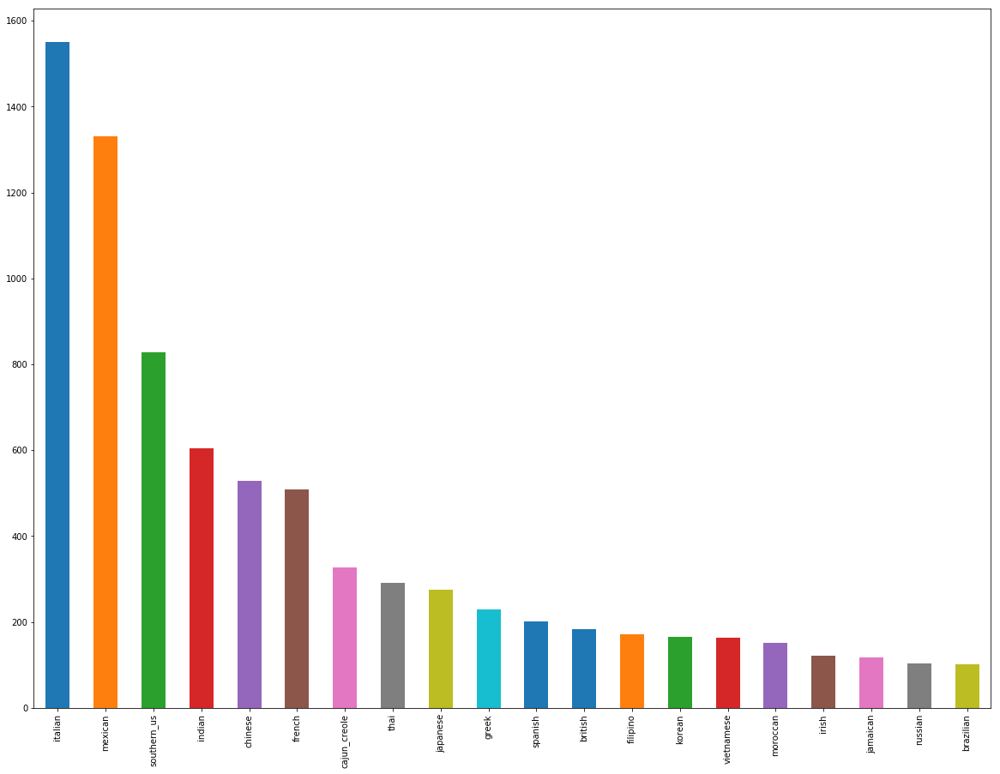

In [44]:
y_test.value_counts().plot(kind='bar')

In [45]:
from sklearn.neighbors import KNeighborsClassifier

neigh = KNeighborsClassifier(n_neighbors=21)
neigh.fit(X_train, y_train)

neigh.score(X_test, y_test)

0.4918918918918919

In [158]:
#this is for the classification report y labels
cuisines = trainData['cuisine'].value_counts(sort=False).index
cuisines

Index(['southern_us', 'french', 'chinese', 'indian', 'moroccan', 'greek',
       'vietnamese', 'spanish', 'japanese', 'mexican', 'russian', 'italian',
       'british', 'thai', 'brazilian', 'jamaican', 'irish', 'filipino',
       'cajun_creole', 'korean'],
      dtype='object')

In [159]:
#this is for the classification report y target_names
cuisineslist = cuisines.tolist()

In [160]:
neigh_pred = neigh.predict(X_test)
print(classification_report(y_test, neigh_pred, labels = cuisines, target_names=cuisineslist))

              precision    recall  f1-score   support

 southern_us       0.49      0.46      0.47       828
      french       0.31      0.29      0.30       508
     chinese       0.60      0.58      0.59       529
      indian       0.78      0.69      0.73       605
    moroccan       0.72      0.25      0.37       152
       greek       0.59      0.46      0.51       229
  vietnamese       0.47      0.10      0.17       163
     spanish       0.34      0.10      0.15       201
    japanese       0.76      0.42      0.54       276
     mexican       0.71      0.74      0.73      1331
     russian       0.90      0.09      0.16       104
     italian       0.44      0.88      0.58      1550
     british       0.33      0.08      0.13       184
        thai       0.70      0.25      0.37       292
   brazilian       0.59      0.31      0.41       102
    jamaican       0.68      0.20      0.30       117
       irish       0.55      0.09      0.16       121
    filipino       0.38    

In [ ]:
#### Section 3.2: Decision Tree Classifer

In [161]:
from sklearn import tree

dec = tree.DecisionTreeClassifier()
dec.fit(X_train, y_train)

dec.score(X_test, y_test)

0.553362664990572

In [163]:
dec_pred = dec.predict(X_test)
print(classification_report(y_test, dec_pred, labels = cuisines, target_names=cuisineslist))

              precision    recall  f1-score   support

 southern_us       0.52      0.45      0.48       828
      french       0.32      0.31      0.31       508
     chinese       0.55      0.61      0.58       529
      indian       0.75      0.71      0.73       605
    moroccan       0.58      0.35      0.43       152
       greek       0.48      0.45      0.47       229
  vietnamese       0.40      0.23      0.29       163
     spanish       0.34      0.20      0.26       201
    japanese       0.66      0.47      0.55       276
     mexican       0.79      0.73      0.76      1331
     russian       0.42      0.18      0.26       104
     italian       0.49      0.79      0.60      1550
     british       0.24      0.14      0.17       184
        thai       0.59      0.45      0.51       292
   brazilian       0.46      0.37      0.41       102
    jamaican       0.49      0.32      0.39       117
       irish       0.35      0.17      0.23       121
    filipino       0.36    

In [166]:
from sklearn.tree import _tree

def tree_to_code(tree, feature_names):
    tree_ = tree.tree_
    feature_name = [
        feature_names[i] if i != _tree.TREE_UNDEFINED else "undefined!"
        for i in tree_.feature
    ]
    print("def tree({}):".format(", ".join(feature_names)))

    def recurse(node, depth):
        indent = "  " * depth
        if tree_.feature[node] != _tree.TREE_UNDEFINED:
            name = feature_name[node]
            threshold = tree_.threshold[node]
            print("{}if {} <= {}:".format(indent, name, threshold))
            recurse(tree_.children_left[node], depth + 1)
            print("{}else:  # if {} > {}".format(indent, name, threshold))
            recurse(tree_.children_right[node], depth + 1)
        else:
            print("{}return {}".format(indent, tree_.value[node]))

    recurse(0, 1)

In [169]:
tree_to_code(dec,final_ingredients_features)

def tree(feta cheese crumbles, feta cheese, fresh dill, red wine vinegar, greek yogurt, fresh oregano, kalamata, pitted kalamata olives, chopped fresh mint, ground lamb, eggplant, plain yogurt, cherry tomatoes, greek style plain yogurt, zucchini, plum tomatoes, buttermilk, yellow corn meal, chopped pecans, hot sauce, bacon, cornmeal, peaches, mayonaise, worcestershire sauce, sweet potatoes, bourbon whiskey, grits, freshly ground pepper, cooking oil, vinegar, white vinegar, ground pork, pork, chicken, cabbage, peppercorns, black peppercorns, pork belly, evaporated milk, oyster sauce, tomato sauce, thai chile, ground beef, garam masala, ground turmeric, cumin seed, tumeric, chili powder, green chilies, curry powder, ground coriander, clove, ghee, cinnamon sticks, mustard seeds, basmati rice, coriander, garlic paste, coriander powder, yoghurt, coriander seeds, curry leaves, cumin, ground cardamom, red chili powder, ground allspice, dried thyme, thyme, ground nutmeg, fresh thyme, allspice,

                                                                                                                                                                                                                                                                                                                                                                            else:  # if scotch bonnet chile > 0.5
                                                                                                                                                                                                                                                                                                                                                                              return [[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0.]]
                                                                                                                                                                 

                                                                                                                                                                                                                                                                                                                                if caster sugar <= 0.5:
                                                                                                                                                                                                                                                                                                                                  if yukon gold potatoes <= 0.5:
                                                                                                                                                                                                                                                                                                               

                                                                                                                                                                                                                                                                                                    return [[0. 0. 0. 2. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]]
                                                                                                                                                                                                                                                                                                else:  # if warm water > 0.5
                                                                                                                                                                                                                                                                                                  return [[0. 0. 0. 0. 0. 0. 0. 

                                                                                                                                                                                                                                                                                    return [[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1.]]
                                                                                                                                                                                                                                                                                else:  # if dry sherry > 0.5
                                                                                                                                                                                                                                                                                  return [[0. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]]
       

                                                                                                                                                                                                                                                                  return [[0. 0. 5. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]]
                                                                                                                                                                                                                                                              else:  # if margarine > 0.5
                                                                                                                                                                                                                                                                return [[0. 0. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]]
                                                              

                                                                                                                                                                                                                                                                              return [[0. 0. 0. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]]
                                                                                                                                                                                                                                                                        else:  # if cheddar cheese > 0.5
                                                                                                                                                                                                                                                                          if chicken <= 0.5:
                                                                             

                                                                                                                                                                                                                                                                                        return [[0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]]
                                                                                                                                                                                                                                                                                    else:  # if kalamata > 0.5
                                                                                                                                                                                                                                                                                      return [[0. 0. 0. 0. 0. 0. 1. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.

                                                                                                                                                                                                                                                          else:  # if long-grain rice > 0.5
                                                                                                                                                                                                                                                            return [[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0.]]
                                                                                                                                                                                                                                                      else:  # if mayonaise > 0.5
                                                                                                                       

                                                                                                                                                                                                                                        return [[0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]]
                                                                                                                                                                                                                                  else:  # if dill > 0.5
                                                                                                                                                                                                                                    return [[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 2. 0. 0. 0. 0.]]
                                                                                                                                                     

                                                                                                                                                                                                                              return [[2. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]]
                                                                                                                                                                                                                          else:  # if strawberries > 0.5
                                                                                                                                                                                                                            return [[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0.]]
                                                                                                                                                                       

                                                                                                                                                                                                                                      return [[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1.]]
                                                                                                                                                                                                                                  else:  # if cold water > 0.5
                                                                                                                                                                                                                                    return [[0. 0. 0. 3. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]]
                                                                                                                                                 

                                                                                                                                                                                                                                                                            return [[0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]]
                                                                                                                                                                                                                                                                      else:  # if fresh oregano > 0.5
                                                                                                                                                                                                                                                                        if green olives <= 0.5:
                                                                               

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)




                                                                                                                                                                    else:  # if cooked rice > 0.5
                                                                                                                                                                      return [[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0.]]
                                                                                                                                                                  else:  # if cold water > 0.5
                                                                                                                                                                    return [[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0.]]
                                                                                                                                              

                                                                                                                                                                                                  return [[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0.]]
                                                                                                                                                                                                else:  # if freshly ground pepper > 0.5
                                                                                                                                                                                                  return [[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0. 0. 0. 0.]]
                                                                                                                                                                                              else:  # if dark sesame oil > 0.5
              

                                                                                                                                                                                            if plum tomatoes <= 0.5:
                                                                                                                                                                                              if mint leaves <= 0.5:
                                                                                                                                                                                                return [[ 0.  0.  0.  0.  0.  0. 12.  3.  0.  1.  0.  0.  0.  0.  1.  0.  1.  0.
   0.  0.]]
                                                                                                                                                                                              else:  # if mint leaves > 0.5
                                                                     

                                                                                                                                                      return [[0. 0. 0. 0. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]]
                                                                                                                                                else:  # if orange > 0.5
                                                                                                                                                  return [[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0. 0. 0. 0.]]
                                                                                                                                              else:  # if boneless skinless chicken breasts > 0.5
                                                                                                                                                return [[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0

                                                                                                                                                                                                              if pitted kalamata olives <= 0.5:
                                                                                                                                                                                                                if boneless skinless chicken breasts <= 0.5:
                                                                                                                                                                                                                  if yellow corn meal <= 0.5:
                                                                                                                                                                                                                    if russet potatoes <= 0.5:
                              

                                                                                                                                                    return [[0. 0. 0. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]]
                                                                                                                                                else:  # if peeled fresh ginger > 0.5
                                                                                                                                                  return [[0. 0. 0. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]]
                                                                                                                                              else:  # if strawberries > 0.5
                                                                                                                                                return [[0. 0. 0. 0. 0. 2. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.

                                                                                                                                                              if greek style plain yogurt <= 0.5:
                                                                                                                                                                if cooking oil <= 0.5:
                                                                                                                                                                  if fresh mint <= 0.5:
                                                                                                                                                                    if yoghurt <= 0.5:
                                                                                                                                                                      return [[ 0.  0.  0.  0.  0.  2.  0. 11.  0.  2.  0.  0.  0.  0.  0.  0.  0.  0.
   0.  0.

                                                                                                                                        else:  # if plum tomatoes > 0.5
                                                                                                                                          return [[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0. 0. 0. 0.]]
                                                                                                                                    else:  # if hot sauce > 0.5
                                                                                                                                      if worcestershire sauce <= 0.5:
                                                                                                                                        if cheddar cheese <= 0.5:
                                                                                                                                       

                                                                                                          else:  # if ground pork > 0.5
                                                                                                            if chopped cilantro <= 0.5:
                                                                                                              if chopped celery <= 0.5:
                                                                                                                if white vinegar <= 0.5:
                                                                                                                  if beef <= 0.5:
                                                                                                                    return [[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 2. 0. 1. 0. 0. 0. 0. 0. 0.]]
                                                                                                                  else:  # if beef > 0.5
 

                                                                                                                                      else:  # if large egg whites > 0.5
                                                                                                                                        return [[0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]]
                                                                                                                                    else:  # if dijon mustard > 0.5
                                                                                                                                      return [[0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]]
                                                                                                                                  else:  # if dried currants > 0.5
                                                                                            

                                                                                            if sweet potatoes <= 0.5:
                                                                                              if peanut oil <= 0.5:
                                                                                                if red pepper <= 0.5:
                                                                                                  if white onion <= 0.5:
                                                                                                    if rice noodles <= 0.5:
                                                                                                      if basmati rice <= 0.5:
                                                                                                        if large garlic cloves <= 0.5:
                                                                                                          if crushed red pepper <= 0.5:
      

                                                                                                                      return [[0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]]
                                                                                                                  else:  # if strawberries > 0.5
                                                                                                                    return [[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0. 0. 0. 0.]]
                                                                                                              else:  # if capers > 0.5
                                                                                                                if eggplant <= 0.5:
                                                                                                                  if pitted kalamata olives <= 0.5:
                                                                

                                                                                    else:  # if chickpeas > 0.5
                                                                                      return [[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0. 0. 0.]]
                                                                                  else:  # if plain yogurt > 0.5
                                                                                    return [[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]]
                                                                                else:  # if chicken > 0.5
                                                                                  if mushrooms <= 0.5:
                                                                                    return [[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0.]]
                                                                                  else:  # if mushr

                                                                                                                                                                                                        else:  # if red wine vinegar > 0.5
                                                                                                                                                                                                          return [[0. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]]
                                                                                                                                                                                                      else:  # if leeks > 0.5
                                                                                                                                                                                                        return [[0. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]]

                                                                                                            return [[0. 0. 0. 2. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]]
                                                                                                        else:  # if chicken stock > 0.5
                                                                                                          return [[0. 0. 0. 3. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]]
                                                                                                      else:  # if cooking oil > 0.5
                                                                                                        return [[0. 0. 0. 3. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]]
                                                                                                    else:  # if spring onions > 0.5
                                                                     

                                                                                                                                                            if black peppercorns <= 0.5:
                                                                                                                                                              if whole wheat flour <= 0.5:
                                                                                                                                                                if chopped cilantro <= 0.5:
                                                                                                                                                                  if ground red pepper <= 0.5:
                                                                                                                                                                    if chicken <= 0.5:
                                                                  

                                                                                                                                                                                                                            if long-grain rice <= 0.5:
                                                                                                                                                                                                                              return [[0. 0. 0. 0. 0. 1. 0. 0. 0. 3. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]]
                                                                                                                                                                                                                            else:  # if long-grain rice > 0.5
                                                                                                                                                                                                              

                                                                                      return [[0. 0. 2. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]]
                                                                                    else:  # if whipping cream > 0.5
                                                                                      return [[0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]]
                                                                                else:  # if asian fish sauce > 0.5
                                                                                  return [[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 2. 0.]]
                                                                              else:  # if kalamata > 0.5
                                                                                if fresh basil leaves <= 0.5:
                                                                                  if c

                                                                                                      return [[0. 0. 0. 0. 0. 0. 2. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]]
                                                                                                  else:  # if boneless skinless chicken breasts > 0.5
                                                                                                    return [[0. 0. 0. 0. 0. 0. 3. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]]
                                                                                                else:  # if fresh oregano > 0.5
                                                                                                  return [[0. 0. 0. 0. 0. 0. 4. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]]
                                                                                              else:  # if plain yogurt > 0.5
                                                                                    

                                                                    return [[0. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]]
                                                                  else:  # if hot sauce > 0.5
                                                                    return [[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]]
                                                                else:  # if mayonaise > 0.5
                                                                  return [[0. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]]
                                                            else:  # if red pepper flakes > 0.5
                                                              return [[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]]
                                                          else:  # if bacon > 0.5
                                                            return [[0. 0. 0. 0. 0. 0. 0

                                                        return [[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0. 0. 0.]]
                                                      else:  # if cold water > 0.5
                                                        return [[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0.]]
                                                  else:  # if beef > 0.5
                                                    return [[0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]]
                                                else:  # if scotch bonnet chile > 0.5
                                                  return [[0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]]
                                              else:  # if dried currants > 0.5
                                                return [[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]]
                                          else:  # if lemongra

                                                                                                                                                        if balsamic vinegar <= 0.5:
                                                                                                                                                          return [[0. 0. 0. 0. 0. 0. 0. 0. 0. 3. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0.]]
                                                                                                                                                        else:  # if balsamic vinegar > 0.5
                                                                                                                                                          return [[0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]]
                                                                                                                                                      else:  # if fresh oregano > 0.5
 

                                                                                    return [[0. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]]
                                                                                else:  # if mushrooms > 0.5
                                                                                  return [[0. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]]
                                                                              else:  # if dry sherry > 0.5
                                                                                return [[0. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]]
                                                                            else:  # if peeled fresh ginger > 0.5
                                                                              return [[0. 0. 0. 4. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]]
                                                               

                                                                                      return [[0. 0. 0. 2. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]]
                                                                                else:  # if large egg whites > 0.5
                                                                                  return [[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1.]]
                                                                              else:  # if green chilies > 0.5
                                                                                return [[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0.]]
                                                                            else:  # if water chestnuts > 0.5
                                                                              if ground beef <= 0.5:
                                                                                return [[ 0.  0.  0. 22

                                                                    return [[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]]
                                                                else:  # if bourbon whiskey > 0.5
                                                                  return [[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]]
                                                              else:  # if long-grain rice > 0.5
                                                                return [[0. 0. 0. 0. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]]
                                                            else:  # if ground allspice > 0.5
                                                              return [[0. 0. 0. 0. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]]
                                                          else:  # if greek style plain yogurt > 0.5
                                                            return 

                                                                                                            return [[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0. 0. 0. 0.]]
                                                                                                        else:  # if cinnamon > 0.5
                                                                                                          return [[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0. 0. 0. 0.]]
                                                                                                      else:  # if tomato sauce > 0.5
                                                                                                        return [[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0. 0. 0. 0.]]
                                                                                                    else:  # if sour cream > 0.5
                                                                            

                                                                                                                              return [[0. 0. 0. 0. 0. 0. 0. 2. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]]
                                                                                                                            else:  # if black peppercorns > 0.5
                                                                                                                              if nutmeg <= 0.5:
                                                                                                                                if ground nutmeg <= 0.5:
                                                                                                                                  return [[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0.]]
                                                                                                                                else:  # if groun

                                                                                                                                  return [[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0. 0. 0. 0.]]
                                                                                                                              else:  # if large garlic cloves > 0.5
                                                                                                                                return [[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0. 0. 0. 0.]]
                                                                                                                            else:  # if vinegar > 0.5
                                                                                                                              return [[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0. 0. 0. 0.]]
                                                                                         

                                                              if chopped cilantro <= 0.5:
                                                                if large egg whites <= 0.5:
                                                                  if daikon <= 0.5:
                                                                    if white miso <= 0.5:
                                                                      return [[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 3. 5. 0. 0. 0. 0. 0. 0. 0.]]
                                                                    else:  # if white miso > 0.5
                                                                      return [[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0.]]
                                                                  else:  # if daikon > 0.5
                                                                    return [[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0.]]
                                   

                                                                  return [[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]]
                                                              else:  # if vinegar > 0.5
                                                                return [[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]]
                                                            else:  # if white vinegar > 0.5
                                                              return [[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 4. 0. 0. 0.]]
                                                          else:  # if active dry yeast > 0.5
                                                            return [[0. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]]
                                                        else:  # if cornmeal > 0.5
                                                          return [[1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.

                                                                        return [[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 6. 0. 0. 0. 0. 0. 0.]]
                                                                    else:  # if green bell pepper > 0.5
                                                                      return [[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 8. 0. 0. 0. 0. 0. 0.]]
                                                                  else:  # if chopped cilantro > 0.5
                                                                    return [[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 9. 0. 0. 0. 0. 0. 0.]]
                                                                else:  # if enchilada sauce > 0.5
                                                                  return [[ 0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0. 12.  0.  0.  0.  0.
   0.  0.]]
                                                              else:  # if cheddar cheese > 0.5
                    

                                                return [[0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]]
                                              else:  # if tumeric > 0.5
                                                return [[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0.]]
                                          else:  # if cinnamon > 0.5
                                            return [[0. 0. 0. 0. 0. 0. 0. 4. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]]
                                      else:  # if cumin seed > 0.5
                                        if ghee <= 0.5:
                                          if ground turmeric <= 0.5:
                                            return [[0. 0. 0. 0. 0. 0. 0. 8. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]]
                                          else:  # if ground turmeric > 0.5
                                            if cinnamon <= 0.5:
                                              if red chili 

                                                                                                return [[0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]]
                                                                                          else:  # if tomato sauce > 0.5
                                                                                            if whipping cream <= 0.5:
                                                                                              if red wine vinegar <= 0.5:
                                                                                                if green bell pepper <= 0.5:
                                                                                                  if ground beef <= 0.5:
                                                                                                    if ricotta cheese <= 0.5:
                                                                                                    

                                    else:  # if freshly ground pepper > 0.5
                                      return [[0. 0. 0. 0. 0. 0. 0. 0. 0. 2. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]]
                                  else:  # if worcestershire sauce > 0.5
                                    if sour cream <= 0.5:
                                      if parmesan cheese <= 0.5:
                                        return [[0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0. 1. 0. 0. 0. 0. 0. 0.]]
                                      else:  # if parmesan cheese > 0.5
                                        return [[0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]]
                                    else:  # if sour cream > 0.5
                                      return [[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0. 0. 0. 0.]]
                                else:  # if dry white wine > 0.5
                                  return [[0. 0. 0. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0

In [170]:
#### Section 3.3: Naive Bayes Classifer

In [172]:
from sklearn.naive_bayes import MultinomialNB

bayes = MultinomialNB()
#todense() method used to coerce ndarray from csr (sparse) to dense format
#only seemed to be throwing errors on the training matrix, unsure why
bayes.fit(X_train, y_train)

bayes.score(X_test, y_test)

0.6042740414833438

In [173]:
bayes_pred = bayes.predict(X_test)
print(classification_report(y_test, bayes_pred, labels = cuisines, target_names=cuisineslist))

              precision    recall  f1-score   support

 southern_us       0.52      0.49      0.50       828
      french       0.38      0.39      0.38       508
     chinese       0.66      0.67      0.66       529
      indian       0.76      0.79      0.77       605
    moroccan       0.67      0.55      0.60       152
       greek       0.68      0.52      0.59       229
  vietnamese       0.64      0.24      0.35       163
     spanish       0.55      0.26      0.35       201
    japanese       0.81      0.50      0.62       276
     mexican       0.82      0.75      0.78      1331
     russian       0.53      0.24      0.33       104
     italian       0.51      0.84      0.64      1550
     british       0.35      0.12      0.18       184
        thai       0.62      0.57      0.59       292
   brazilian       0.52      0.23      0.32       102
    jamaican       0.61      0.43      0.50       117
       irish       0.40      0.17      0.23       121
    filipino       0.51    

In [174]:
#### Section 3.4: Random Forest Classifer

In [175]:
from sklearn.ensemble import RandomForestClassifier

frst = RandomForestClassifier(random_state=37)
frst.fit(X_train, y_train)

frst.score(X_test, y_test)

0.57950974230044

In [177]:
frst_pred = frst.predict(X_test)
print(classification_report(y_test, frst_pred, labels = cuisines, target_names=cuisineslist))

              precision    recall  f1-score   support

 southern_us       0.53      0.48      0.51       828
      french       0.34      0.30      0.32       508
     chinese       0.60      0.62      0.61       529
      indian       0.75      0.77      0.76       605
    moroccan       0.57      0.38      0.46       152
       greek       0.60      0.48      0.53       229
  vietnamese       0.50      0.24      0.32       163
     spanish       0.36      0.22      0.27       201
    japanese       0.69      0.46      0.55       276
     mexican       0.78      0.75      0.77      1331
     russian       0.48      0.23      0.31       104
     italian       0.50      0.82      0.62      1550
     british       0.31      0.12      0.17       184
        thai       0.68      0.49      0.57       292
   brazilian       0.55      0.31      0.40       102
    jamaican       0.55      0.34      0.42       117
       irish       0.35      0.16      0.22       121
    filipino       0.43    

In [178]:
#### Section 3.5: Logistic Regression Classifer

In [179]:
from sklearn.linear_model import LogisticRegression

logistic = LogisticRegression()
logistic.fit(X_train, y_train)

logistic.score(X_test, y_test)

0.6041483343808925

Text(0.5,64.6,'Predicted label')

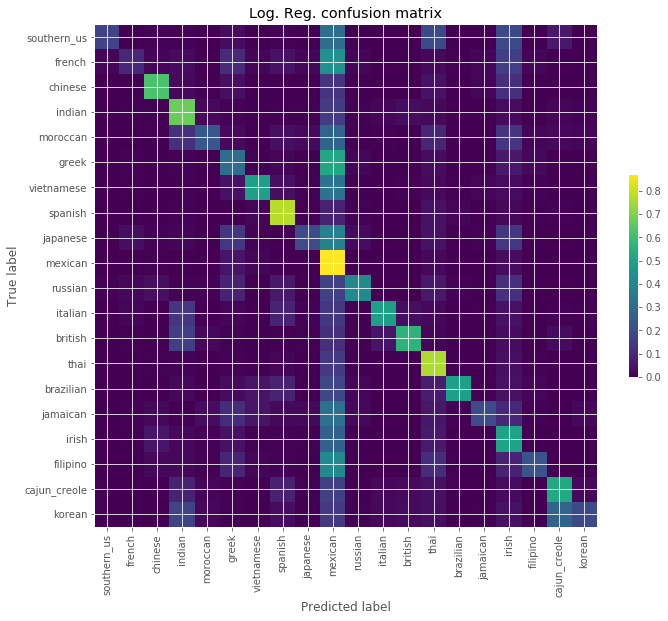

In [180]:
plt.figure(figsize=(10, 10))

log_cm = confusion_matrix(y_test, logistic.predict(X_test))
log_cm_normalized = log_cm.astype('float') / log_cm.sum(axis=1)[:, np.newaxis]

plt.imshow(log_cm_normalized, interpolation='nearest')
plt.title("Log. Reg. confusion matrix")
plt.colorbar(shrink=0.3)

tick_marks = np.arange(len(cuisines))
plt.xticks(tick_marks, cuisines, rotation=90)
plt.yticks(tick_marks, cuisines)
plt.tight_layout()
plt.ylabel('True label')
plt.xlabel('Predicted label')

In [181]:
log_pred = logistic.predict(X_test)
print(classification_report(y_test, log_pred, labels = cuisines, target_names=cuisineslist))

              precision    recall  f1-score   support

 southern_us       0.54      0.51      0.52       828
      french       0.40      0.31      0.35       508
     chinese       0.64      0.68      0.66       529
      indian       0.78      0.78      0.78       605
    moroccan       0.79      0.49      0.61       152
       greek       0.68      0.49      0.57       229
  vietnamese       0.67      0.20      0.30       163
     spanish       0.56      0.22      0.32       201
    japanese       0.82      0.49      0.62       276
     mexican       0.79      0.77      0.78      1331
     russian       0.53      0.20      0.29       104
     italian       0.48      0.87      0.62      1550
     british       0.38      0.10      0.16       184
        thai       0.68      0.53      0.60       292
   brazilian       0.72      0.18      0.28       102
    jamaican       0.61      0.42      0.50       117
       irish       0.48      0.20      0.28       121
    filipino       0.53    

In [182]:
#### Section 3.6: SVM Classifer

In [183]:
from sklearn.svm import LinearSVC

lsvc = LinearSVC(random_state=37)
lsvc.fit(X_train, y_train)

lsvc.score(X_test, y_test)

0.6043997485857951

Text(0.5,64.6,'Predicted label')

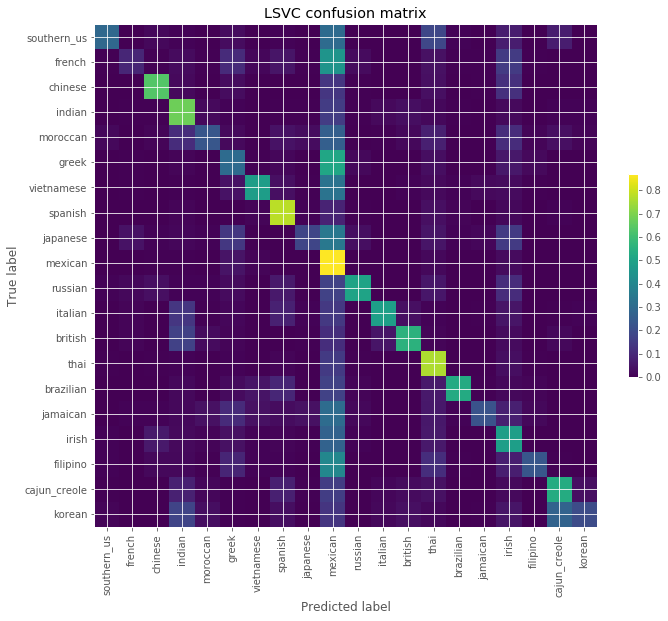

In [185]:
plt.figure(figsize=(10, 10))

lsvc_cm = confusion_matrix(y_test, lsvc.predict(X_test))
lsvc_cm_normalized = lsvc_cm.astype('float') / lsvc_cm.sum(axis=1)[:, np.newaxis]

plt.imshow(lsvc_cm_normalized, interpolation='nearest')
plt.title("LSVC confusion matrix")
plt.colorbar(shrink=0.3)

tick_marks = np.arange(len(cuisines))
plt.xticks(tick_marks, cuisines, rotation=90)
plt.yticks(tick_marks, cuisines)
plt.tight_layout()
plt.ylabel('True label')
plt.xlabel('Predicted label')

In [186]:
lsvc_pred = lsvc.predict(X_test)
print(classification_report(y_test, lsvc_pred, labels = cuisines, target_names=cuisineslist))

              precision    recall  f1-score   support

 southern_us       0.56      0.49      0.52       828
      french       0.41      0.31      0.35       508
     chinese       0.63      0.68      0.65       529
      indian       0.77      0.78      0.78       605
    moroccan       0.77      0.53      0.63       152
       greek       0.68      0.48      0.57       229
  vietnamese       0.62      0.20      0.31       163
     spanish       0.58      0.23      0.33       201
    japanese       0.82      0.49      0.62       276
     mexican       0.80      0.76      0.78      1331
     russian       0.59      0.22      0.32       104
     italian       0.49      0.87      0.62      1550
     british       0.39      0.09      0.15       184
        thai       0.68      0.53      0.60       292
   brazilian       0.58      0.29      0.39       102
    jamaican       0.55      0.50      0.52       117
       irish       0.42      0.18      0.25       121
    filipino       0.43    